In [18]:
import sys

sys.path.append('../../../common_code')
from PostProcessingScripts import * 
from formation_channels import * 
import astropy.stats

from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

##########
# define colors for formation channels 
channelColorDict = {'classic':'#118AB2', 'stable B no CEE':'orange',  'immediate CE': '#EF476F'  , r'double-core CE':'#073B4C', 'other':'gray', 'vi':'cyan', 'vii':'#FFD166'}
List_formationchannelOptions = ['All',  'classic',  'stable B no CEE',  'immediate CE',  r'double-core CE', 'vi', 'vii', 'other']
ind_formationchannelOptions = [7,  1, 2, 3, 4, 5, 6, 0]
dictFormationChannelIndex =  {List_formationchannelOptions[i]: ind_formationchannelOptions[i] for i in range(len(List_formationchannelOptions))}

channelColorDict_lighter = {'classic':adjust_lightness(color='#118AB2', amount=1.6),'stable B no CEE':adjust_lightness(color='orange', amount=1.4), 'immediate CE':adjust_lightness(color='#EF476F', amount=1.2),\
                            r'double-core CE':adjust_lightness(color='#073B4C', amount=1.8), 'other':adjust_lightness(color='gray', amount=1.5),  'vi':adjust_lightness(color='cyan', amount=1.5), 'vii':adjust_lightness(color='#FFD166', amount=1.2)}
channelList = ['classic', 'stable B no CEE', 'vii',  'immediate CE',  r'double-core CE', 'other'] #, 'vi']
#######


In [19]:
def obtain_redshiftsruns(pathData = '/Volumes/SimonsFoundation/DataDCO/'):
    BPSmodelName='A'
    DCOtype='BNS'
    path_ = '/Volumes/SimonsFoundation/DataDCO/' + alphabetDirDict[BPSmodelName] +'/'
    path  = path_ + 'COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'
    fdata = h5.File(path, 'r')
    redshifts = fdata['redshifts']['redshift'][...].squeeze()
    fdata.close()
    return redshifts 

##### PLOT LVKM1 

In [34]:
def plot_formation_channels_redshift_rate_stacked(axe='None', DCOtype='BHNS', \
                                          BPSmodelName='A', redshifts=[0], mssfr = '111'):
    """
    whichplot='rate', 'ratio'
    
    """

    
    adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']

    
    DCOname = DCOname_dict[DCOtype]
    intrinsicRates = np.zeros_like(redshifts)

    # path for files 
    full_data_path  = '/Volumes/SimonsFoundation/DataDCO/' + alphabetDirDict[BPSmodelName] +'/' + 'COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'
    # read in data 
    fdata = h5.File(full_data_path,'r')


    fc_ratios_z = np.zeros_like(redshifts)
    
    fparam_key = "formationchannel_z_rates"
    header = "rate_" + "total" + "_" + mssfr 
#     totals_z =  fdata[fparam_key][header][...].squeeze()    

    
    for nrC, Channel in enumerate(adjustedChannelList): 
        c_FC = channelColorDict[Channel]
        
        

        fparam_key = "formationchannel_z_rates"
        fractions_z = np.zeros_like(redshifts)
        header = "fraction_" + Channel + "_" + mssfr 
        channelRates =  fdata[fparam_key][header][...].squeeze()
        

        axe.fill_between(redshifts[:], y1=fc_ratios_z, y2=fc_ratios_z+channelRates, color=c_FC)
        fc_ratios_z+=channelRates
        

    axe.set_xlim(0,9.8) # high end is the highest redshift bin number 
    xlabel = r'\textbf{redshift} $z$'
    ylabel = r'\textbf{fraction}'
    axe.set_ylim(0., 1)

        
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)
    
    return axe


def plot_formation_channels_redshift_rate(axe='None', whichplot='rate', DCOtype='BHNS', \
                                          BPSmodelName='A', redshifts=[0], mssfr = '111'):
    """
    whichplot='rate', 'ratio'
    
    """

    
    adjustedChannelList = ['classic', 'stable B no CEE', 'vii',  'immediate CE',  r'double-core CE', 'other']
    
    DCOname = DCOname_dict[DCOtype]

    
    # path for files 
    full_data_path  = '/Volumes/SimonsFoundation/DataDCO/' + alphabetDirDict[BPSmodelName] +'/' + 'COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'
    # read in data 
    fdata = h5.File(full_data_path,'r')


#     fc_rates_z = np.zeros_like(redshifts)
    
    fparam_key = "formationchannel_z_rates"
    header = "rate_" + "total" + "_" + mssfr 
    totals_z =  fdata[fparam_key][header][...].squeeze()    

    
    for nrC, Channel in enumerate(adjustedChannelList): 
        c_FC = channelColorDict[Channel]
        
        

        fparam_key = "formationchannel_z_rates"
        fractions_z = np.zeros_like(redshifts)
        header = "fraction_" + Channel + "_" + mssfr 
        fc_rates_z =  fdata[fparam_key][header][...].squeeze() * totals_z
        
        axe.plot(redshifts[:], fc_rates_z, color=c_FC, lw=3)
        
        
#     if whichplot=='rate':
#         # plot total rates         
#         axe.plot(redshifts, channels_merger_rate_per_z[-1], color='k')


    axe.set_xlim(0,9.6)
    xlabel = r'\textbf{redshift} $z$'
    if whichplot=='ratio':
        ylabel = r'\textbf{fraction}'
        axe.set_ylim(0., 1)
    else:
        ylabel = r'\textbf{Rate} $[\rm{Gpc}^{-3} \rm{yr}^{-1}]$'
        axe.set_ylim(0.0001, 800)
        
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)
    
    if whichplot!='ratio':
        axe.set_yscale('log') 
        
    
    return axe




In [35]:
adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']


pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run 
print('available redshifts:', redshifts_runs) 


available redshifts: [0.19230769 0.57692308 0.96153846 1.34615385 1.73076923 2.11538462
 2.5        2.88461538 3.26923077 3.65384615 4.03846154 4.42307692
 4.80769231 5.19230769 5.57692308 5.96153846 6.34615385 6.73076923
 7.11538462 7.5        7.88461538 8.26923077 8.65384615 9.03846154
 9.42307692 9.80769231]


322

at DCOtype = BNS
BPSmodelName A


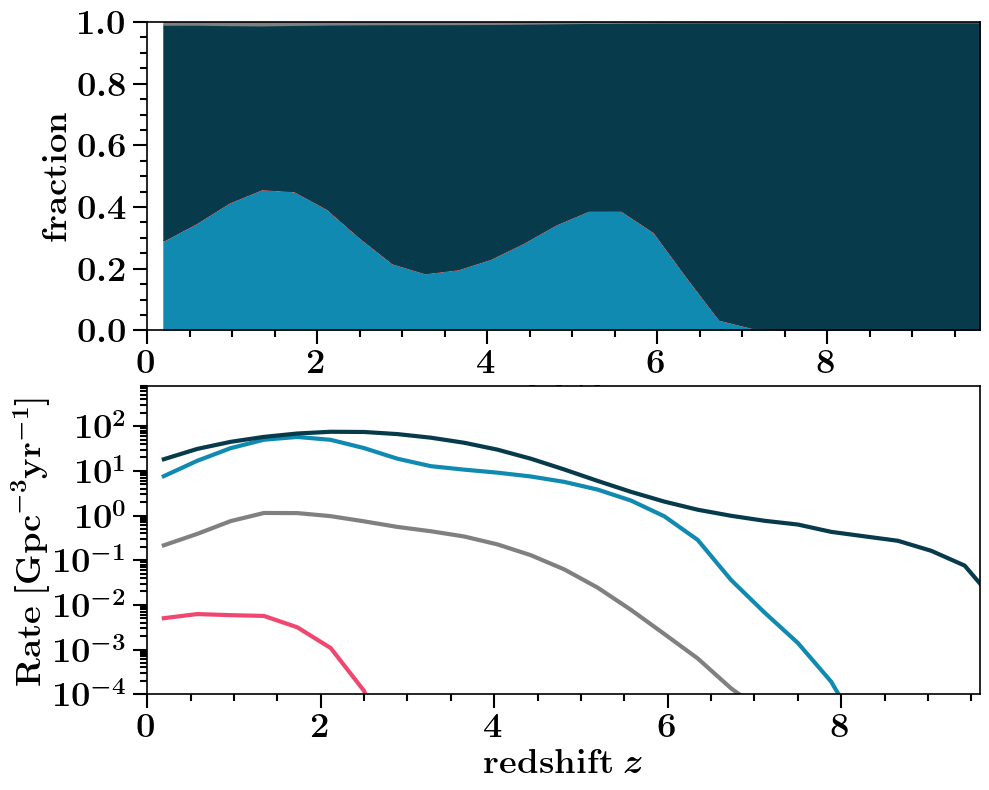

In [40]:

# for mssfr in MSSFRnameslist:
# for mssfr in [MSSFRnameslist[20]]:

for mssfr in ['322']:
    print(mssfr)
    for DCOtype in ['BNS']:
        print()
        print('at DCOtype =', DCOtype)

#         for BPSmodelName in  BPSnameslist[:]:
        for BPSmodelName in  [BPSnameslist[0]]:
            print('BPSmodelName', BPSmodelName)
            ncols, nrows= 1,2
            f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,8), 
                          gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})

            ax[0] = plot_formation_channels_redshift_rate_stacked(axe=ax[0], DCOtype=DCOtype, BPSmodelName=BPSmodelName, redshifts=redshifts_runs, mssfr=mssfr ) 
            ax[1] = plot_formation_channels_redshift_rate(axe=ax[1], DCOtype=DCOtype, BPSmodelName=BPSmodelName, redshifts=redshifts_runs, mssfr=mssfr  )



            ##  SAVE FIG  ###
            plt.tight_layout()
            plt.subplots_adjust(wspace=0., hspace=0.18)  
#             plt.savefig('./redshift_rates_fc/ratesz_stacked_' + BPSmodelName  + '_' + DCOtype  + '_' + mssfr + '.png', transparent=False)
#             plt.savefig('./redshift_rates_fc/ratesz_stacked_' + BPSmodelName  + '_' + DCOtype  + '_' + mssfr + '.pdf', transparent=False)
            plt.show()
            plt.close()

In [ ]:
print(channelList)

In [ ]:
# def plot_formation_channels_redshift_rate_mssfr(axe='None', DCOtype='BHNS', \
#                                           BPSmodelName='A', redshifts=[0],\
#                                                   pathData='/Volumes/SimonsFoundation/DataDCO/',\
#                                                  fc_ind_wanted=-1, c_FC=False):
#     """
#     whichplot='rate', 'ratio'
    
#     """

    
#     adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
#     DCOname = DCOname_dict[DCOtype]

#     # path for files 
#     full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'

#     # read in data 
#     fdata = h5.File(full_data_path,'r')
    
    
    
#     channels = fdata['doubleCompactObjects']['formaton channel'][...].squeeze()
#     mask_fc = (channels==fc_ind_wanted)
    
    
#     if np.sum(mask_fc)>1:
        
# #         for ind_mssfr, mssfr in enumerate(MSSFRnameslist[0:2]):
#         for ind_mssfr, mssfr in enumerate(MSSFRnameslist[1:]):
#             print('mssfr ', mssfr)
#             fparam_key = 'weights_intrinsicPerRedshift'
#             fractions_z = np.zeros_like(redshifts)
#             for ind_z, redshift in enumerate(redshifts):
#                 redshift = np.round(redshift,4)
#                 weightheader = 'w_' + mssfr + '_z_' +  str(redshift)
#                 weights_ = fdata[fparam_key][weightheader][...].squeeze()  
#                 if np.sum(weights_)!=0:
#                     fractions_z[ind_z] = np.sum(weights_[mask_fc])/np.sum(weights_)
                    
#             axe.scatter(redshifts[:], fractions_z, color=c_FC)
#             axe.plot(redshifts[:], fractions_z, color=c_FC)

#     # always close the dataset
#     fdata.close()




    
        



#     axe.set_xlim(0,9.6)
#     xlabel = r'\textbf{redshift} $z$'
#     ylabel = r'\textbf{fraction}'
#     axe.set_ylim(0., 1)

        
#     axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)
    
#     return axe





In [42]:
def plot_formation_channels_redshift_rate_mssfr(axe='None', DCOtype='BHNS', \
                                          BPSmodelName='A', redshifts=[0],\
                                                  pathData='/Volumes/SimonsFoundation/DataDCO/',\
                                                 fc_ind_wanted=-1, c_FC=False, mask_specific_mssfr=None, whichRate='fraction'):
    """
    whichplot='rate', 'ratio'
    
    """

    
    adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
    DCOname = DCOname_dict[DCOtype]

    # path for files 
    full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'

    # read in data 
    fdata = h5.File(full_data_path,'r')
    
    
    
    ######## EXTRA FLUFF JUST FOR PLOTTING SOME MSSFR, NOT THE BEST CODE
    if mask_specific_mssfr==None:
        for ind_mssfr, mssfr in enumerate(MSSFRnameslist[:]):
    #         print('mssfr ', mssfr)
            fparam_key = "formationchannel_z_rates"
            fractions_z = np.zeros_like(redshifts)



            if whichRate=='fraction':
                header = "fraction_" + Channel + "_" + mssfr 
            elif (whichRate=='total') or (whichRate=='channeltotal'):
                header = "rate_" + "total" + "_" + mssfr 
            fractions_z =  fdata[fparam_key][header][...].squeeze()

            if whichRate=='channeltotal':
                header = "fraction_" + Channel + "_" + mssfr 
                fraction = fdata[fparam_key][header][...].squeeze()
                fractions_z = fractions_z*fraction
    elif mask_specific_mssfr!=None:

        if mask_specific_mssfr=='x':
            MSSFR_ = []
            for ind_mssfr_zind in [1,2,3]:
                ind_begin, ind_end = 1+ 9*(ind_mssfr_zind-1), 10+ 9*(ind_mssfr_zind-1)
                MSSFR_ = MSSFRnameslist[ind_begin:ind_end]
                for ind_mssfr, mssfr in enumerate(MSSFR_[:]):
                    # connect models with the same mssfr 
                    colors_mssfrind = ['none', 'blue', 'orange', 'green']
                    linestyles_mssfrind = ['none', ':',  '-.', '-']

                    fparam_key = "formationchannel_z_rates"
                    fractions_z = np.zeros_like(redshifts)

                    if whichRate=='fraction':
                        header = "fraction_" + Channel + "_" + mssfr 
                    elif (whichRate=='total') or (whichRate=='channeltotal'):
                        header = "rate_" + "total" + "_" + mssfr 
                    fractions_z =  fdata[fparam_key][header][...].squeeze()
                    
                    if whichRate=='channeltotal':
                        header = "fraction_" + Channel + "_" + mssfr 
                        fraction = fdata[fparam_key][header][...].squeeze()
                        fractions_z = fractions_z*fraction

                    axe.scatter(redshifts[:], fractions_z, color=colorDirDict[BPSmodelName], marker=dictMarkerShape[BPSmodelName])
                    axe.plot(redshifts[:], fractions_z, color=colorDirDict[BPSmodelName], ls=linestyles_mssfrind[ind_mssfr_zind])
        elif mask_specific_mssfr=='y':
            MSSFR_ = []   
            for ind_mssfr_zind in [1,2,3]:
                MSSFR_ = np.concatenate((MSSFRnameslist[1+3*(ind_mssfr_zind-1):4+3*(ind_mssfr_zind-1)], MSSFRnameslist[10+3*(ind_mssfr_zind-1):13+3*(ind_mssfr_zind-1)]))
                MSSFR_ = np.concatenate((MSSFR_, MSSFRnameslist[19+3*(ind_mssfr_zind-1):22+3*(ind_mssfr_zind-1)]))
                for ind_mssfr, mssfr in enumerate(MSSFR_[:]):
                    # connect models with the same mssfr 
                    colors_mssfrind = ['none', 'blue', 'orange', 'green']
                    linestyles_mssfrind = ['none', ':',  '-.', '-']

                    fparam_key = "formationchannel_z_rates"
                    fractions_z = np.zeros_like(redshifts)


                    if whichRate=='fraction':
                        header = "fraction_" + Channel + "_" + mssfr 
                    elif (whichRate=='total') or (whichRate=='channeltotal'):
                        header = "rate_" + "total" + "_" + mssfr 
                    fractions_z =  fdata[fparam_key][header][...].squeeze()
                    
                    if whichRate=='channeltotal':
                        header = "fraction_" + Channel + "_" + mssfr 
                        fraction = fdata[fparam_key][header][...].squeeze()
                        fractions_z = fractions_z*fraction  

                    axe.scatter(redshifts[:], fractions_z, color=colorDirDict[BPSmodelName], marker=dictMarkerShape[BPSmodelName])
                    axe.plot(redshifts[:], fractions_z, color=colorDirDict[BPSmodelName], ls=linestyles_mssfrind[ind_mssfr_zind])
        elif mask_specific_mssfr=='z':
            for ind_mssfr_zind in [1,2,3]:    
                MSSFR_ = MSSFRnameslist[ind_mssfr_zind::3]   
                for ind_mssfr, mssfr in enumerate(MSSFR_[:]):
                    # connect models with the same mssfr 
                    colors_mssfrind = ['none', 'blue', 'orange', 'green']
                    linestyles_mssfrind = ['none', ':',  '-.', '-']

                    fparam_key = "formationchannel_z_rates"
                    fractions_z = np.zeros_like(redshifts)

                    if whichRate=='fraction':
                        header = "fraction_" + Channel + "_" + mssfr 
                    elif (whichRate=='total') or (whichRate=='channeltotal'):
                        header = "rate_" + "total" + "_" + mssfr 
                    fractions_z =  fdata[fparam_key][header][...].squeeze()
                    
                    if whichRate=='channeltotal':
                        header = "fraction_" + Channel + "_" + mssfr 
                        fraction = fdata[fparam_key][header][...].squeeze()
                        fractions_z = fractions_z*fraction
                        
                    axe.scatter(redshifts[:], fractions_z, color=colorDirDict[BPSmodelName], marker=dictMarkerShape[BPSmodelName])
                    axe.plot(redshifts[:], fractions_z, color=colorDirDict[BPSmodelName], ls=linestyles_mssfrind[ind_mssfr_zind])


        
        
        
    # always close the dataset
    fdata.close()




    
        



    if whichRate=='fraction':
        ylabel = r'\textbf{fraction}' 
    else:
        ylabel = r'\textbf{Rate}'
        
        
    xlabel = r'\textbf{redshift} $z$'
           
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)

    
    axe.set_xlim(0,9.6)
    if whichRate=='fraction':
        axe.set_ylim(0., 1)
    else:
        axe.set_ylim(1, 1E4)
        axe.set_yscale('log')

    return axe






at DCOtype = BBH
now at Channel classic
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T


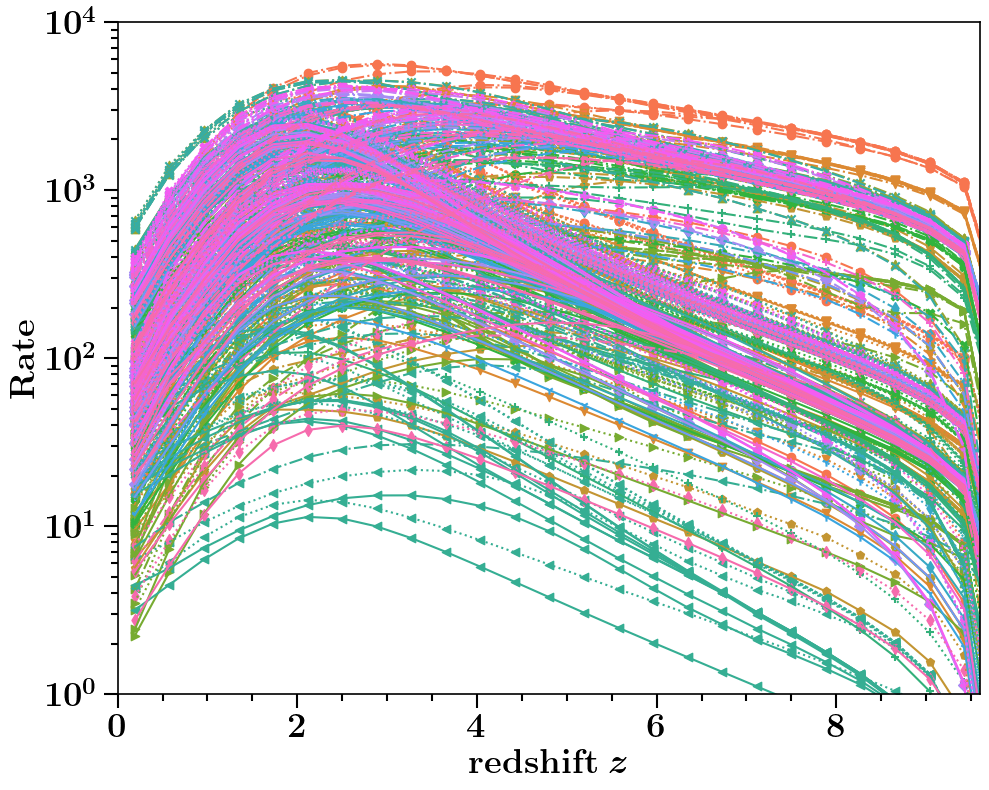

In [43]:
for DCOtype in [ 'BBH',]:
    print()
    print('at DCOtype =', DCOtype)
#     for nrC, Channel in enumerate(adjustedChannelList): 
    for nrC, Channel in enumerate([adjustedChannelList[0]]): 
        print('now at Channel', Channel)
        
        ncols, nrows= 1,1
        f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,8), 
                      gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})
        
        fc_ind_wanted = dictFormationChannelIndex[Channel]
        c_FC = channelColorDict[Channel]

        for ind_m, BPSmodelName in  enumerate(BPSnameslist[:]):
            color_m = colorDirDict[BPSmodelName]
            print('at BPS model ', BPSmodelName)
        #     for BPSmodelName in  [BPSnameslist[0]]:


            ax = plot_formation_channels_redshift_rate_mssfr(axe=ax, DCOtype=DCOtype, BPSmodelName=BPSmodelName,\
                                                              redshifts=redshifts_runs, pathData=pathData, fc_ind_wanted=fc_ind_wanted,\
                                                            c_FC=color_m, mask_specific_mssfr='x', whichRate='channeltotal') 


        ##  SAVE FIG  ###
        plt.tight_layout()
        plt.subplots_adjust(wspace=0., hspace=0.18)  
#         plt.savefig('./redshift_rates_fc/ratesz_' +  DCOtype + '_' + Channel+ '.png', transparent=False)
#         plt.savefig('./redshift_rates_fc/ratesz_' +  DCOtype + '_' + Channel+ '.pdf', transparent=False)
        plt.show()
        plt.close()


# individual panels

available redshifts: [0.19230769 0.57692308 0.96153846 1.34615385 1.73076923 2.11538462
 2.5        2.88461538 3.26923077 3.65384615 4.03846154 4.42307692
 4.80769231 5.19230769 5.57692308 5.96153846 6.34615385 6.73076923
 7.11538462 7.5        7.88461538 8.26923077 8.65384615 9.03846154
 9.42307692 9.80769231]

at DCOtype = BNS
at BPS model  A


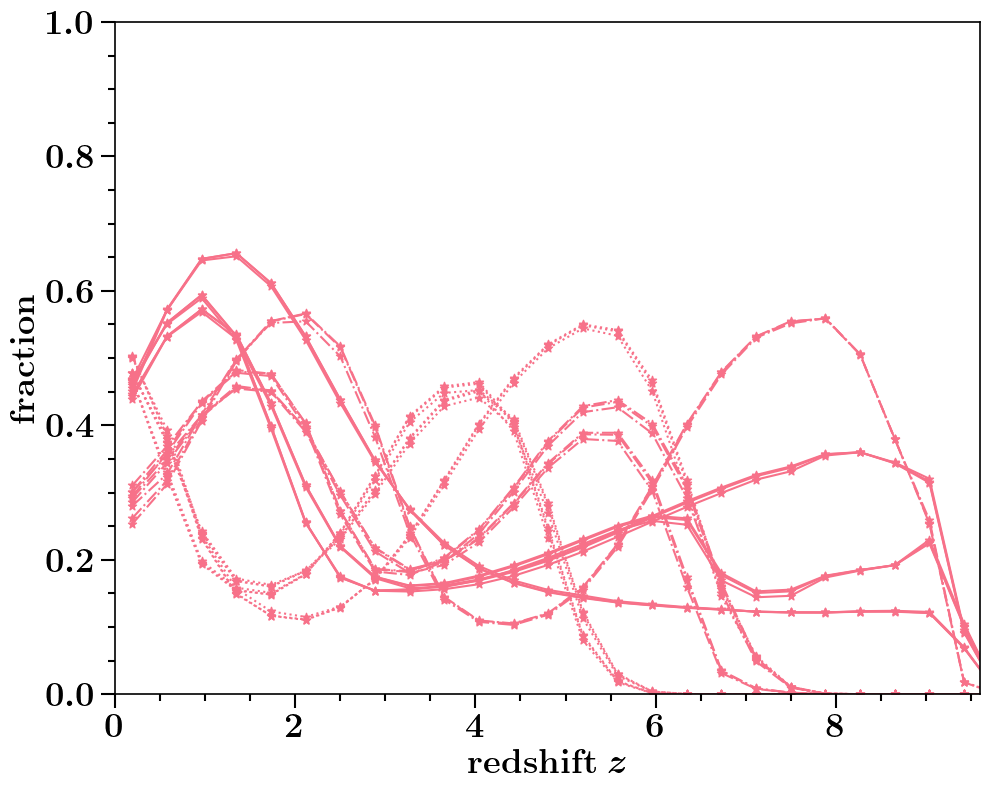

at BPS model  B


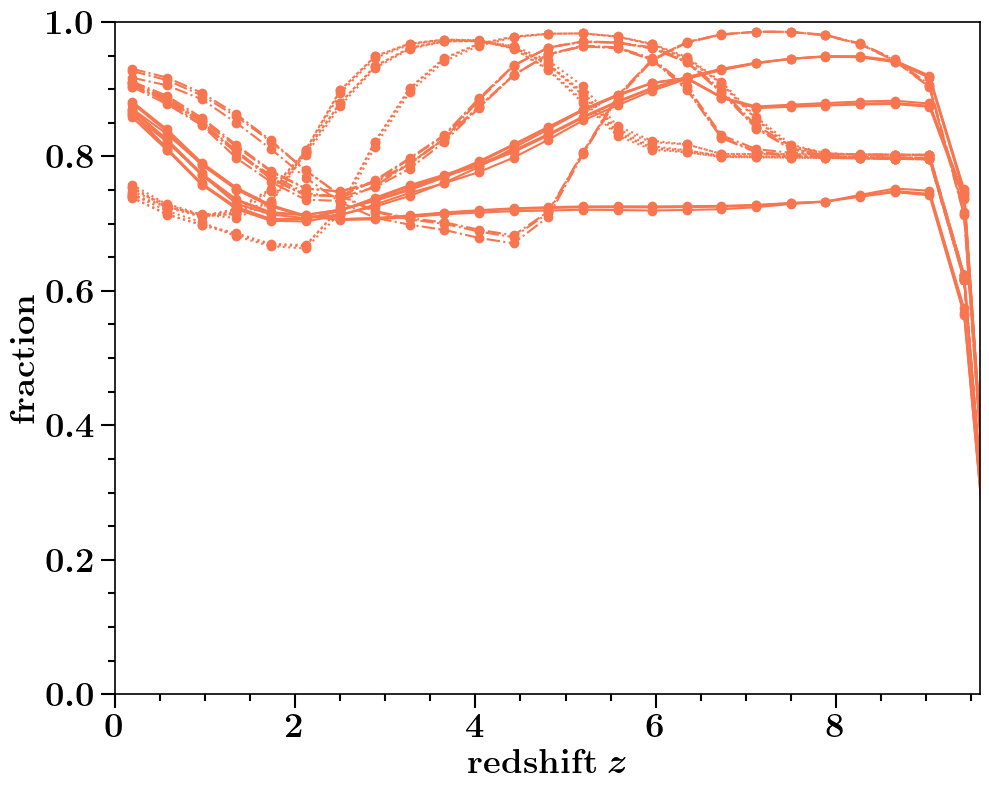

at BPS model  C


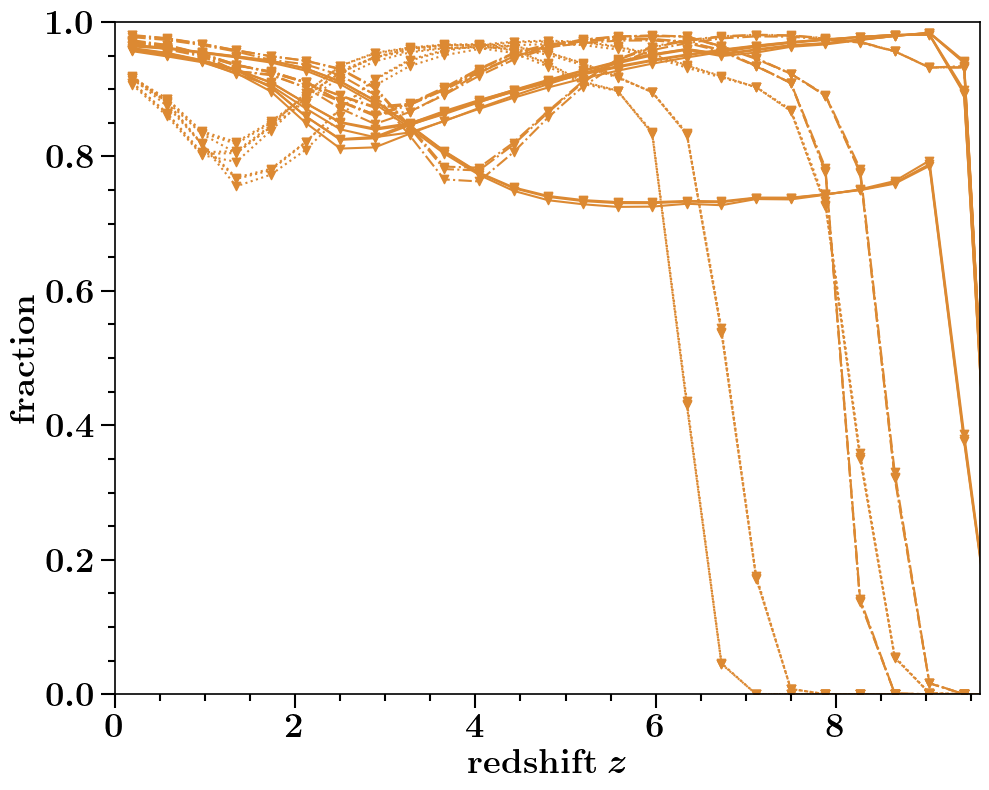

at BPS model  D


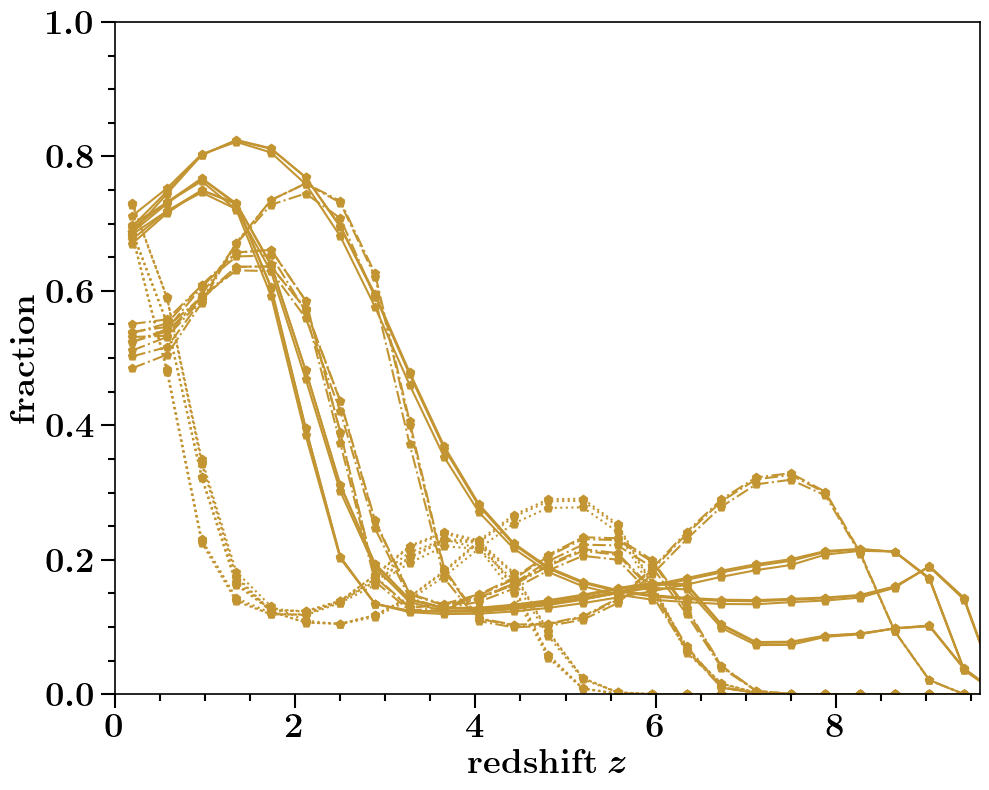

at BPS model  E


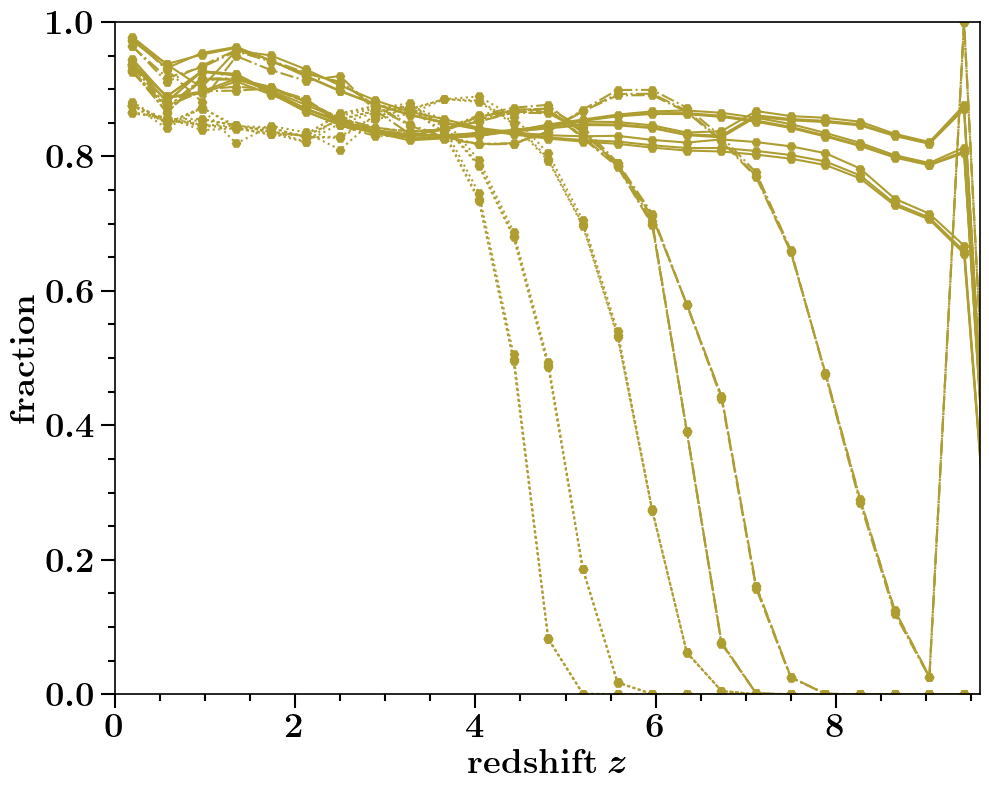

at BPS model  F


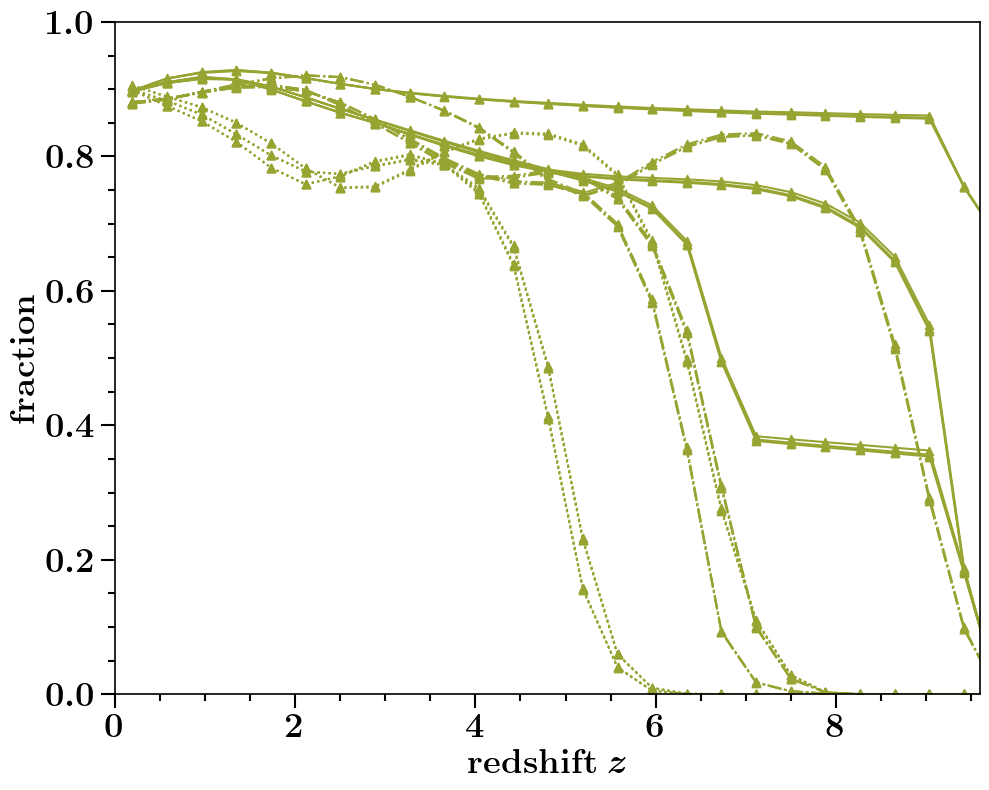

at BPS model  G


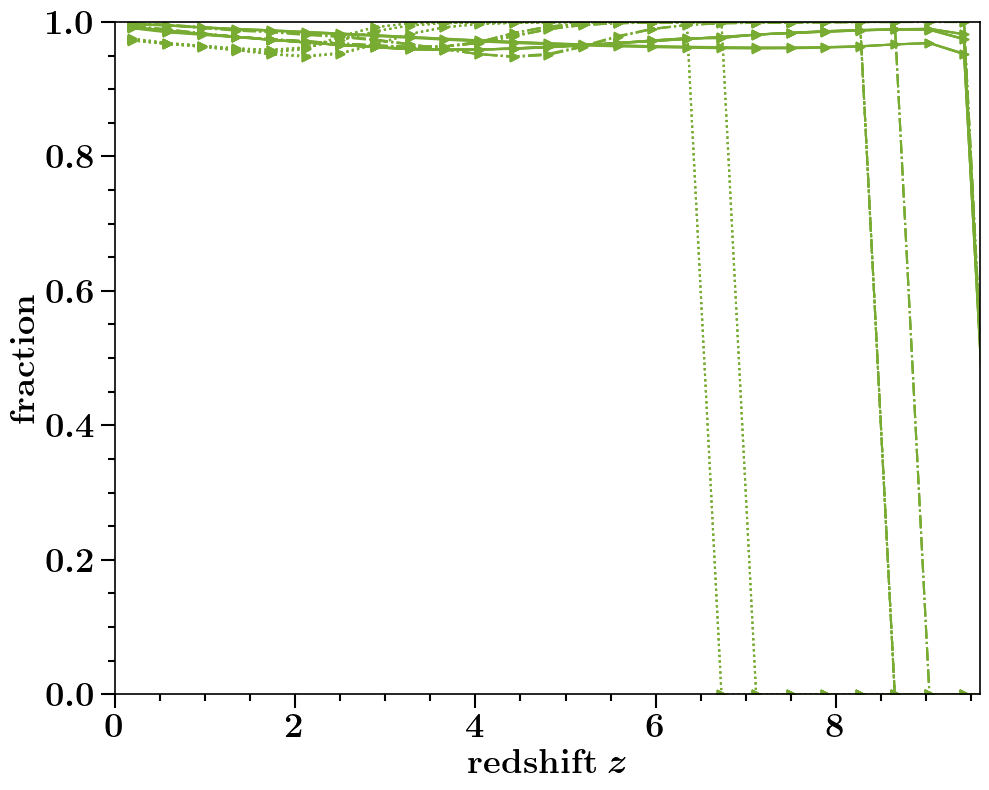

at BPS model  H


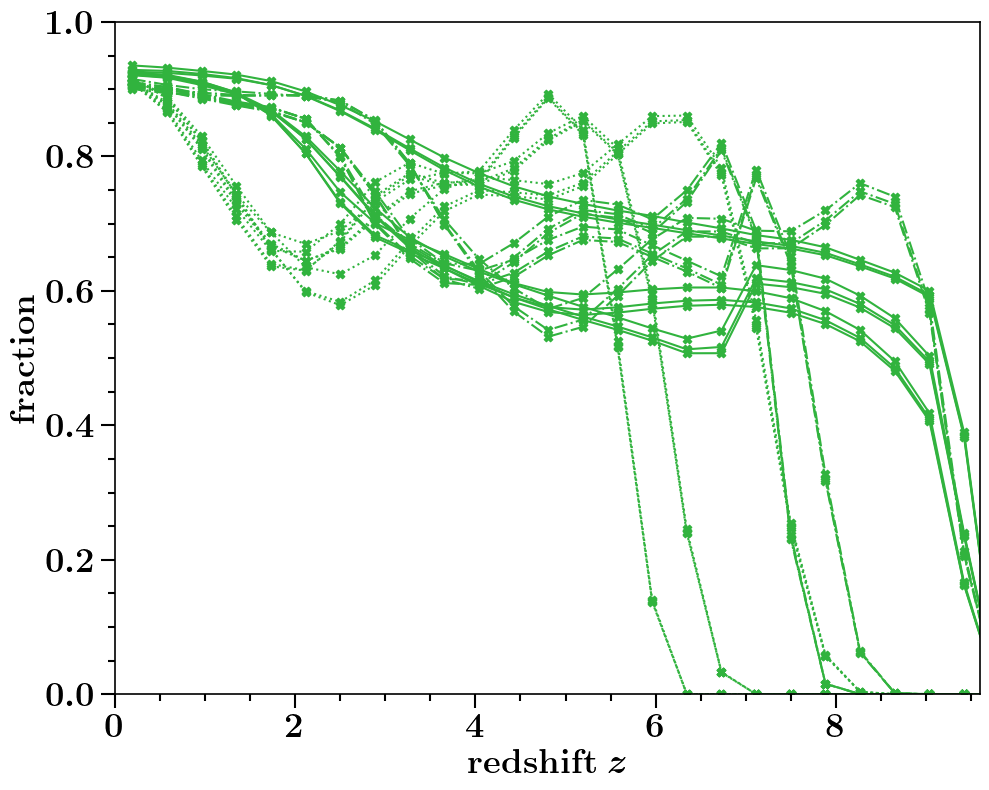

at BPS model  I


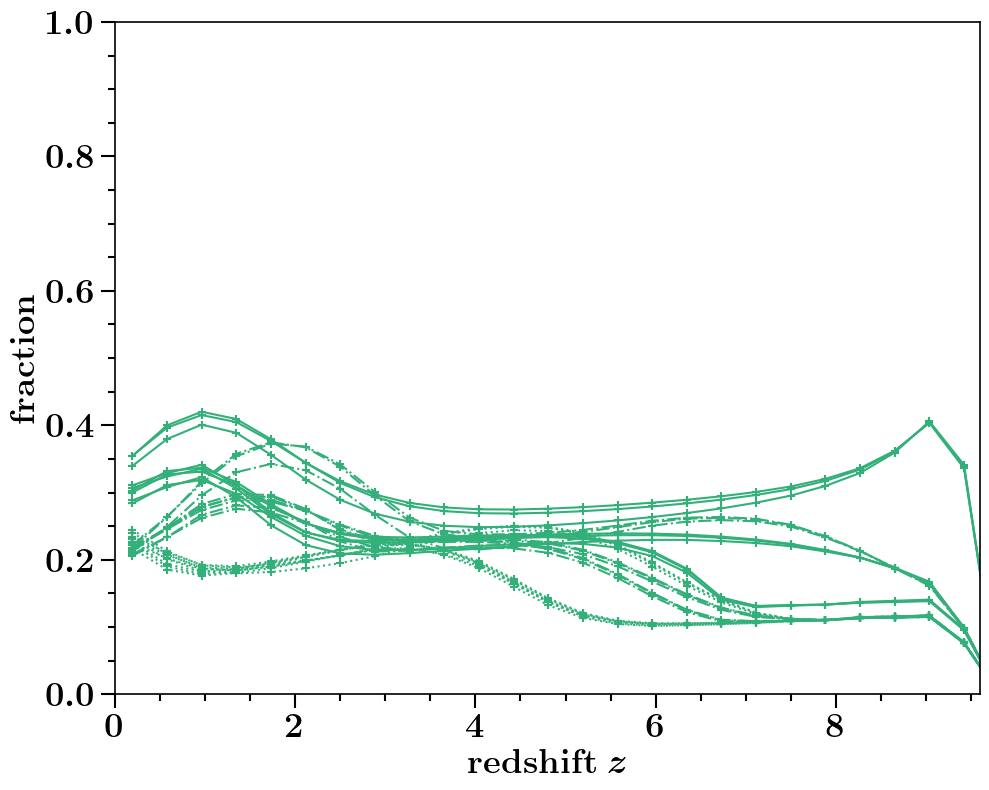

at BPS model  J


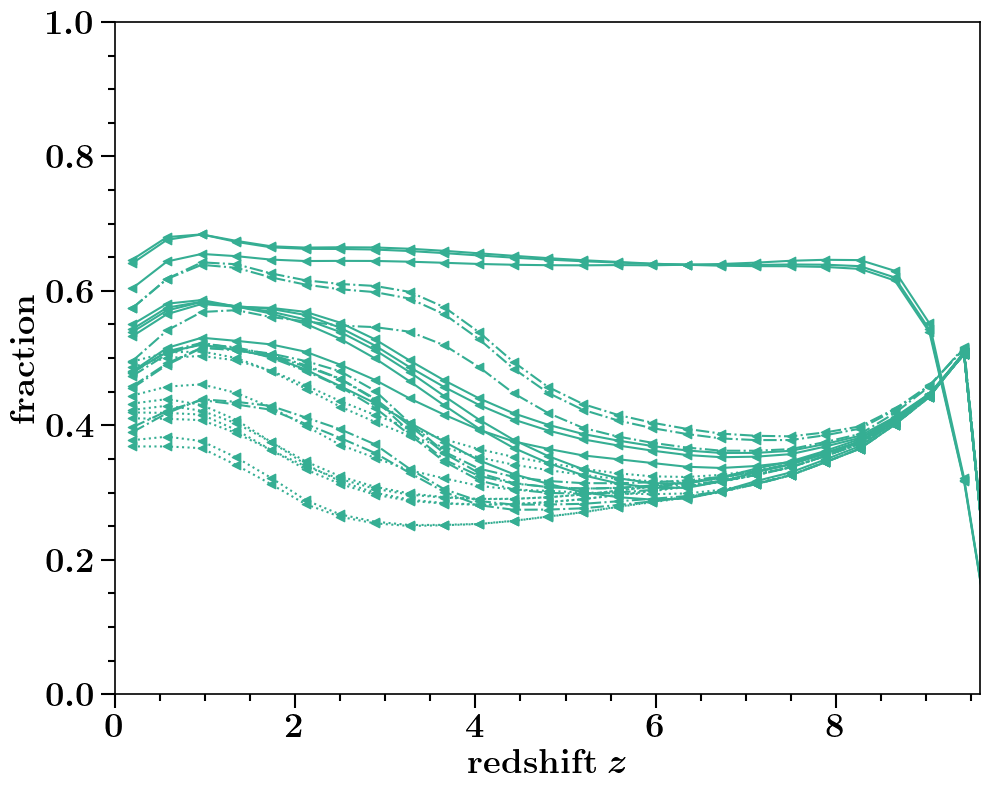

at BPS model  K


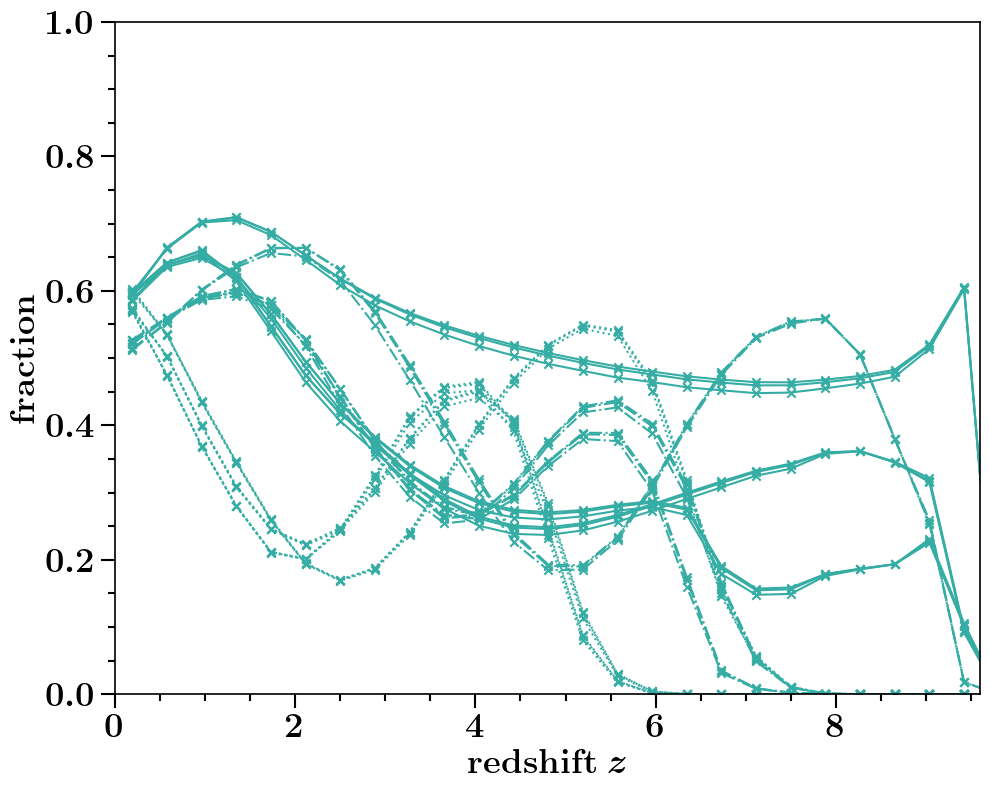

at BPS model  L


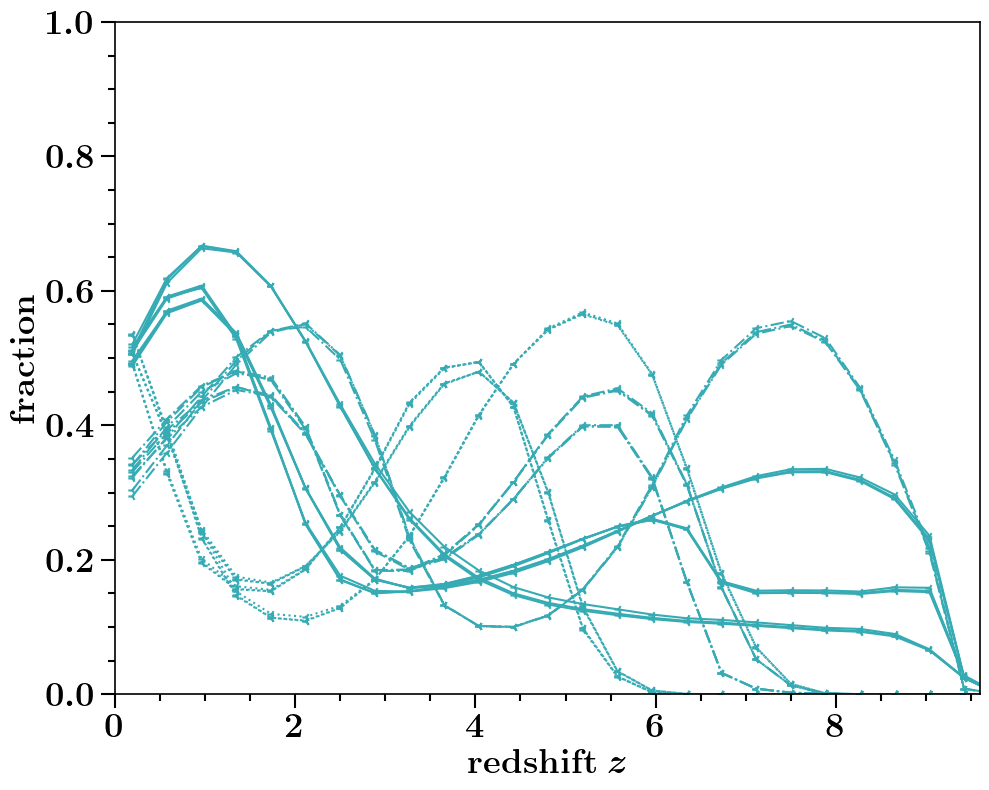

at BPS model  M


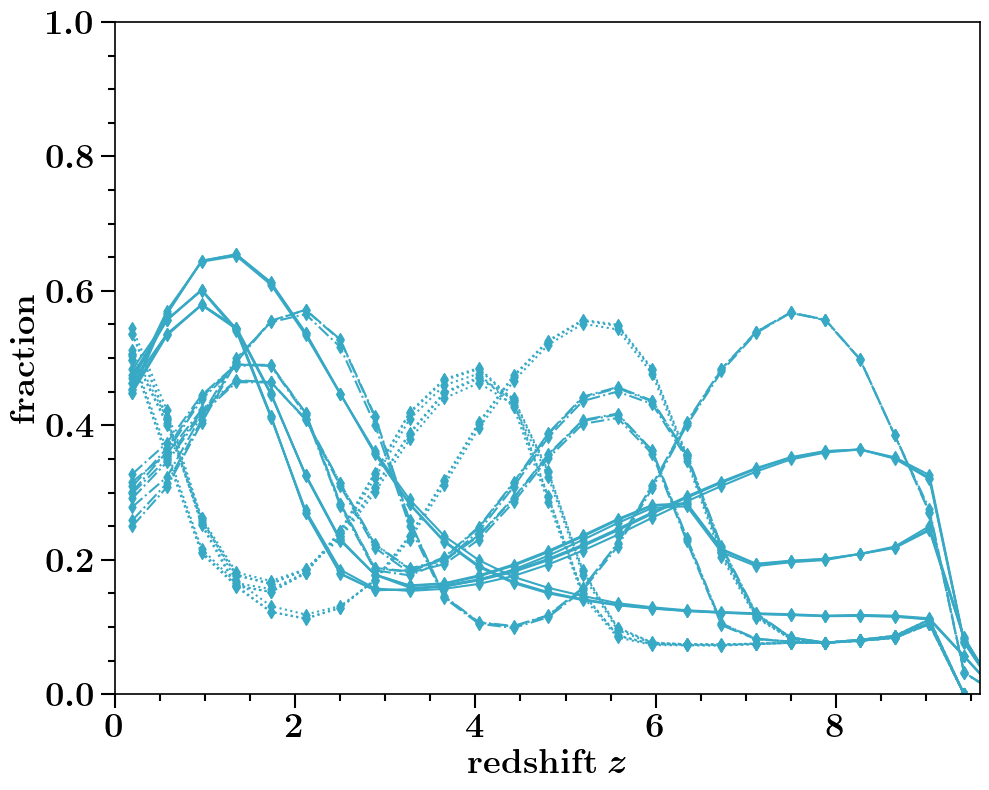

at BPS model  N


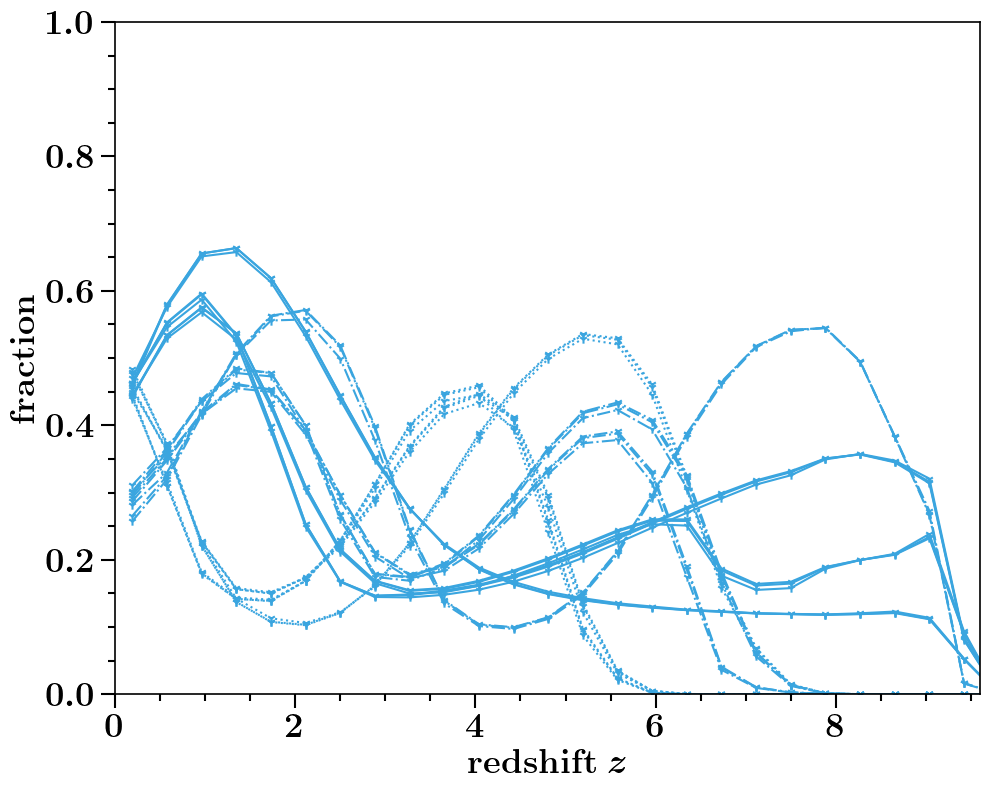

at BPS model  O


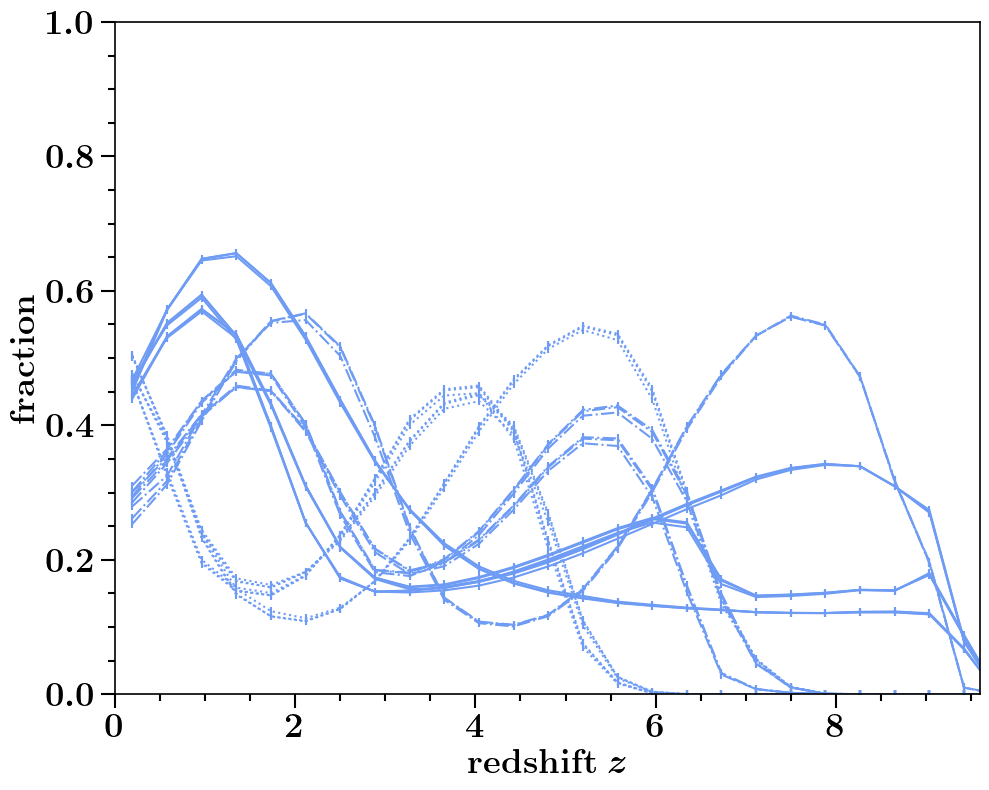

at BPS model  P


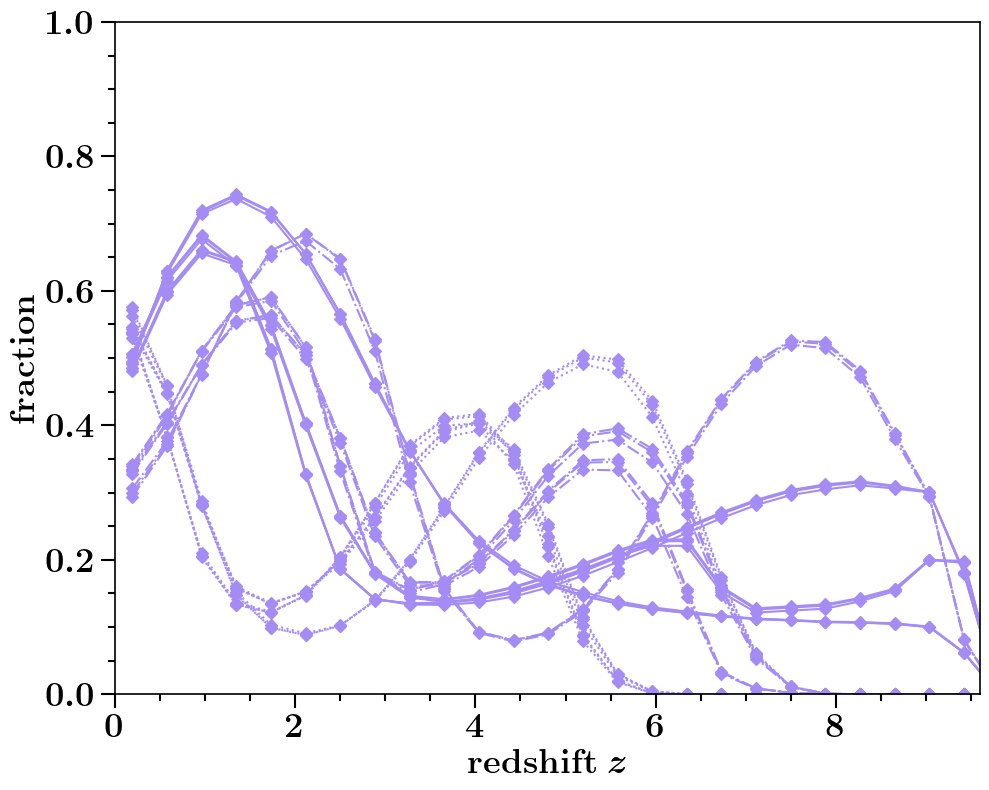

at BPS model  Q


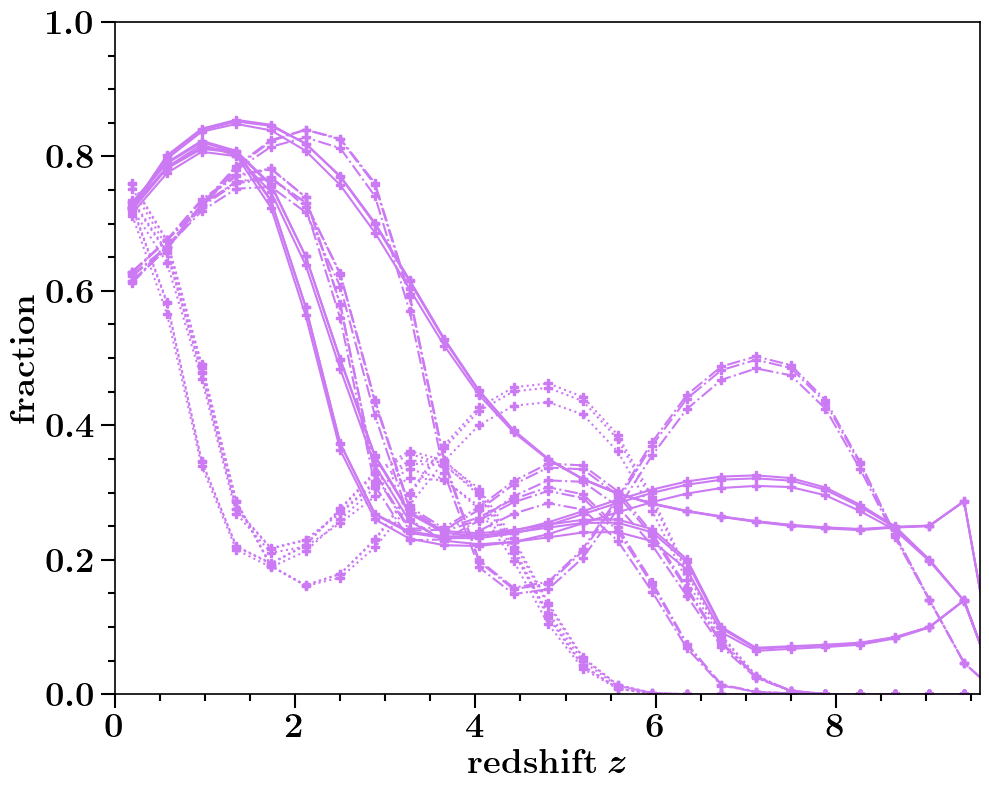

at BPS model  R


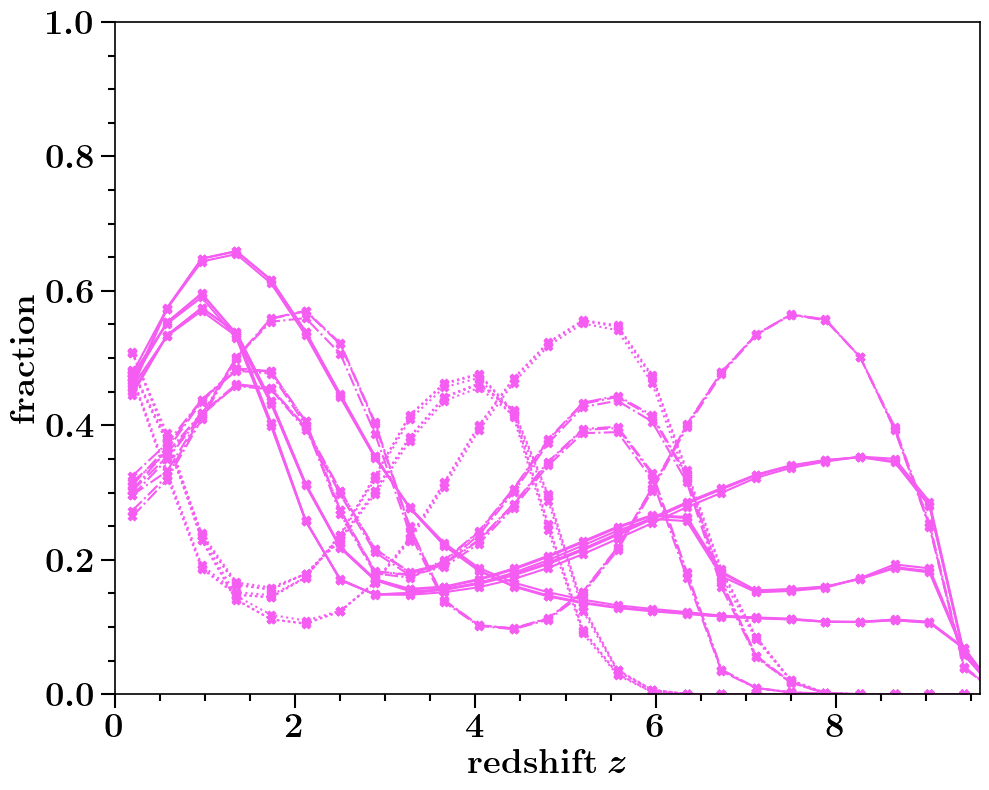

at BPS model  S


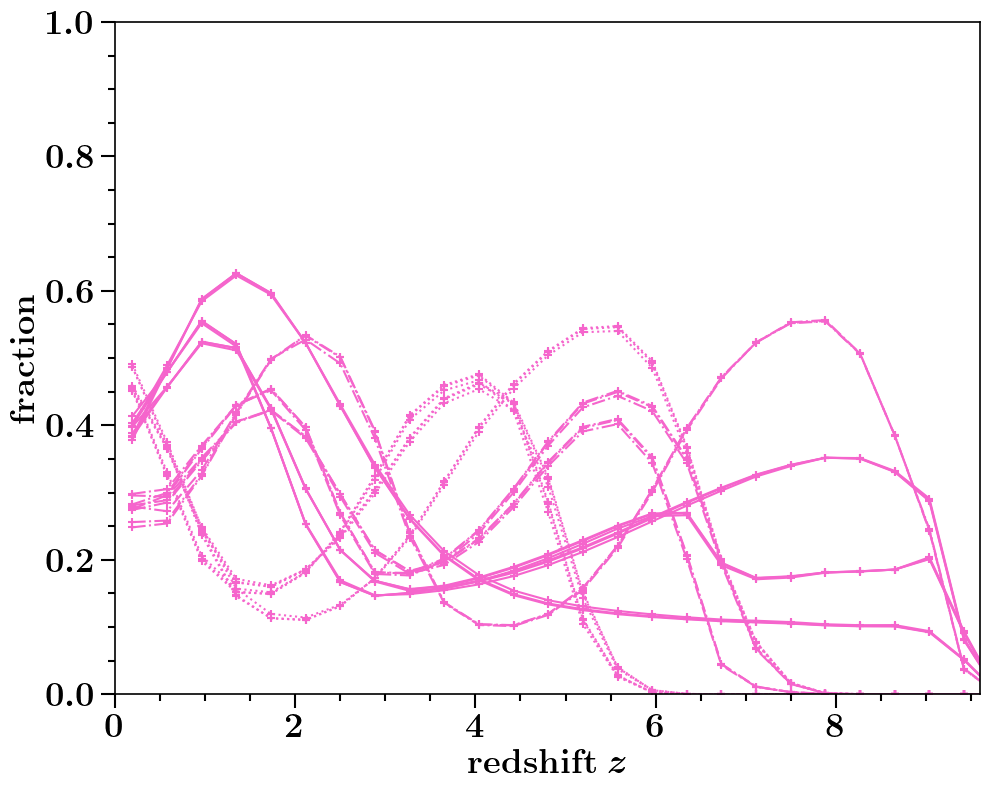

at BPS model  T


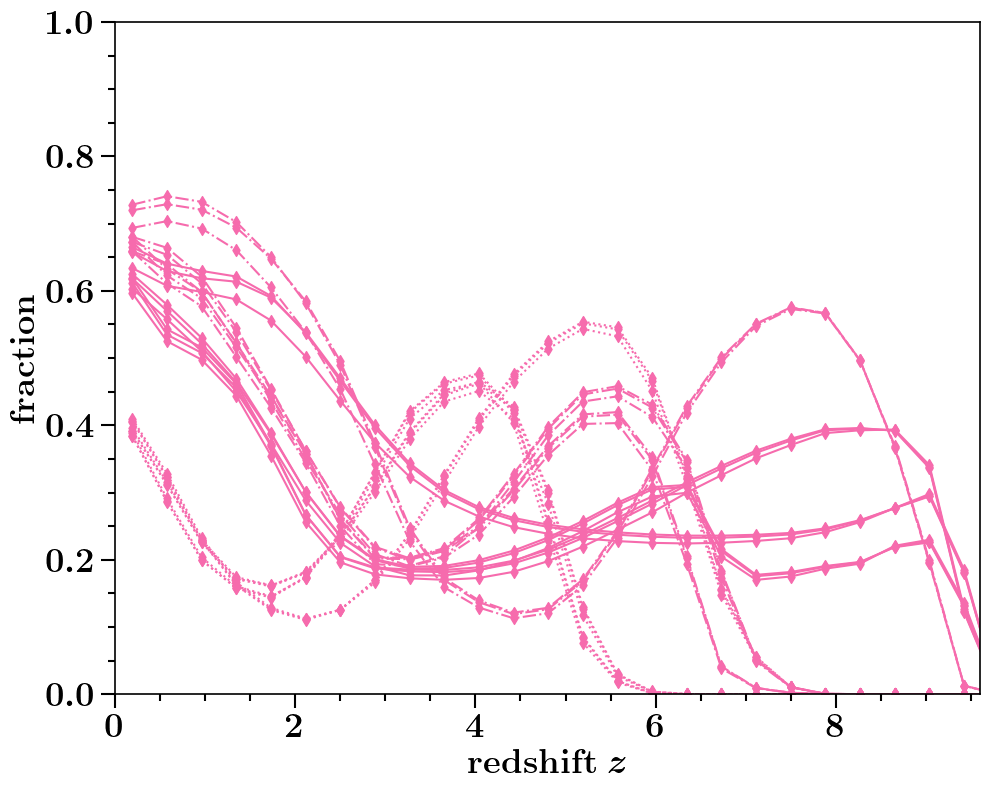


at DCOtype = BHNS
at BPS model  A


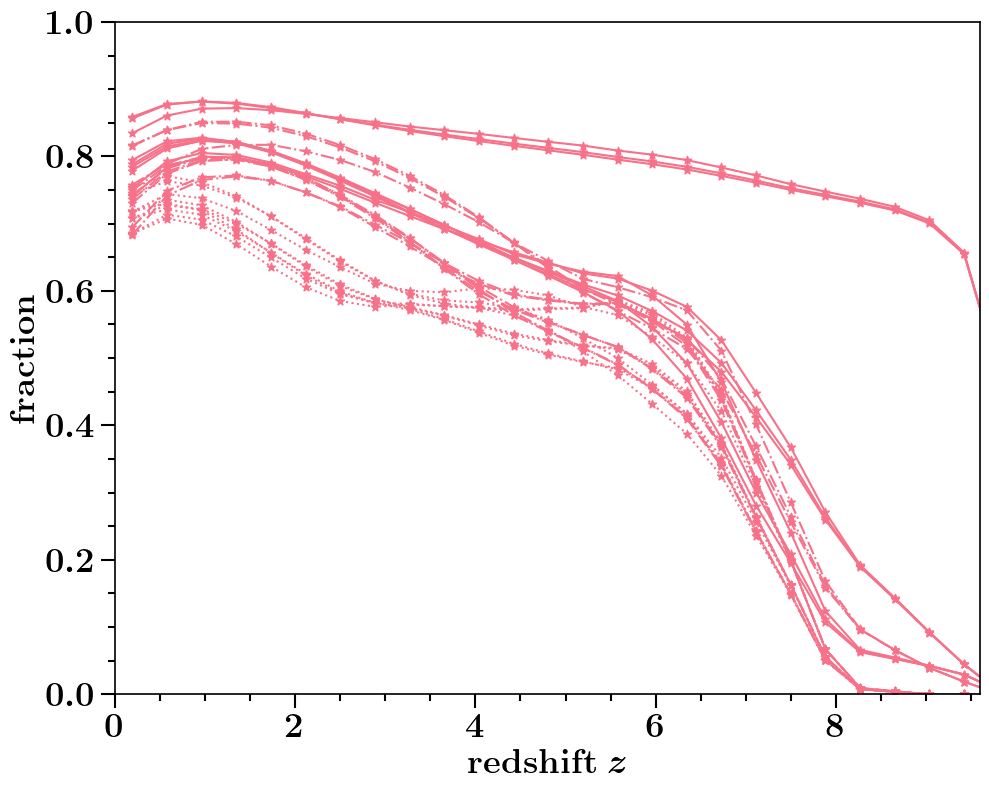

at BPS model  B


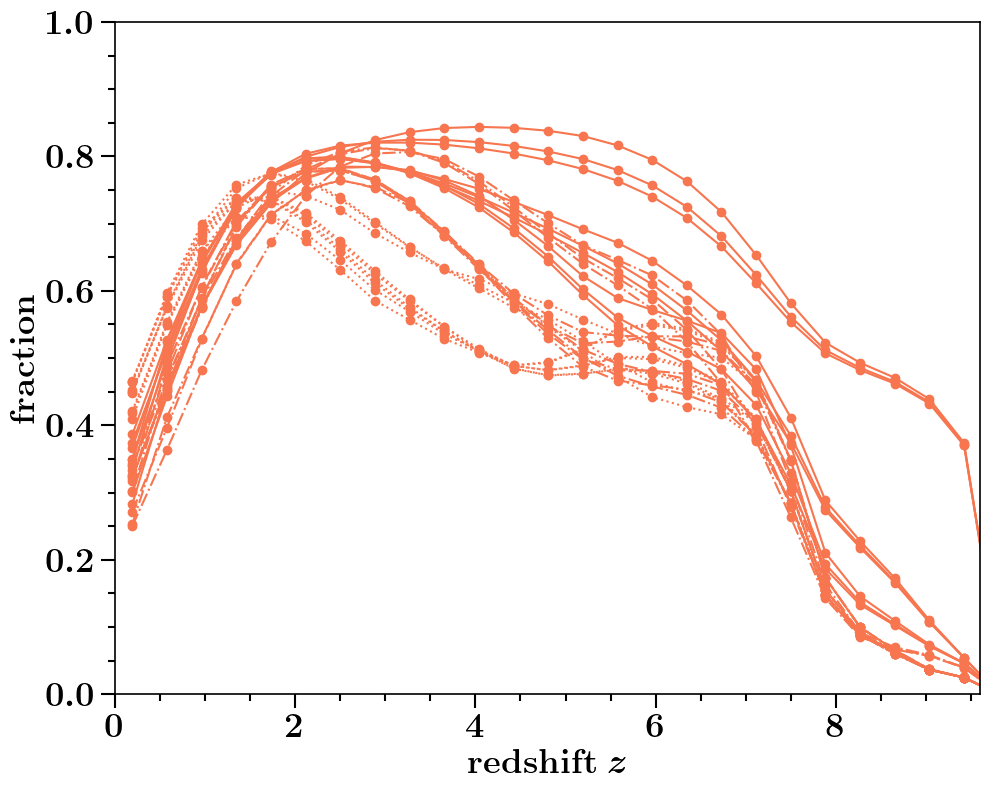

at BPS model  C


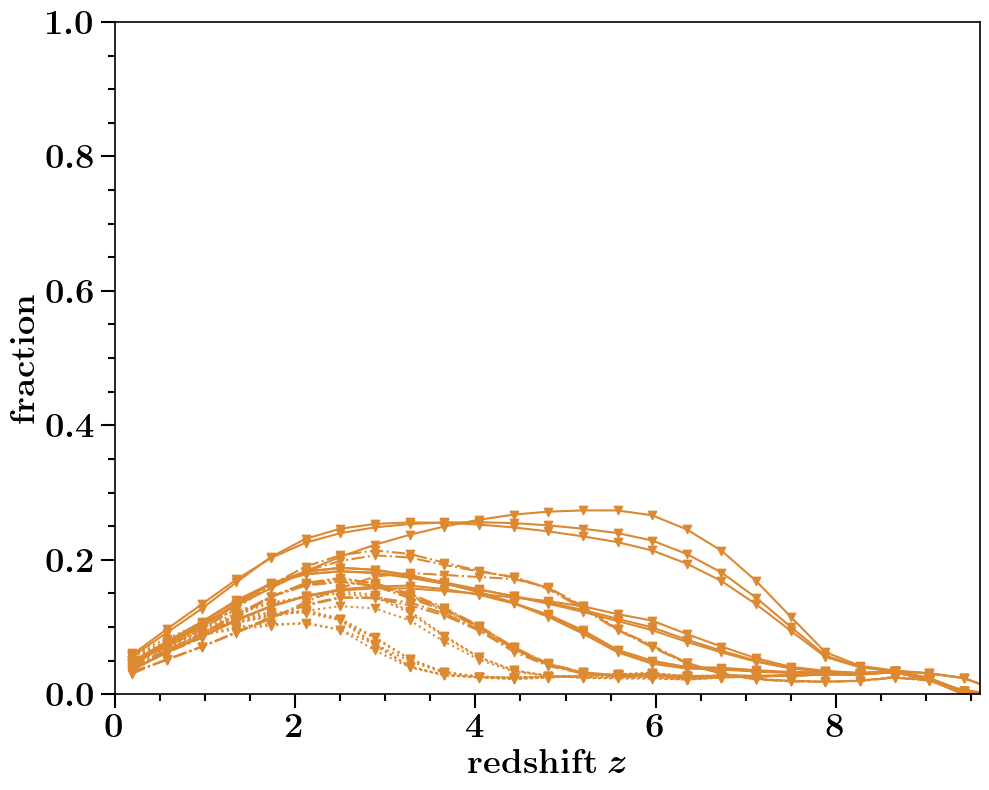

at BPS model  D


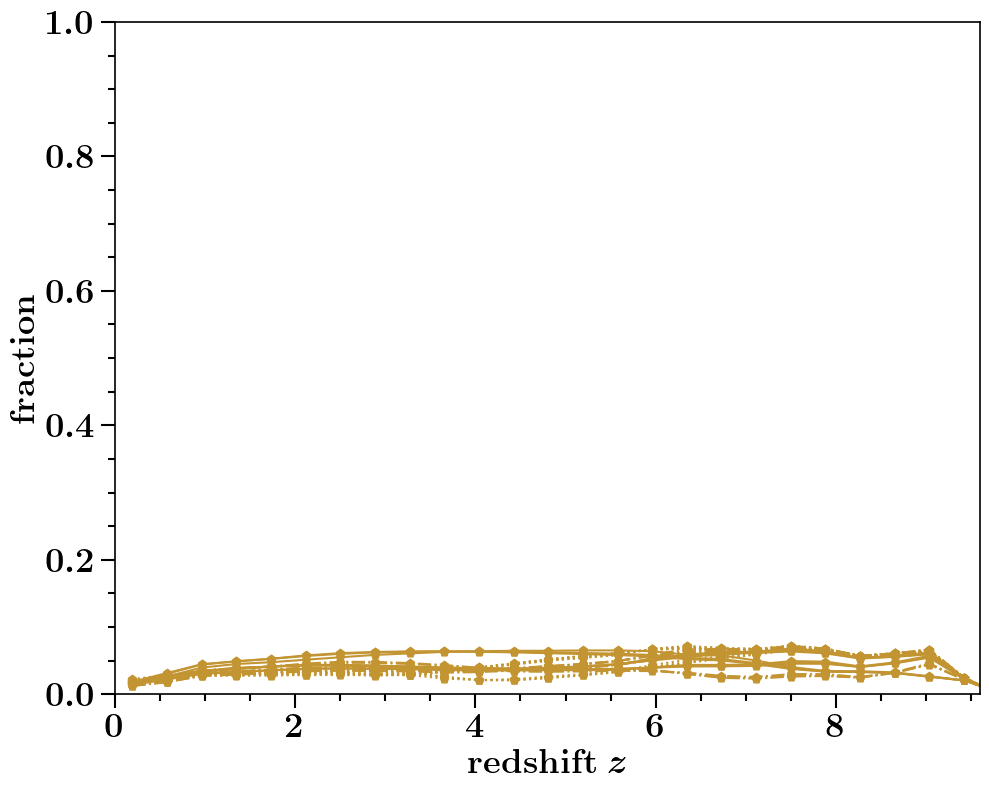

at BPS model  E


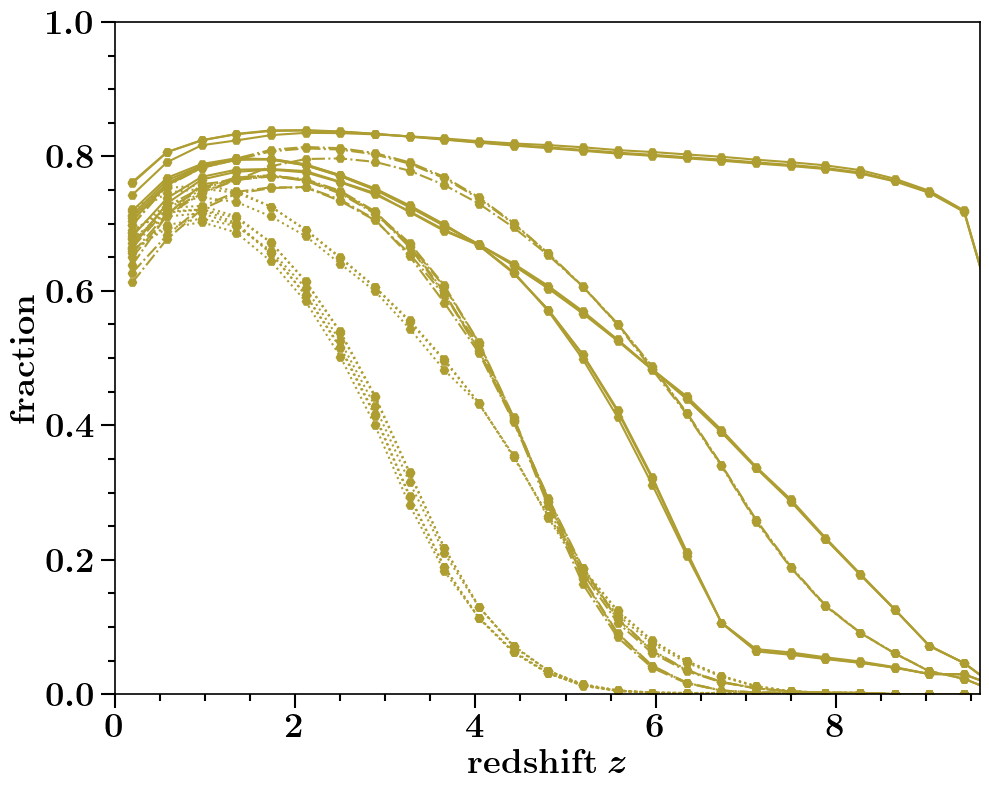

at BPS model  F


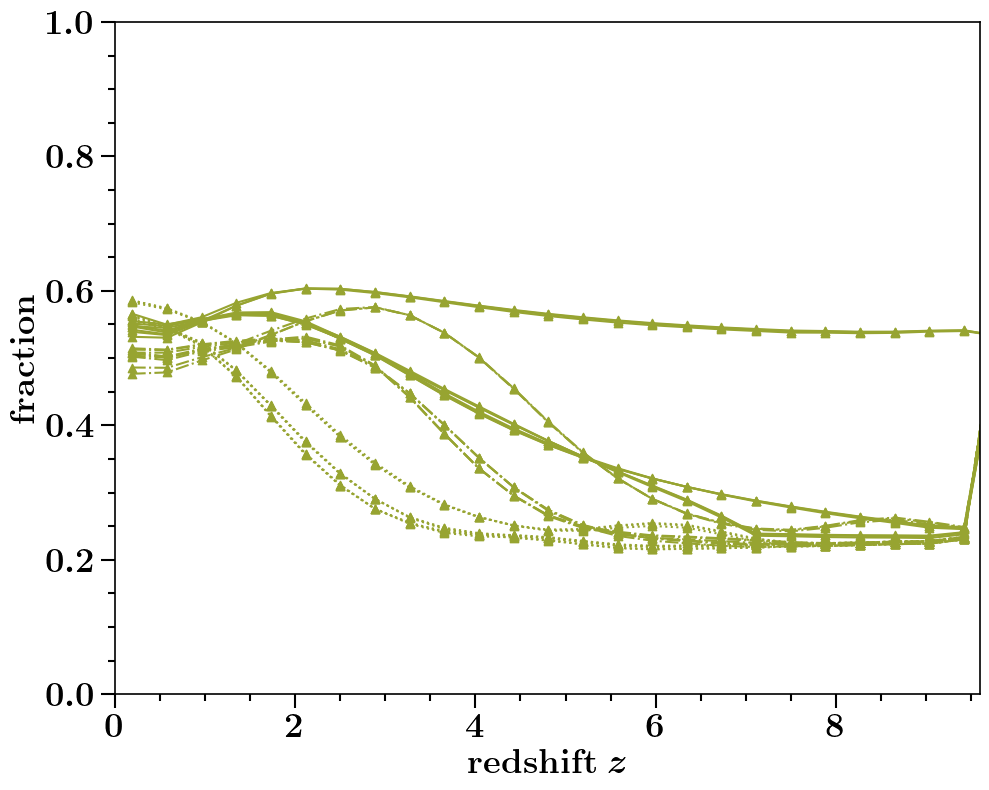

at BPS model  G


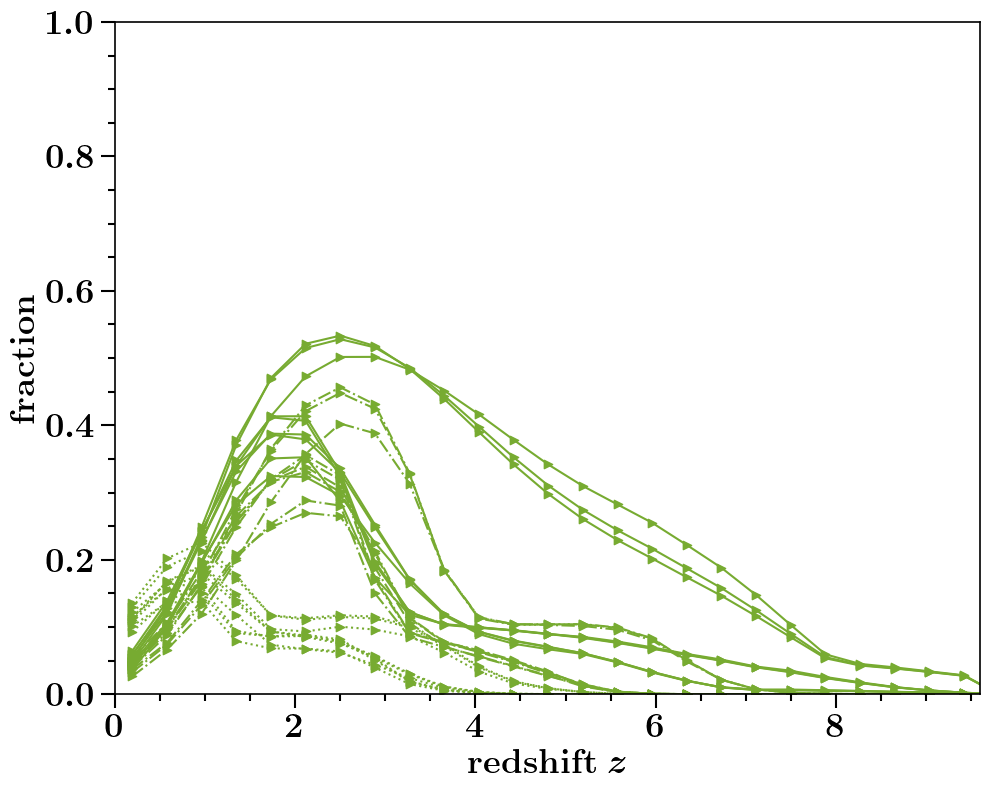

at BPS model  H


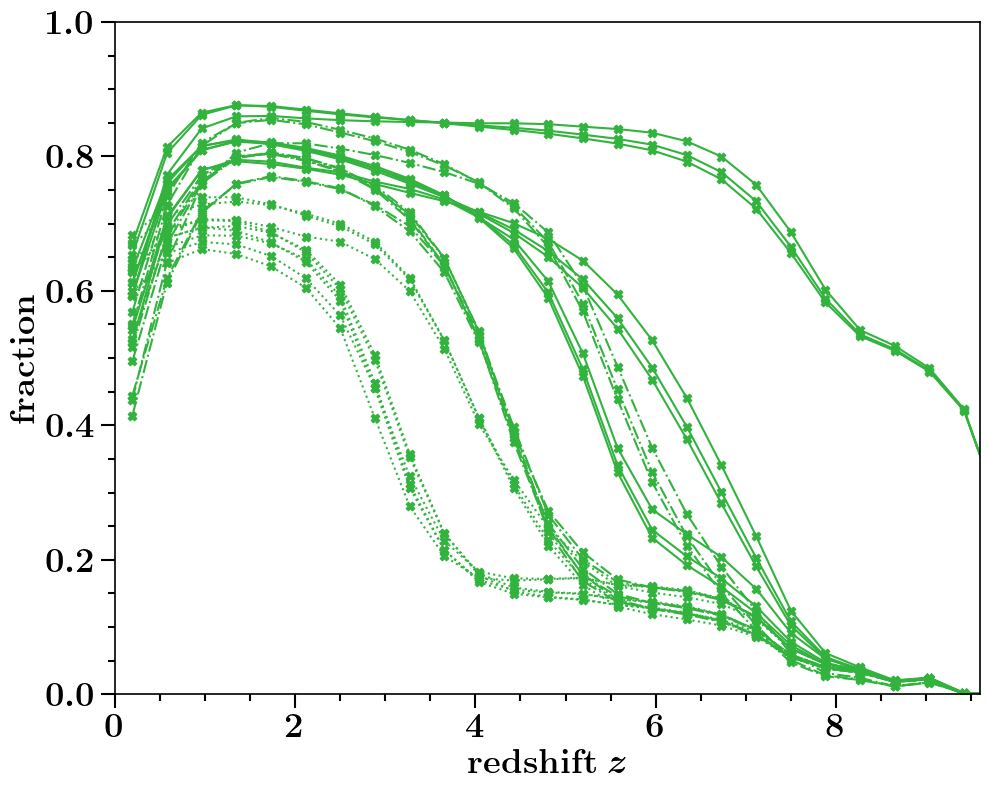

at BPS model  I


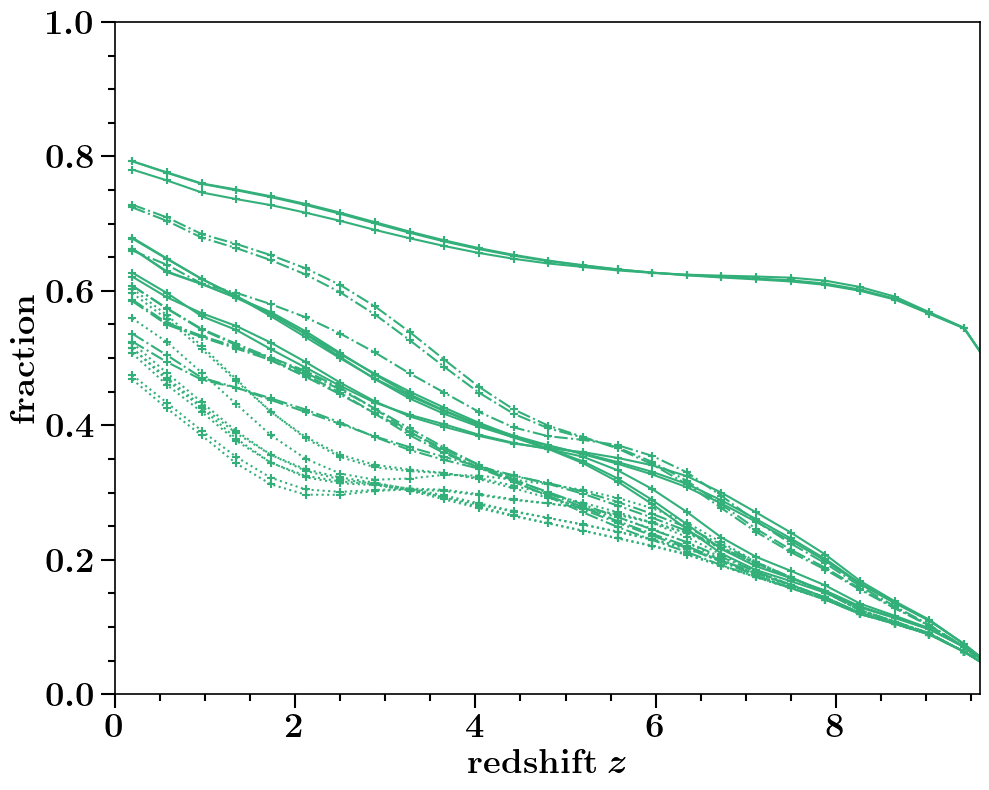

at BPS model  J


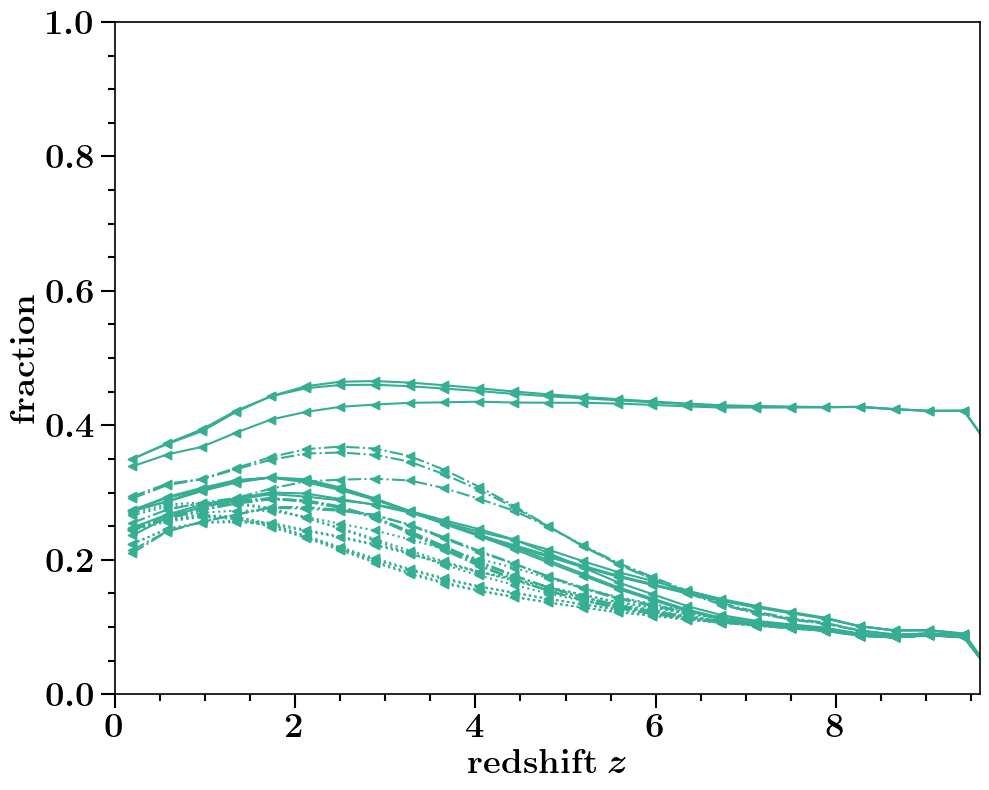

at BPS model  K


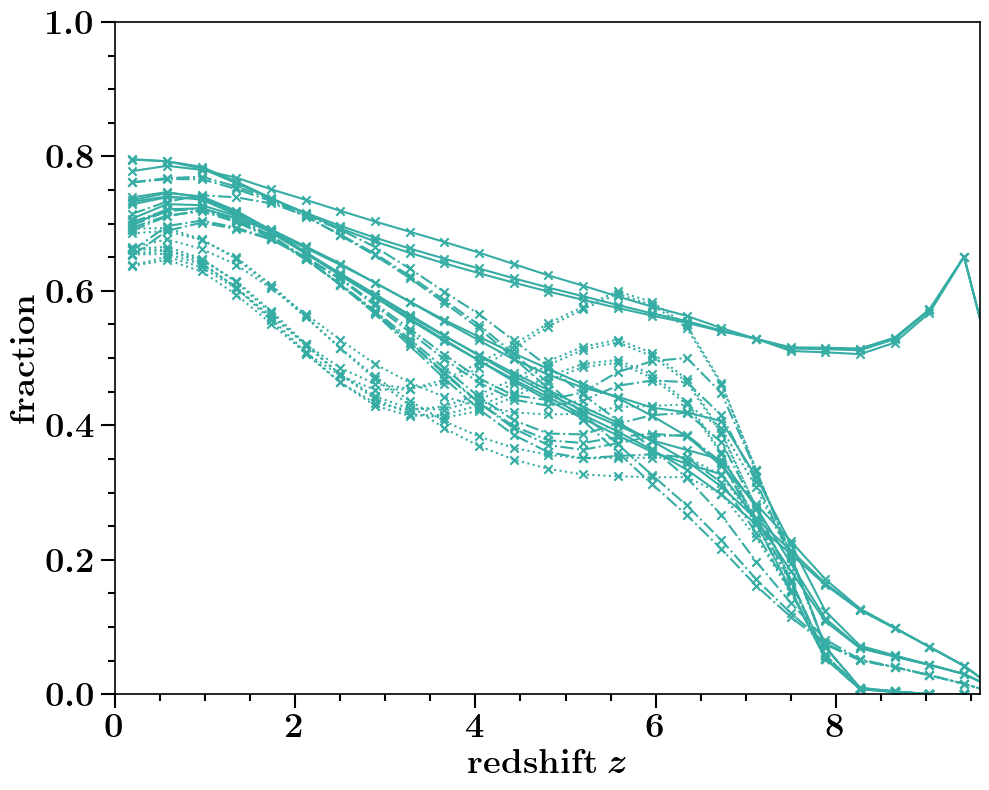

at BPS model  L


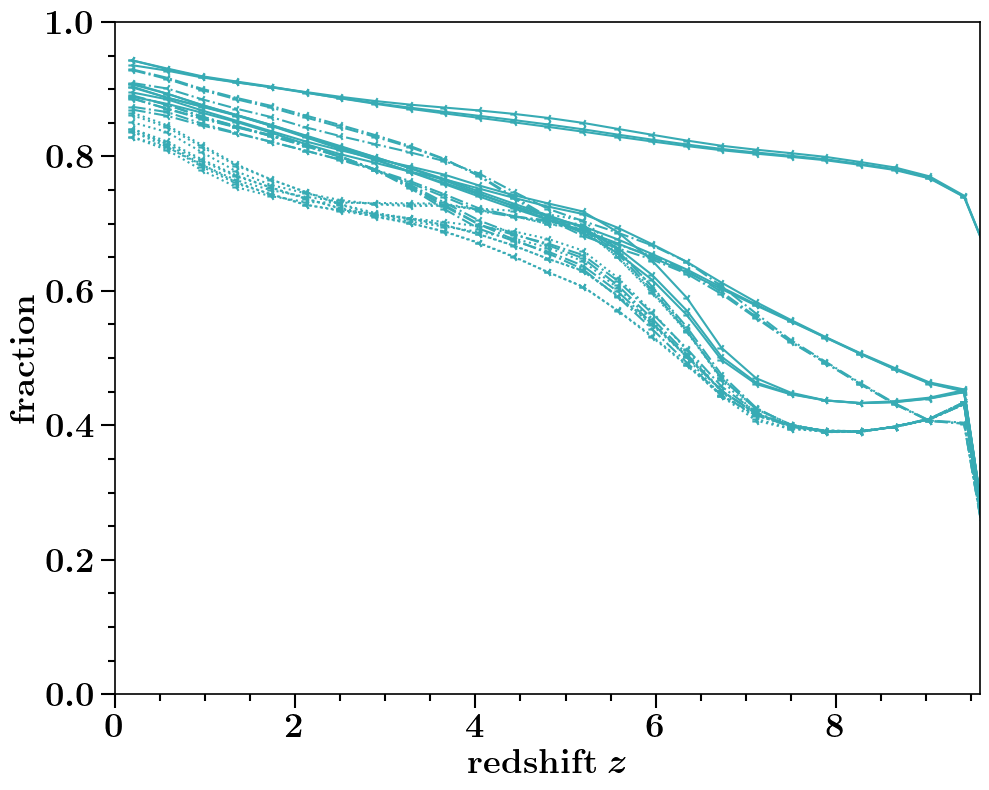

at BPS model  M


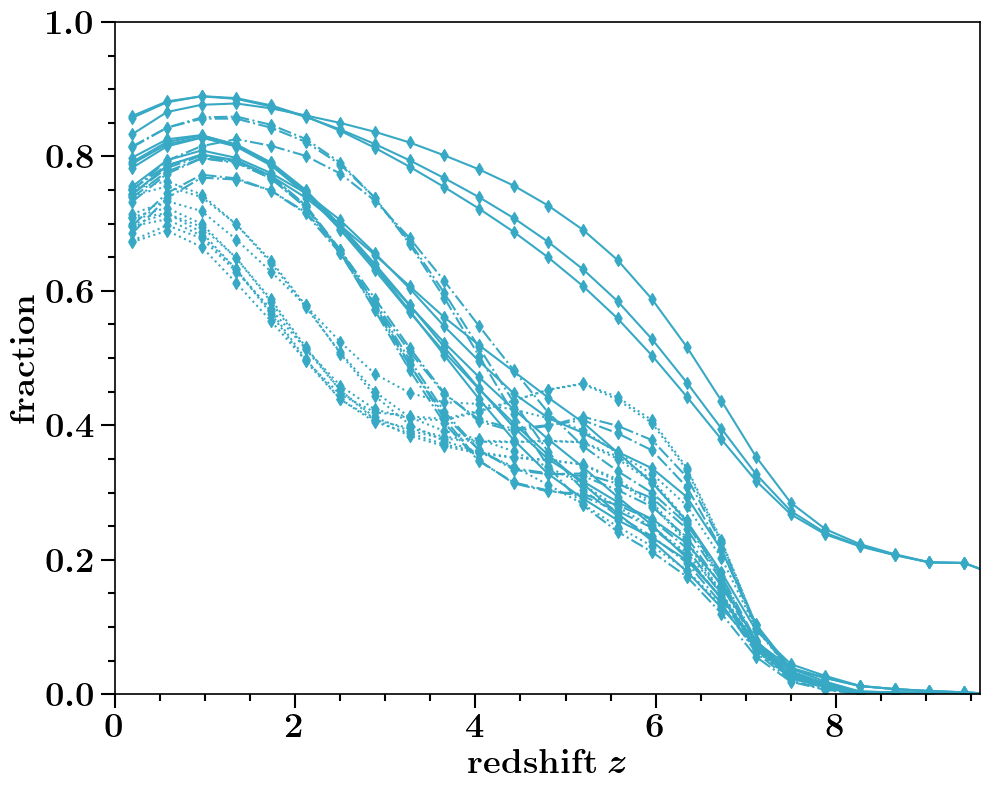

at BPS model  N


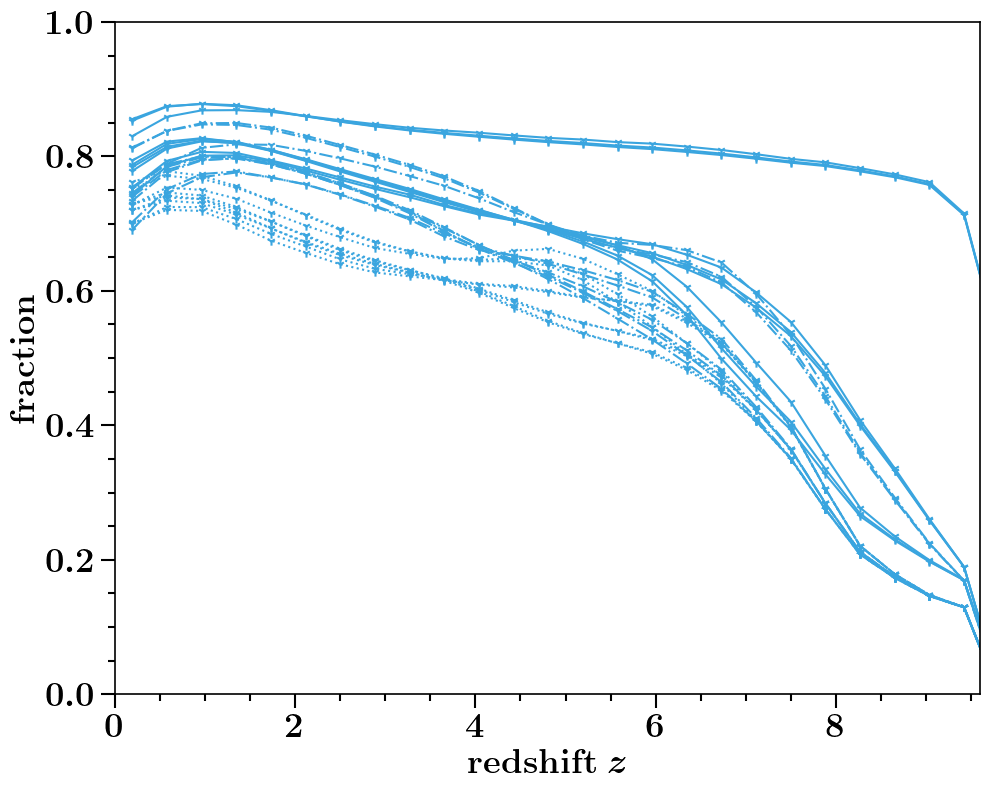

at BPS model  O


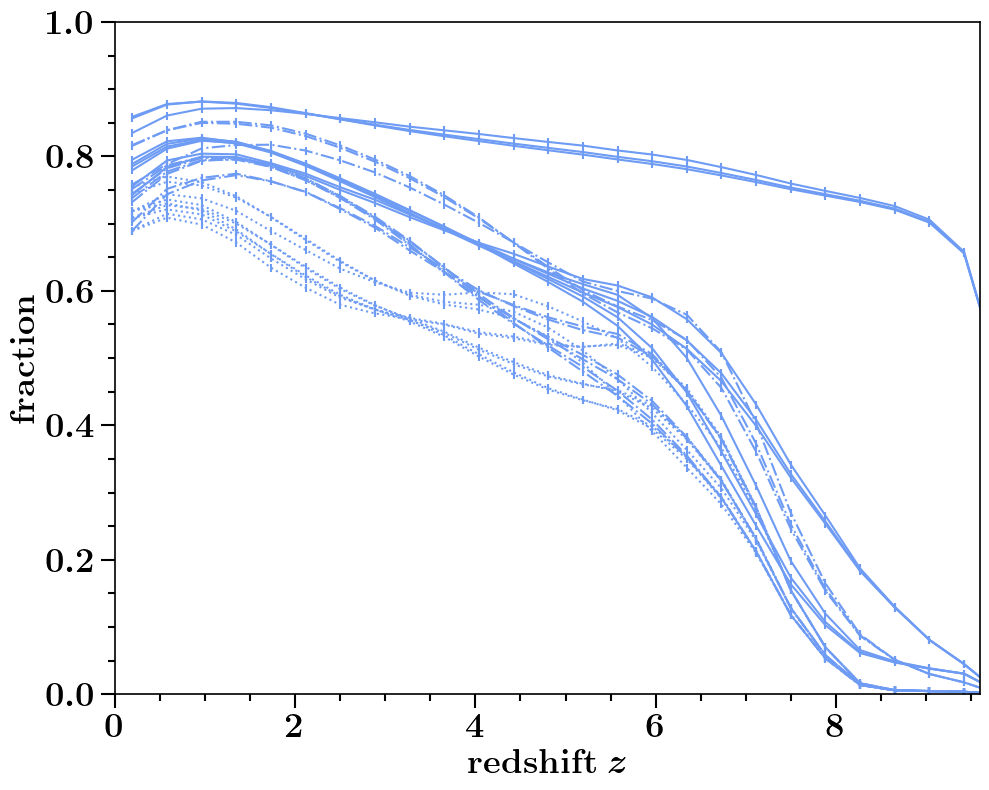

at BPS model  P


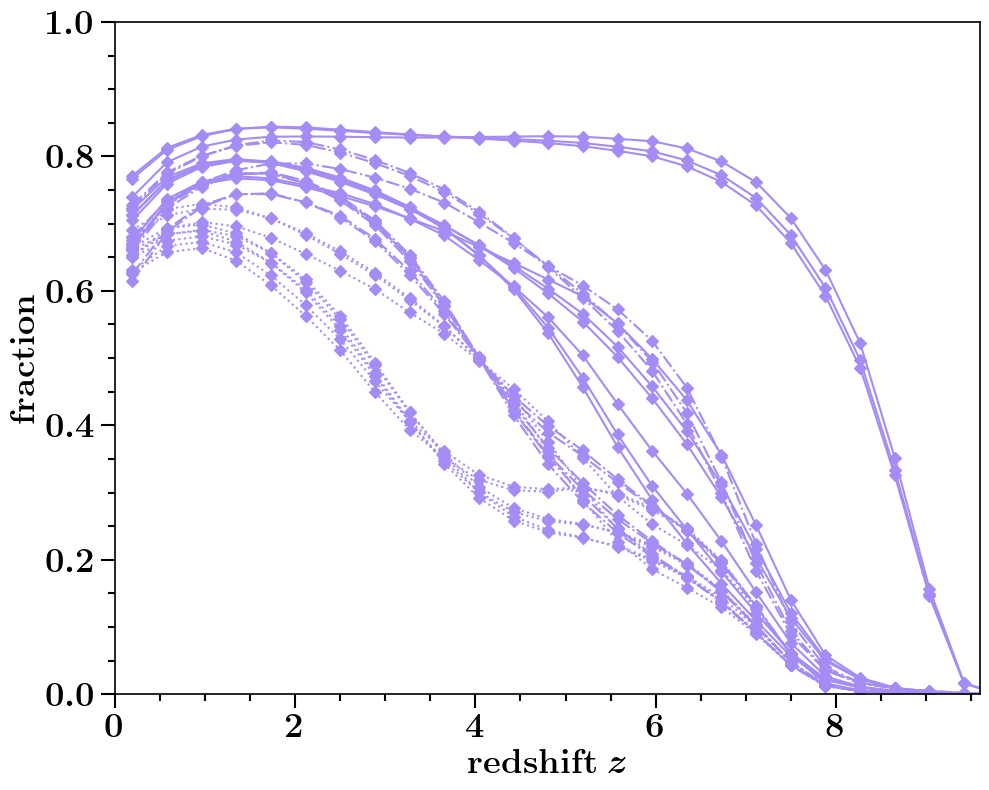

at BPS model  Q


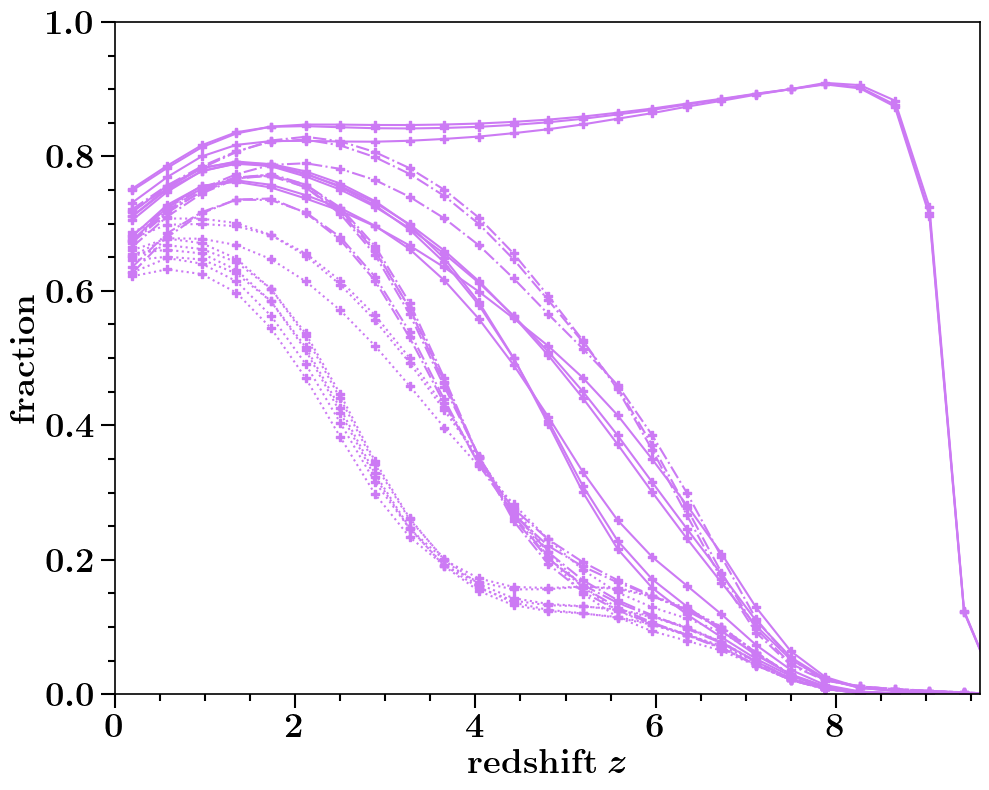

at BPS model  R


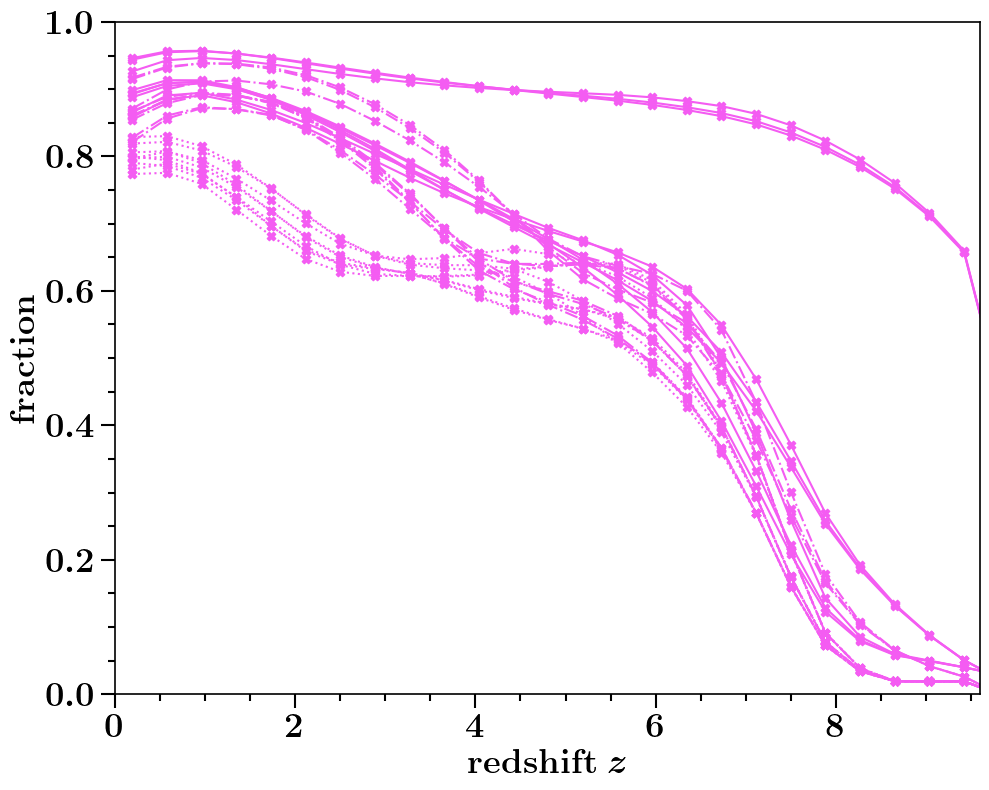

at BPS model  S


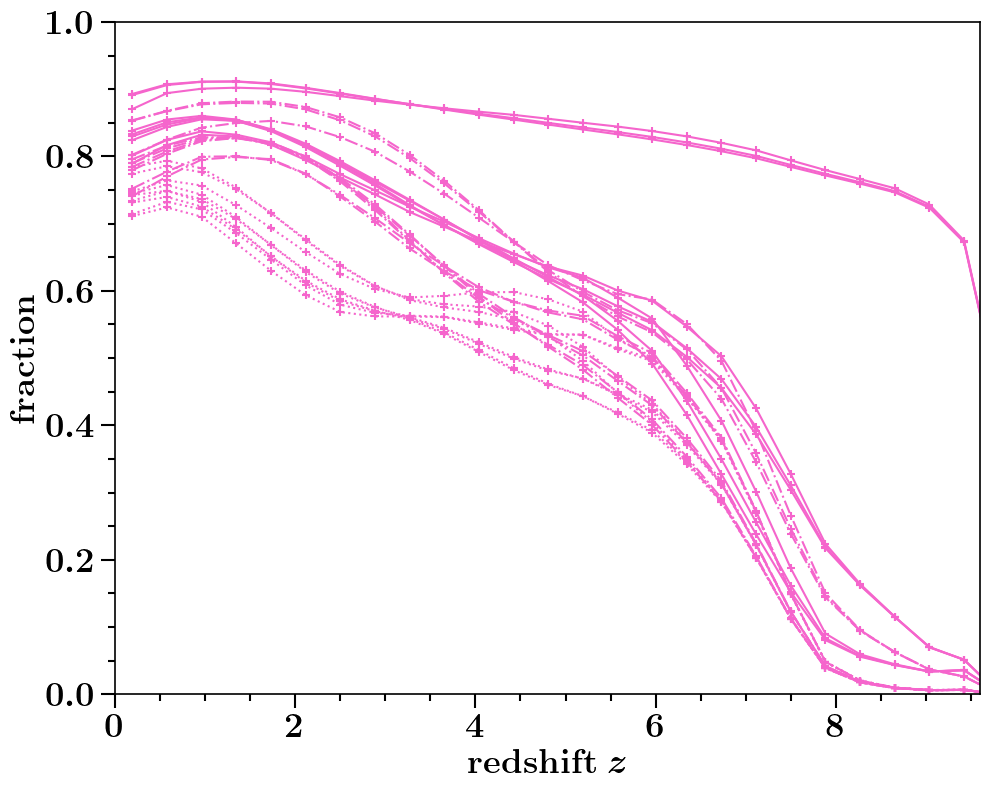

at BPS model  T


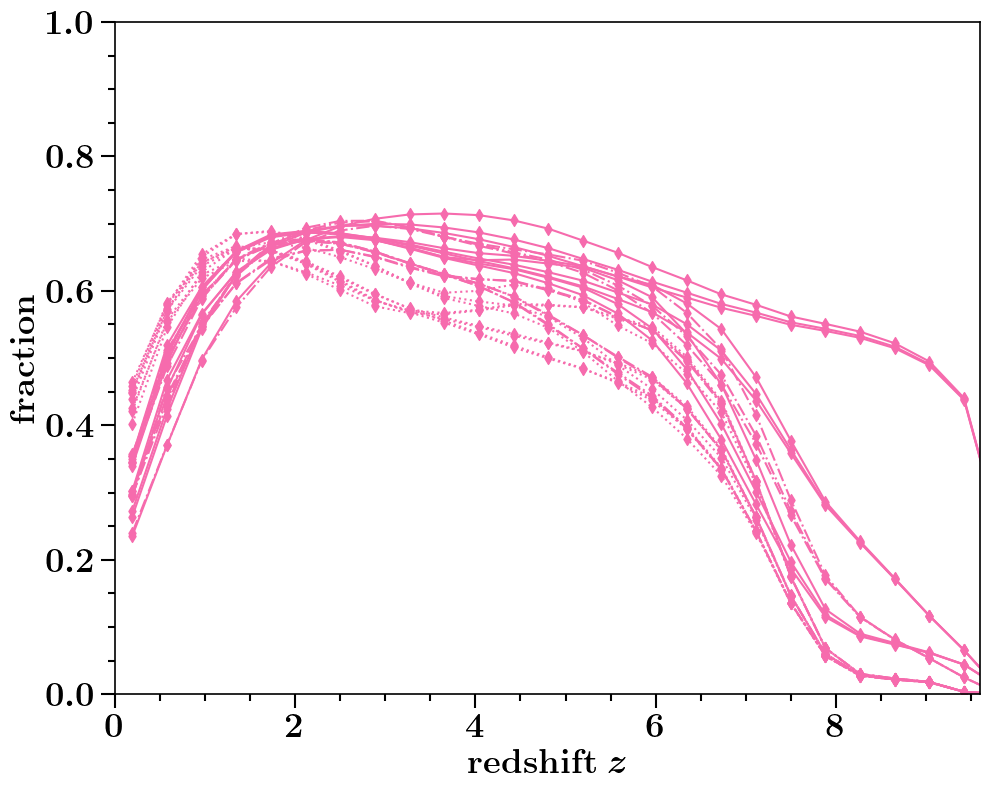


at DCOtype = BBH
at BPS model  A


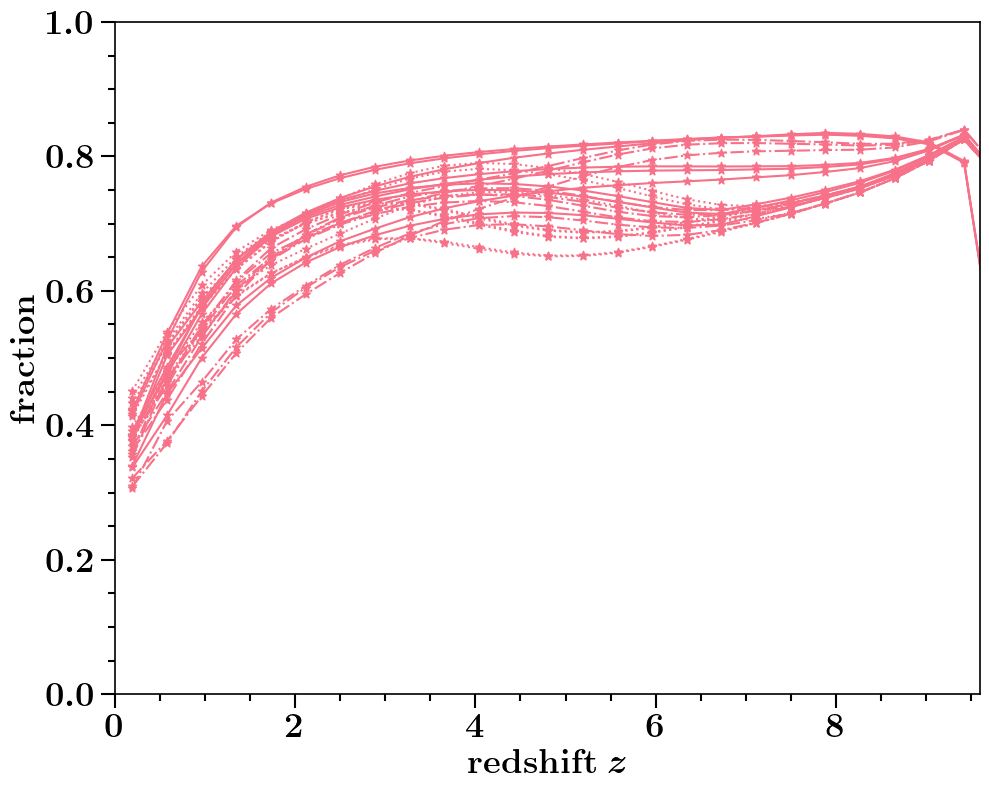

at BPS model  B


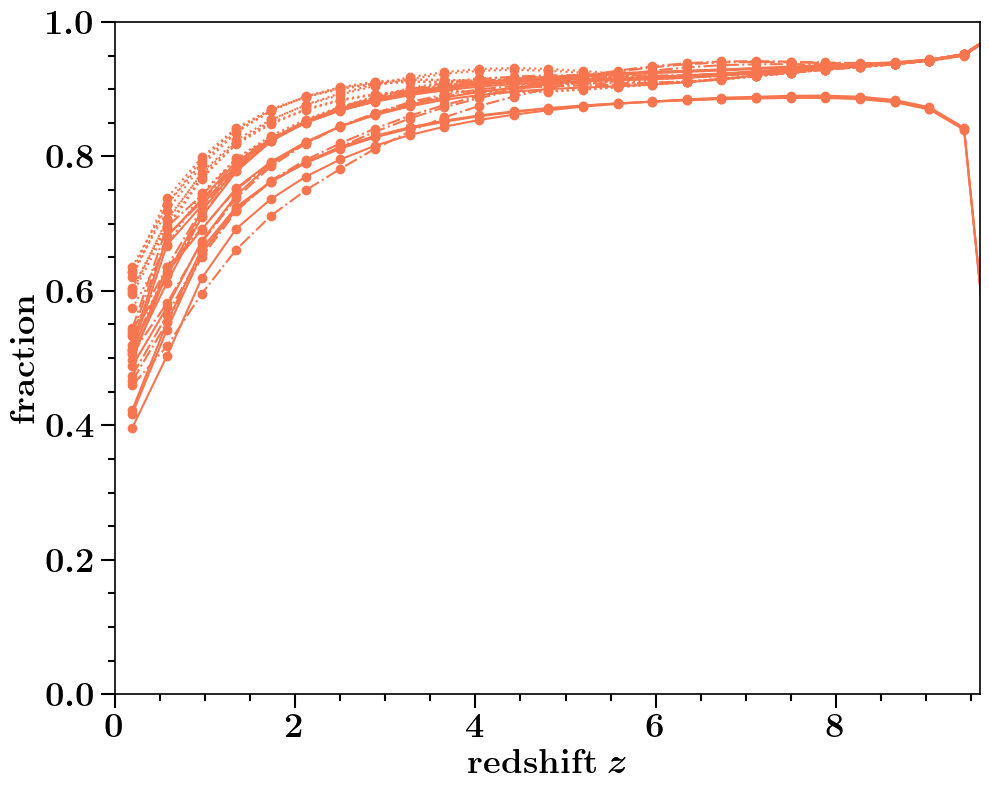

at BPS model  C


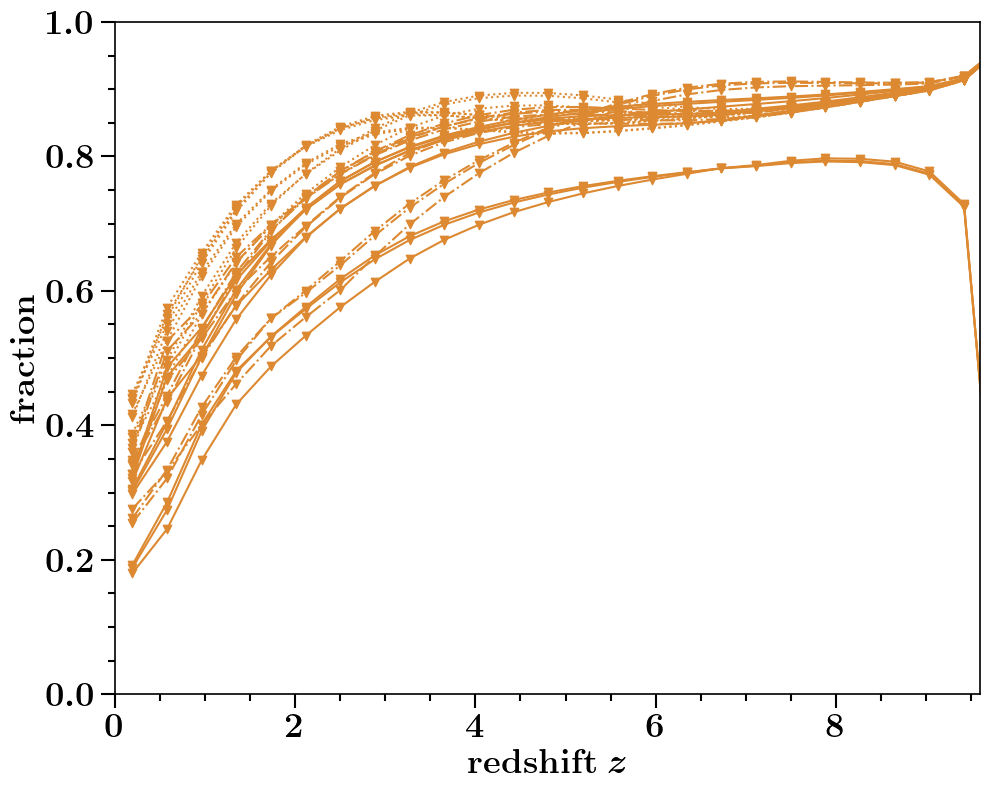

at BPS model  D


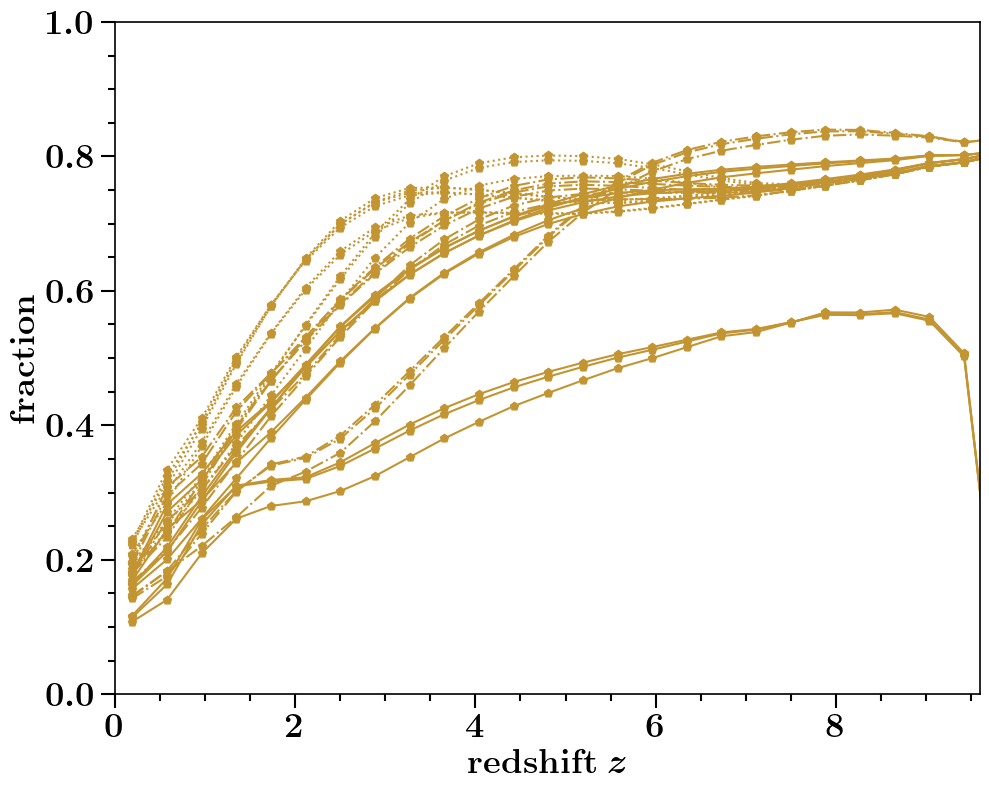

at BPS model  E


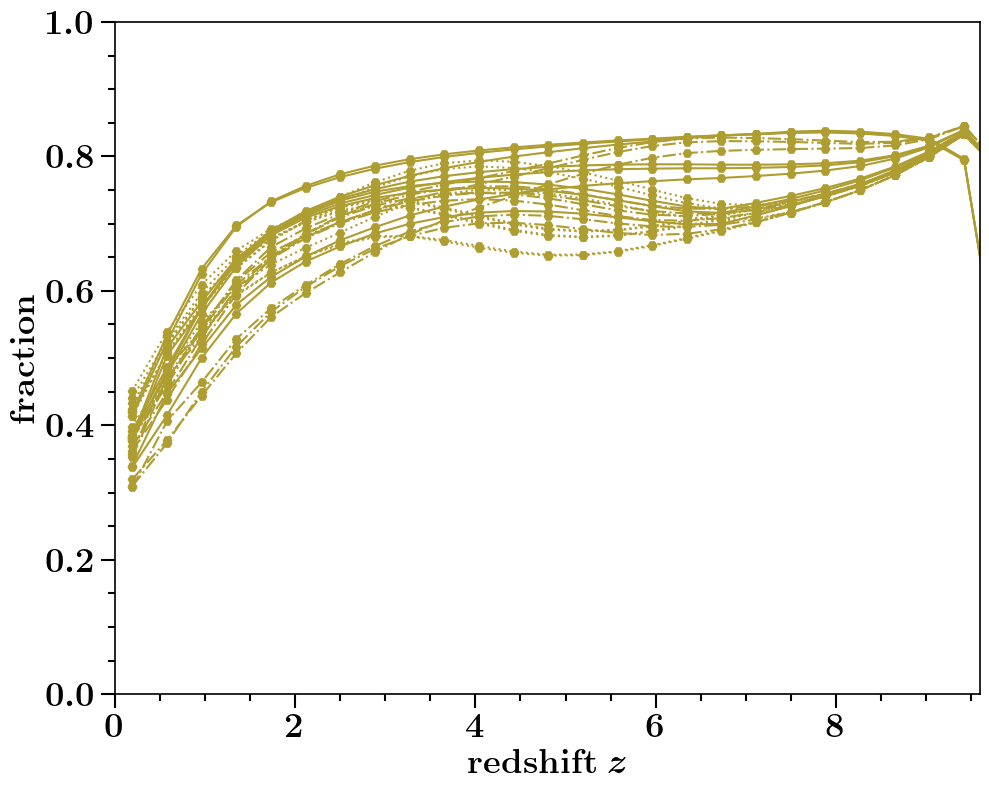

at BPS model  F


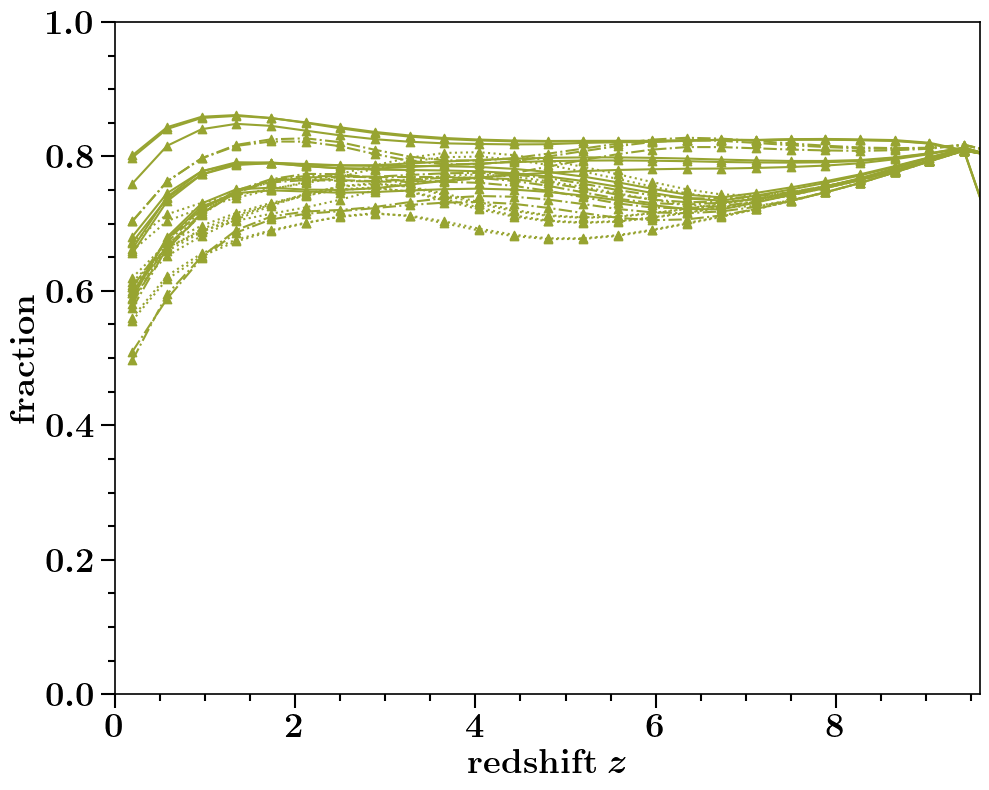

at BPS model  G


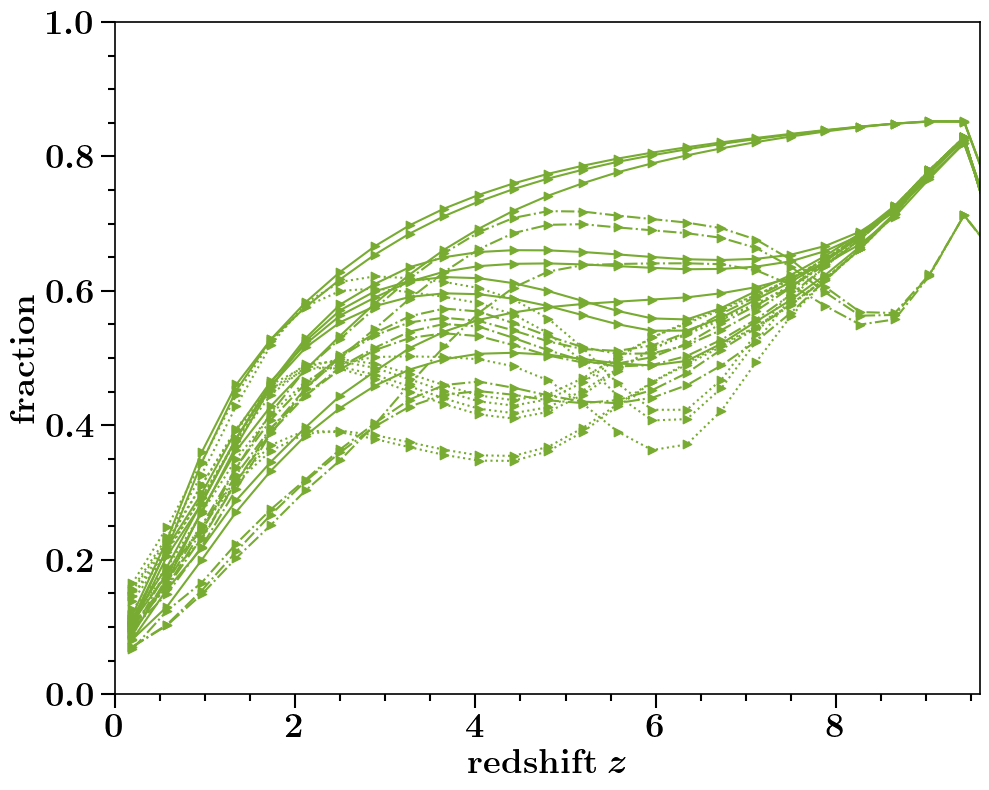

at BPS model  H


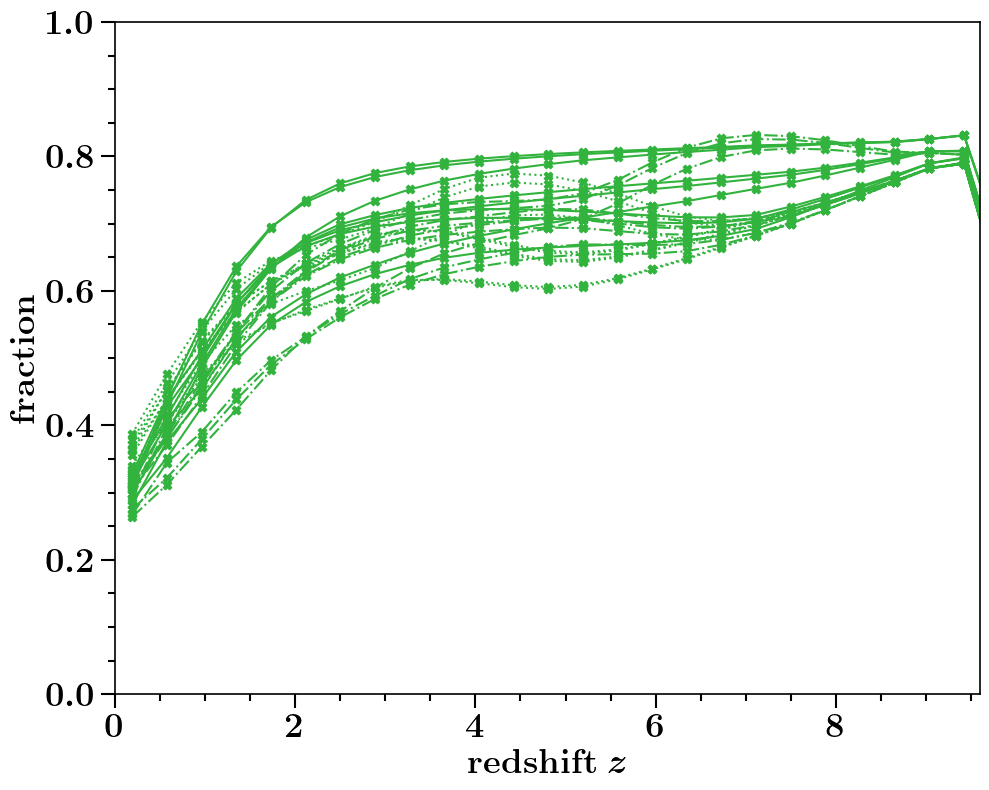

at BPS model  I


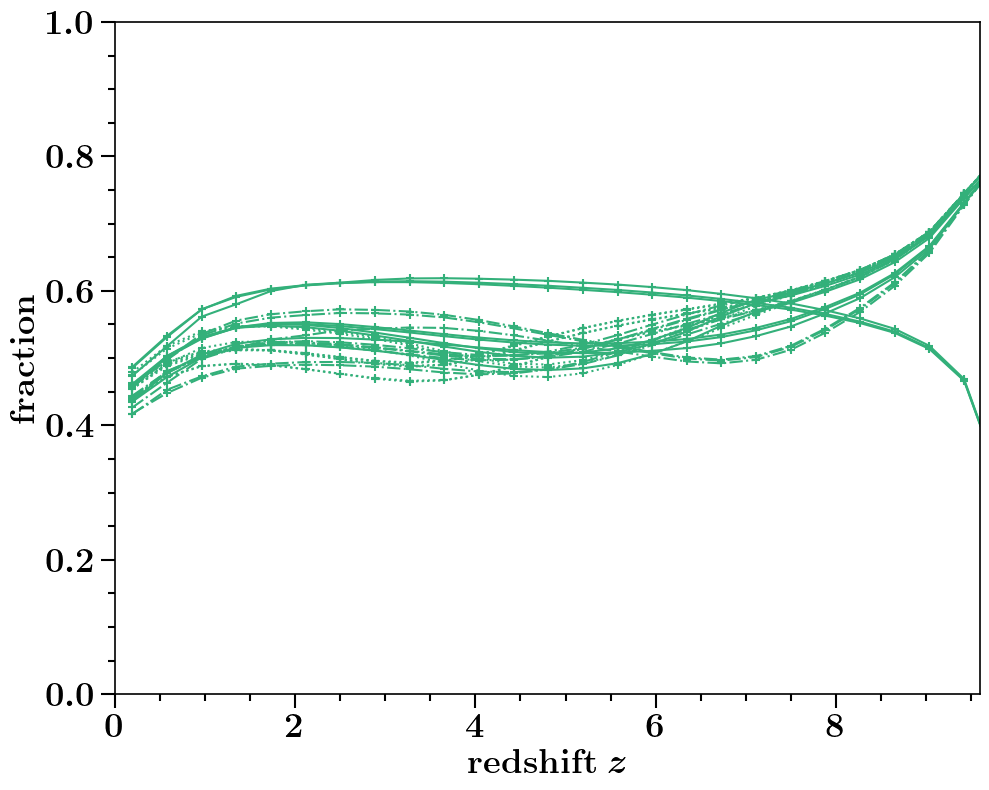

at BPS model  J


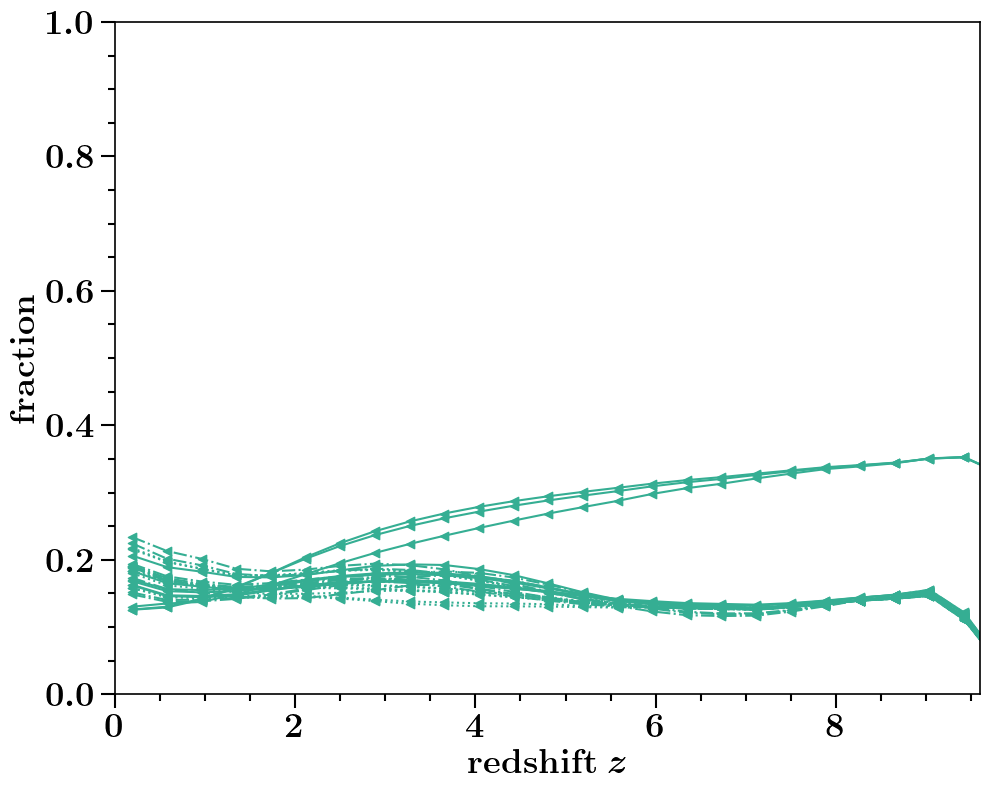

at BPS model  K


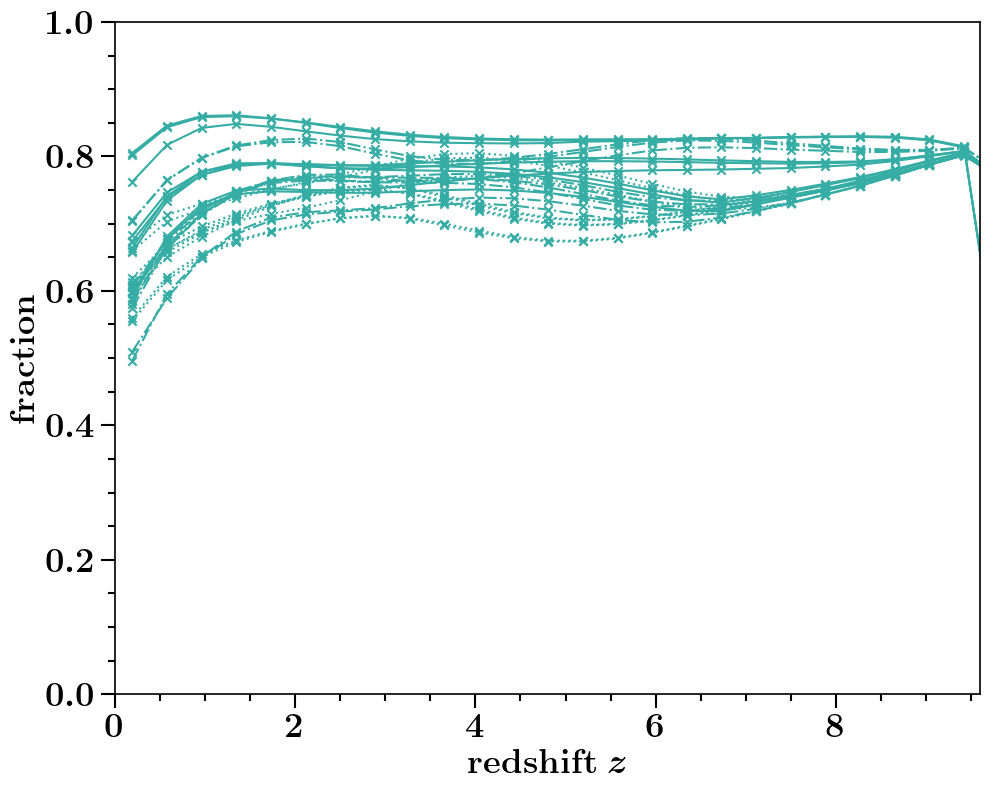

at BPS model  L


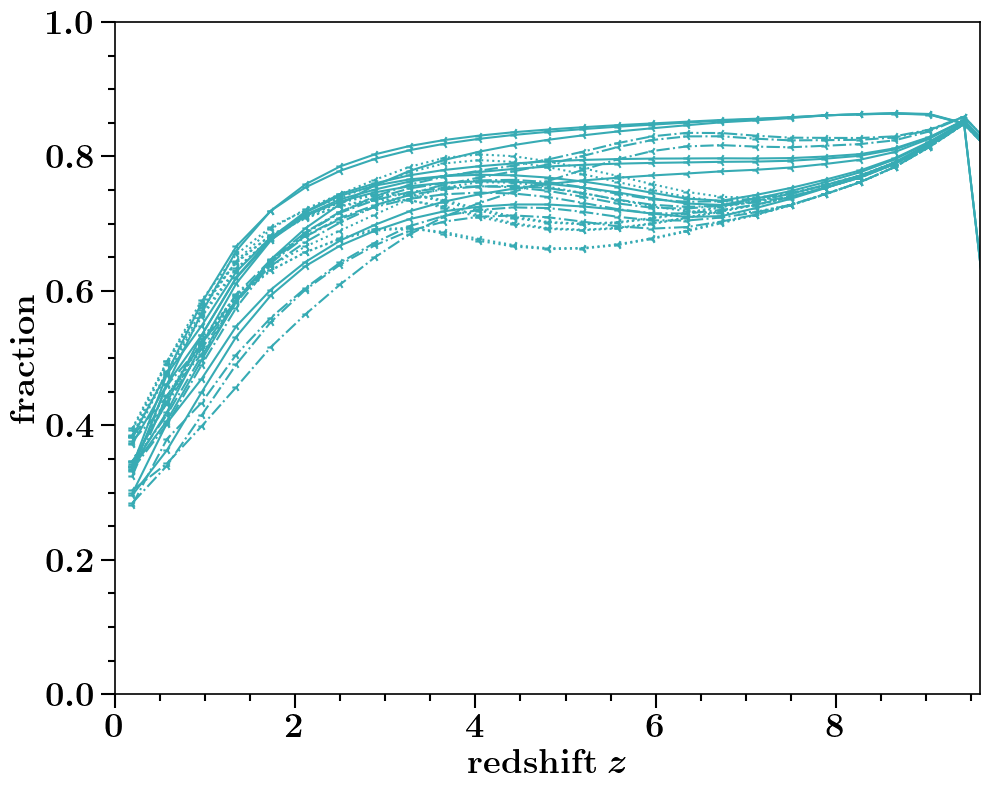

at BPS model  M


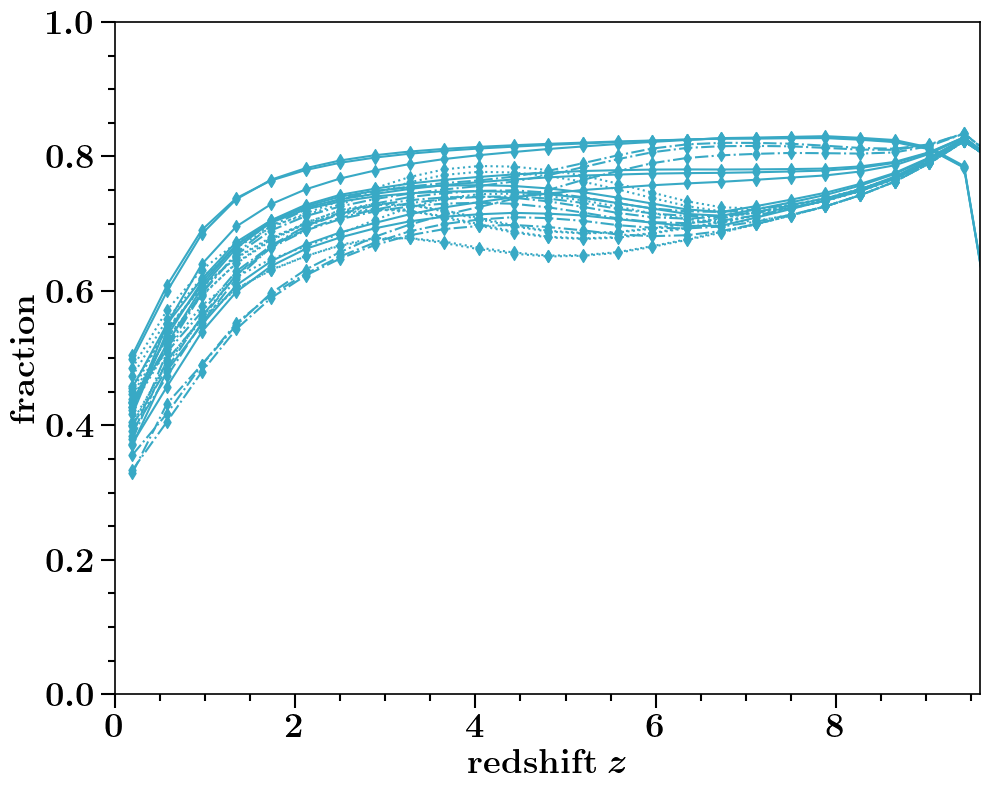

at BPS model  N


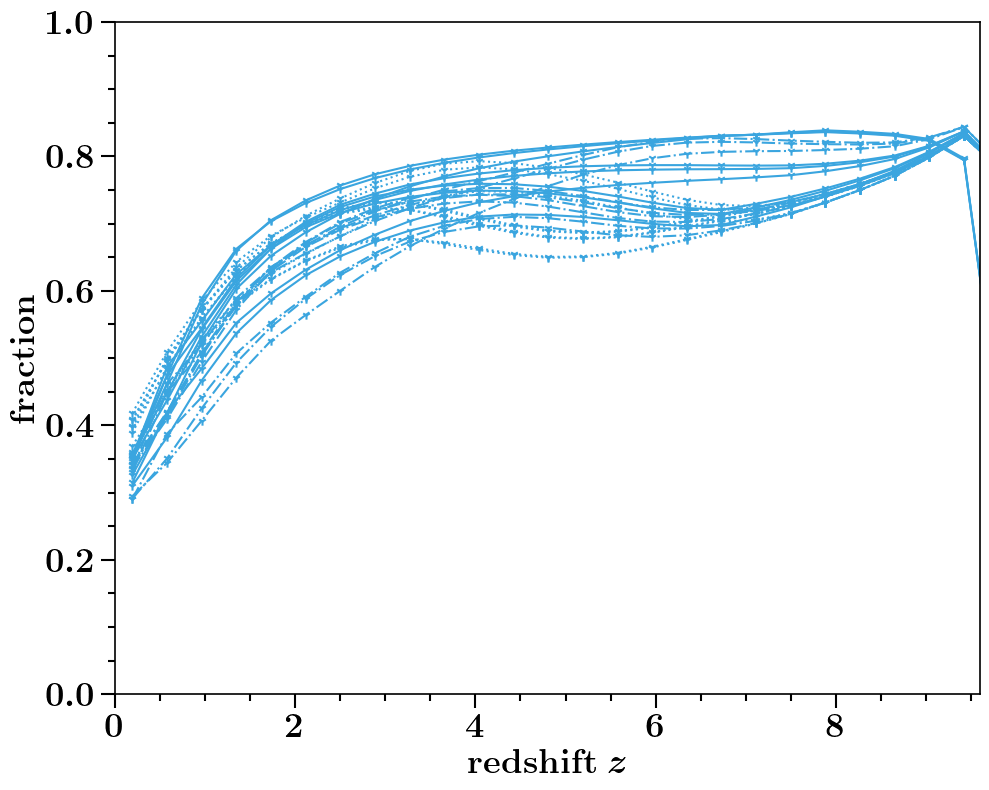

at BPS model  O


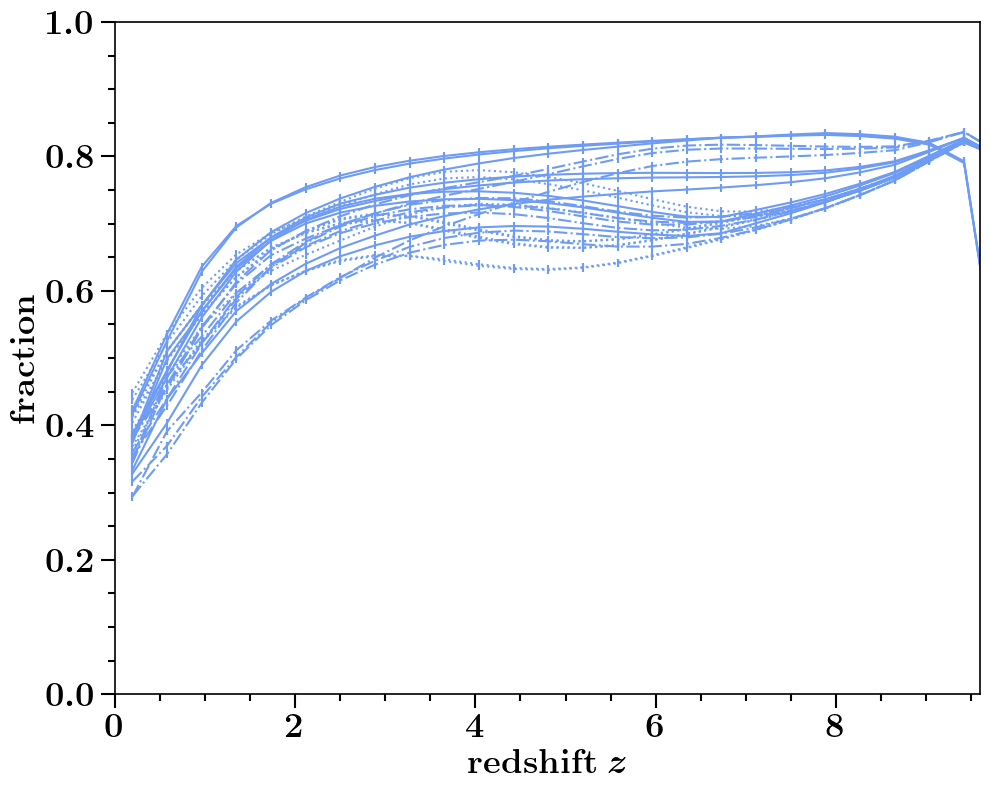

at BPS model  P


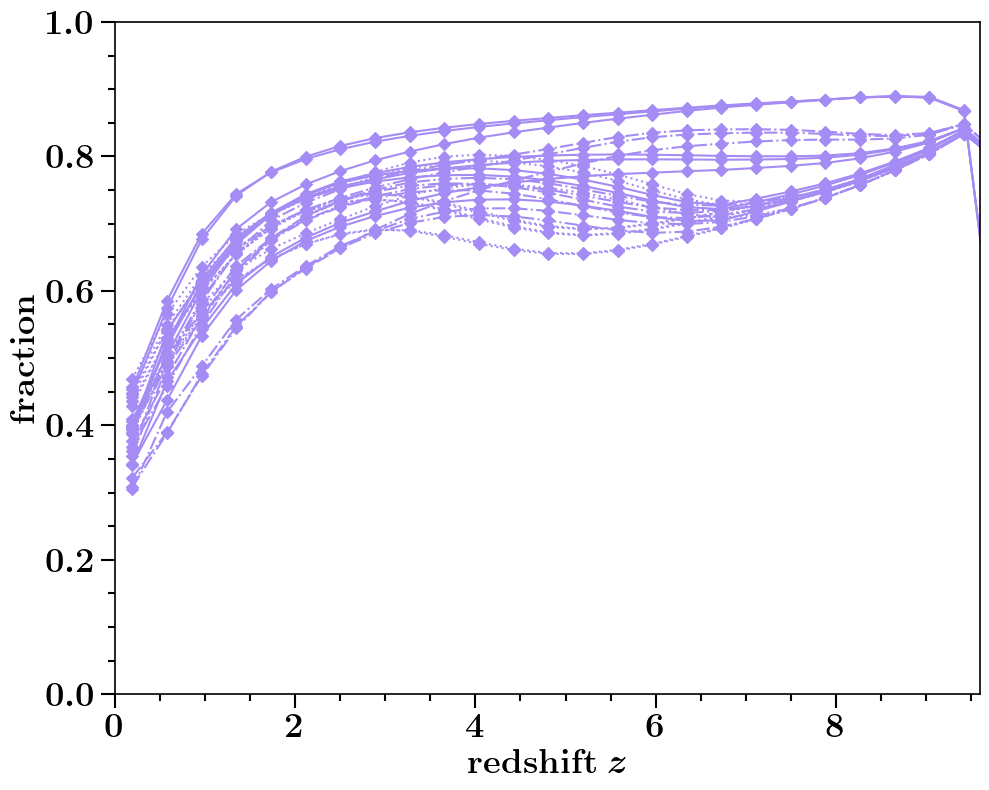

at BPS model  Q


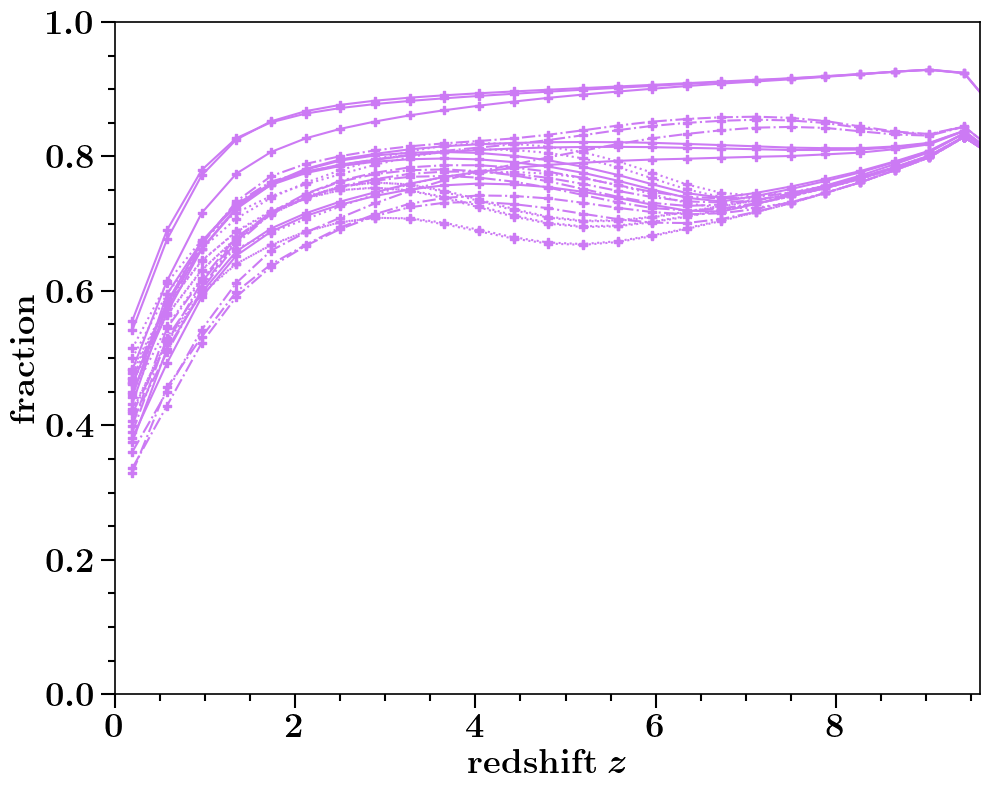

at BPS model  R


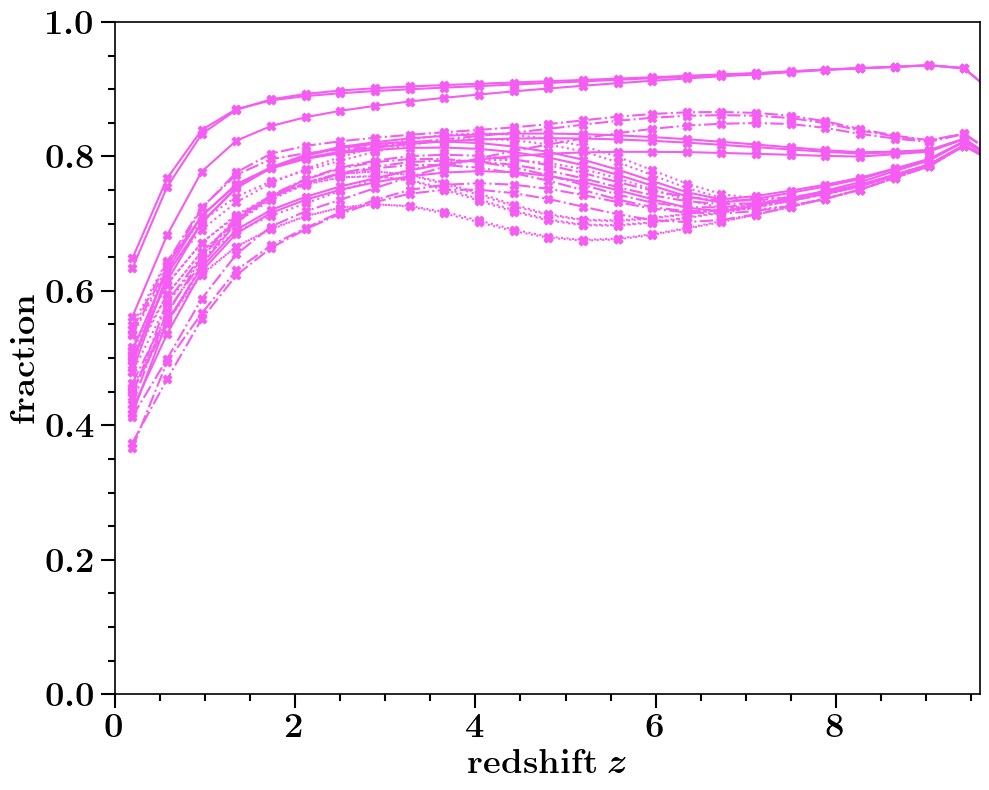

at BPS model  S


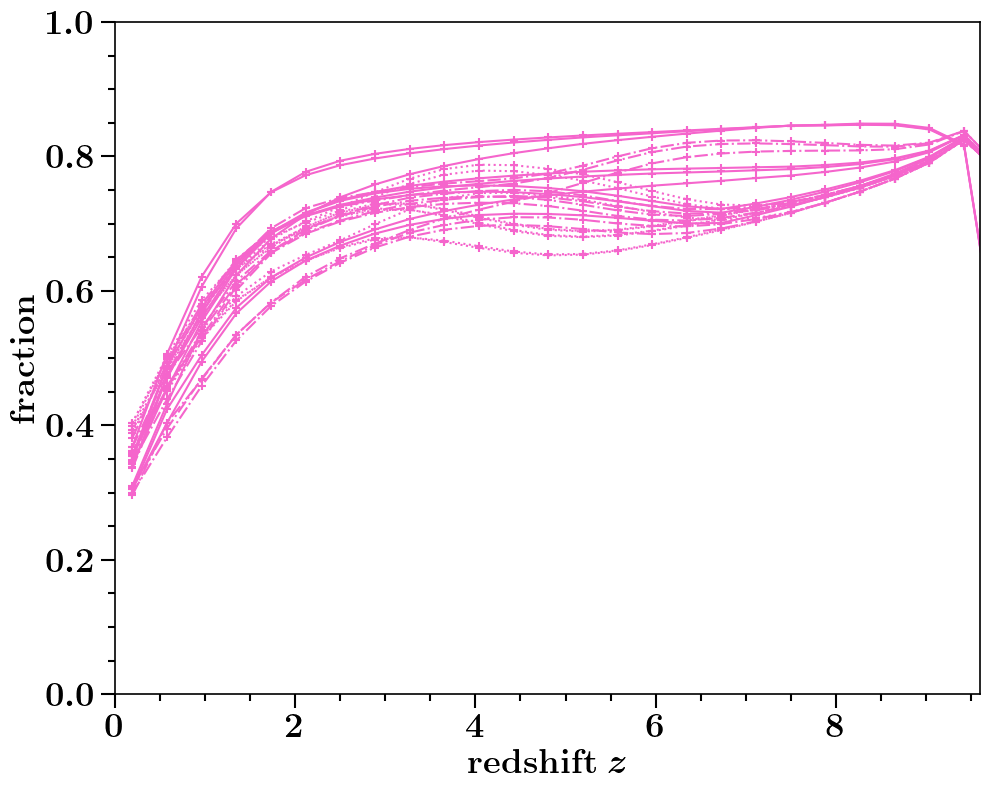

at BPS model  T


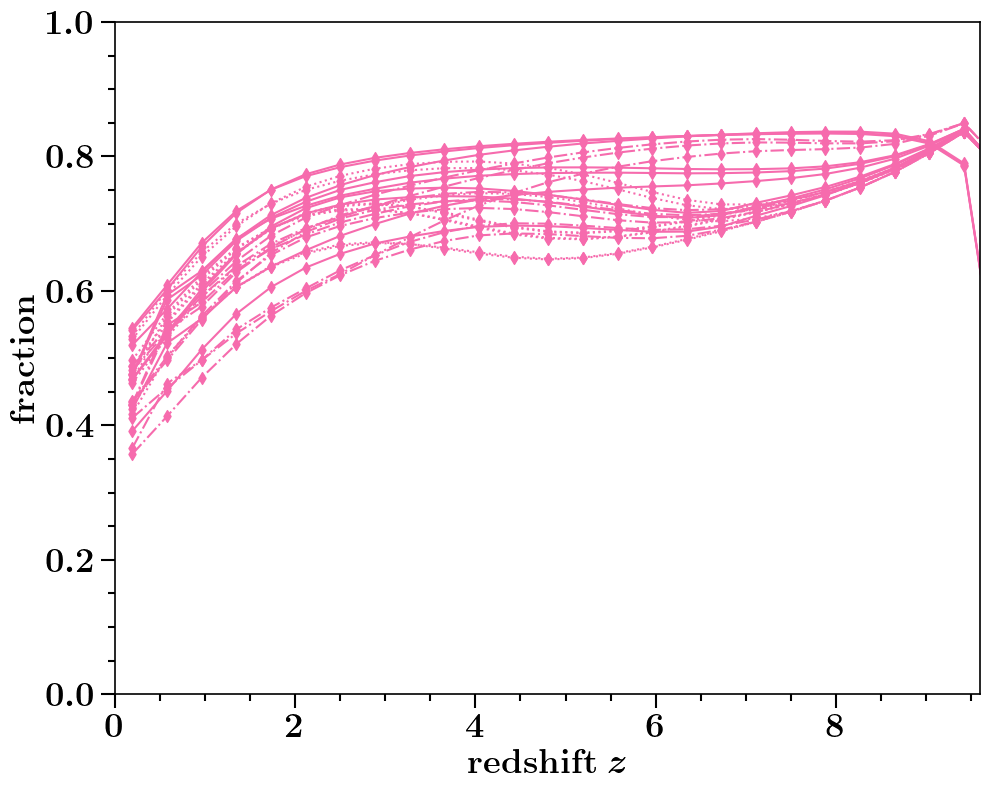

In [44]:





adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']


pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run 
print('available redshifts:', redshifts_runs) 




    
for DCOtype in [ 'BNS', 'BHNS', 'BBH']:
    print()
    print('at DCOtype =', DCOtype)
#     for nrC, Channel in enumerate(adjustedChannelList): 
    for nrC, Channel in enumerate([adjustedChannelList[0]]): 
        fc_ind_wanted = dictFormationChannelIndex[Channel]
        c_FC = channelColorDict[Channel]

        for BPSmodelName in  BPSnameslist[:]:
            print('at BPS model ', BPSmodelName)
        #     for BPSmodelName in  [BPSnameslist[0]]:
            ncols, nrows= 1,1
            f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,8), 
                          gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})

            ax = plot_formation_channels_redshift_rate_mssfr(axe=ax, DCOtype=DCOtype, BPSmodelName=BPSmodelName,\
                                                              redshifts=redshifts_runs, pathData=pathData, fc_ind_wanted=fc_ind_wanted,\
                                                            c_FC=c_FC, mask_specific_mssfr='z') 


            ##  SAVE FIG  ###
            plt.tight_layout()
            plt.subplots_adjust(wspace=0., hspace=0.18)  
            plt.savefig('./redshift_rates_fc/ratesz_' + BPSmodelName  + '_' + DCOtype + '_' + Channel+ '.png', transparent=False)
            plt.savefig('./redshift_rates_fc/ratesz_' + BPSmodelName  + '_' + DCOtype + '_' + Channel+ '.pdf', transparent=False)
            plt.show()
            plt.close()

available redshifts: [0.19230769 0.57692308 0.96153846 1.34615385 1.73076923 2.11538462
 2.5        2.88461538 3.26923077 3.65384615 4.03846154 4.42307692
 4.80769231 5.19230769 5.57692308 5.96153846 6.34615385 6.73076923
 7.11538462 7.5        7.88461538 8.26923077 8.65384615 9.03846154
 9.42307692 9.80769231]

at DCOtype = BHNS
running for redshift  0.1923
ind z = 0
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.17735713 0.44887988 0.30250933 0.27281332 0.46414471 0.35731558
 0.34980739 0.45903035 0.35440101 0.35447084 0.40265295 0.24039412
 0.23564279 0.42510964 0.29522371 0.29795181 0.42150676 0.2943533
 0.30258278 0.43866958 0.29623348 0.2643133  0.45288355 0.34587278
 0.33993411 0.44827407 0.34364853 0.344827

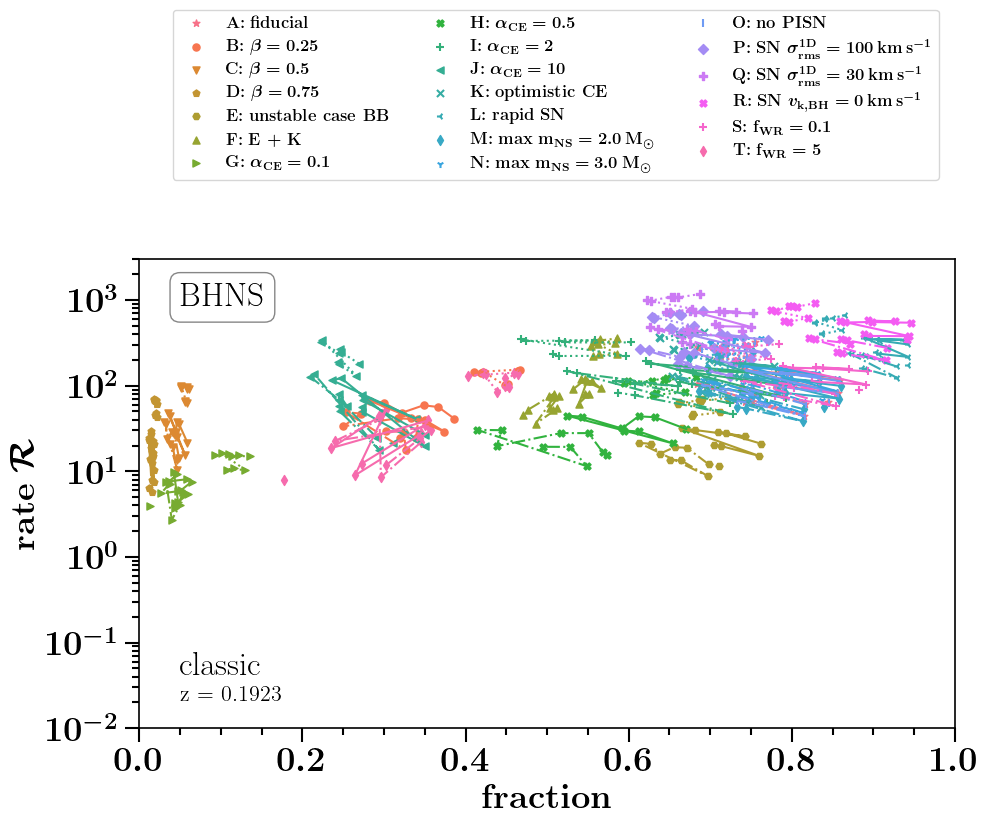


at DCOtype = BBH
running for redshift  0.1923
ind z = 0
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.4417215  0.53320744 0.48227039 0.54511656 0.49733626 0.43682601
 0.46858055 0.47626393 0.43196236 0.47563994 0.46304307 0.41115454
 0.51944719 0.43059971 0.35730404 0.39160246 0.41716353 0.36626714
 0.42420637 0.528222   0.48860984 0.54169451 0.48831753 0.43496506
 0.46814533 0.46895108 0.43081575 0.47422756]


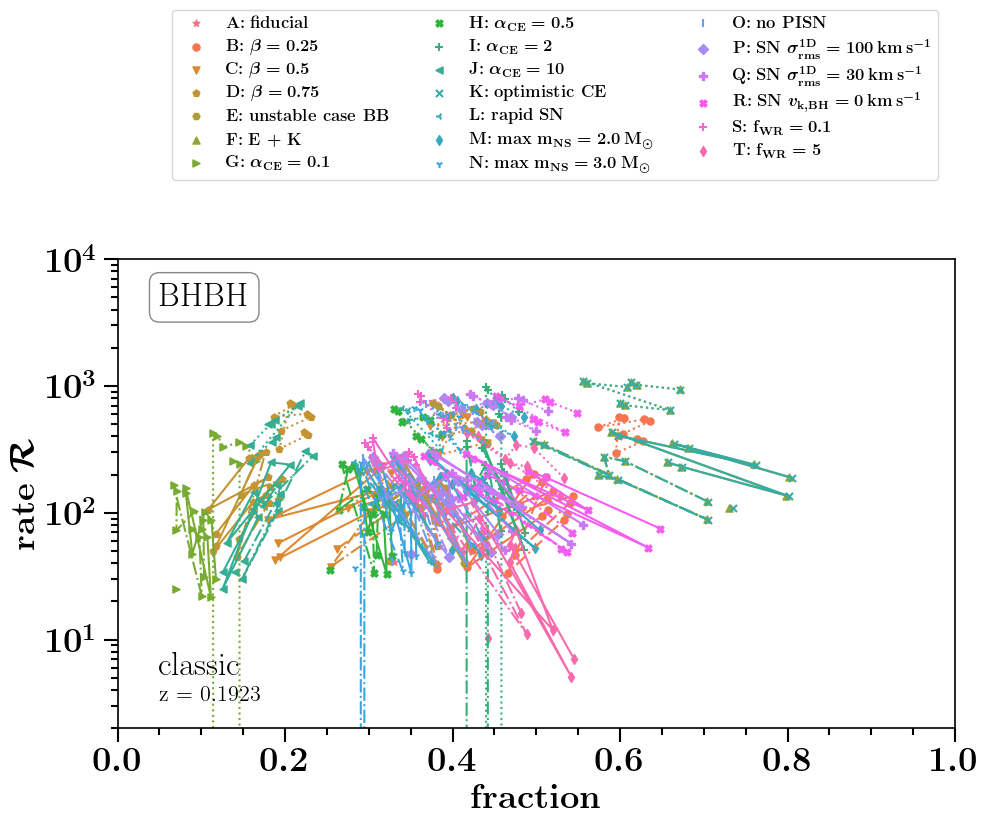


at DCOtype = BNS
running for redshift  0.1923
ind z = 0
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.68169034 0.40701715 0.72822783 0.66493261 0.39111428 0.68030696
 0.62492404 0.38391367 0.68059664 0.61861157 0.40974096 0.6937213
 0.63382265 0.39576512 0.65890277 0.60337998 0.38905542 0.6587476
 0.59644512 0.40564881 0.71993587 0.65759773 0.39150675 0.67278319
 0.61833756 0.38431    0.67278249 0.61204906]


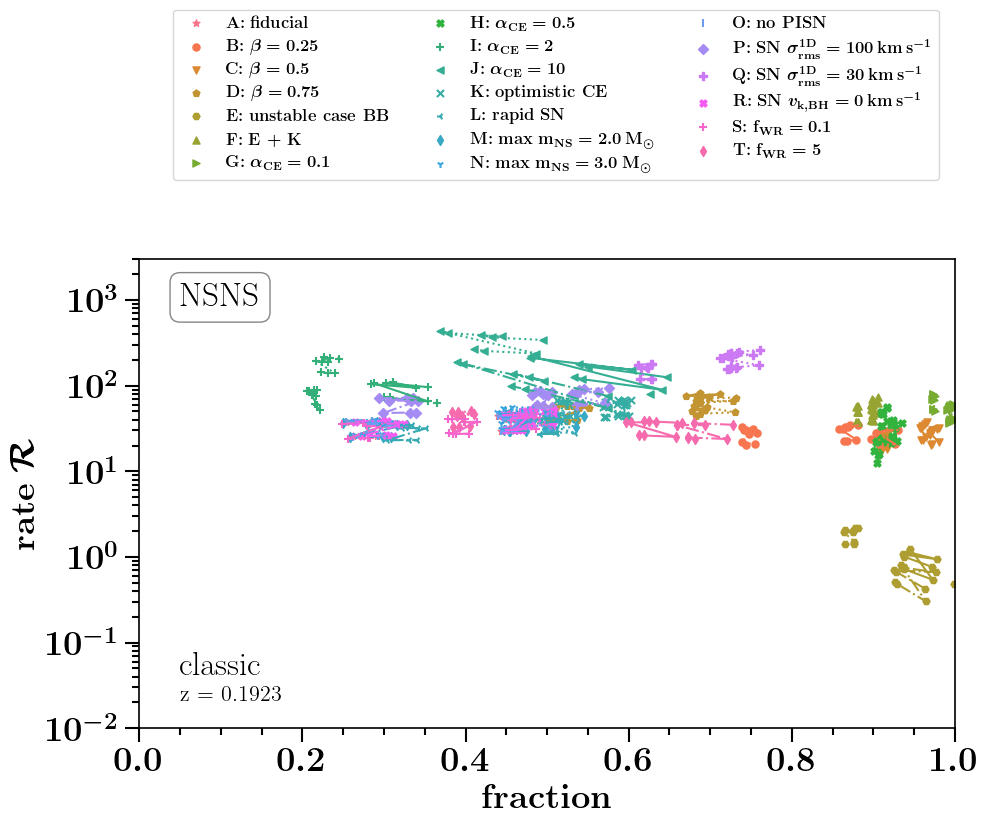


at DCOtype = BHNS
running for redshift  0.5769
ind z = 1
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.26799702 0.57919155 0.43758752 0.42445746 0.5800626  0.49799455
 0.50291653 0.58216711 0.51229639 0.51899383 0.54574732 0.37093959
 0.37017026 0.55370946 0.44407681 0.454084   0.55698281 0.4575963
 0.46774043 0.57071218 0.43076571 0.41431921 0.57077806 0.4875358
 0.49321366 0.57328433 0.50153949 0.50901764]


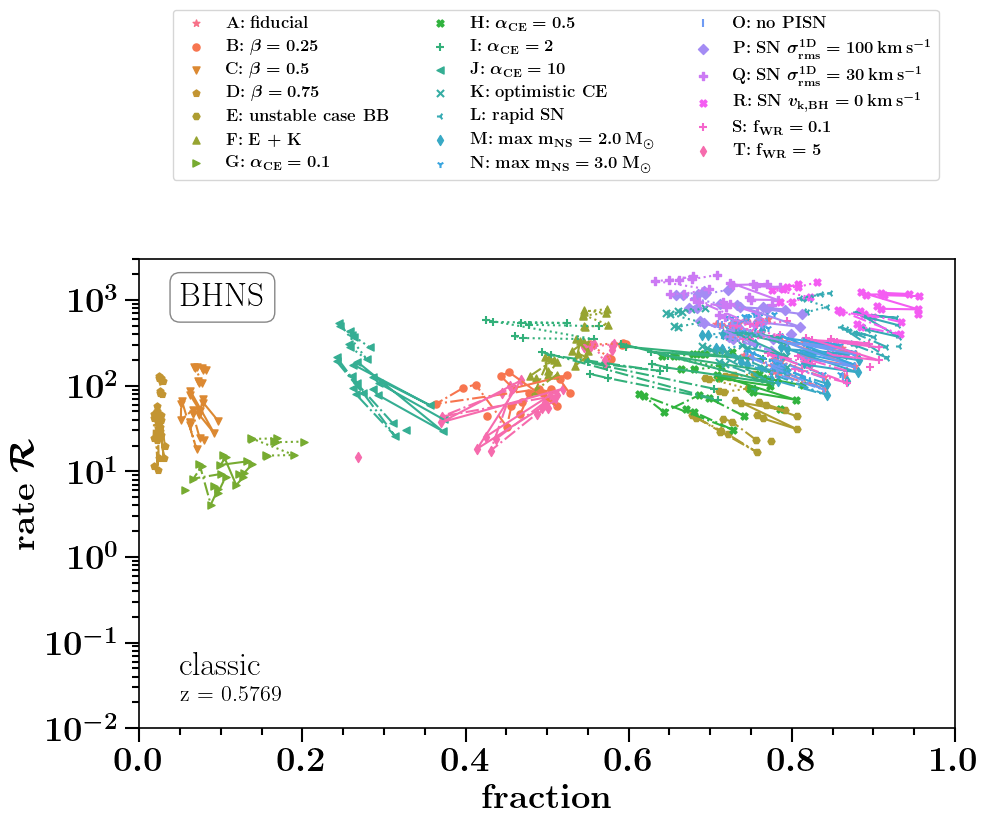


at DCOtype = BBH
running for redshift  0.5769
ind z = 1
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.48084358 0.60091494 0.53861195 0.60849048 0.56597966 0.50165217
 0.53785378 0.56252867 0.54856277 0.59397351 0.53053909 0.45540825
 0.57289519 0.50023443 0.4134253  0.45106208 0.50304776 0.46215032
 0.52208071 0.59349071 0.54280733 0.60195548 0.55496802 0.49664581
 0.53386197 0.55257204 0.54149527 0.58691274]


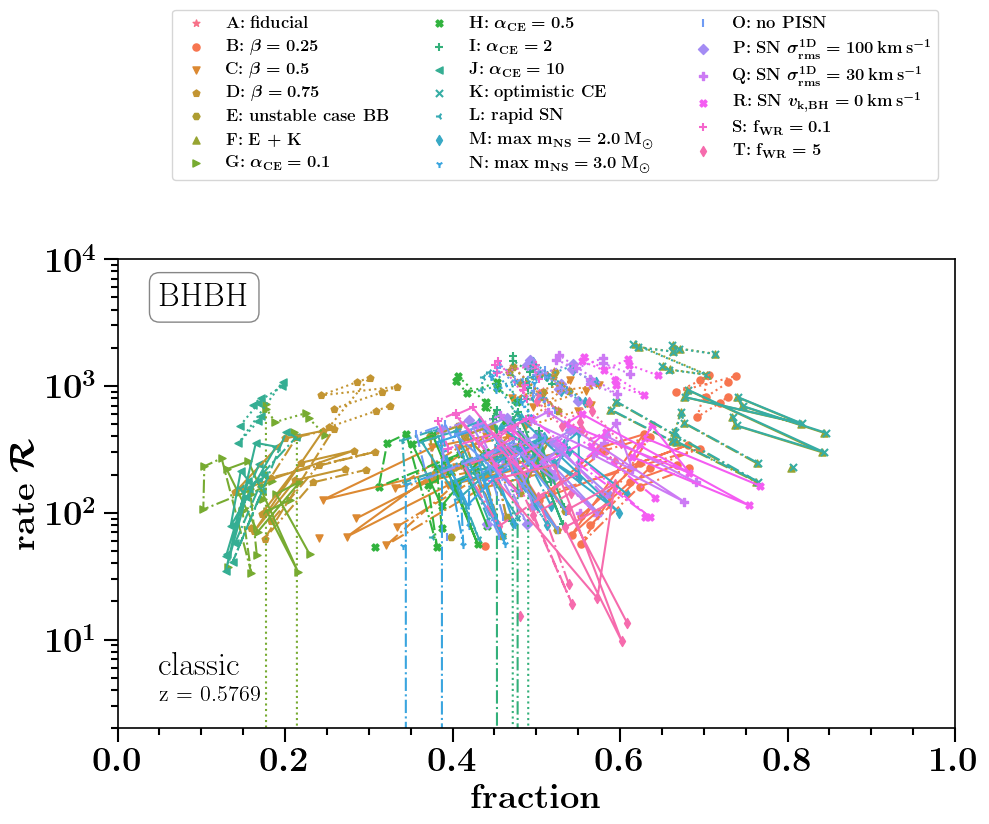


at DCOtype = BNS
running for redshift  0.5769
ind z = 1
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.68095905 0.32357177 0.7408225  0.640534   0.31171133 0.66407722
 0.57931864 0.28602147 0.63231    0.54276313 0.32825952 0.70378203
 0.60753129 0.31575093 0.63971751 0.55778436 0.29116999 0.61111243
 0.52515657 0.32243349 0.72896963 0.62945472 0.31234954 0.65362347
 0.57009994 0.28710429 0.62292062 0.53496102]


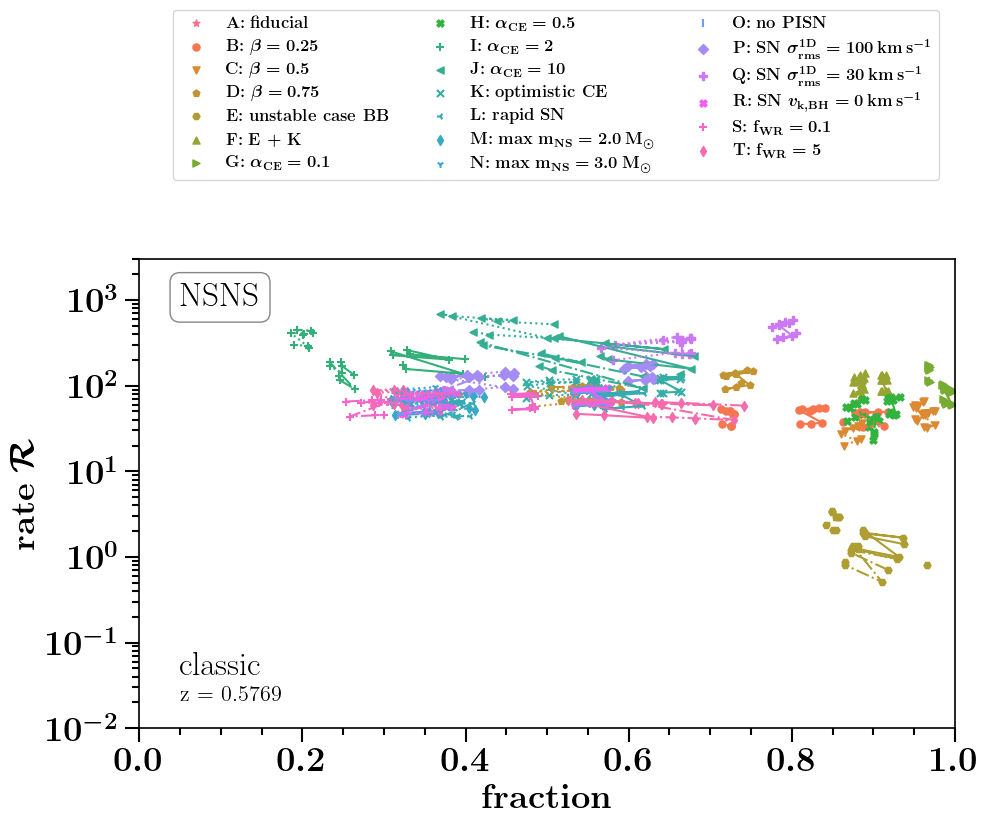


at DCOtype = BHNS
running for redshift  0.9615
ind z = 2
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.40197984 0.65441528 0.55227793 0.54832547 0.64191759 0.59280909
 0.60510544 0.64645985 0.59380983 0.60587604 0.62805247 0.49638941
 0.4977302  0.61850143 0.54573988 0.56484197 0.62371259 0.54800215
 0.56611014 0.65037891 0.55005947 0.54306465 0.63713128 0.5880817
 0.6004628  0.64178062 0.58906158 0.60133957]


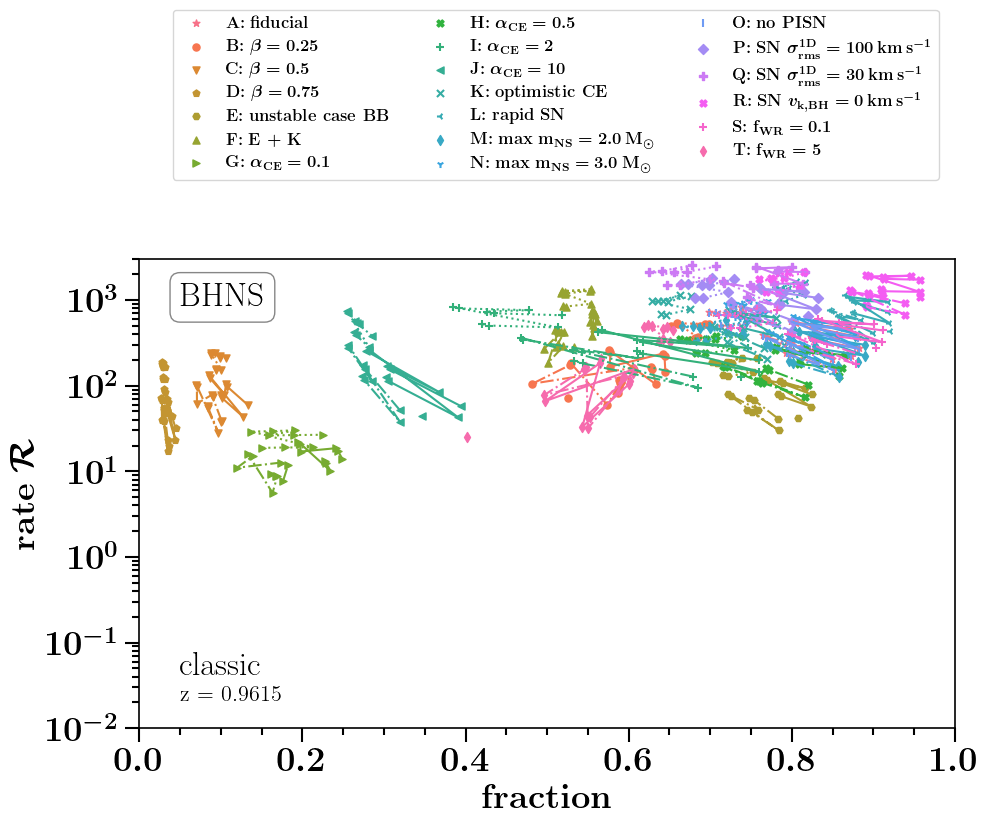


at DCOtype = BBH
running for redshift  0.9615
ind z = 2
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.50175232 0.65766253 0.5918653  0.67135637 0.62105527 0.5623613
 0.60285288 0.61700936 0.58293147 0.62956403 0.59105868 0.49678512
 0.62795237 0.56106328 0.47087146 0.51258361 0.56028593 0.49711725
 0.55861519 0.65069067 0.59646258 0.66551128 0.61069919 0.55699562
 0.598376   0.60705682 0.57662634 0.62323453]


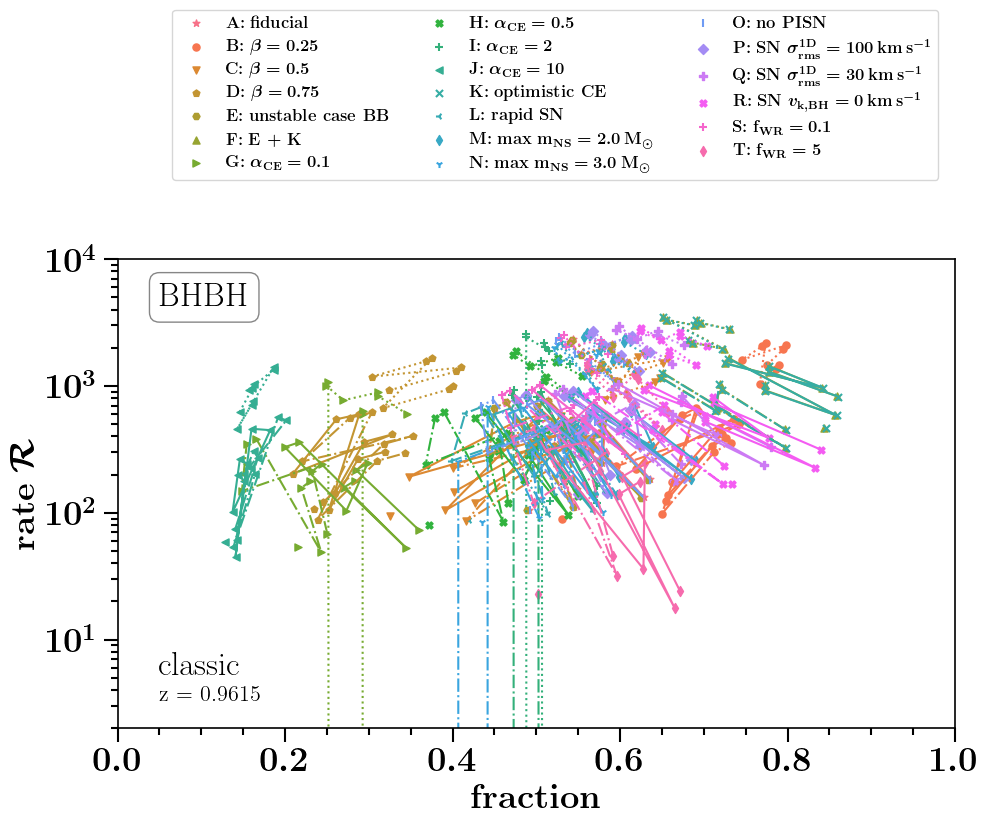


at DCOtype = BNS
running for redshift  0.9615
ind z = 2
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.6839382  0.22901238 0.73249296 0.62969605 0.2256789  0.62120659
 0.52998724 0.19932139 0.59826836 0.51579298 0.2324134  0.69273706
 0.59841213 0.22902808 0.59829575 0.51023014 0.20360296 0.57698087
 0.49763919 0.22808388 0.72080423 0.61876175 0.22573093 0.61125152
 0.52141756 0.19972811 0.58877471 0.50770056]


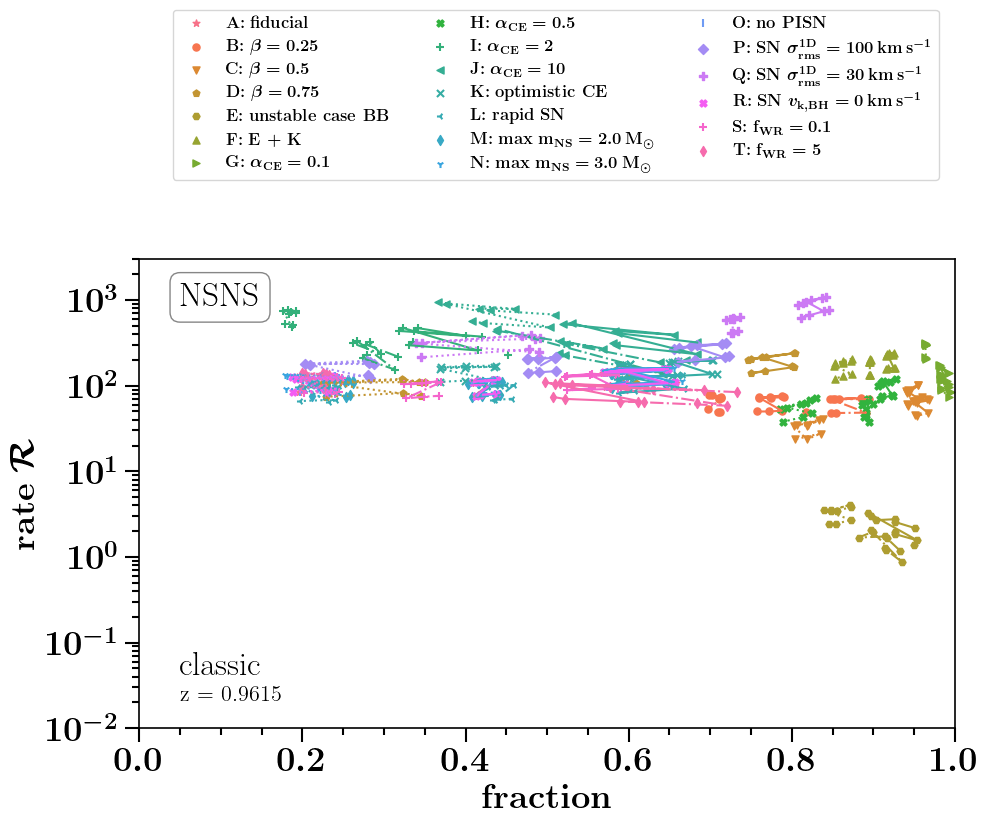


at DCOtype = BHNS
running for redshift  1.3462
ind z = 3
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.5223986  0.68480416 0.62228728 0.62390846 0.66365693 0.64716866
 0.65925647 0.66692032 0.64569903 0.65742613 0.66354484 0.57535562
 0.58446038 0.64447511 0.61190465 0.62830881 0.64784751 0.6110185
 0.62735971 0.68434906 0.62520697 0.62449685 0.66261202 0.64738713
 0.65942018 0.66577285 0.64591906 0.65762793]


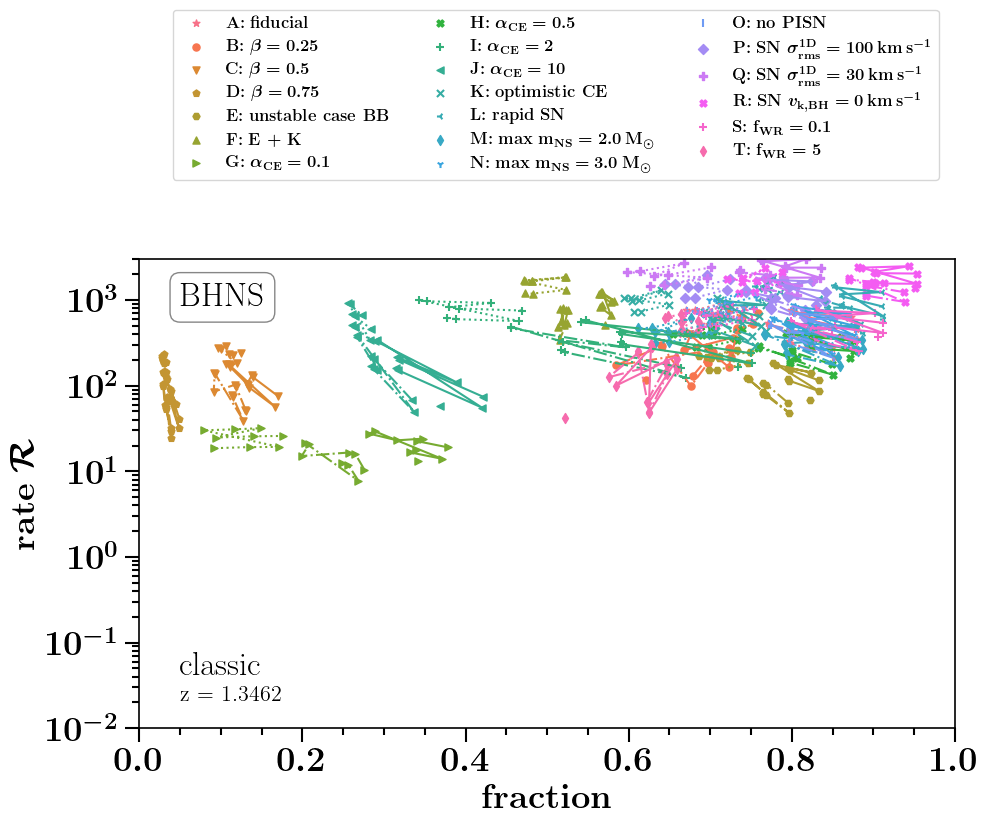


at DCOtype = BBH
running for redshift  1.3462
ind z = 3
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.53678134 0.70007558 0.63690178 0.7189397  0.66413133 0.61454877
 0.65617718 0.66217896 0.63097889 0.6778407  0.63480018 0.53665276
 0.67714166 0.60523205 0.52083849 0.56577029 0.60555939 0.54267244
 0.60564327 0.69616453 0.64431458 0.71592659 0.65708797 0.61198969
 0.65433385 0.65530605 0.62770755 0.6743715 ]


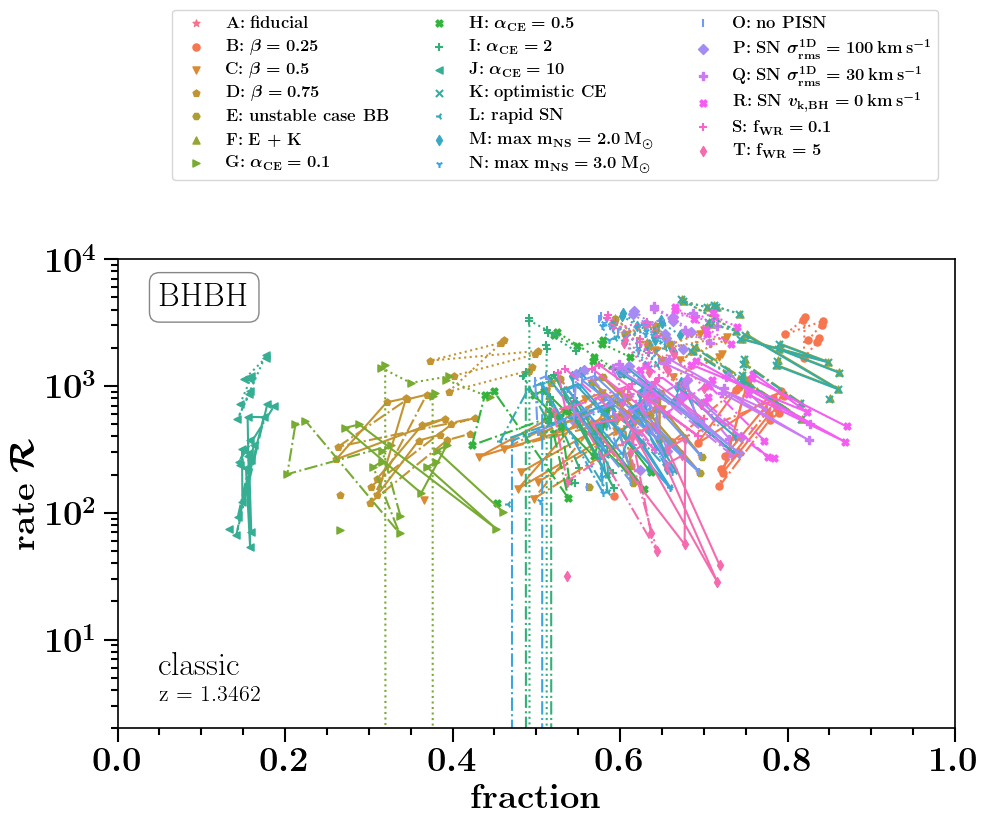


at DCOtype = BNS
running for redshift  1.3462
ind z = 3
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.67605217 0.16314087 0.70242558 0.62132204 0.17204173 0.54521824
 0.46946723 0.1581159  0.52199208 0.46187727 0.16623735 0.66062254
 0.58729898 0.17417333 0.52269778 0.45042101 0.16059985 0.50177903
 0.44406755 0.1619764  0.69411551 0.61362703 0.17129698 0.53862135
 0.46387703 0.15732257 0.51580966 0.45628909]


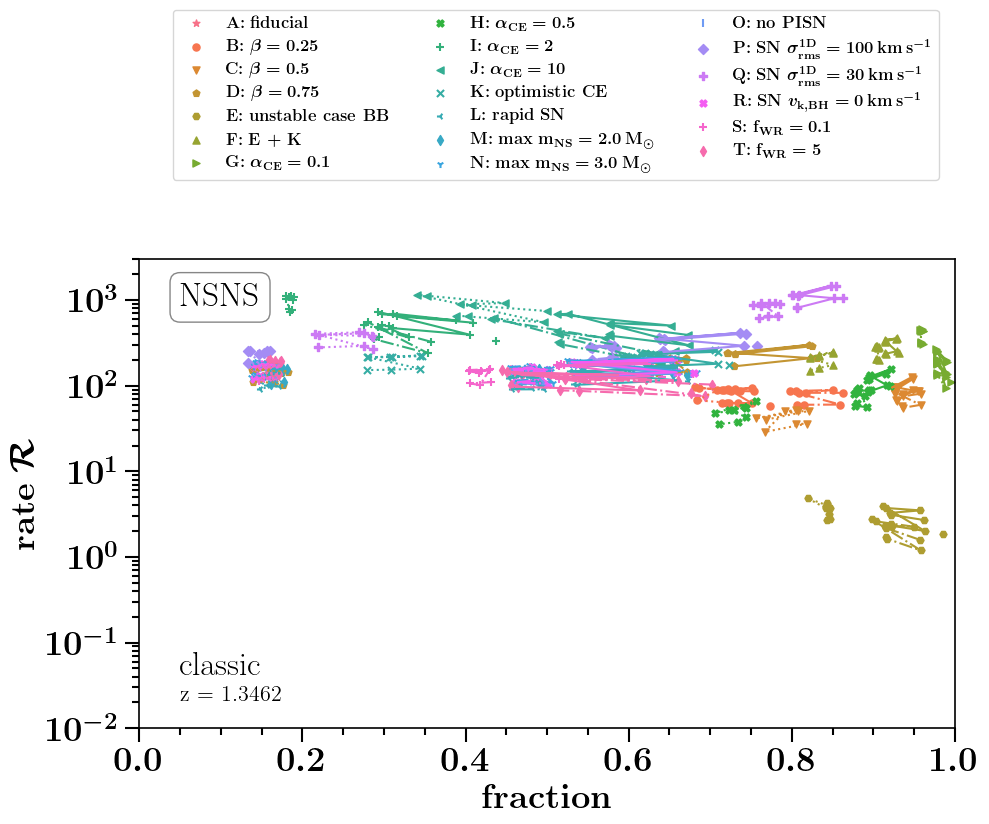


at DCOtype = BHNS
running for redshift  1.7308
ind z = 4
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.62239626 0.68794518 0.66586452 0.66584127 0.65925925 0.66989242
 0.68184396 0.65958658 0.66808909 0.67972072 0.67243322 0.63579988
 0.64118668 0.64431397 0.64808406 0.6638069  0.64422465 0.64631027
 0.66107491 0.68931321 0.67015638 0.66896206 0.6602726  0.67214732
 0.68392254 0.6604064  0.67037541 0.68192121]


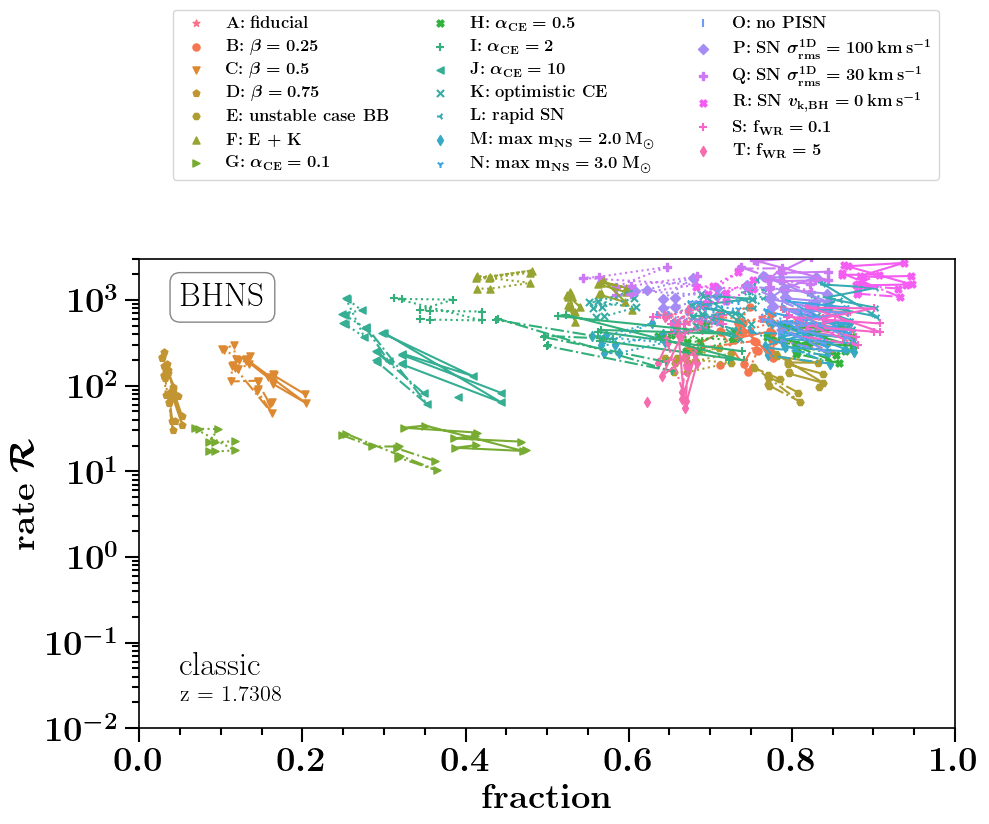


at DCOtype = BBH
running for redshift  1.7308
ind z = 4
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.56770128 0.72976994 0.67011706 0.75039459 0.69384297 0.65342569
 0.6926533  0.69425512 0.66223321 0.707365   0.66636746 0.56976434
 0.71275604 0.63566163 0.56305694 0.60554747 0.63718597 0.5751495
 0.63595479 0.73039851 0.68207839 0.75080454 0.69198149 0.65629223
 0.69576351 0.69237908 0.66461159 0.70880352]


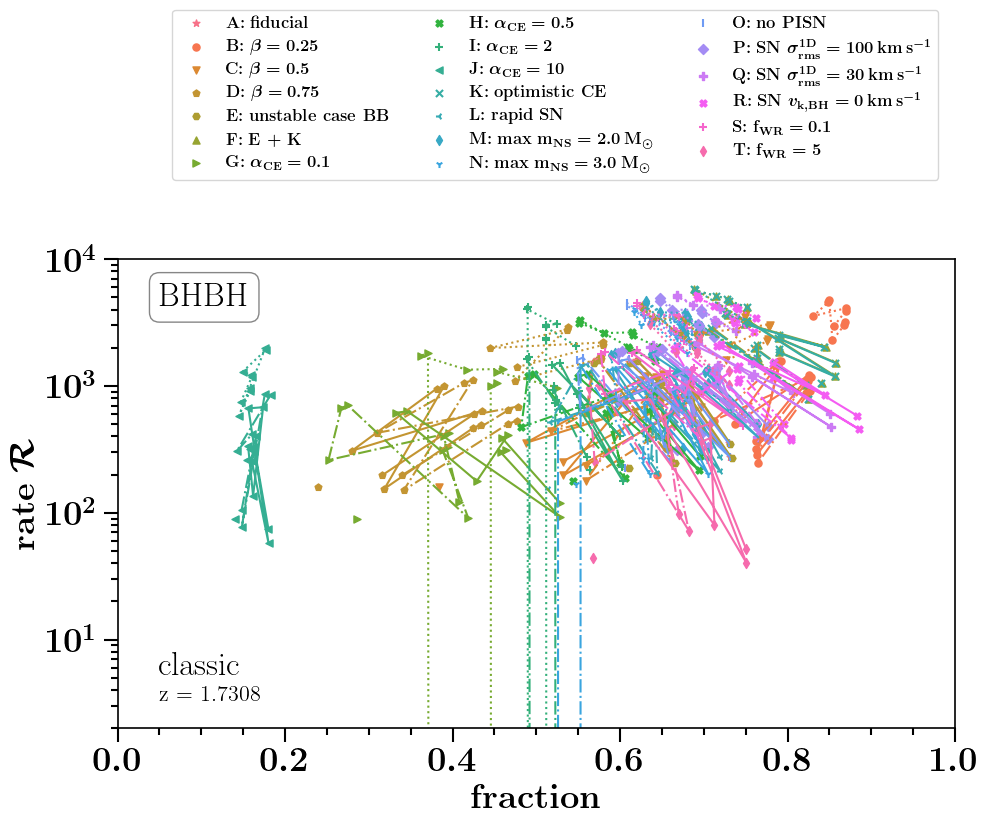


at DCOtype = BNS
running for redshift  1.7308
ind z = 4
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.63911052 0.12651071 0.65047513 0.59243796 0.16156913 0.45449608
 0.38906389 0.14482449 0.44370736 0.37138337 0.12854252 0.60515249
 0.55587074 0.1619901  0.43619047 0.37258817 0.14575306 0.42645902
 0.3550998  0.12524276 0.6479845  0.58994687 0.16021488 0.45218374
 0.38709369 0.14356426 0.44159784 0.36919486]


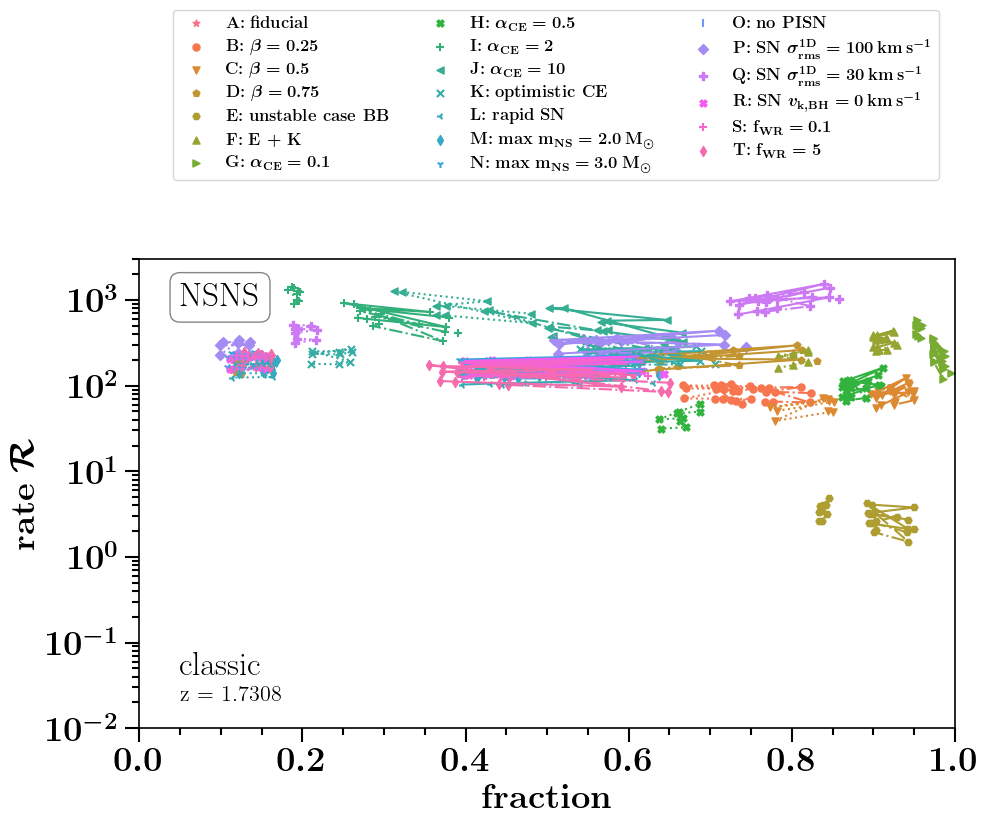


at DCOtype = BHNS
running for redshift  2.1154
ind z = 5
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.6831872  0.67596039 0.69024163 0.68651526 0.64179525 0.67491329
 0.68705818 0.64015499 0.6741097  0.68664492 0.6640295  0.67246791
 0.67533845 0.62782975 0.65990734 0.67645539 0.62543881 0.65938695
 0.67680761 0.67778394 0.69387088 0.68917559 0.64384243 0.67754484
 0.68919496 0.64211801 0.67670084 0.68869362]


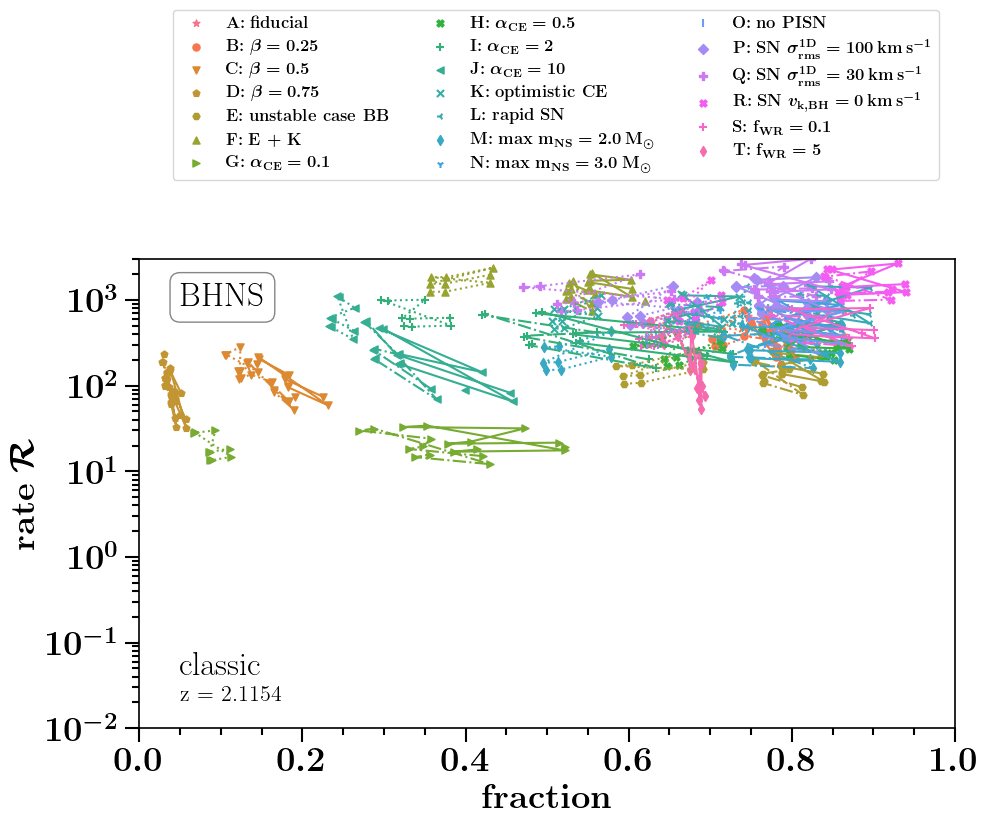


at DCOtype = BBH
running for redshift  2.1154
ind z = 5
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.59856629 0.75010844 0.69332275 0.77058641 0.71161399 0.67942114
 0.71516452 0.71285763 0.68383538 0.7264966  0.69088512 0.60006831
 0.73826821 0.65568784 0.59663438 0.63456513 0.65765537 0.6035777
 0.66030481 0.75481021 0.70893374 0.77345328 0.71469269 0.68739556
 0.72292308 0.71586378 0.69146165 0.73240838]


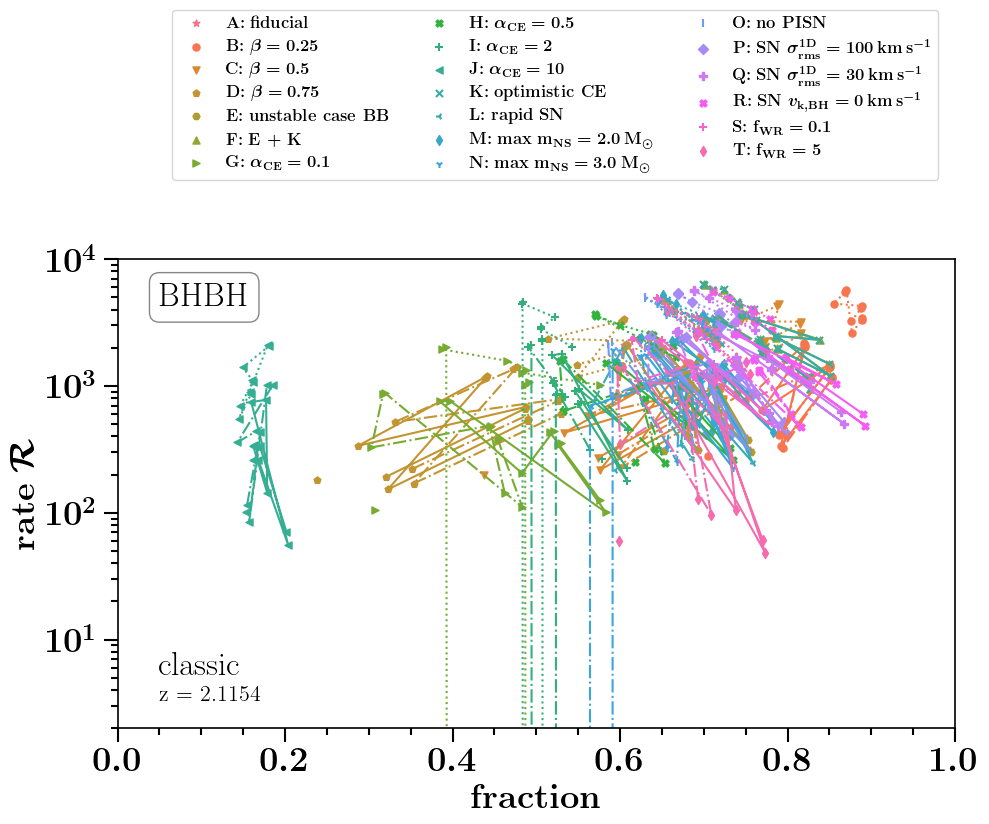


at DCOtype = BNS
running for redshift  2.1154
ind z = 5
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.56231083 0.11146896 0.58187204 0.53693632 0.18223274 0.36217076
 0.30104299 0.17454498 0.35768561 0.26712851 0.11256308 0.5387329
 0.5022287  0.18004654 0.34880639 0.28847443 0.17324356 0.34447611
 0.25626684 0.11051699 0.58475066 0.53882354 0.18119334 0.3624554
 0.30121315 0.1735666  0.35789444 0.26705333]


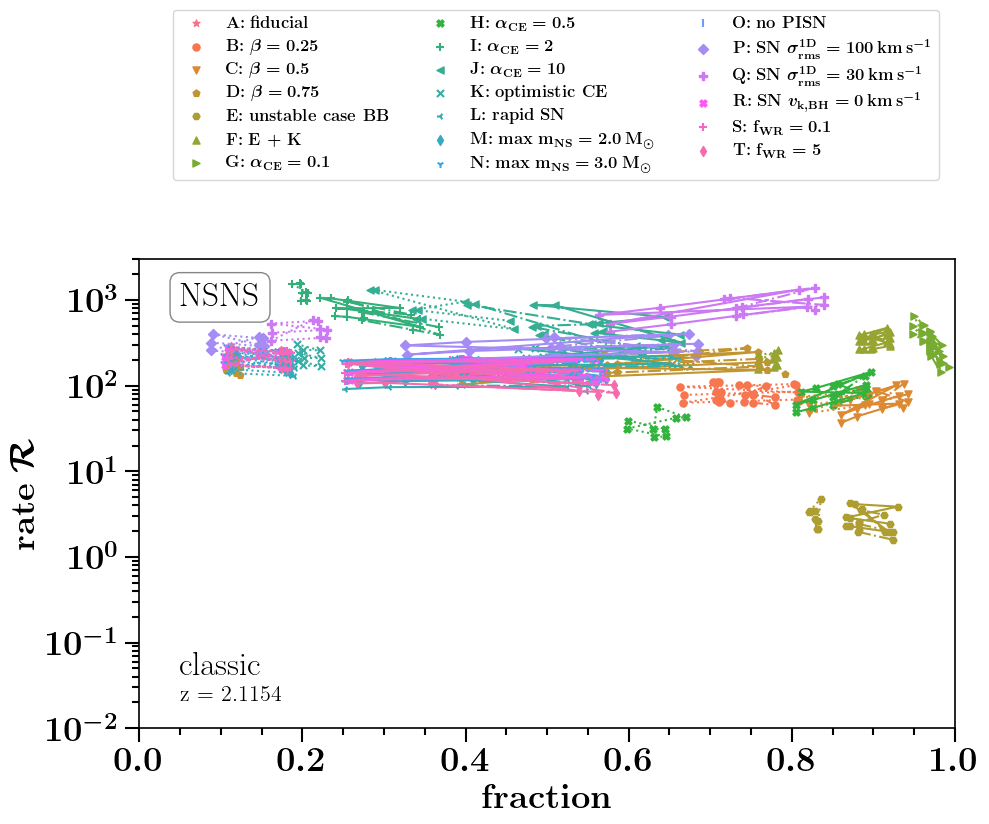


at DCOtype = BHNS
running for redshift  2.5
ind z = 6
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.71351481 0.65848962 0.70161865 0.69656367 0.61945568 0.67037337
 0.68433259 0.61329517 0.67011262 0.68509221 0.65018865 0.68981779
 0.69613665 0.60780474 0.66110931 0.68011286 0.60135352 0.6612716
 0.68155332 0.65996656 0.70410577 0.69677601 0.62155888 0.67213961
 0.68519988 0.61541174 0.67180779 0.68584636]


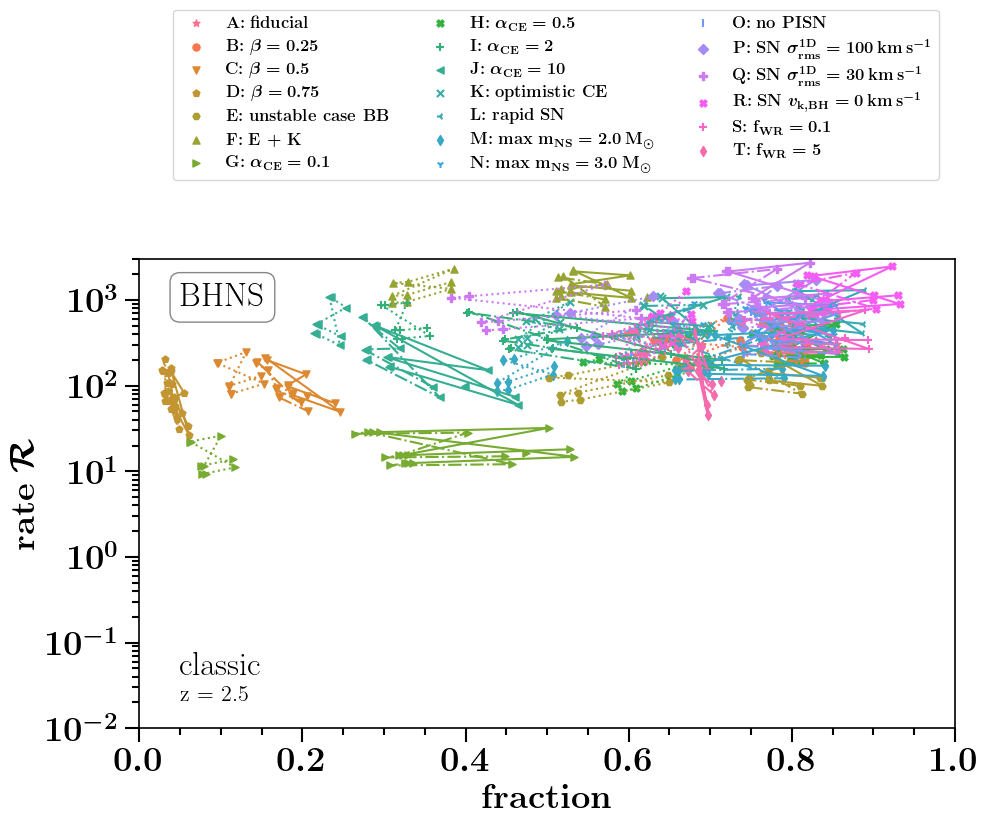


at DCOtype = BBH
running for redshift  2.5
ind z = 6
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.62580047 0.7639555  0.71011616 0.78404943 0.71966155 0.69660128
 0.72832082 0.72138289 0.70185238 0.74164005 0.71026203 0.6251337
 0.7572275  0.66692278 0.62326056 0.65512924 0.66910978 0.63065209
 0.68185377 0.7711845  0.72759127 0.78802823 0.72621194 0.70763182
 0.73909753 0.72784373 0.71249946 0.75024389]


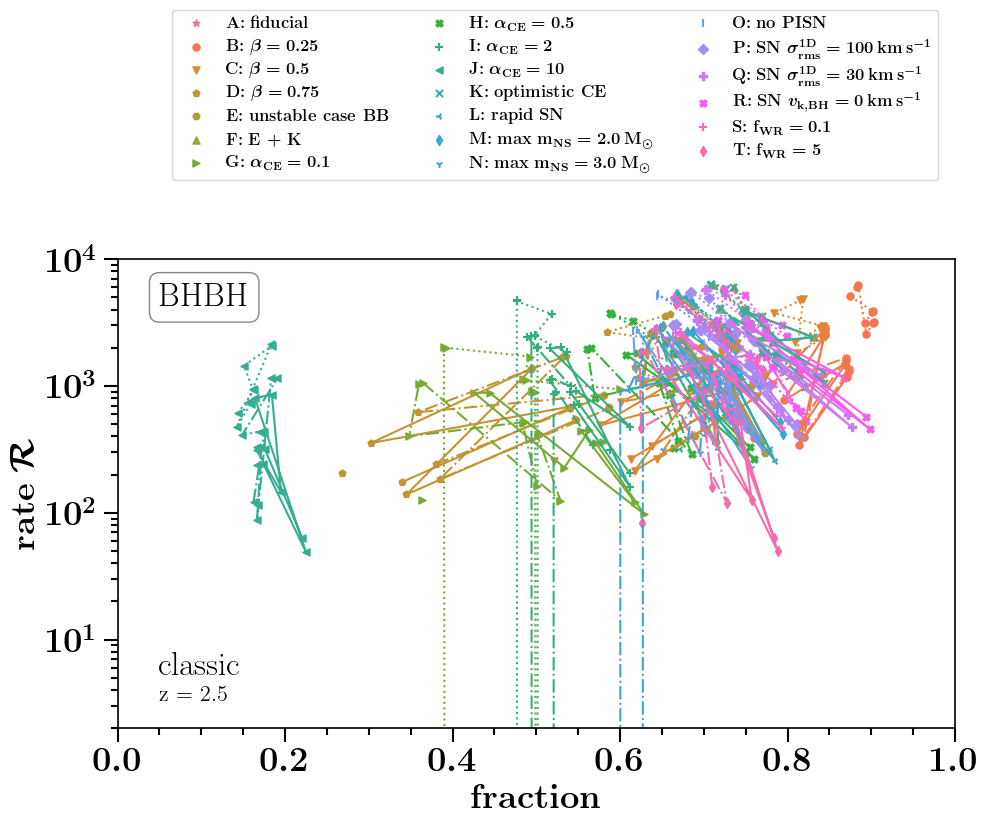


at DCOtype = BNS
running for redshift  2.5
ind z = 6
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.44954206 0.12580025 0.49008167 0.46604976 0.23395901 0.27715333
 0.23456923 0.23989605 0.25941839 0.20395979 0.12550959 0.45379265
 0.43654195 0.22890146 0.26745862 0.22520458 0.23545604 0.25008744
 0.19617287 0.12537132 0.4953036  0.47003557 0.23390552 0.27812613
 0.23547975 0.23980486 0.26025099 0.20462266]


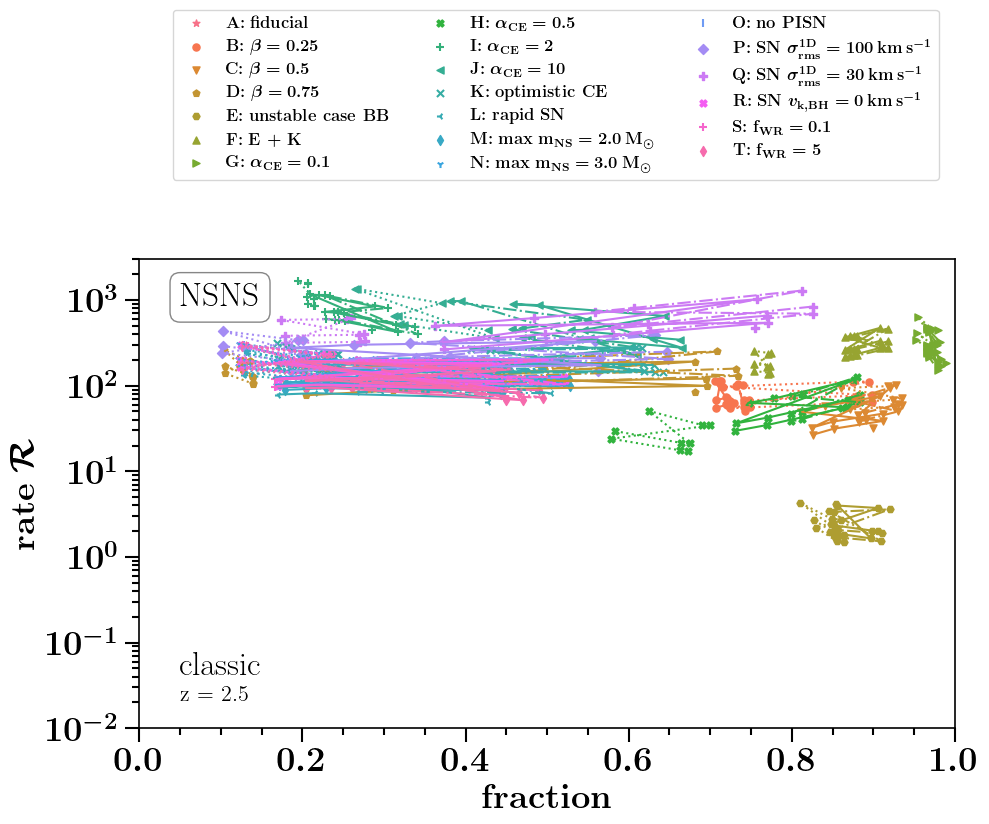


at DCOtype = BHNS
running for redshift  2.8846
ind z = 7
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.7187732  0.63695853 0.70352116 0.6997437  0.59466596 0.65743965
 0.6761446  0.5854994  0.65752027 0.67873693 0.63233694 0.69687833
 0.70726825 0.58562971 0.65031733 0.67536509 0.57710849 0.65110842
 0.67905105 0.6376177  0.7044551  0.69699682 0.59596343 0.65846742
 0.67575504 0.58664123 0.65841047 0.67813434]


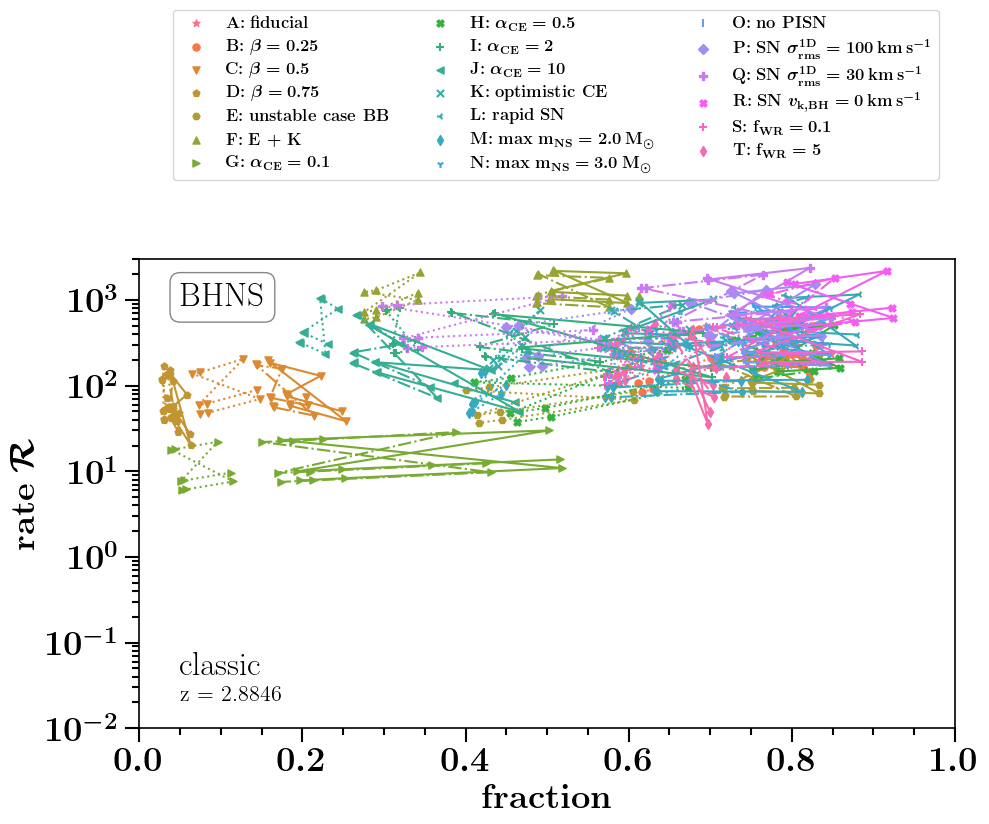


at DCOtype = BBH
running for redshift  2.8846
ind z = 7
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.65904684 0.77340144 0.72615027 0.79382754 0.72038257 0.70834659
 0.735905   0.72162282 0.71457218 0.75196065 0.72533453 0.65310126
 0.77232941 0.67110377 0.64480223 0.67056417 0.67250889 0.65315609
 0.69945675 0.78187675 0.7431332  0.79792137 0.72901447 0.72049794
 0.7481125  0.73020212 0.72626475 0.76165524]


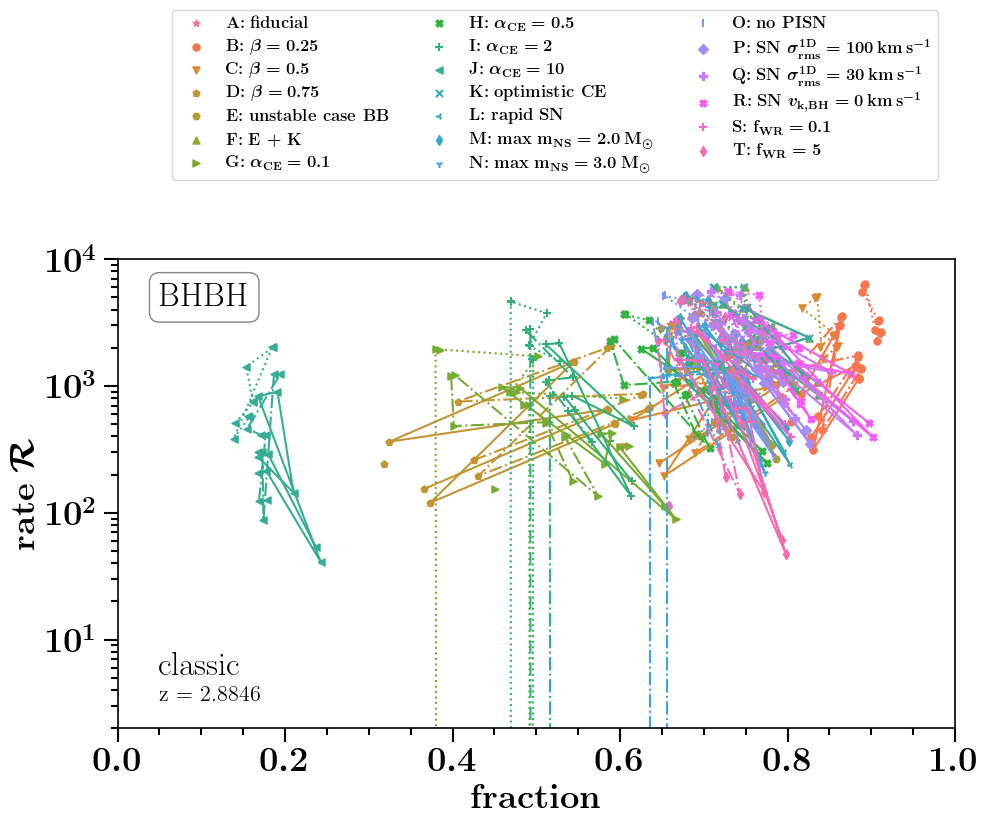


at DCOtype = BNS
running for redshift  2.8846
ind z = 7
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.32618666 0.16941508 0.36785137 0.39632463 0.30806345 0.21762338
 0.19930571 0.32946982 0.20202962 0.18714555 0.16616818 0.34182219
 0.37414826 0.300616   0.20850366 0.19031747 0.32232598 0.19331014
 0.17834729 0.16987214 0.37301118 0.40051837 0.30914157 0.21919573
 0.20088562 0.33049878 0.20352225 0.18870785]


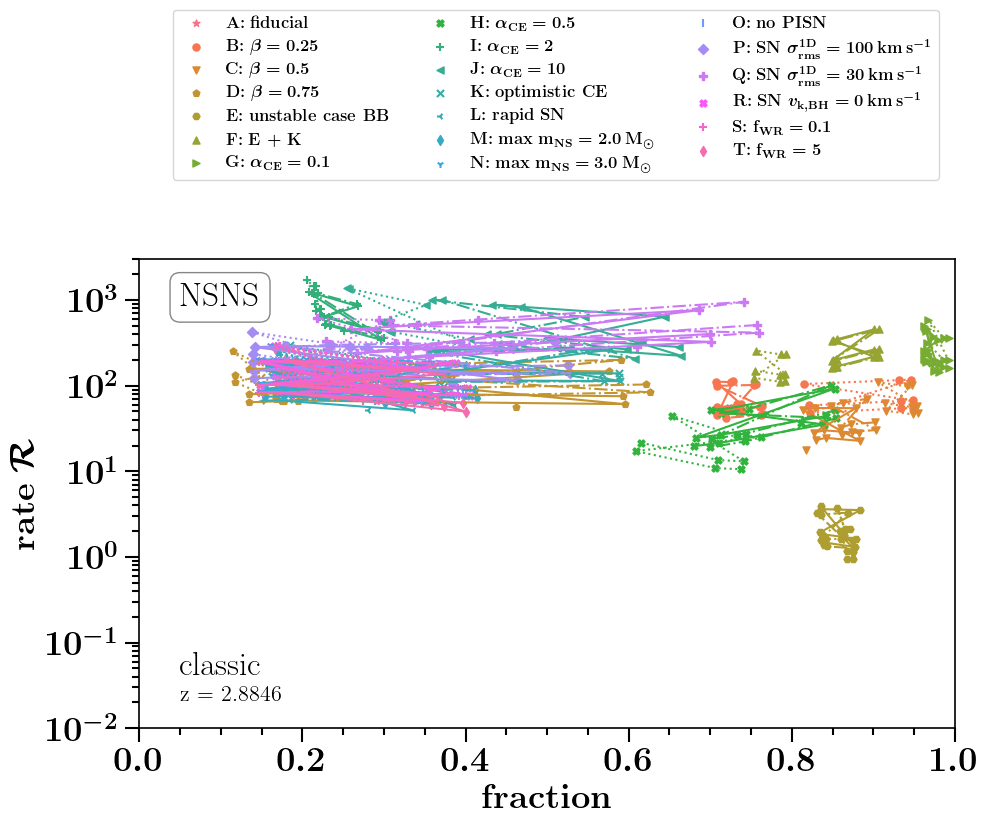


at DCOtype = BHNS
running for redshift  3.2692
ind z = 8
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.7087679  0.61232413 0.69456192 0.69882359 0.5742506  0.64096453
 0.6638908  0.56941657 0.64058093 0.66904381 0.61248754 0.6921315
 0.71374281 0.57088107 0.63471214 0.6641736  0.56697959 0.63594665
 0.67256764 0.61154898 0.69429852 0.69309981 0.57334345 0.64145508
 0.66282009 0.56816059 0.64073415 0.66727468]


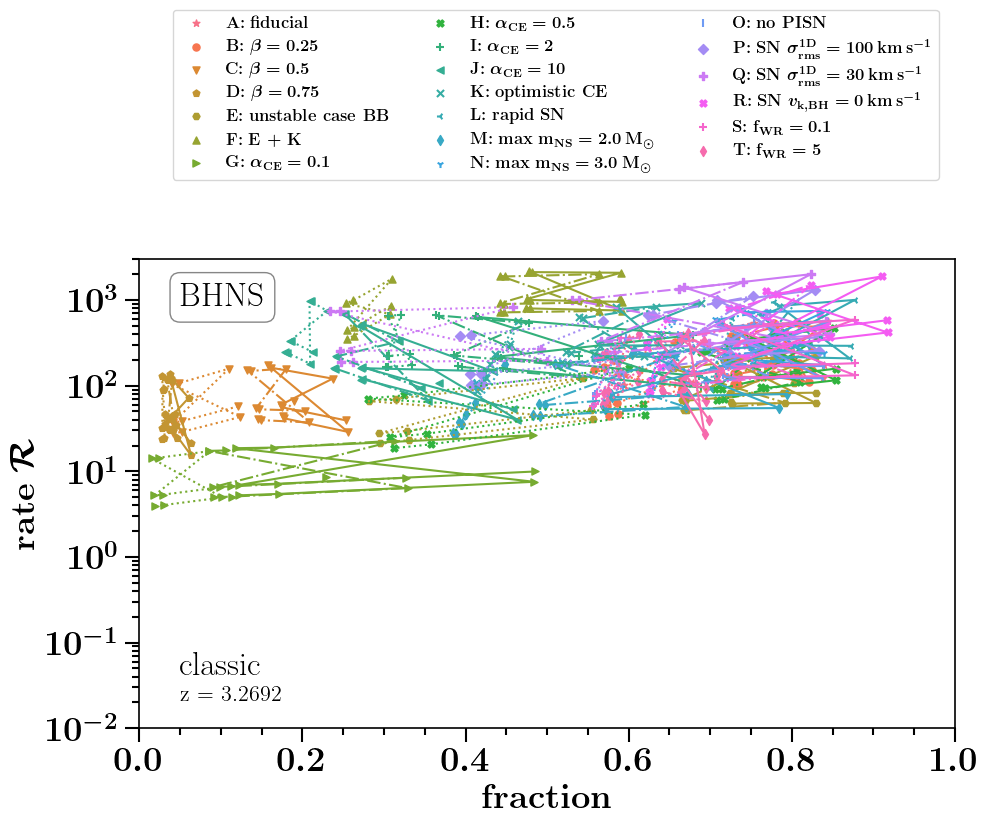


at DCOtype = BBH
running for redshift  3.2692
ind z = 8
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.6938566  0.77935615 0.74106102 0.80134822 0.71570783 0.71641742
 0.7394589  0.71577791 0.72584244 0.76092098 0.73548738 0.67965613
 0.78412642 0.66981198 0.66141053 0.68079253 0.66986082 0.67284066
 0.71493622 0.78850387 0.75648765 0.80510558 0.72548709 0.72861714
 0.75223636 0.72554797 0.73750832 0.77080094]


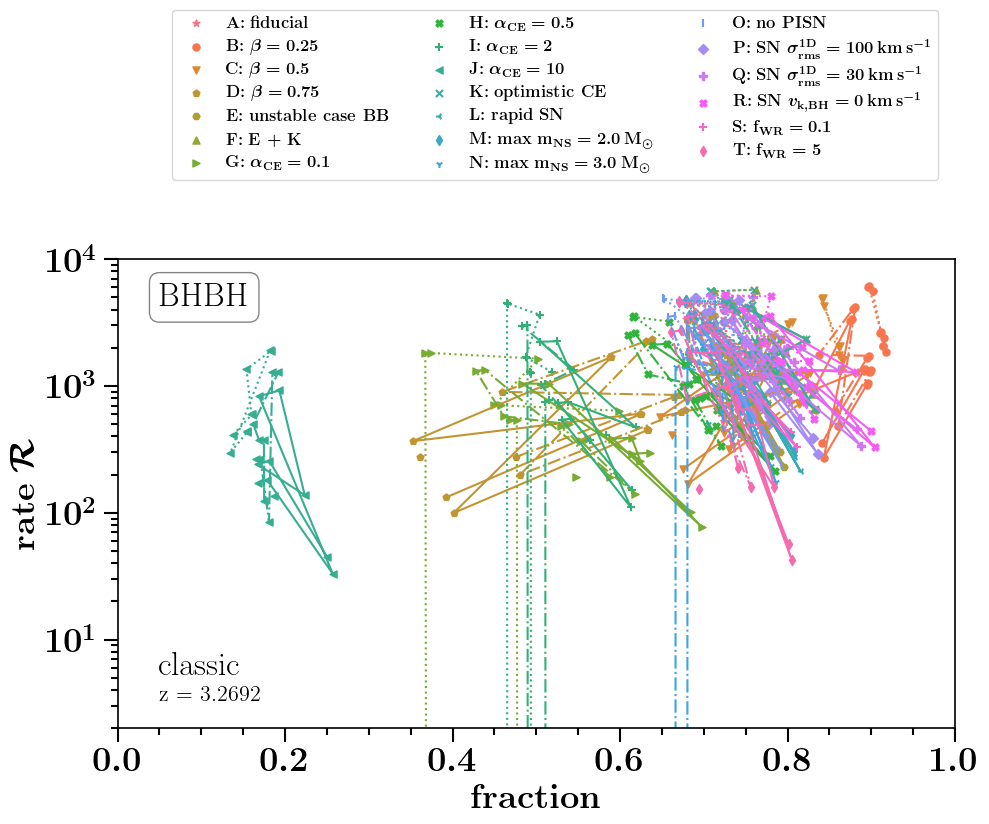


at DCOtype = BNS
running for redshift  3.2692
ind z = 8
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.21882581 0.23789608 0.24394451 0.33981337 0.38796107 0.19997274
 0.18697075 0.41889214 0.20073798 0.18272096 0.23117607 0.22783085
 0.32342721 0.37922    0.19021119 0.17685114 0.41011017 0.19107096
 0.17237057 0.23945112 0.2479757  0.34356633 0.38985471 0.20225175
 0.18936109 0.42078777 0.2030152  0.1852025 ]


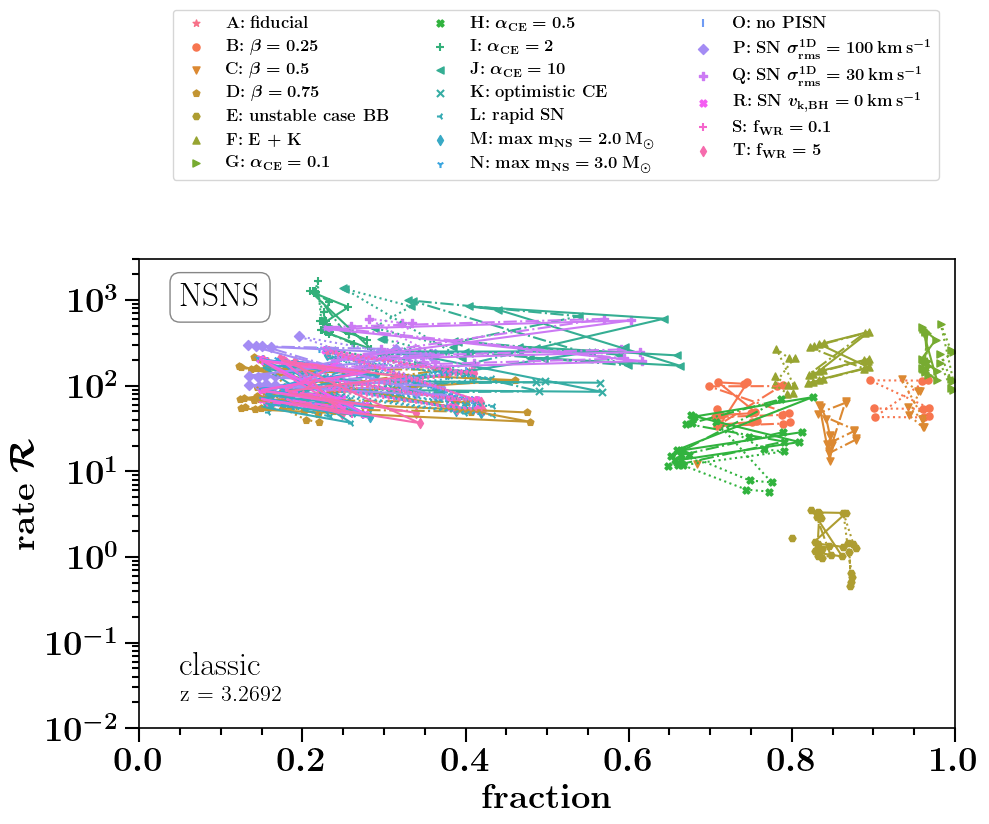


at DCOtype = BHNS
running for redshift  3.6538
ind z = 9
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.69793102 0.59218093 0.68084098 0.69429201 0.56037263 0.62524571
 0.65038858 0.5579357  0.62500699 0.65825262 0.59724322 0.68024508
 0.71510633 0.56711197 0.6215133  0.65020945 0.56538996 0.62277288
 0.66339004 0.58933153 0.68000939 0.68610003 0.55549034 0.6245868
 0.64895764 0.55268811 0.62404459 0.6556499 ]


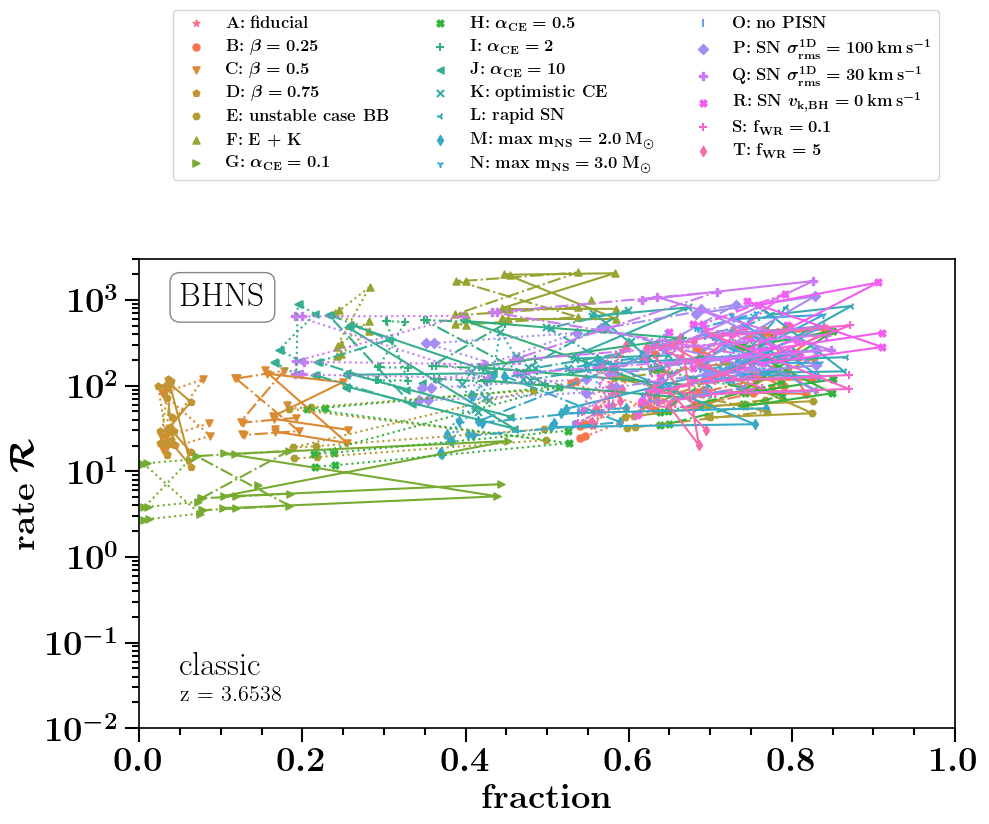


at DCOtype = BBH
running for redshift  3.6538
ind z = 9
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.72525239 0.78253456 0.75512798 0.80744934 0.7066674  0.72153575
 0.74089693 0.70532209 0.73313215 0.76697972 0.74206771 0.70474444
 0.79397517 0.66443085 0.6742226  0.68913334 0.66297426 0.68730109
 0.72658542 0.79205022 0.76855491 0.81067006 0.7169593  0.73320608
 0.75351517 0.71563807 0.74433814 0.7766612 ]


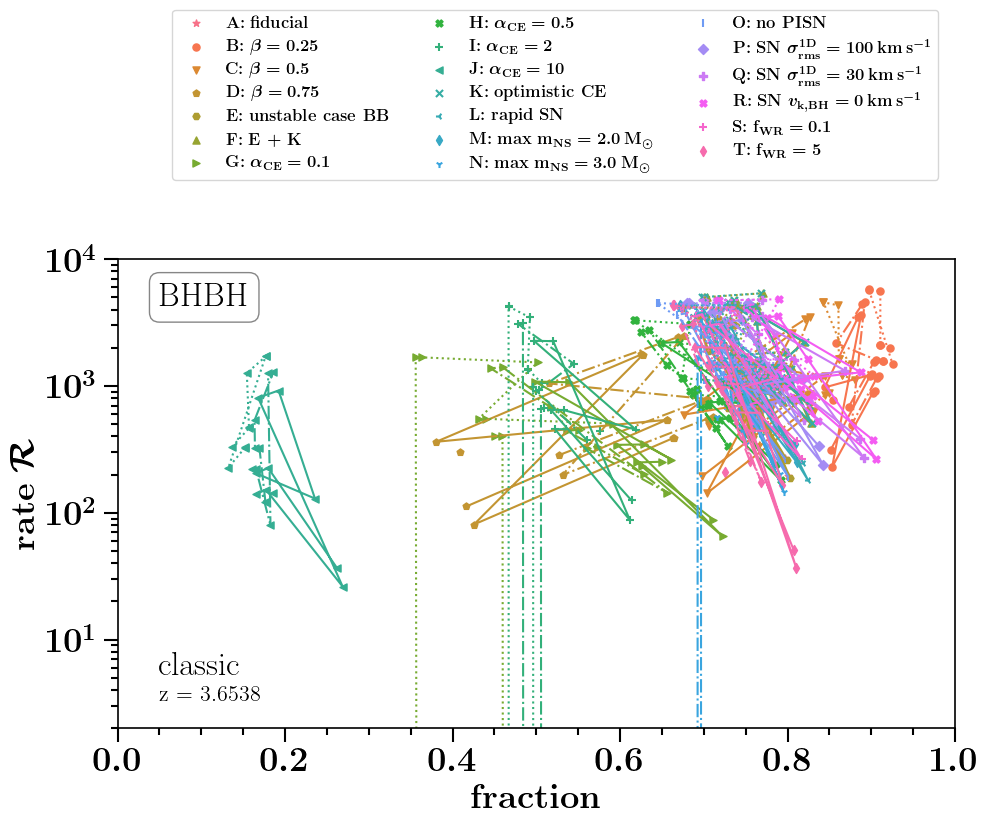


at DCOtype = BNS
running for redshift  3.6538
ind z = 9
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.13744724 0.32396726 0.16967057 0.30039121 0.44471877 0.21306967
 0.18777395 0.46192047 0.21470396 0.18160418 0.31480767 0.15906446
 0.2878529  0.43525466 0.20319812 0.17656717 0.45255286 0.20524419
 0.1701382  0.3264068  0.17286647 0.30372757 0.44711874 0.21576243
 0.19084903 0.46428517 0.21730294 0.18479697]


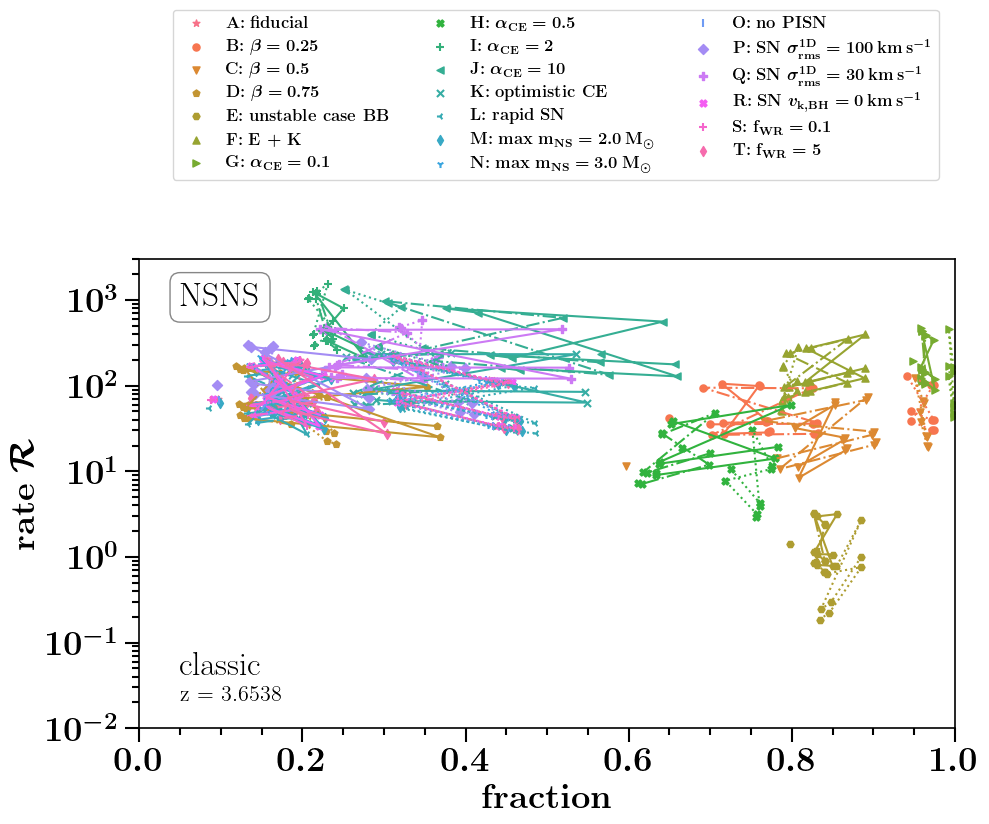


at DCOtype = BHNS
running for redshift  4.0385
ind z = 10
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.69029415 0.58421145 0.66845793 0.68694468 0.54782546 0.61067516
 0.64065398 0.54623393 0.61083931 0.64810113 0.60011134 0.670197
 0.71265489 0.57202084 0.61710233 0.6456168  0.57092734 0.61765698
 0.65614854 0.57752641 0.66706056 0.67683454 0.53716374 0.60698227
 0.63761201 0.53528778 0.60711844 0.64442178]


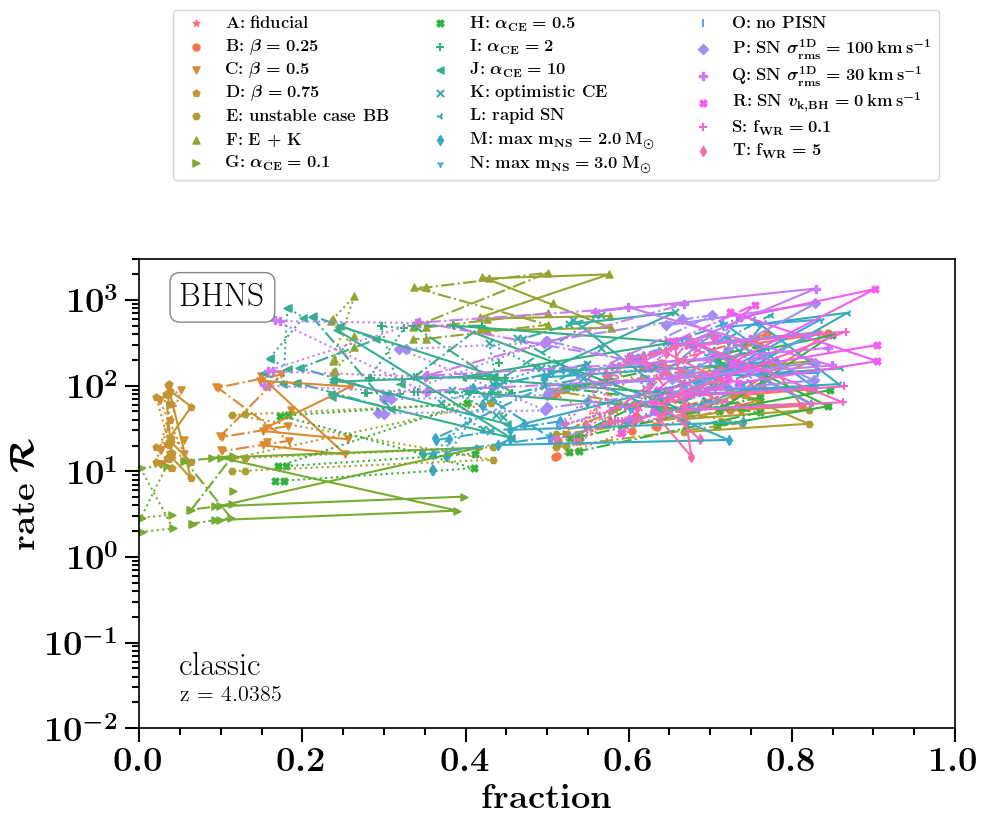


at DCOtype = BBH
running for redshift  4.0385
ind z = 10
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.7494348  0.78279288 0.76807243 0.81256046 0.69562148 0.72344967
 0.74037086 0.69384643 0.73664719 0.77123724 0.74539363 0.72703953
 0.80238451 0.65731752 0.68256469 0.69526037 0.65542041 0.69674524
 0.73601926 0.79249914 0.77956419 0.81518075 0.70596971 0.73445497
 0.75244559 0.70422745 0.74729434 0.78047744]


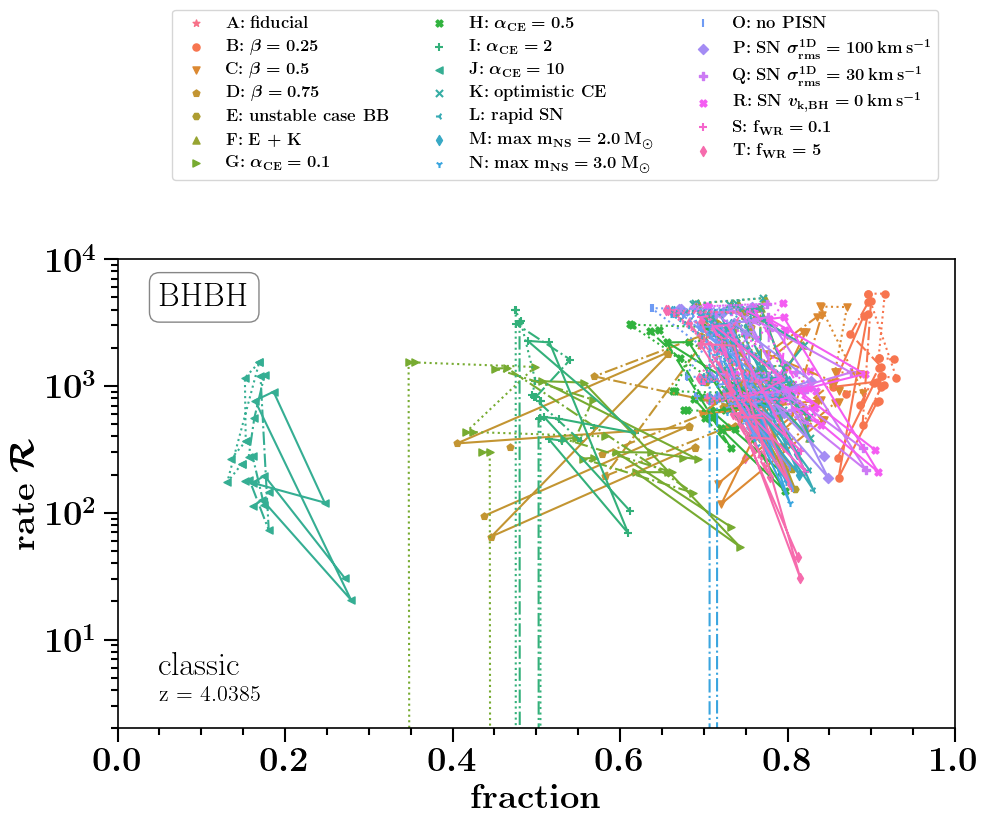


at DCOtype = BNS
running for redshift  4.0385
ind z = 10
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.08308267 0.4079301  0.13681319 0.27504289 0.46202674 0.24711313
 0.19589193 0.47425473 0.25836193 0.18504585 0.39817455 0.12888602
 0.26433277 0.45110891 0.23735967 0.18422125 0.46331343 0.24890077
 0.1728823  0.41073926 0.13947681 0.27824046 0.46498893 0.25000803
 0.19940136 0.47720025 0.26117529 0.18873195]


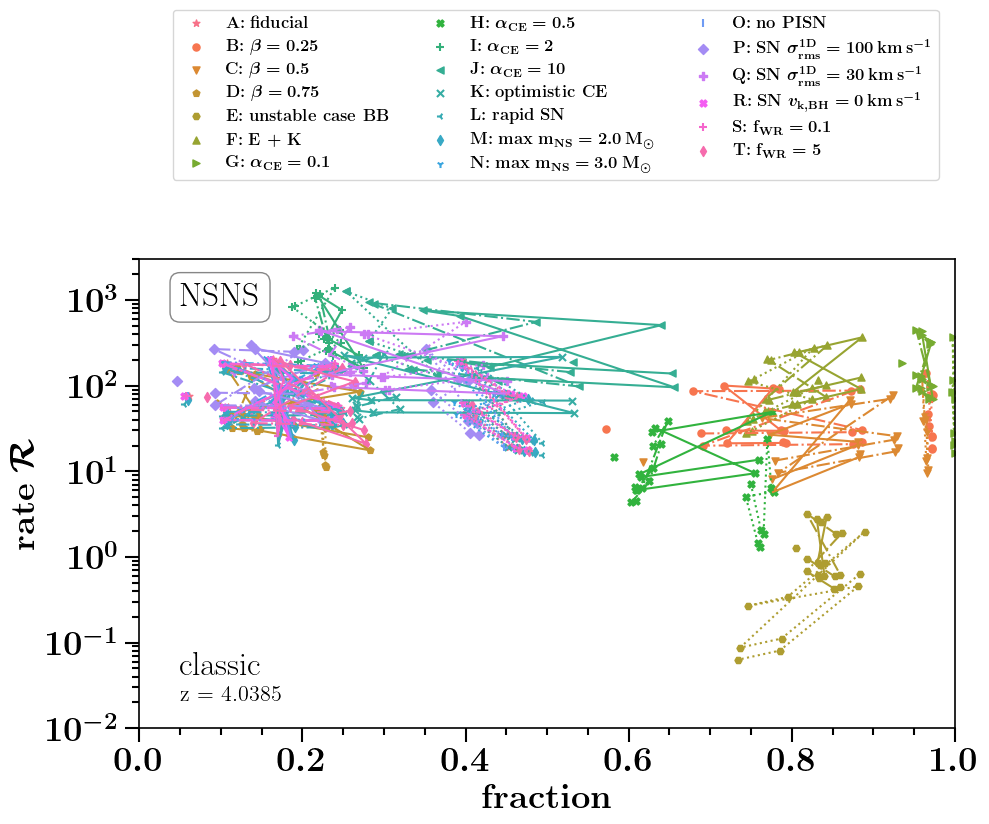


at DCOtype = BHNS
running for redshift  4.4231
ind z = 11
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.67868382 0.57828692 0.65752494 0.67653835 0.53607495 0.59217351
 0.63232555 0.53331645 0.59159036 0.63900996 0.60940794 0.6618369
 0.70490994 0.58072694 0.61501024 0.64662796 0.578567   0.61456448
 0.65214587 0.5665503  0.65550531 0.66535391 0.51881888 0.58356319
 0.62660148 0.51580417 0.5829744  0.63369838]


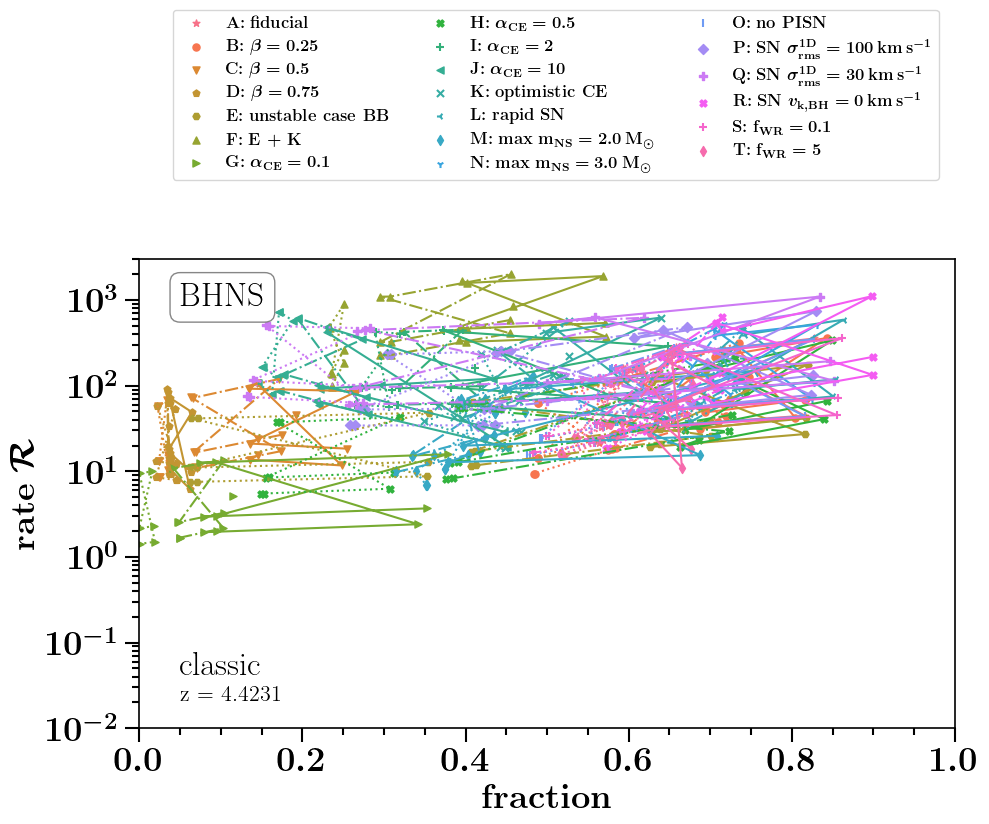


at DCOtype = BBH
running for redshift  4.4231
ind z = 11
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.76859643 0.77952873 0.77957895 0.81672373 0.68548554 0.72176464
 0.73716629 0.68404212 0.73625906 0.77378738 0.74431482 0.74546971
 0.80898045 0.65089077 0.6854406  0.6971584  0.6493193  0.7005136
 0.7424728  0.78943496 0.7895246  0.81882371 0.69560481 0.73226928
 0.74873044 0.69419855 0.74651281 0.78262269]


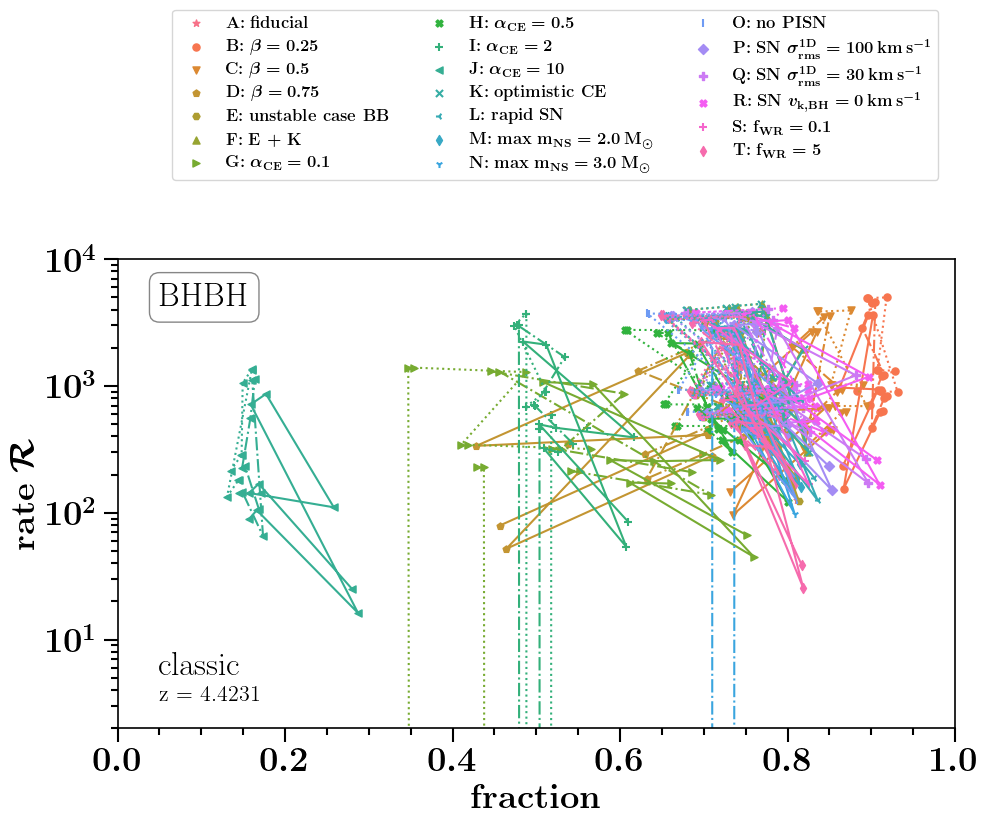


at DCOtype = BNS
running for redshift  4.4231
ind z = 11
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.05644145 0.47352811 0.11916998 0.25891161 0.42392124 0.30282164
 0.20982547 0.41862008 0.32452434 0.19460816 0.4645266  0.11297108
 0.24854192 0.40979514 0.29306806 0.19799526 0.40366529 0.315063
 0.18206625 0.47623131 0.12139657 0.26222115 0.42791303 0.30583226
 0.21360152 0.42284065 0.32744197 0.19863576]


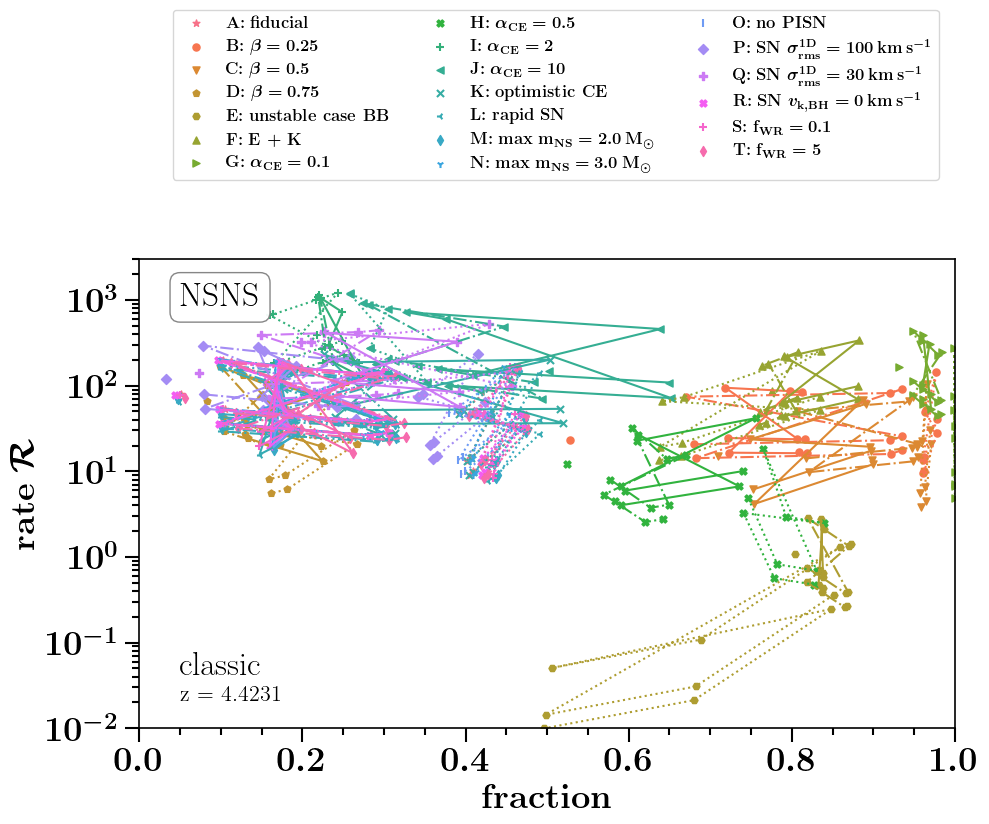


at DCOtype = BHNS
running for redshift  4.8077
ind z = 12
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.66340884 0.56141901 0.64655665 0.6635905  0.52314427 0.5647164
 0.61951667 0.52174294 0.56304273 0.62781497 0.60386348 0.65428069
 0.69261653 0.57935027 0.60210742 0.64061866 0.57832865 0.60064037
 0.64468698 0.54522015 0.64352409 0.65211842 0.50105041 0.55067152
 0.61142038 0.4994804  0.54892388 0.6210763 ]


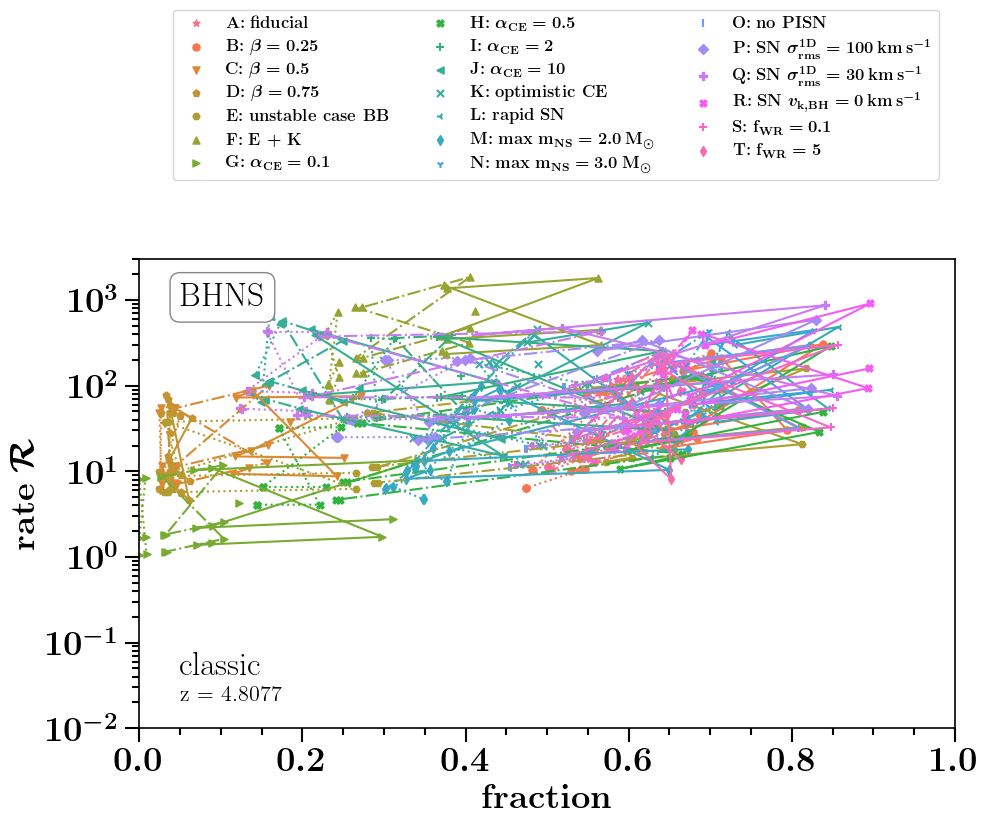


at DCOtype = BBH
running for redshift  4.8077
ind z = 12
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.78476146 0.77295396 0.78993204 0.82025525 0.67889754 0.71721775
 0.73203802 0.67792333 0.73257914 0.77522165 0.73964137 0.76173833
 0.81447108 0.64782137 0.68449361 0.69637184 0.64669155 0.70002243
 0.74729406 0.78299169 0.79850777 0.82188058 0.68858404 0.72728984
 0.74304547 0.68765769 0.74252628 0.78362239]


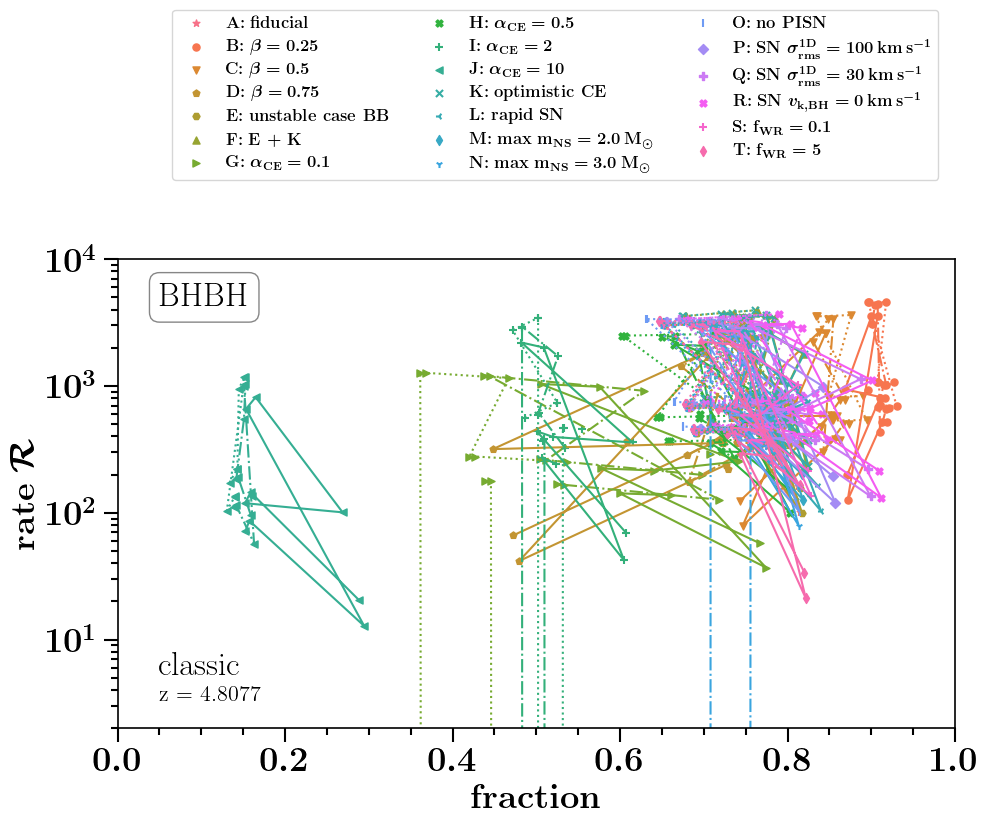


at DCOtype = BNS
running for redshift  4.8077
ind z = 12
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.05629046 0.52226492 0.12638954 0.2486978  0.29912202 0.36603786
 0.22926452 0.25256902 0.39493918 0.21073749 0.51414767 0.12049989
 0.23865421 0.28293674 0.35578966 0.21748979 0.23701917 0.38503014
 0.19795204 0.52470759 0.12855387 0.25209035 0.30393341 0.36920969
 0.23317432 0.25723956 0.39799993 0.21502334]


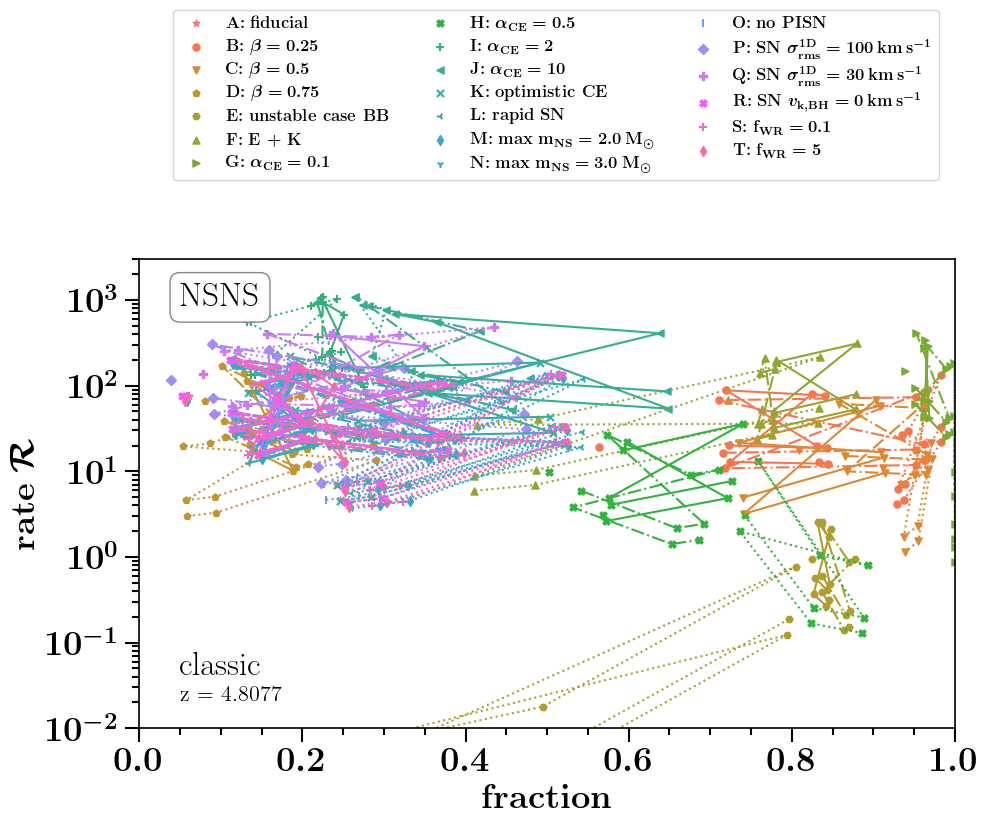


at DCOtype = BHNS
running for redshift  5.1923
ind z = 13
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.64712216 0.5299724  0.63179127 0.64762798 0.51075163 0.53452896
 0.60484757 0.51019479 0.53426628 0.61525035 0.58276042 0.64495283
 0.6748926  0.57585089 0.58691919 0.63446708 0.57559053 0.58595845
 0.63677272 0.50962301 0.6269665  0.63677422 0.4847127  0.51438838
 0.59366059 0.48401932 0.51440838 0.60681028]


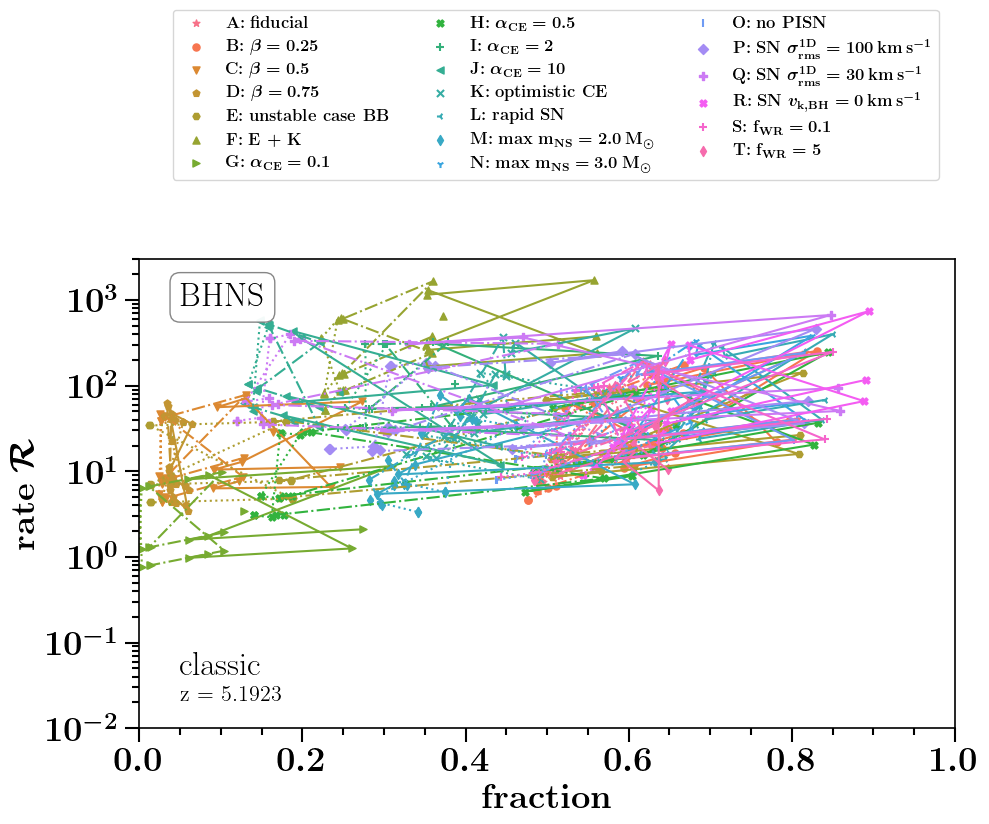


at DCOtype = BBH
running for redshift  5.1923
ind z = 13
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.79799407 0.76335075 0.79840302 0.82335598 0.67744587 0.71103511
 0.72541403 0.6767436  0.72675565 0.77579819 0.73224904 0.77432471
 0.81931014 0.64961272 0.68151171 0.69369508 0.64873474 0.69707561
 0.75071837 0.77330175 0.80602617 0.82452381 0.68657855 0.72063052
 0.73577403 0.68593454 0.73634067 0.78376444]


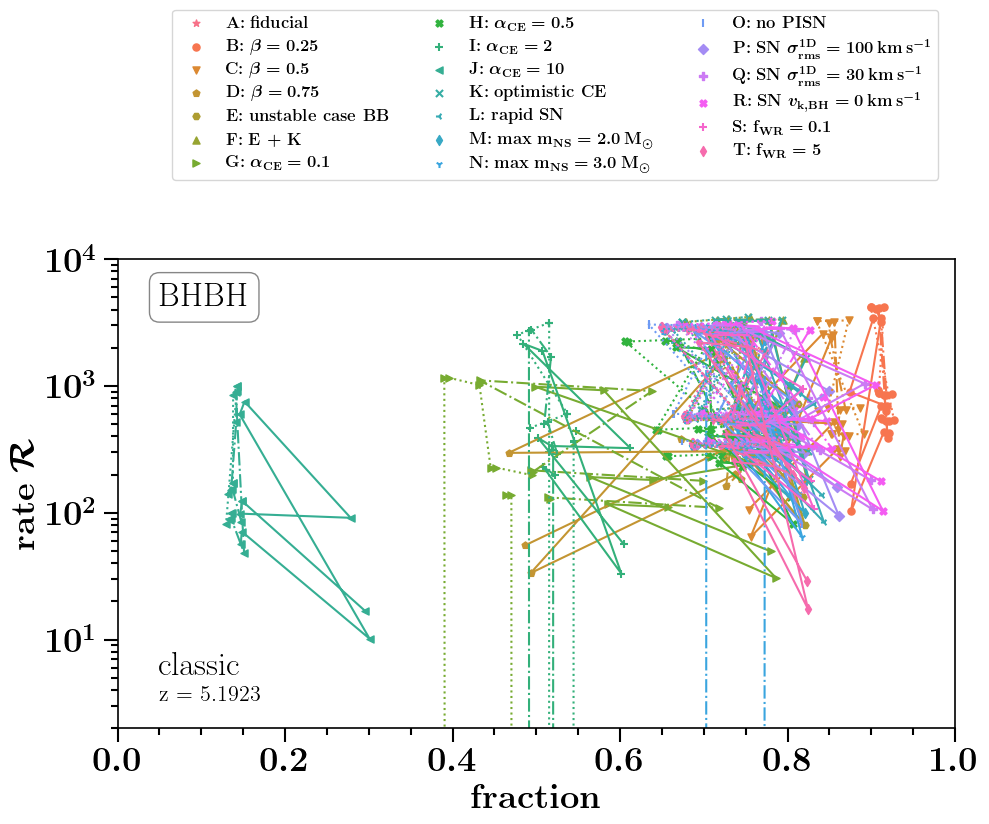


at DCOtype = BNS
running for redshift  5.1923
ind z = 13
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.08201804 0.55173194 0.16839858 0.2417199  0.12709128 0.41288349
 0.25390014 0.08348359 0.44591781 0.23244969 0.54347281 0.16177666
 0.23174928 0.11758193 0.4020505  0.24262914 0.07675178 0.4353832
 0.21957141 0.55419374 0.17085561 0.24521581 0.13011932 0.41623741
 0.25774101 0.08564404 0.4491884  0.23691056]


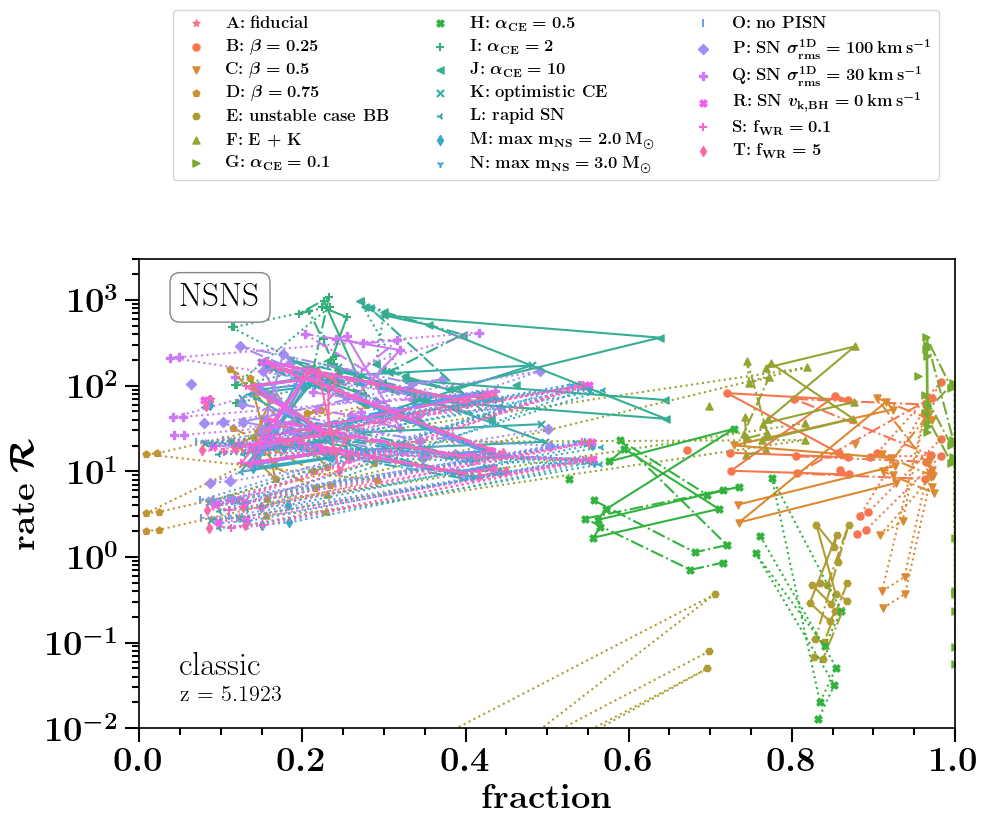


at DCOtype = BHNS
running for redshift  5.5769
ind z = 14
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.62632149 0.48982964 0.60811955 0.63151642 0.49104097 0.50103105
 0.5804339  0.49311388 0.50237216 0.59768493 0.54856341 0.6272368
 0.65686427 0.55853583 0.56166029 0.61599975 0.56059729 0.56131406
 0.62160713 0.46641729 0.60095845 0.6214814  0.46296762 0.47648573
 0.56650727 0.46497586 0.47861169 0.58810248]


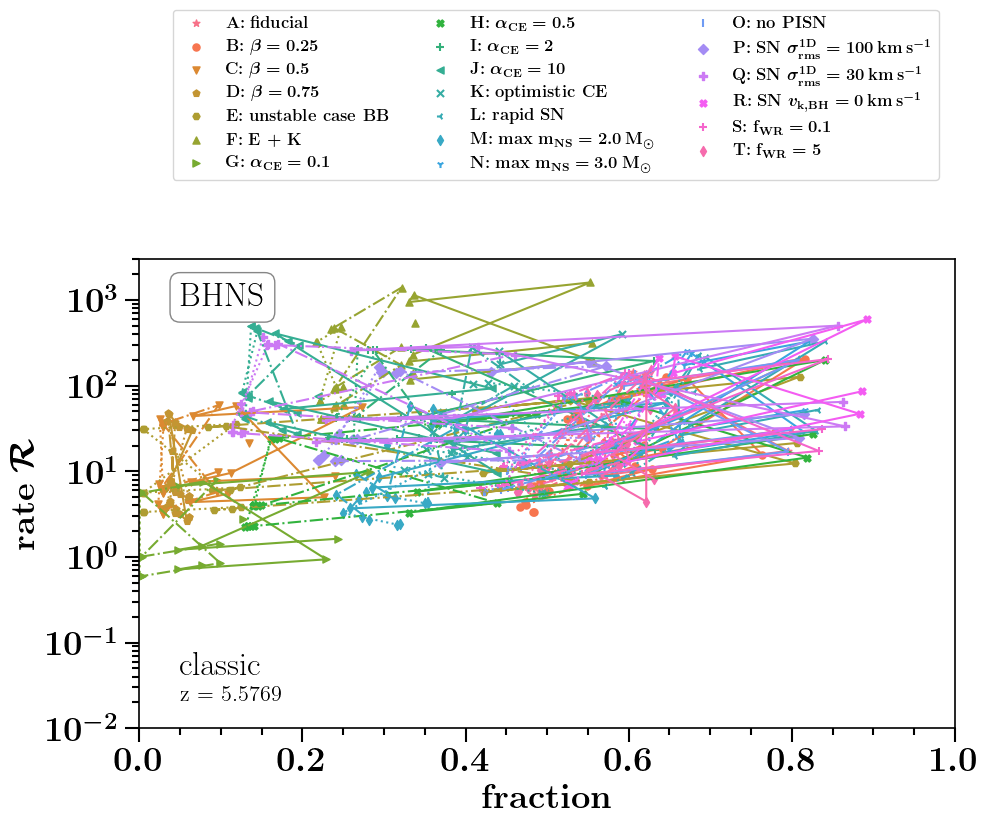


at DCOtype = BBH
running for redshift  5.5769
ind z = 14
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.80884395 0.75119808 0.8056828  0.82591087 0.68103224 0.70517718
 0.71846303 0.68012126 0.72019646 0.77589604 0.72283451 0.7846833
 0.82315388 0.65618476 0.67887058 0.69068406 0.65510513 0.69349111
 0.75350284 0.76077494 0.81260197 0.82670212 0.68955426 0.71415467
 0.72800376 0.68870476 0.72926344 0.78336773]


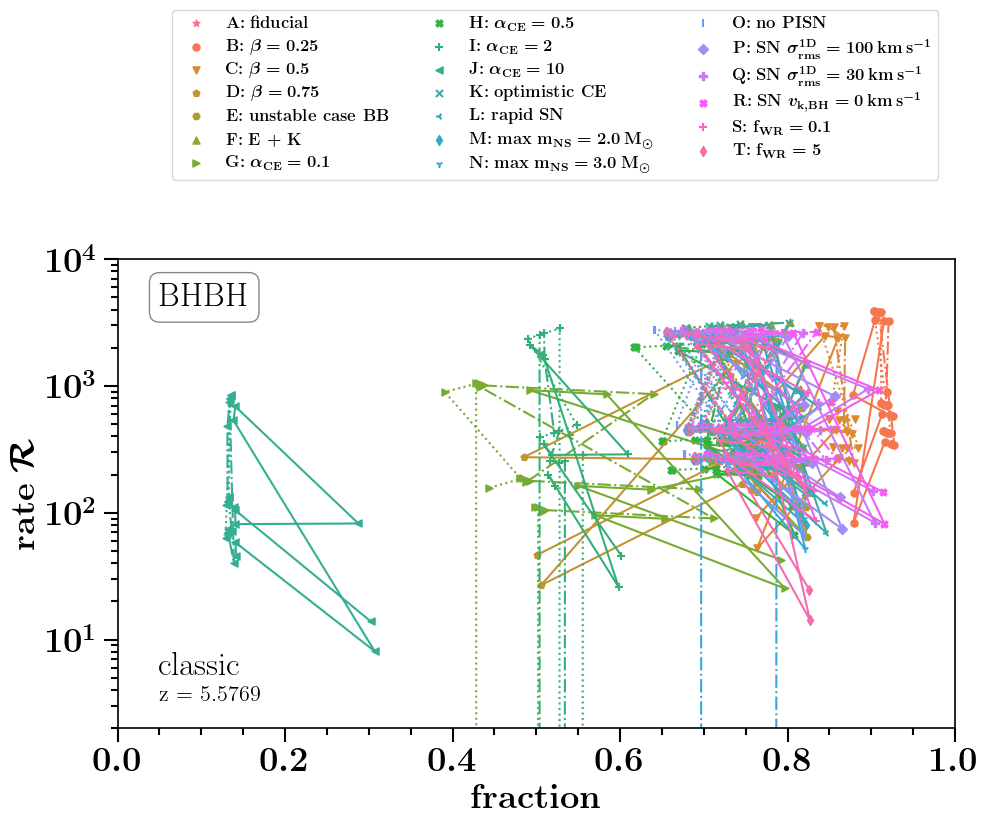


at DCOtype = BNS
running for redshift  5.5769
ind z = 14
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.1340476  0.54272934 0.24040636 0.23726309 0.02909509 0.41580076
 0.2812305  0.01916968 0.45468408 0.25749182 0.53245333 0.23251083
 0.22777555 0.02658106 0.40333728 0.27072241 0.01745164 0.44314013
 0.24465213 0.54581612 0.24329662 0.24071863 0.02993265 0.41966922
 0.28484884 0.01974494 0.45826599 0.26205298]


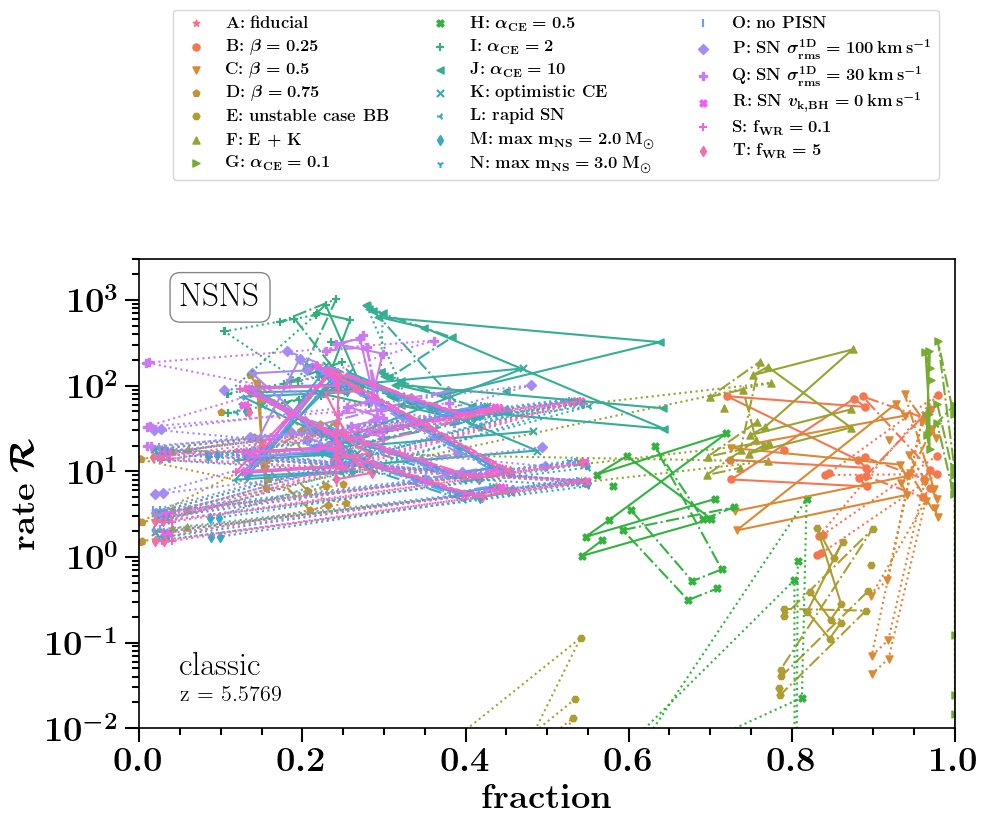


at DCOtype = BHNS
running for redshift  5.9615
ind z = 15
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.60461735 0.45394544 0.57780614 0.61374538 0.46797858 0.46986631
 0.54422691 0.47203713 0.47203297 0.57973504 0.52202299 0.60656977
 0.63542111 0.5428006  0.54112628 0.59047495 0.54667679 0.54112315
 0.60904604 0.42691382 0.5669757  0.60512093 0.43710293 0.44092795
 0.52620256 0.44114707 0.44415037 0.56819452]


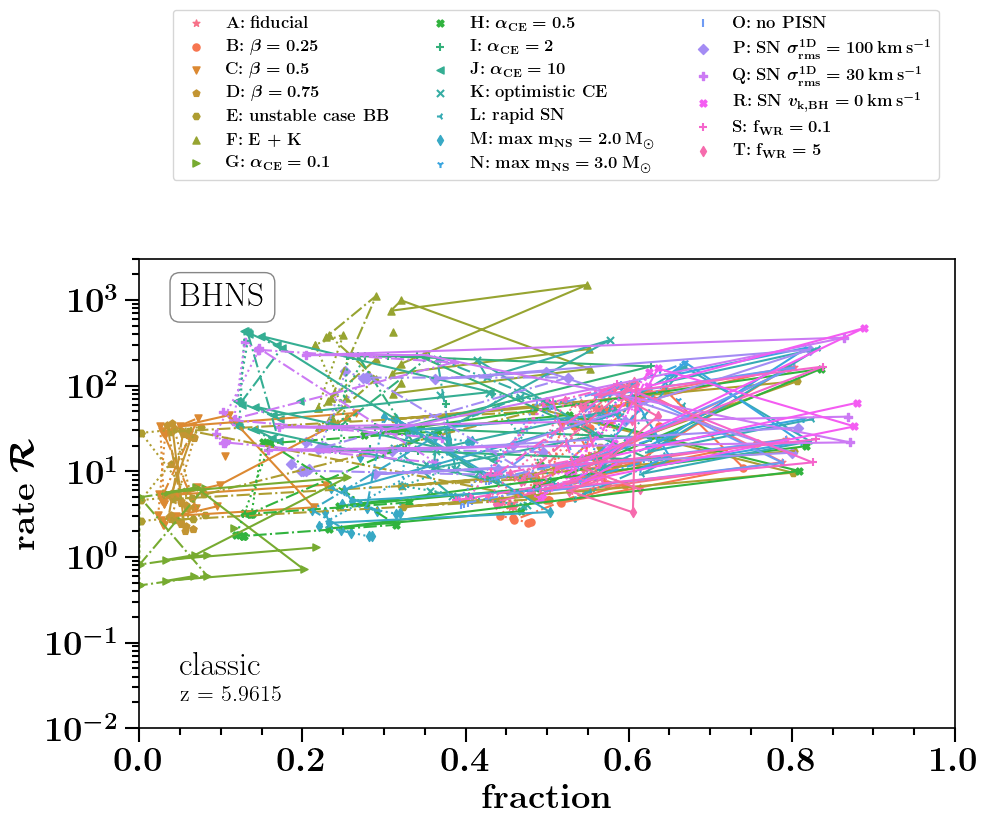


at DCOtype = BBH
running for redshift  5.9615
ind z = 15
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.81896348 0.73821223 0.81162829 0.82826256 0.68799632 0.70154397
 0.71199629 0.68700922 0.71466449 0.77538451 0.71293097 0.79292396
 0.8266572  0.66570243 0.67825902 0.6879432  0.66456067 0.69085064
 0.75534563 0.74714838 0.81804507 0.82868718 0.6959359  0.70982618
 0.720616   0.69501    0.72310425 0.78236929]


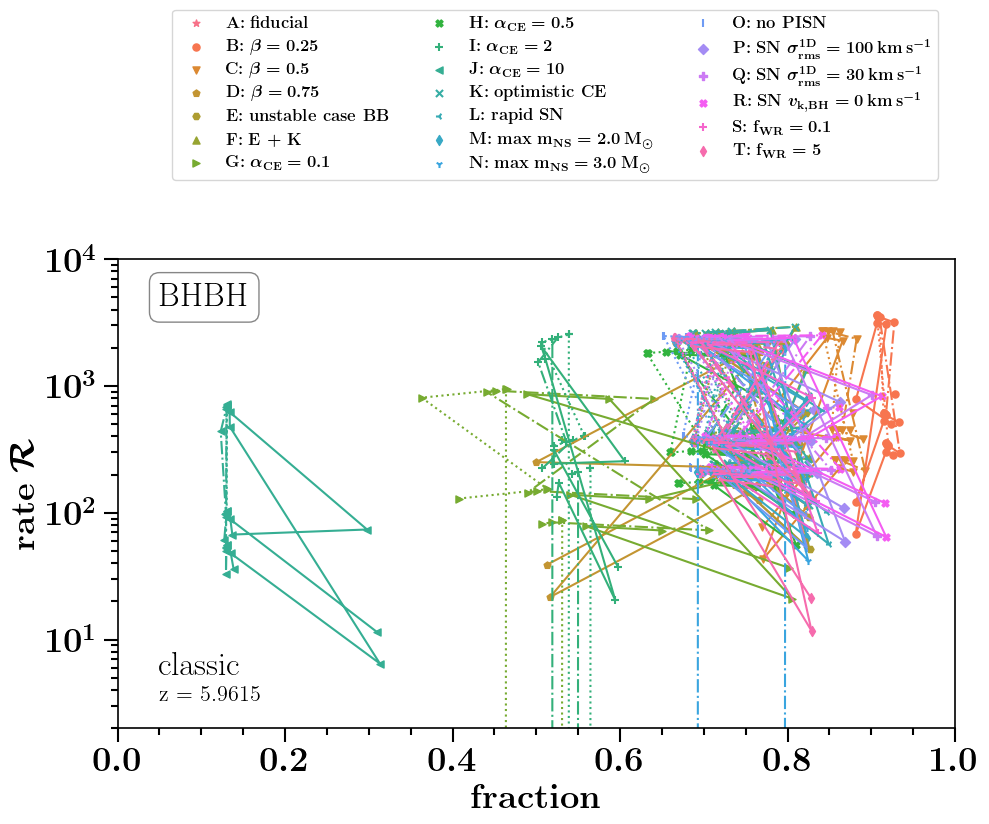


at DCOtype = BNS
running for redshift  5.9615
ind z = 15
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.21126261 0.46627737 0.33260227 0.23419217 0.00391822 0.34876742
 0.30454556 0.00140294 0.42649921 0.2834383  0.45143177 0.32394483
 0.2251576  0.00354642 0.33349031 0.29404232 0.00126237 0.4125793
 0.27048039 0.47084537 0.3357112  0.23758484 0.00404438 0.3535497
 0.30808996 0.00145125 0.43077287 0.28808819]


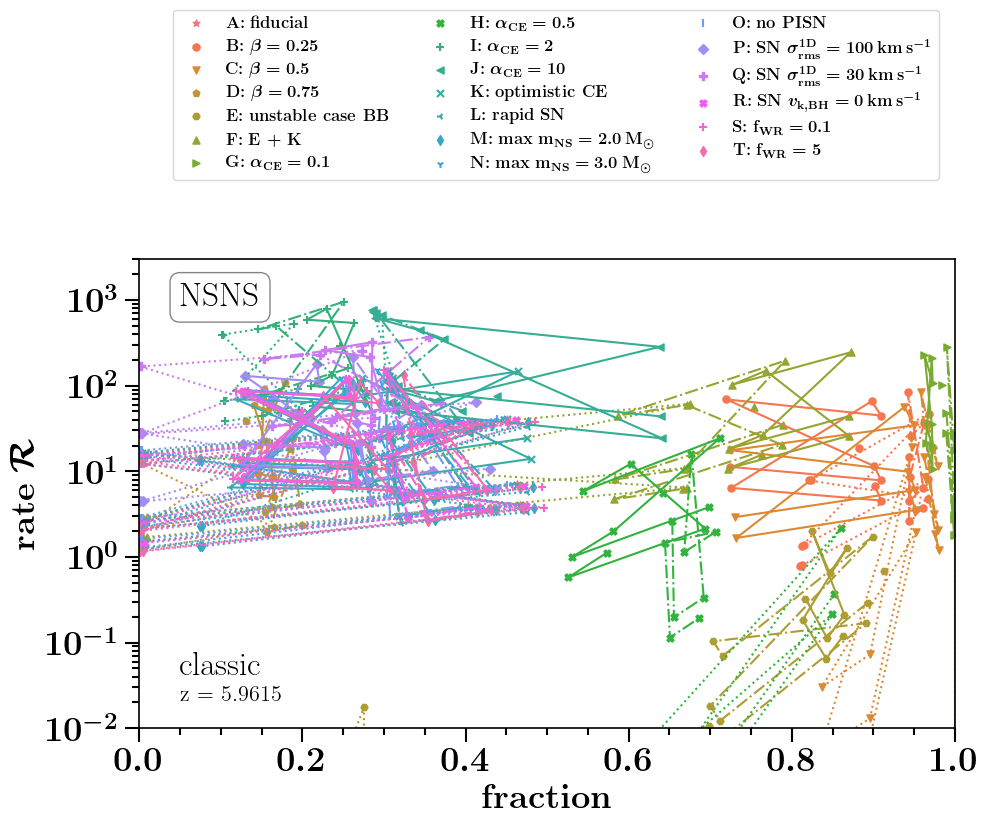


at DCOtype = BHNS
running for redshift  6.3462
ind z = 16
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.57786838 0.40806904 0.5326873  0.59732844 0.42486393 0.42480706
 0.48329954 0.42835331 0.42530532 0.55036033 0.47706947 0.56722136
 0.61565498 0.49864468 0.49705884 0.53590775 0.50193721 0.49548243
 0.58128157 0.38033653 0.51937728 0.59002438 0.3942962  0.39508863
 0.46238387 0.39779634 0.39664399 0.53813854]


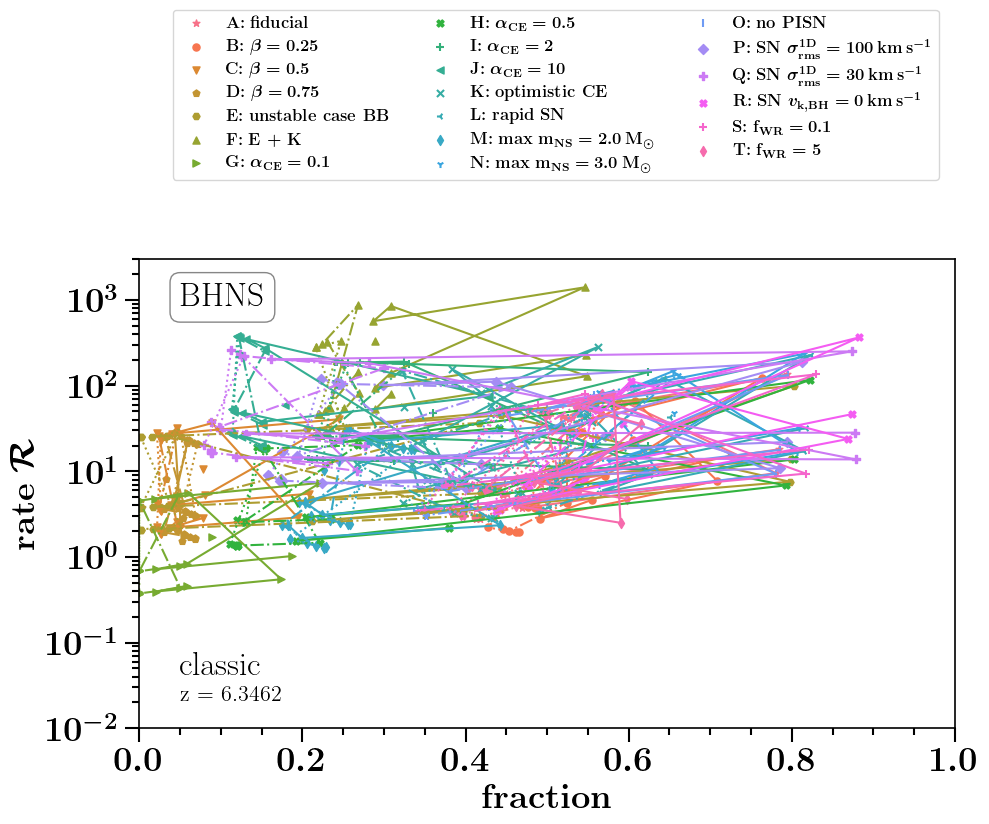


at DCOtype = BBH
running for redshift  6.3462
ind z = 16
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.82838265 0.72738962 0.81619817 0.83040108 0.69700213 0.70229719
 0.70851428 0.69593665 0.7124749  0.77487672 0.7055103  0.79927613
 0.82983074 0.6771572  0.68196384 0.68814537 0.67596642 0.69160779
 0.75706789 0.73542471 0.82222412 0.8304745  0.70430254 0.70978188
 0.71606731 0.70329167 0.72014295 0.78131889]


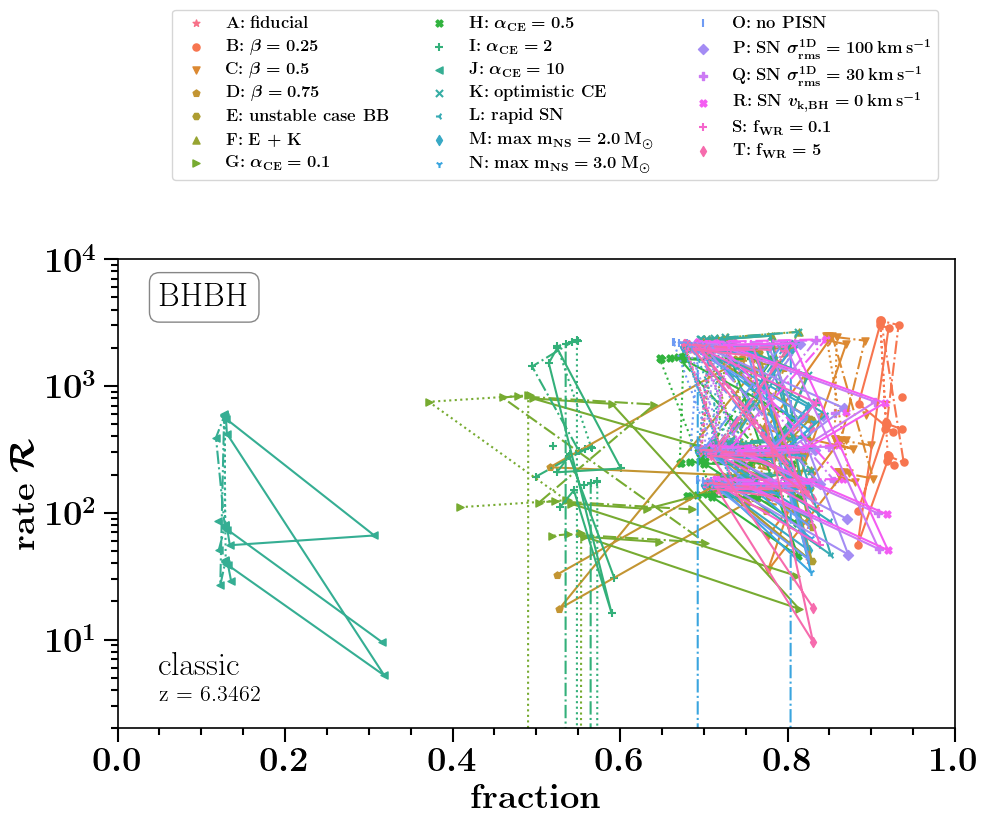


at DCOtype = BNS
running for redshift  6.3462
ind z = 16
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[3.02041944e-01 3.20767243e-01 4.25967626e-01 2.32649637e-01
 2.04104375e-04 2.02033985e-01 3.08255526e-01 2.31894495e-06
 3.45304759e-01 3.11048525e-01 3.10931776e-01 4.18838659e-01
 2.24208916e-01 1.91311364e-04 1.93813814e-01 2.99708898e-01
 2.16336071e-06 3.35889031e-01 2.99850650e-01 3.24163689e-01
 4.28583754e-01 2.35896835e-01 2.08763588e-04 2.04911319e-01
 3.11260080e-01 2.37625014e-06 3.48508259e-01 3.15205015e-01]


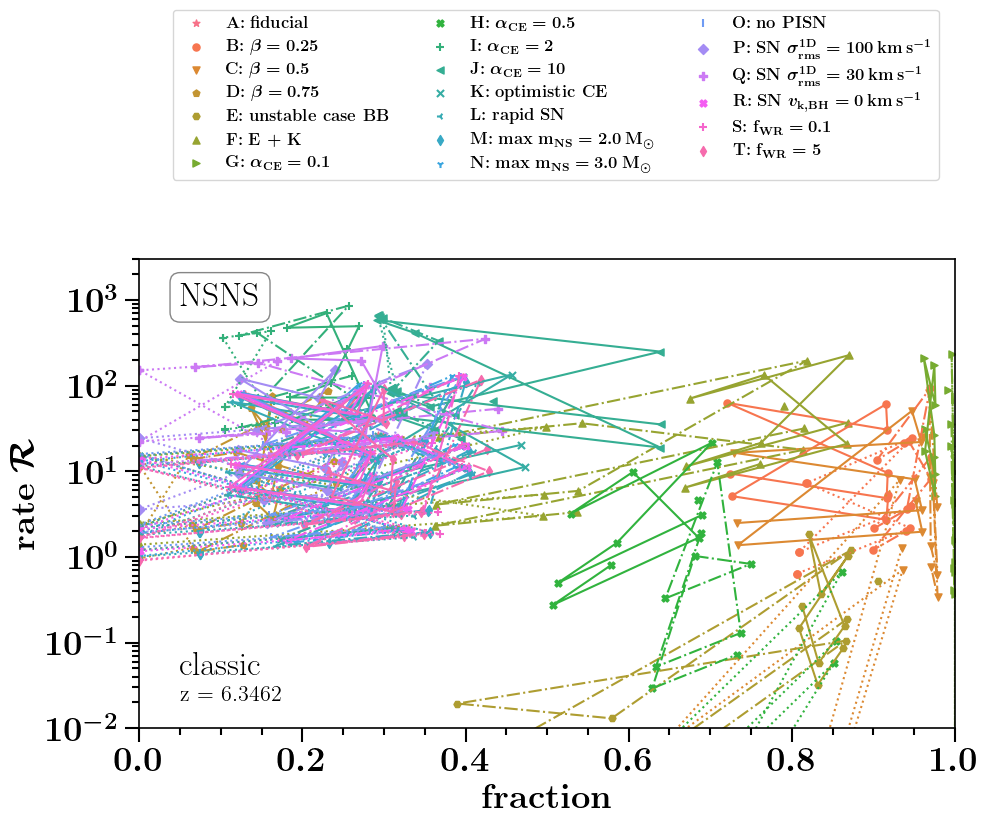


at DCOtype = BHNS
running for redshift  6.7308
ind z = 17
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.53552958 0.35161251 0.47499916 0.58055847 0.36266367 0.36300635
 0.40179689 0.36535735 0.36265758 0.51106195 0.41907875 0.51280812
 0.59475066 0.43376898 0.43361228 0.46042604 0.43643076 0.431477
 0.54295097 0.32481636 0.46038401 0.57479735 0.33393128 0.33452476
 0.3784791  0.33659194 0.33506007 0.49864238]


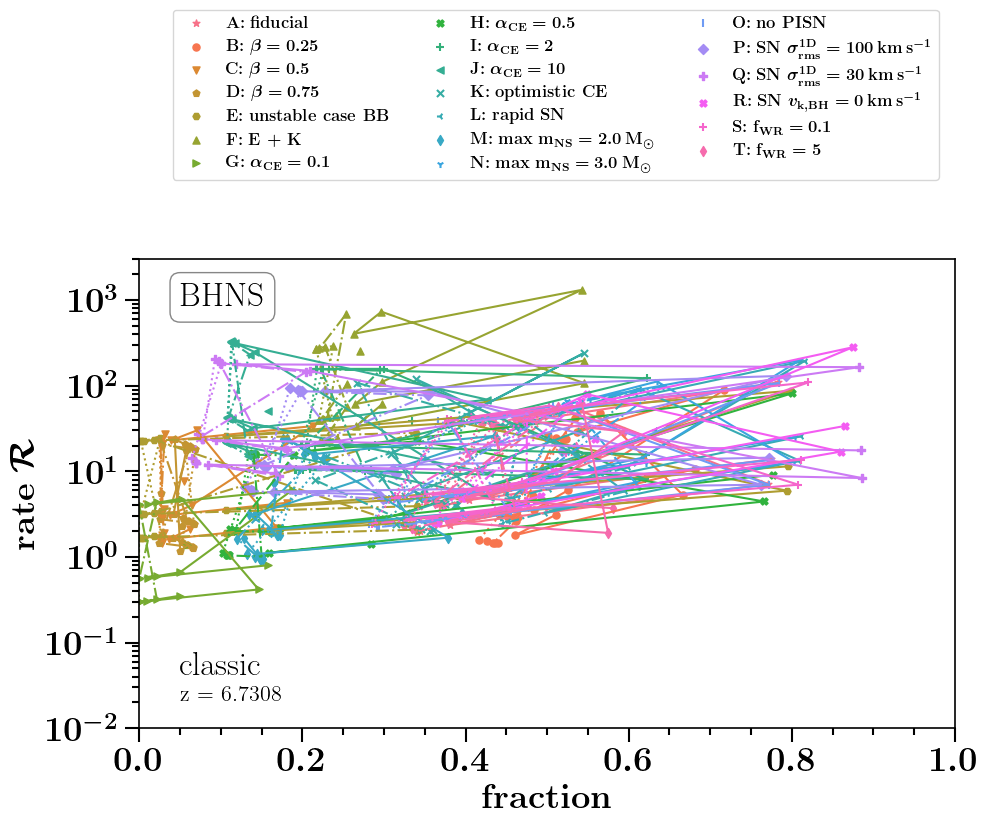


at DCOtype = BBH
running for redshift  6.7308
ind z = 17
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.83798138 0.72168928 0.81937811 0.83212286 0.7072702  0.70833161
 0.71251483 0.70605571 0.71468232 0.77513454 0.70344269 0.8043274
 0.83236118 0.6901054  0.69103012 0.69580336 0.68884807 0.69697115
 0.75984438 0.72862812 0.82494245 0.83190237 0.71379106 0.71490852
 0.71889466 0.71260029 0.72141446 0.78086786]


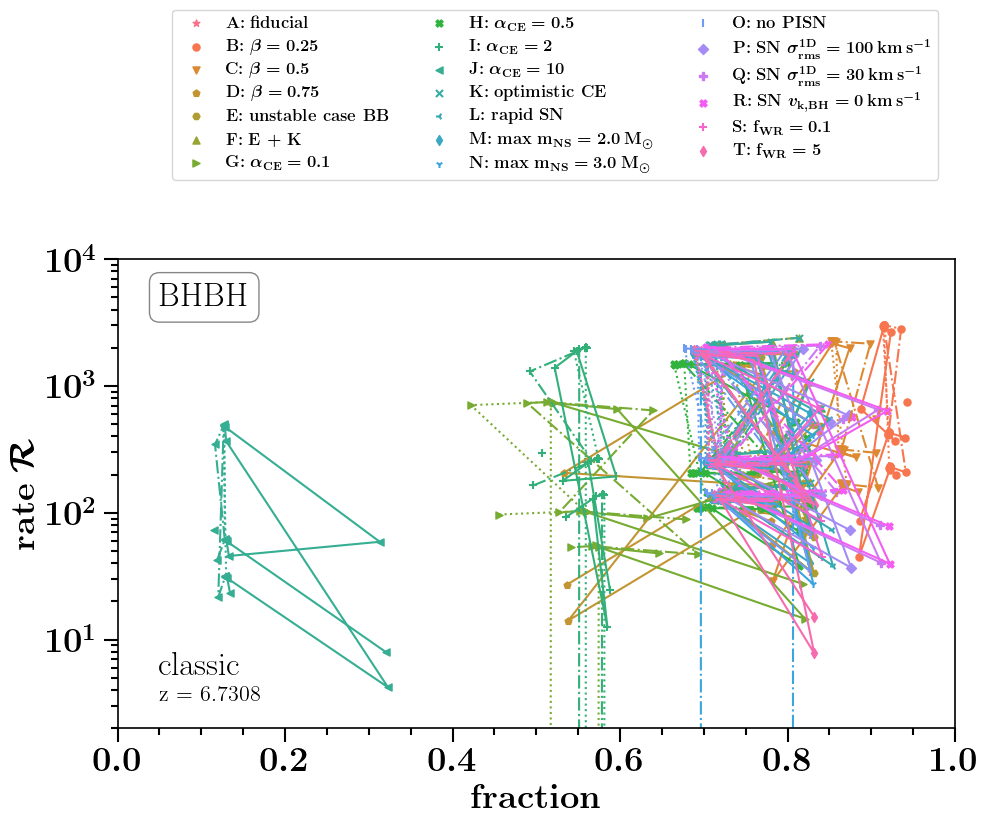


at DCOtype = BNS
running for redshift  6.7308
ind z = 17
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[3.92263069e-01 1.54605480e-01 4.99238835e-01 2.32875254e-01
 6.97411900e-07 4.04528486e-02 2.12698202e-01 6.02276322e-13
 1.80313205e-01 3.35896198e-01 1.48182677e-01 4.93892876e-01
 2.25339579e-01 6.53122054e-07 3.82575335e-02 2.04468998e-01
 5.62070125e-13 1.72956519e-01 3.25822794e-01 1.56908731e-01
 5.01173109e-01 2.35841744e-01 7.13995999e-07 4.12593566e-02
 2.15704881e-01 6.17464155e-13 1.82941953e-01 3.39692541e-01]


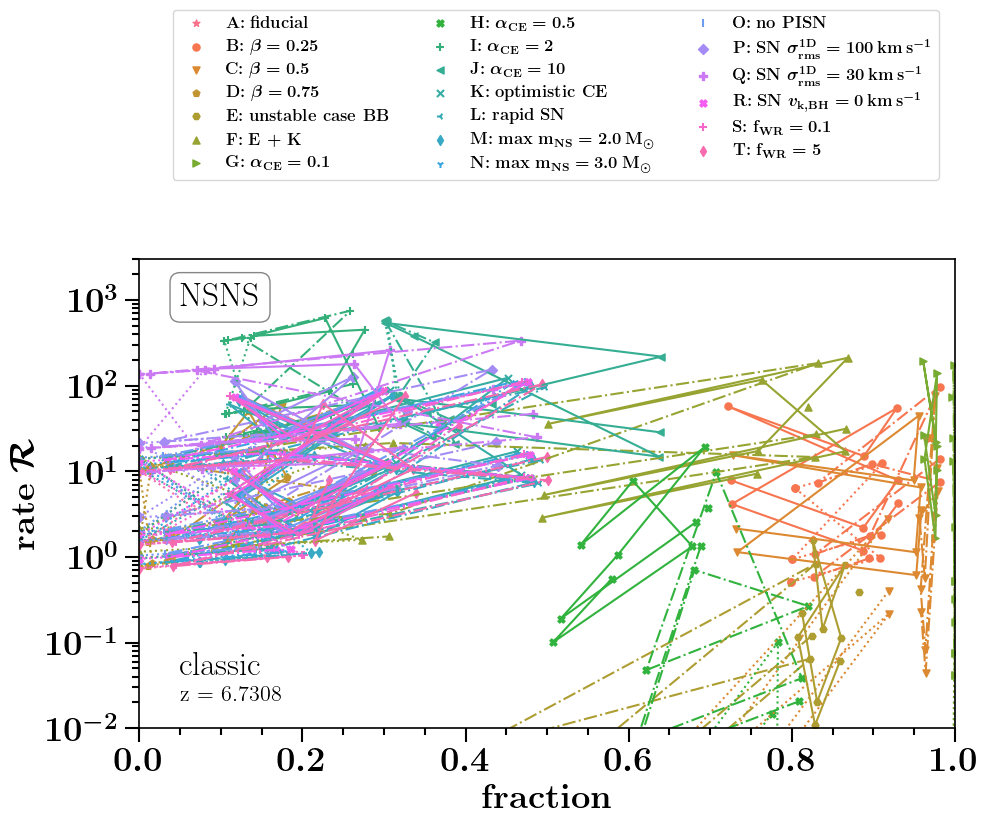


at DCOtype = BHNS
running for redshift  7.1154
ind z = 18
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.47723355 0.25972968 0.38457948 0.56758857 0.26364551 0.26361554
 0.30111764 0.26362102 0.26291838 0.44644528 0.31182128 0.41533065
 0.57926209 0.31742591 0.31724692 0.34869492 0.31738103 0.31544527
 0.47140813 0.23921235 0.37269211 0.56279734 0.2423122  0.24235183
 0.28225253 0.24229509 0.24217126 0.43674194]


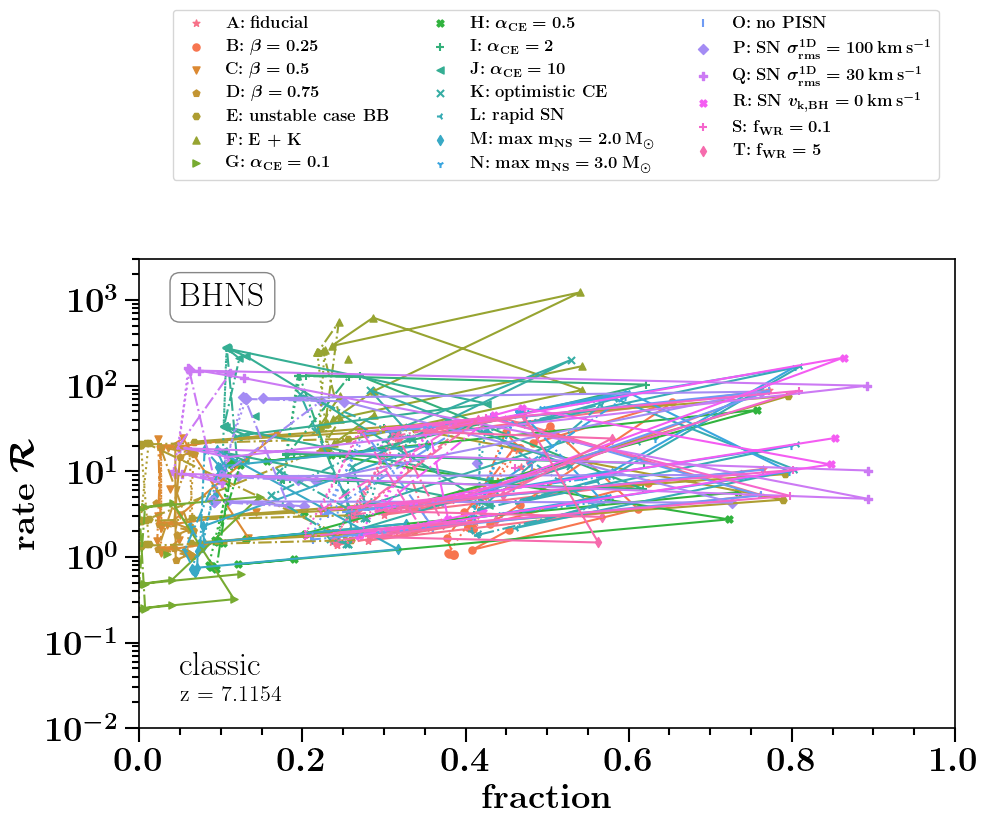


at DCOtype = BBH
running for redshift  7.1154
ind z = 18
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.84722685 0.72278609 0.82086547 0.83355453 0.71713531 0.71759478
 0.72561541 0.71712018 0.7208822  0.77614922 0.70790555 0.80783036
 0.83447928 0.70268261 0.70311643 0.71181384 0.70266839 0.70618808
 0.76337839 0.72861561 0.82585609 0.833071   0.7227929  0.72326234
 0.73101803 0.72277762 0.72663529 0.78109667]


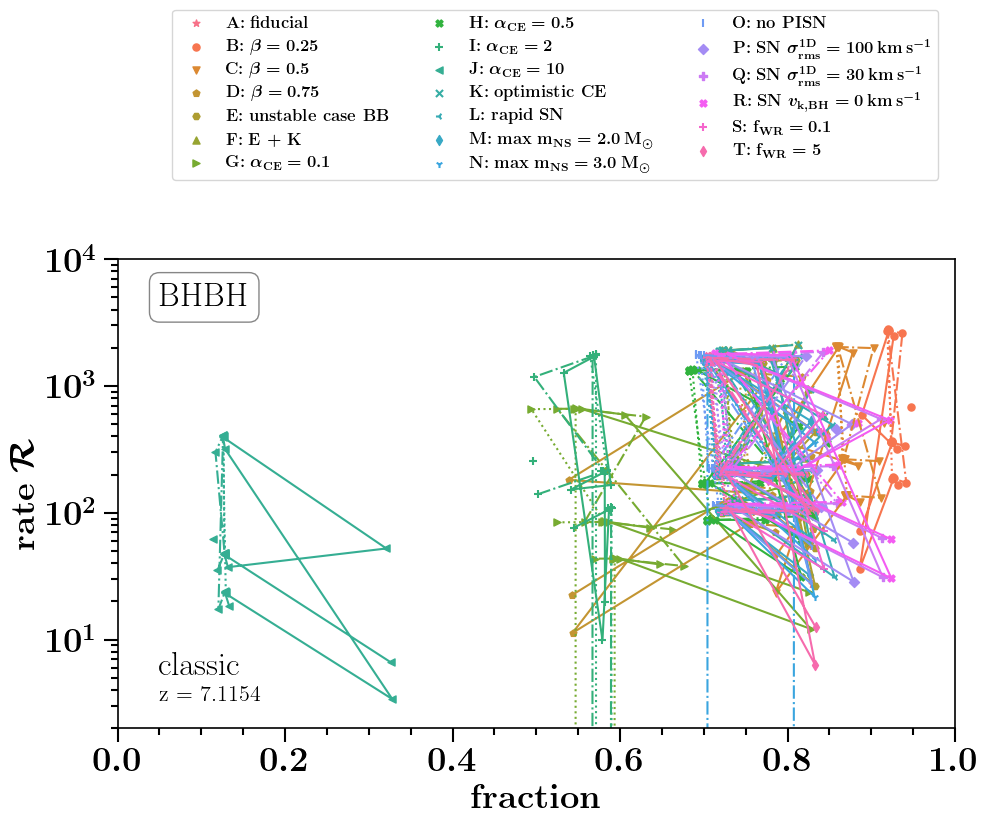


at DCOtype = BNS
running for redshift  7.1154
ind z = 18
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[4.73011003e-01 5.48828190e-02 5.50428100e-01 2.34550729e-01
 4.91199799e-11 9.25831932e-03 1.75497324e-01 0.00000000e+00
 5.06383650e-02 3.59193983e-01 5.27567520e-02 5.47745975e-01
 2.27986363e-01 4.65630434e-11 8.88278992e-03 1.70080956e-01
 0.00000000e+00 4.86657250e-02 3.50936435e-01 5.56741544e-02
 5.51350519e-01 2.37180094e-01 5.01053462e-11 9.39804047e-03
 1.77536036e-01 0.00000000e+00 5.13721954e-02 3.62356908e-01]


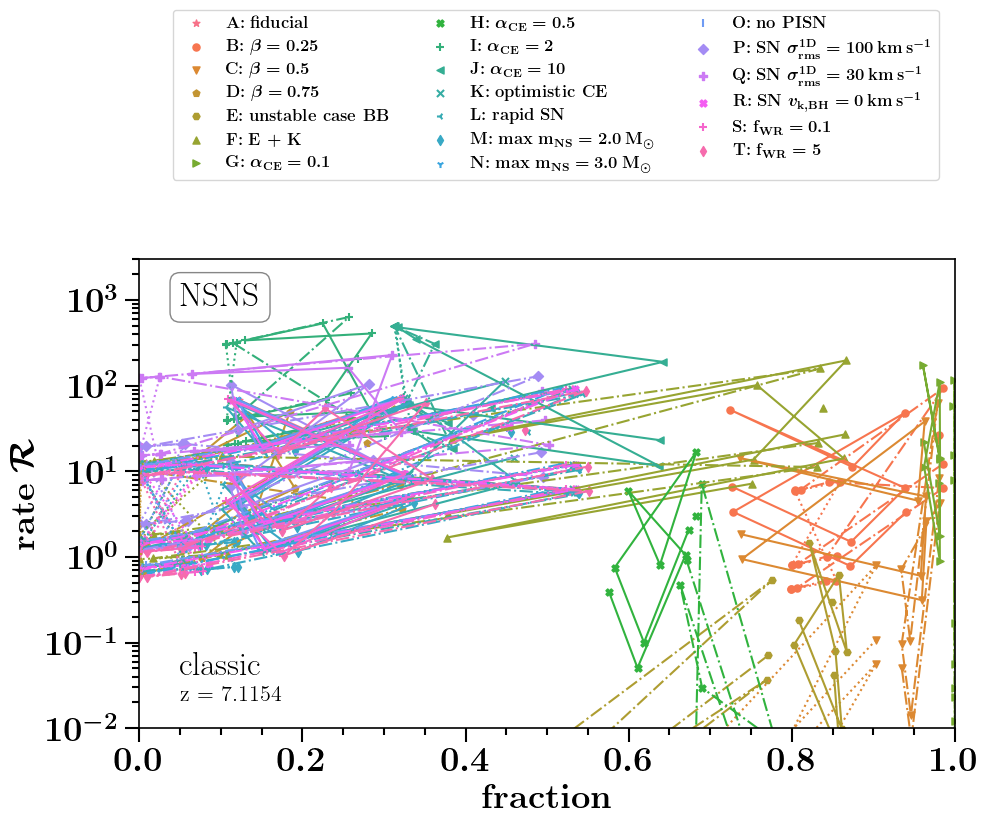


at DCOtype = BHNS
running for redshift  7.5
ind z = 19
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.39482321 0.14648731 0.2726272  0.55327186 0.14664632 0.14675169
 0.19699579 0.14654021 0.14710951 0.36385507 0.17463545 0.28922018
 0.56194322 0.17510255 0.17515929 0.22256656 0.17496629 0.17522309
 0.37737396 0.13548772 0.26619331 0.54960531 0.13550962 0.13563597
 0.18694975 0.13541533 0.13612121 0.35853832]


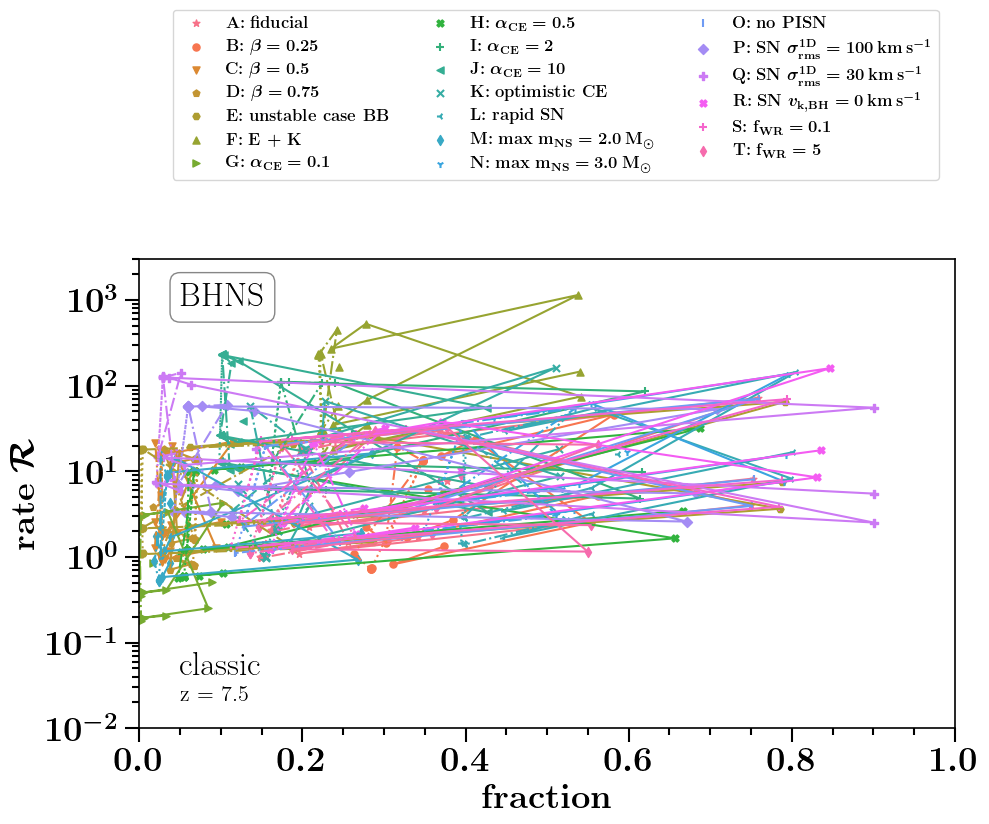


at DCOtype = BBH
running for redshift  7.5
ind z = 19
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.85689493 0.7306585  0.82052592 0.83458431 0.72938223 0.72955557
 0.73746051 0.72937671 0.73052256 0.77812586 0.7187181  0.80957194
 0.83608658 0.71755878 0.71772079 0.72622267 0.71755591 0.71860993
 0.76769542 0.73544864 0.82484984 0.83387128 0.73412312 0.73430111
 0.74196699 0.73411671 0.7353008  0.78227775]


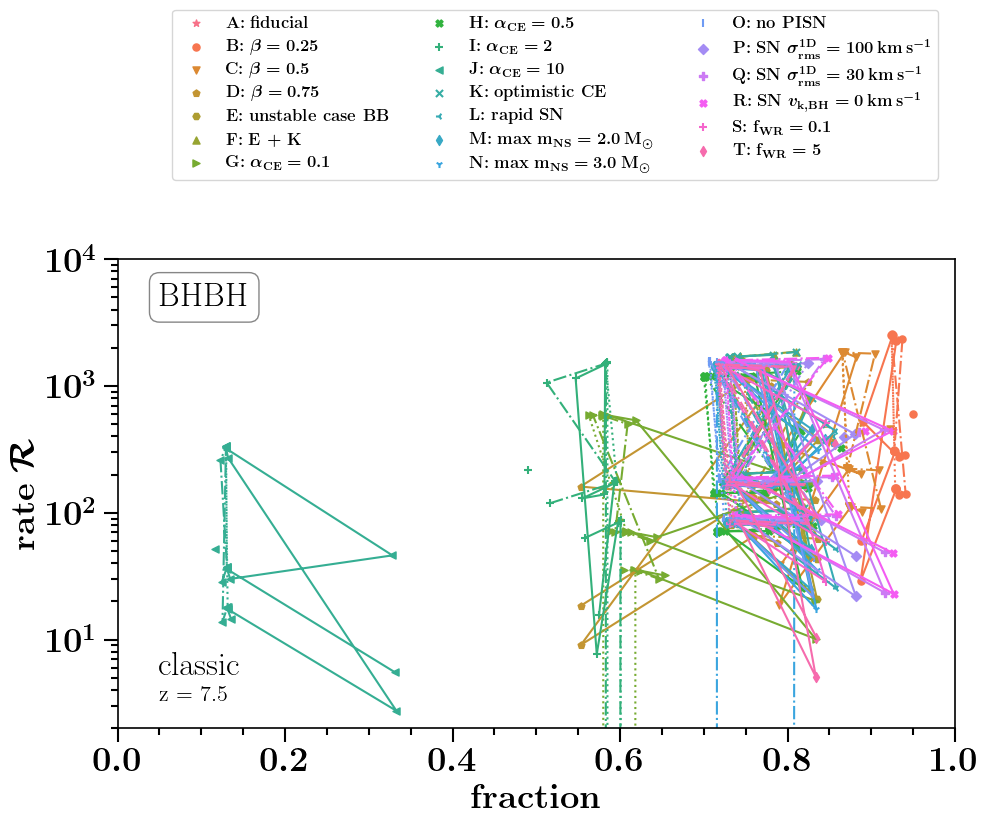


at DCOtype = BNS
running for redshift  7.5
ind z = 19
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.538139   0.01058292 0.57491131 0.23765854 0.         0.00213654
 0.17996704 0.         0.01048225 0.37737413 0.01012923 0.5731204
 0.23203787 0.         0.00205044 0.17507762 0.         0.01004836
 0.37060756 0.01075574 0.575446   0.23992905 0.         0.00216898
 0.18181634 0.         0.0106465  0.3799753 ]


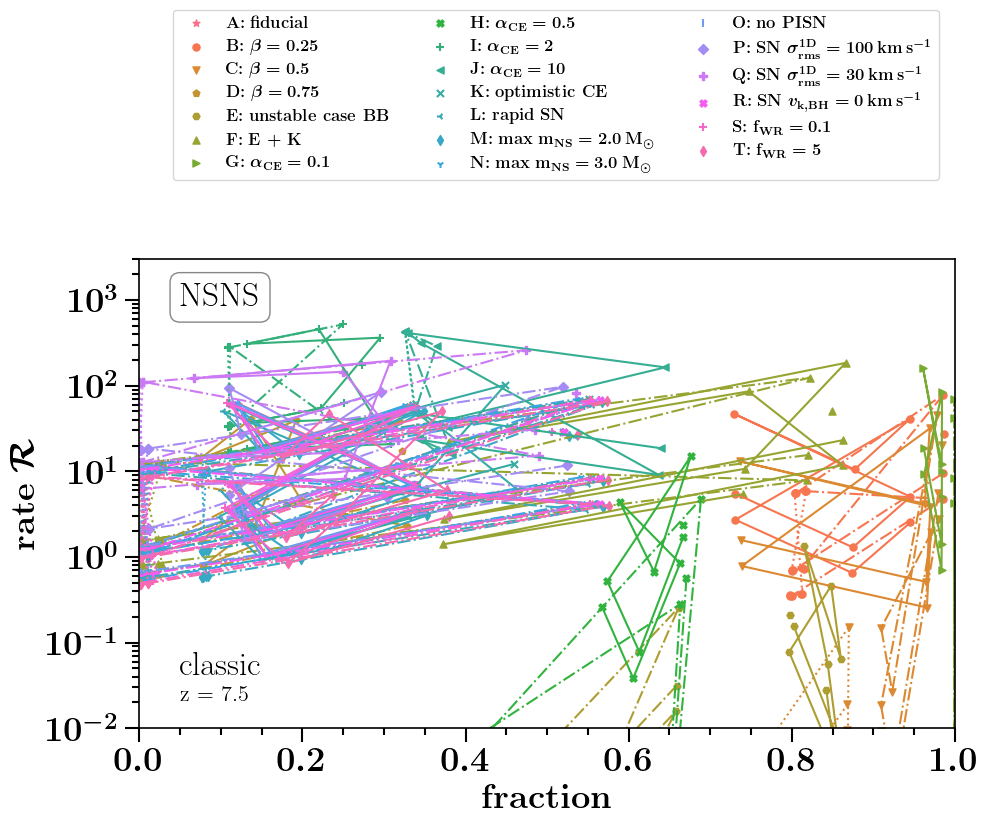


at DCOtype = BHNS
running for redshift  7.8846
ind z = 20
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.30464655 0.06020132 0.17270278 0.54358715 0.06015475 0.06020793
 0.11820462 0.06005226 0.06015643 0.28283038 0.06852456 0.1767717
 0.55089103 0.06849025 0.06853704 0.12637432 0.06836429 0.06845582
 0.28657256 0.05690317 0.1710827  0.54043931 0.05685129 0.05690715
 0.11492651 0.05675803 0.05686786 0.28126018]


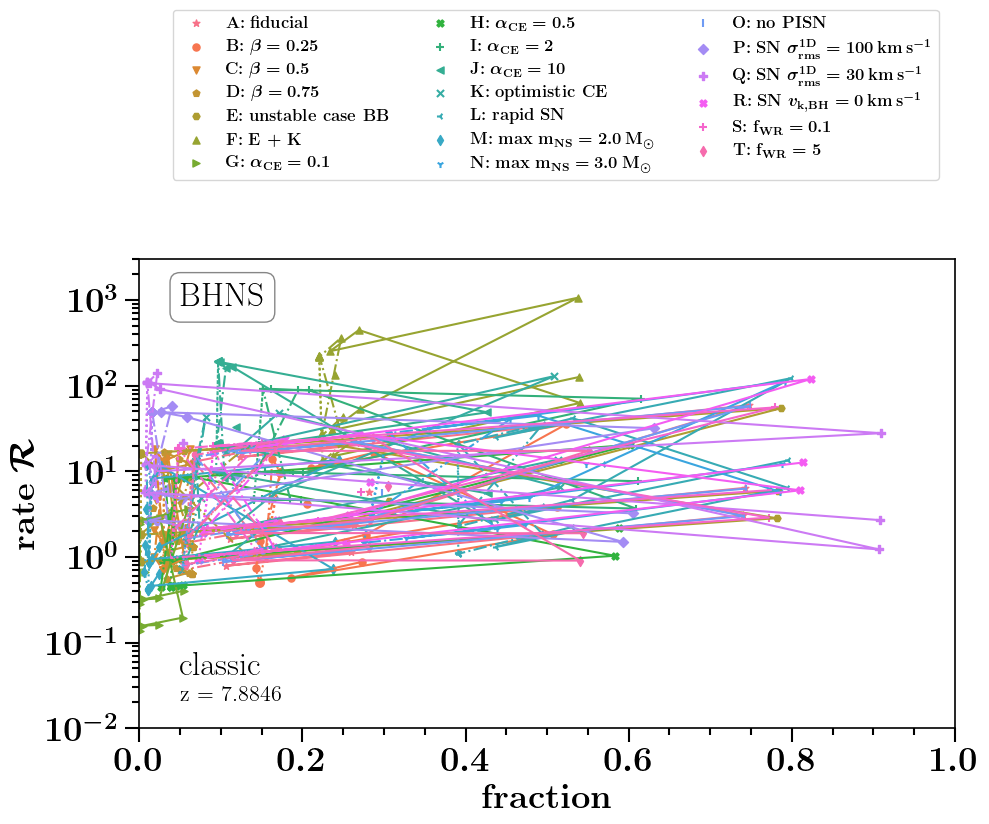


at DCOtype = BBH
running for redshift  7.8846
ind z = 20
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.86711106 0.7435044  0.81951648 0.83501043 0.74336809 0.74341083
 0.75098734 0.74337371 0.74352352 0.78197652 0.73427281 0.81087304
 0.83696724 0.73415445 0.73419363 0.7422881  0.73416382 0.7342957
 0.7738924  0.74728637 0.82302475 0.83410968 0.74714225 0.7471865
 0.75455172 0.74714643 0.74730401 0.78527431]


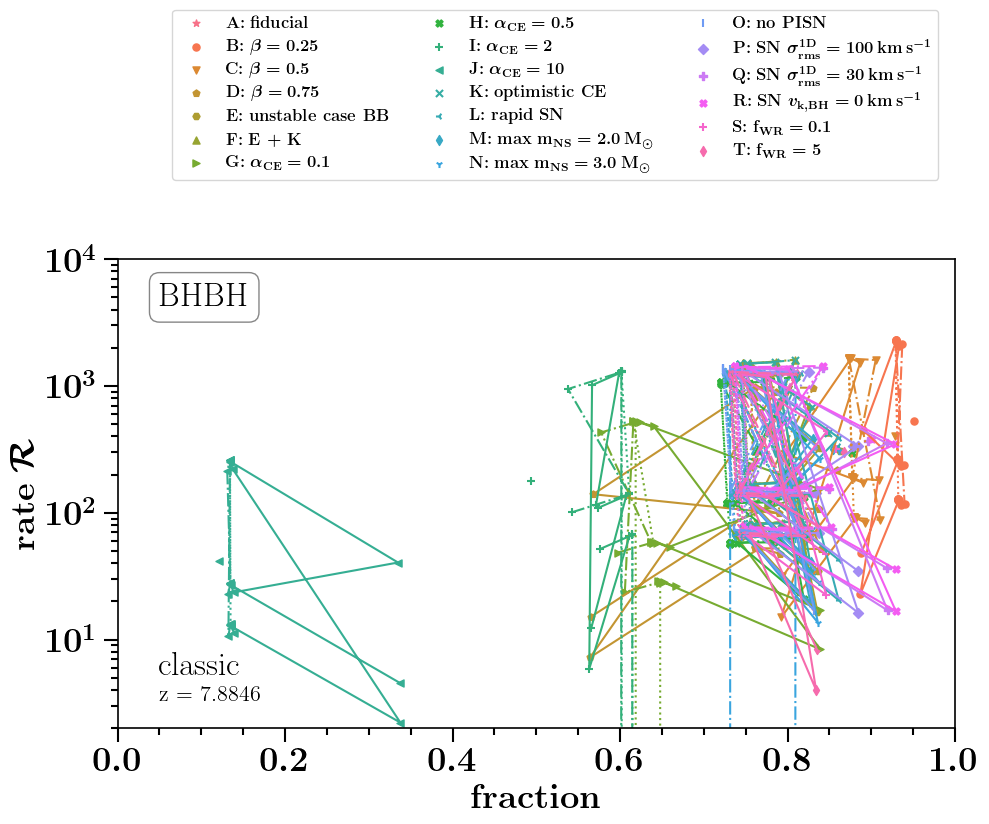


at DCOtype = BNS
running for redshift  7.8846
ind z = 20
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[5.82177932e-01 5.90735131e-04 5.66907129e-01 2.45117220e-01
 0.00000000e+00 3.59445966e-04 1.89644660e-01 0.00000000e+00
 5.34398456e-04 3.92621311e-01 5.73508599e-04 5.66305431e-01
 2.41040661e-01 0.00000000e+00 3.50432082e-04 1.86784191e-01
 0.00000000e+00 5.18375543e-04 3.88431496e-01 5.97420380e-04
 5.66983518e-01 2.46769692e-01 0.00000000e+00 3.62867828e-04
 1.90725842e-01 0.00000000e+00 5.40639998e-04 3.94232282e-01]


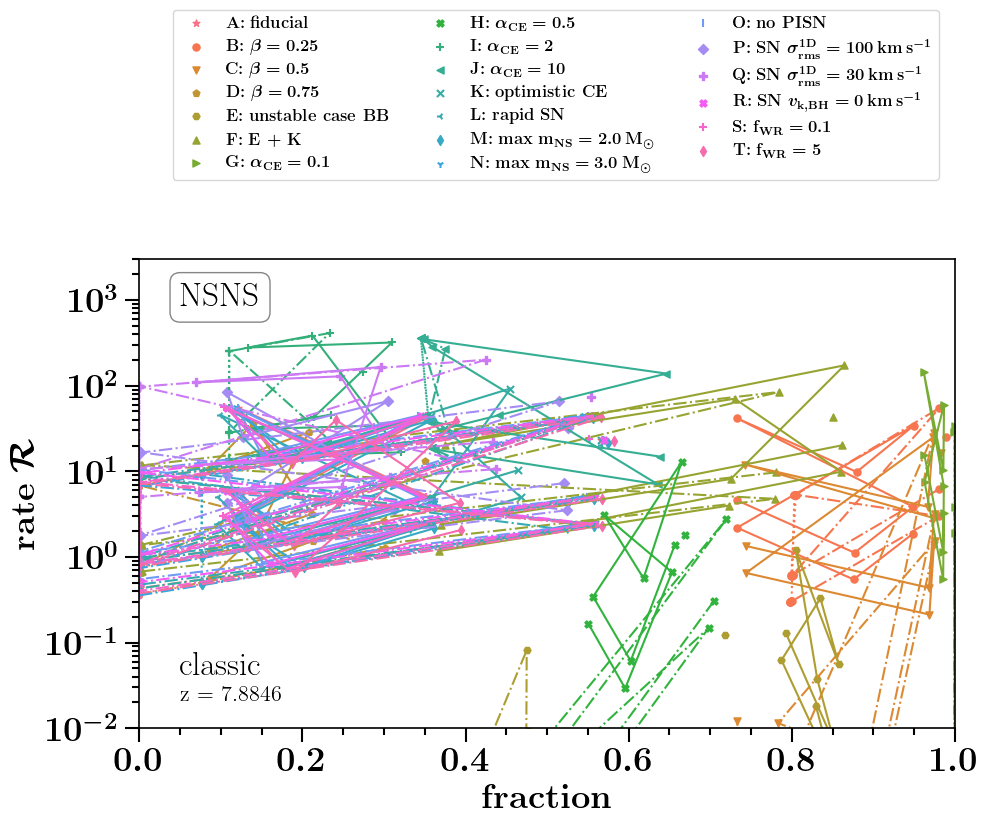


at DCOtype = BHNS
running for redshift  8.2692
ind z = 21
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.23567955 0.02825989 0.1148188  0.53293899 0.02825491 0.02826137
 0.0871735  0.0282432  0.02824746 0.22592981 0.030155   0.11524239
 0.53932246 0.03014972 0.03015587 0.09005735 0.0301357  0.03014057
 0.22752575 0.02748493 0.11463981 0.53016458 0.02748008 0.02748667
 0.0859822  0.02746928 0.0274733  0.22523809]


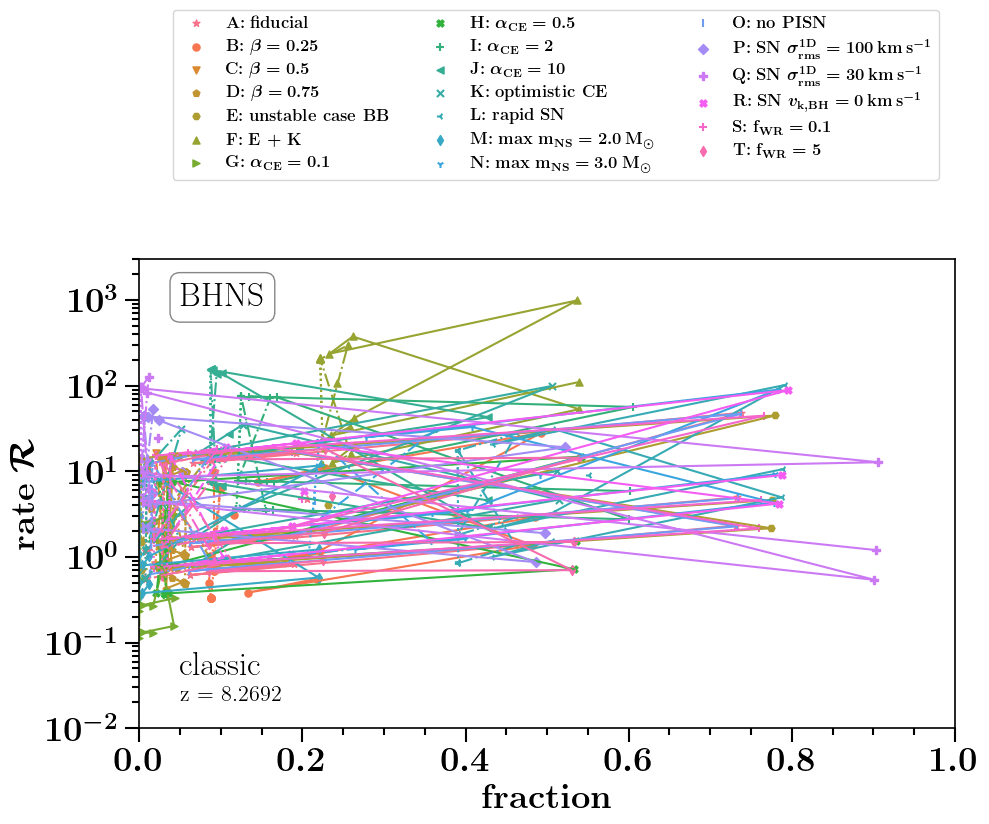


at DCOtype = BBH
running for redshift  8.2692
ind z = 21
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.87758587 0.76039076 0.81941203 0.83455214 0.76039725 0.76040146
 0.76738762 0.76041916 0.76041635 0.7890041  0.75380246 0.81319509
 0.83689317 0.75381078 0.75381429 0.76122143 0.75383753 0.75383271
 0.78322884 0.76314001 0.82199621 0.83349025 0.76314568 0.7631502
 0.76996164 0.76316565 0.76316368 0.79140946]


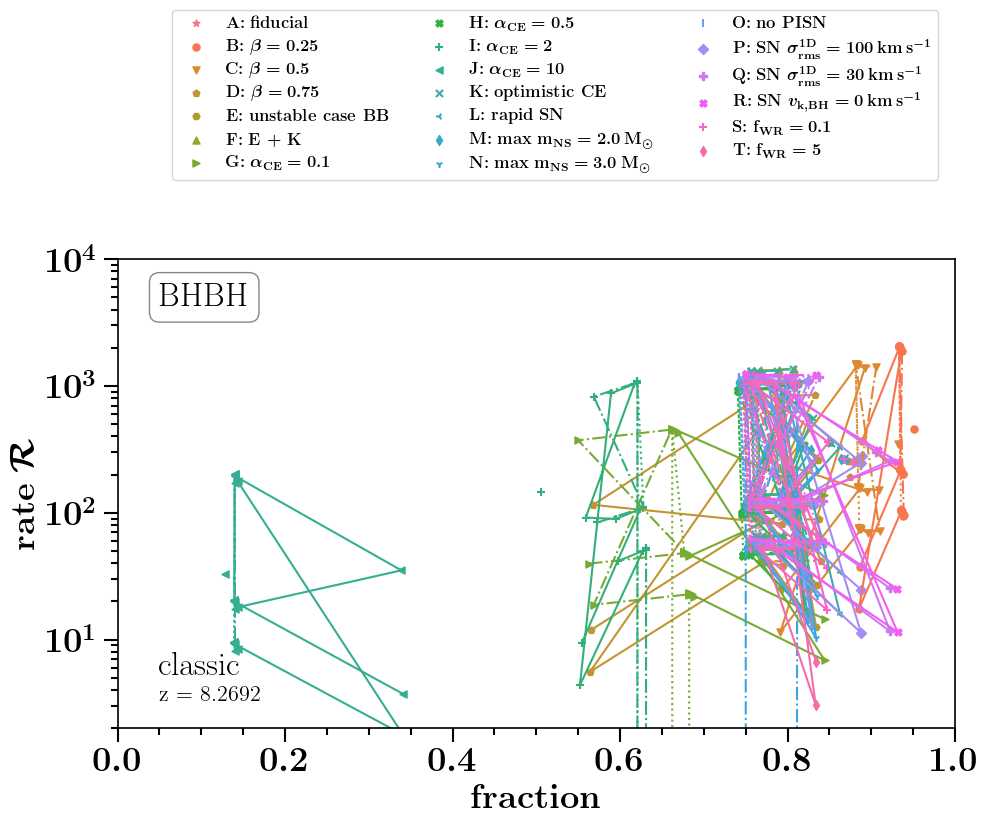


at DCOtype = BNS
running for redshift  8.2692
ind z = 21
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[6.06975731e-01 2.87906499e-06 4.96569706e-01 2.58103181e-01
 0.00000000e+00 1.99562981e-05 1.96084727e-01 0.00000000e+00
 1.47177328e-07 3.95072483e-01 2.80091425e-06 4.95798982e-01
 2.56019981e-01 0.00000000e+00 1.94636315e-05 1.94149842e-01
 0.00000000e+00 1.42925808e-07 3.92639052e-01 2.90962756e-06
 4.96716749e-01 2.58925485e-01 0.00000000e+00 2.01462277e-05
 1.96788839e-01 0.00000000e+00 1.48855401e-07 3.95966547e-01]


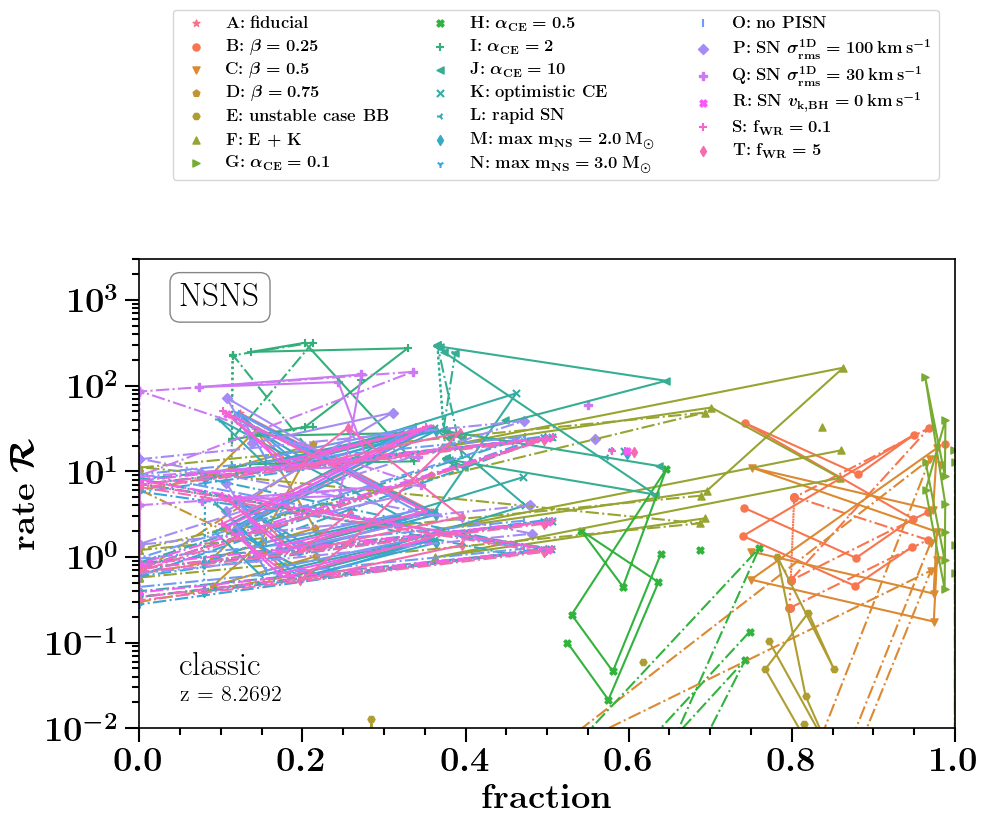


at DCOtype = BHNS
running for redshift  8.6538
ind z = 22
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.18425899 0.02227906 0.08123836 0.51695266 0.02227662 0.02227712
 0.07443884 0.02215188 0.02217637 0.17166704 0.02331651 0.08148082
 0.52209886 0.02331386 0.02331439 0.07608963 0.02317207 0.02319987
 0.17247091 0.02184753 0.08114154 0.51469172 0.02184518 0.02184567
 0.07374845 0.02172738 0.02175051 0.17132852]


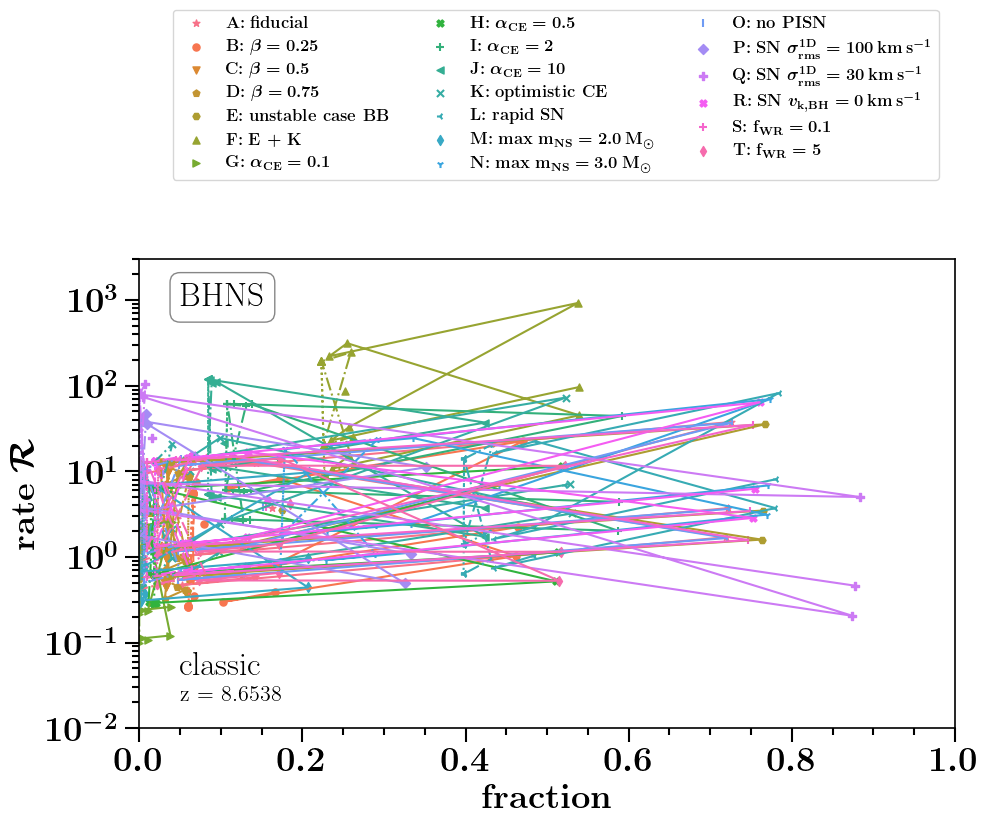


at DCOtype = BBH
running for redshift  8.6538
ind z = 22
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.88776922 0.78099143 0.82254707 0.83130648 0.78100088 0.78099969
 0.78709368 0.78103801 0.7810269  0.80018827 0.77690538 0.81869471
 0.83387171 0.77691533 0.77691402 0.78331169 0.77695695 0.77694467
 0.79659469 0.78272451 0.82418134 0.83015177 0.78273374 0.7827326
 0.78869835 0.78276898 0.78275837 0.80171187]


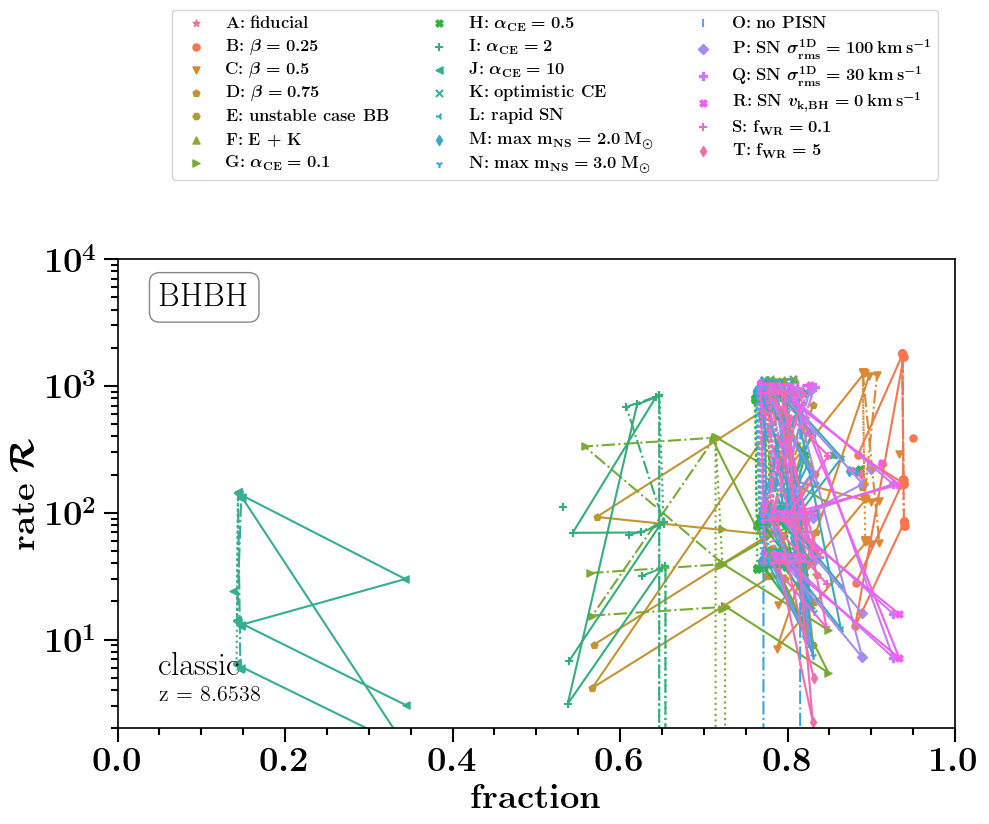


at DCOtype = BNS
running for redshift  8.6538
ind z = 22
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[6.08716460e-01 2.08483226e-10 3.67744083e-01 2.76884410e-01
 0.00000000e+00 8.03624827e-08 2.19393085e-01 0.00000000e+00
 4.01955786e-16 3.92472770e-01 2.08155834e-10 3.69798878e-01
 2.77022977e-01 0.00000000e+00 8.03788839e-08 2.20817639e-01
 0.00000000e+00 3.99817852e-16 3.93740968e-01 2.08501349e-10
 3.66758960e-01 2.76756413e-01 0.00000000e+00 8.03068969e-08
 2.18705960e-01 0.00000000e+00 4.02653183e-16 3.91836582e-01]


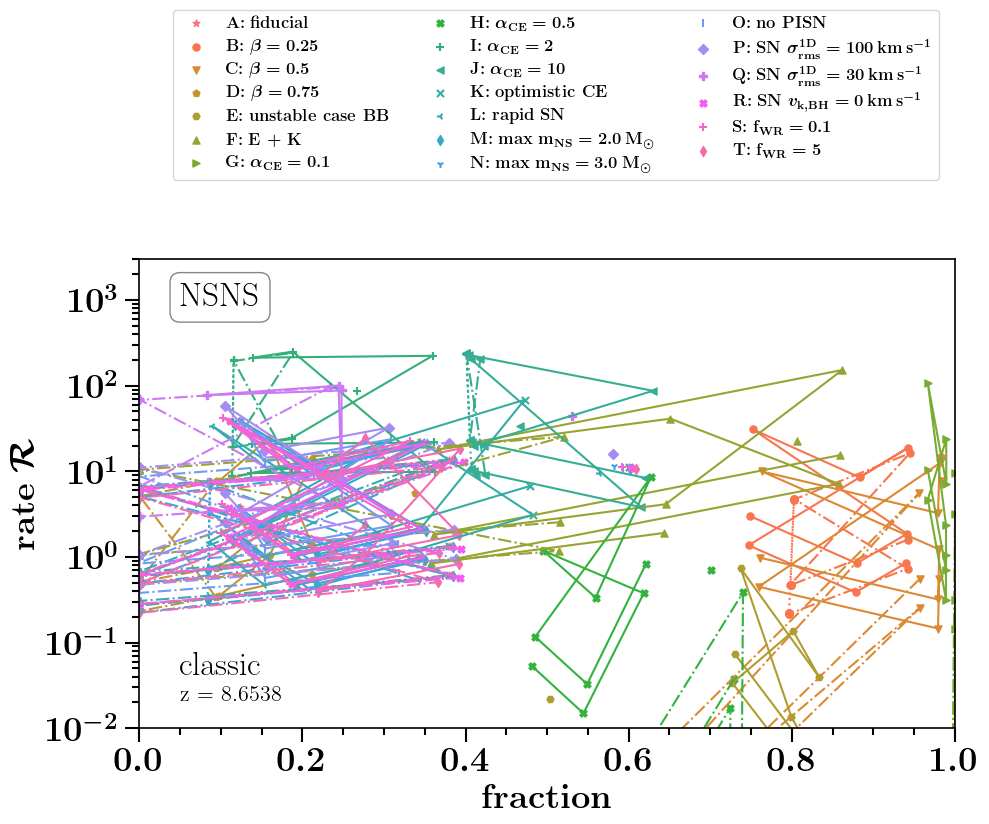


at DCOtype = BHNS
running for redshift  9.0385
ind z = 23
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.14182945 0.01788843 0.05344418 0.49097663 0.0178874  0.01788757
 0.06157185 0.01788666 0.01788747 0.11665505 0.01830879 0.05348393
 0.49487383 0.01830773 0.01830791 0.0621385  0.01830706 0.01830788
 0.11659285 0.01770464 0.05342653 0.48926123 0.01770361 0.01770378
 0.06132684 0.01770285 0.01770366 0.11668315]


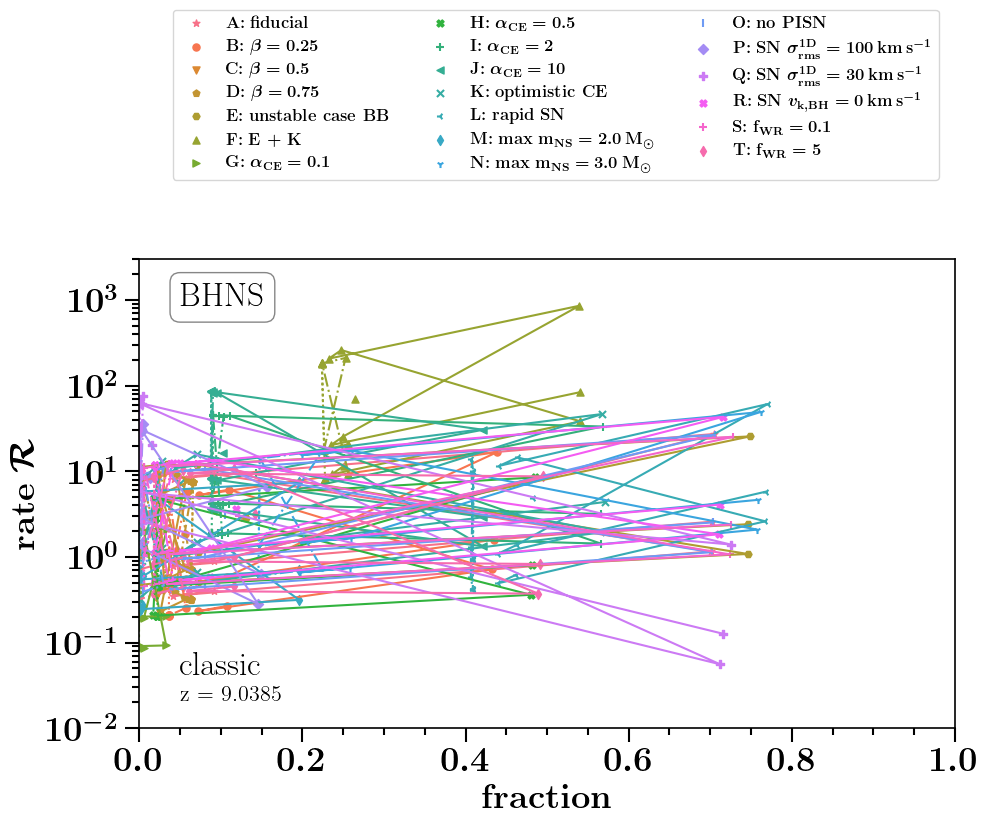


at DCOtype = BBH
running for redshift  9.0385
ind z = 23
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.89501517 0.80683207 0.83255701 0.82025126 0.80683654 0.80683579
 0.81152836 0.80689521 0.80688039 0.81772254 0.80500226 0.83080674
 0.82269049 0.8050069  0.80500613 0.8098654  0.80506956 0.80505379
 0.81610178 0.80761839 0.83331124 0.8191528  0.80762278 0.80762205
 0.81224299 0.80767973 0.80766532 0.81841896]


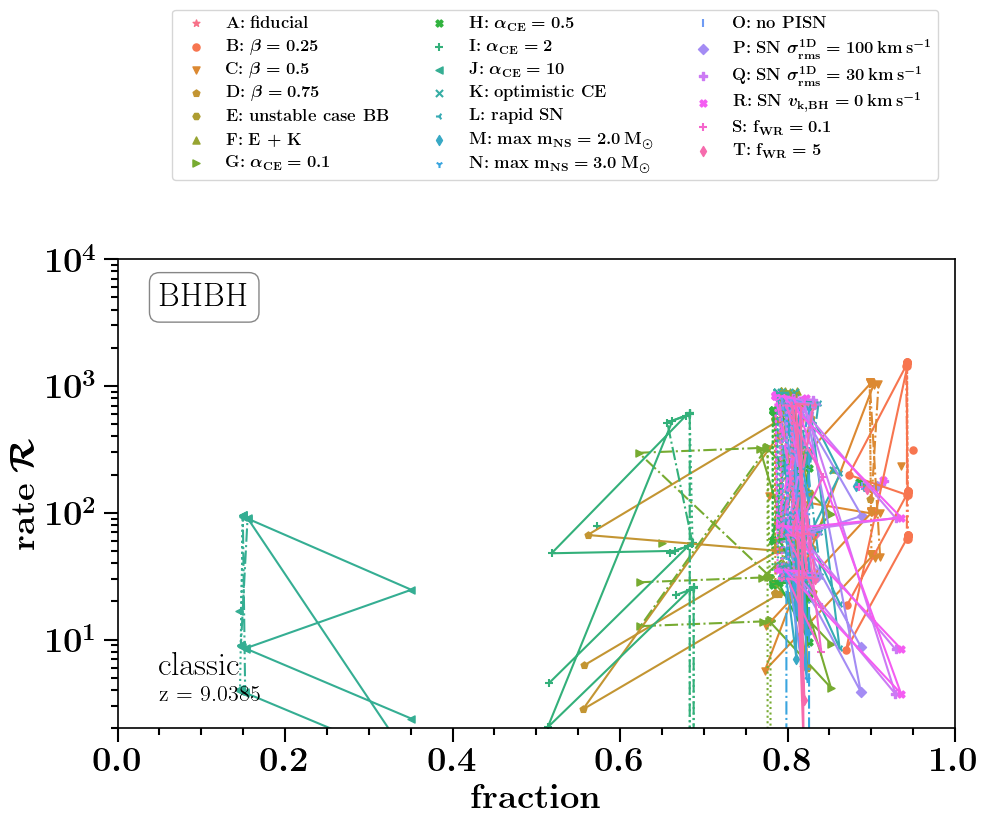


at DCOtype = BNS
running for redshift  9.0385
ind z = 23
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[5.81221130e-01 0.00000000e+00 1.96185182e-01 2.95343897e-01
 0.00000000e+00 5.88732488e-13 2.27102793e-01 0.00000000e+00
 0.00000000e+00 3.37728766e-01 0.00000000e+00 1.99055831e-01
 2.97836191e-01 0.00000000e+00 5.94259731e-13 2.29812840e-01
 0.00000000e+00 0.00000000e+00 3.40798570e-01 0.00000000e+00
 1.94888844e-01 2.94198016e-01 0.00000000e+00 5.86057446e-13
 2.25860290e-01 0.00000000e+00 0.00000000e+00 3.36320299e-01]


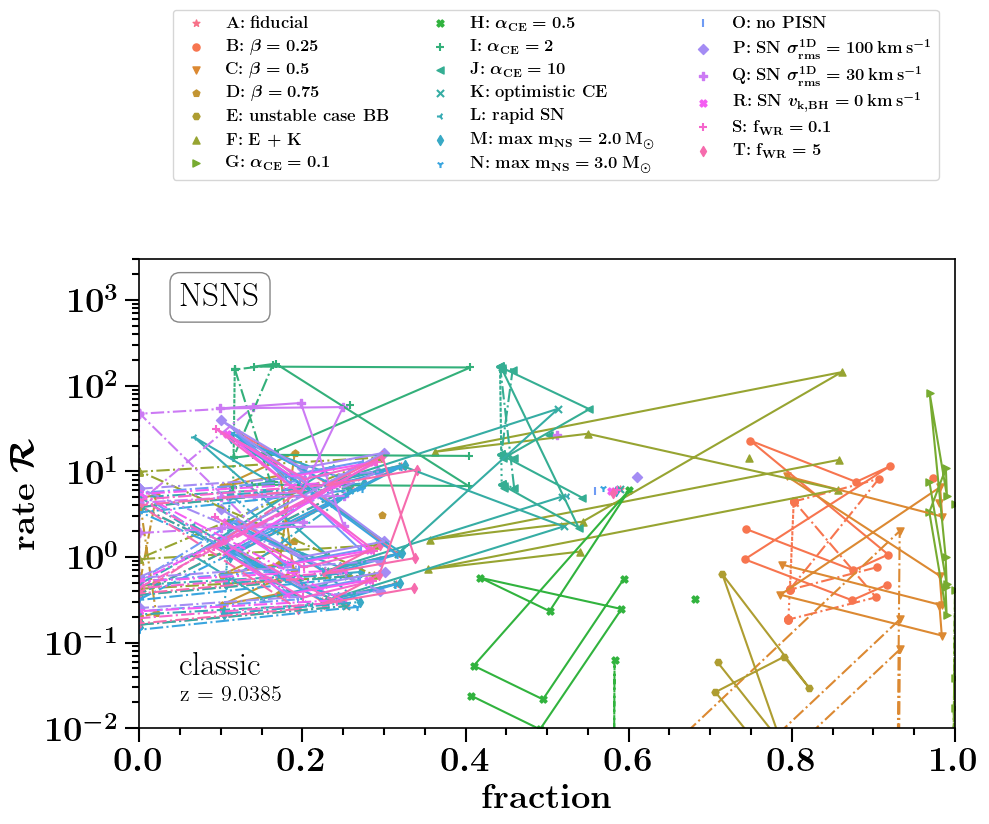


at DCOtype = BHNS
running for redshift  9.4231
ind z = 24
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.1181718  0.00360036 0.02496562 0.43859485 0.0036005  0.00360048
 0.04409338 0.00360732 0.00360554 0.06548634 0.00354501 0.02488132
 0.4406151  0.00354515 0.00354513 0.0440003  0.00355201 0.00355021
 0.06515705 0.00362471 0.02500174 0.43769932 0.00362485 0.00362483
 0.04413311 0.00363166 0.00362987 0.06562984]


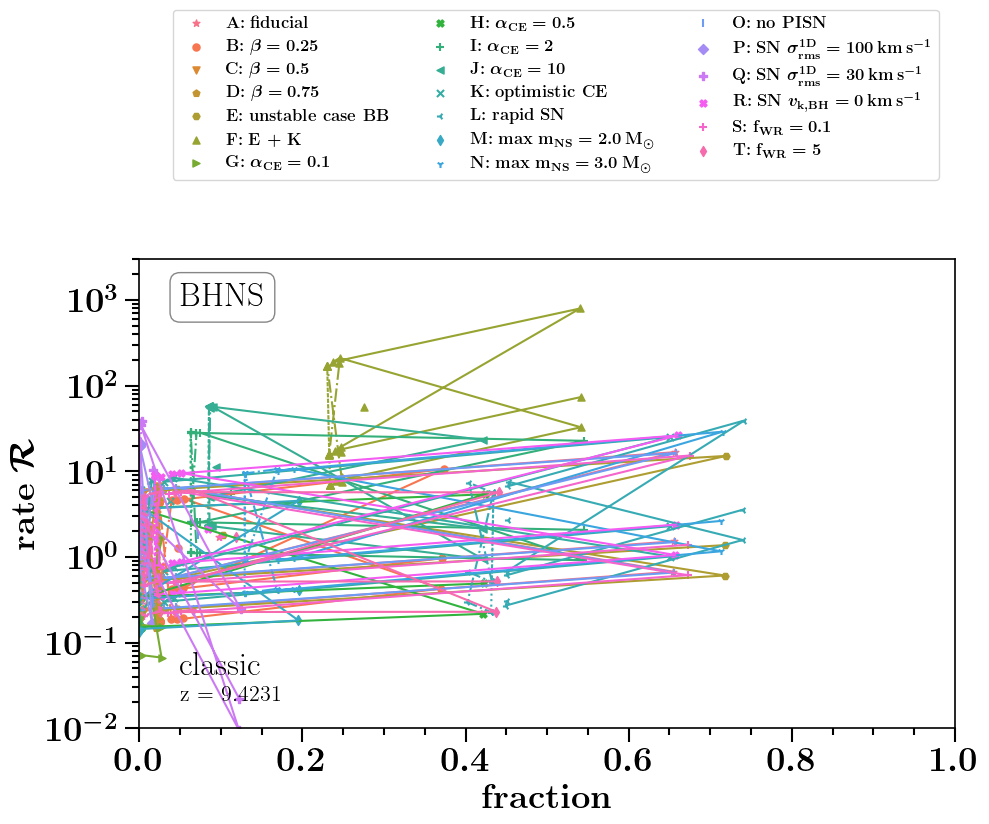


at DCOtype = BBH
running for redshift  9.4231
ind z = 24
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.89780898 0.83646071 0.84952133 0.78747869 0.83646121 0.83646112
 0.83907135 0.83651548 0.83650282 0.84099612 0.83626708 0.84928453
 0.78968988 0.8362676  0.83626751 0.83892074 0.8363235  0.83631045
 0.84083904 0.83654329 0.84962357 0.78648585 0.83654376 0.83654368
 0.83913502 0.83659733 0.83658483 0.8410626 ]


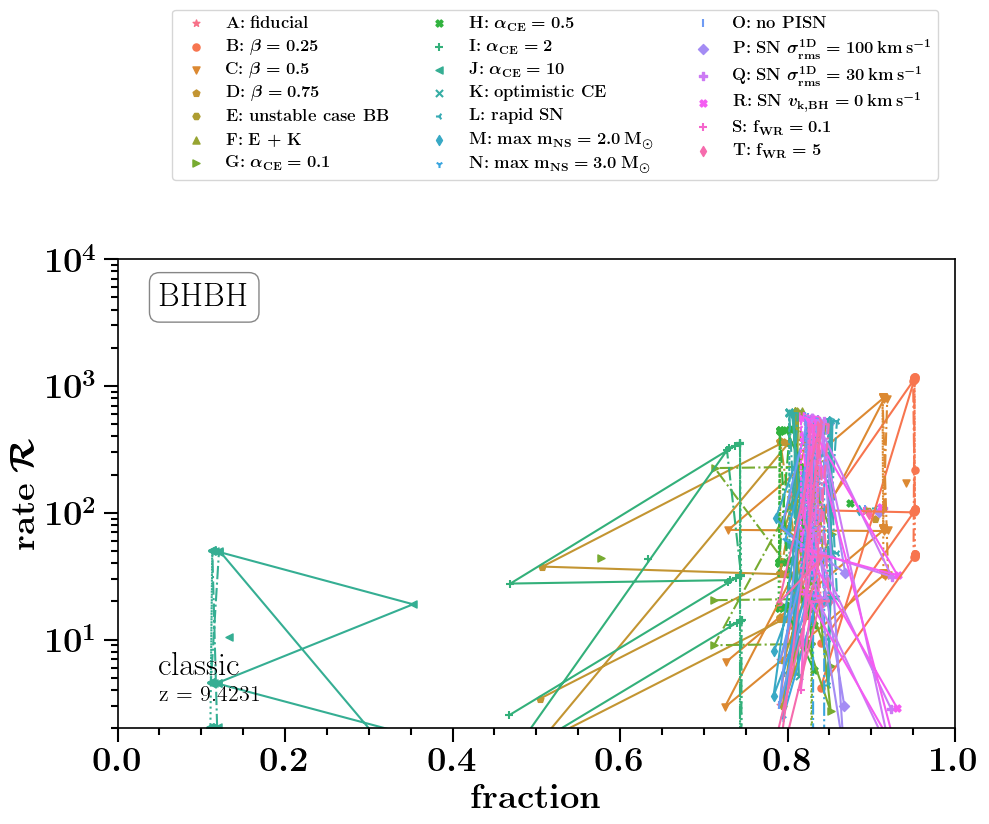


at DCOtype = BNS
running for redshift  9.4231
ind z = 24
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.27078652 0.         0.01244054 0.18201058 0.         0.
 0.13221089 0.         0.         0.12340761 0.         0.01282854
 0.18531474 0.         0.         0.1360156  0.         0.
 0.12684399 0.         0.01227064 0.18054345 0.         0.
 0.13053819 0.         0.         0.1218965 ]


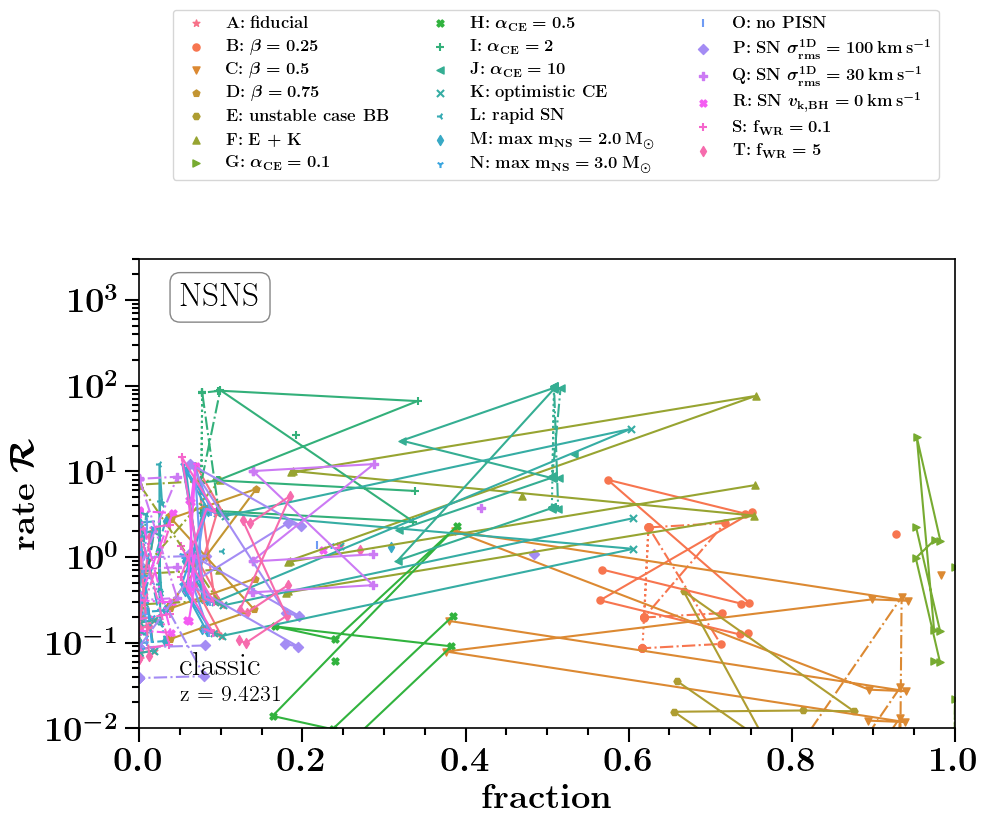


at DCOtype = BHNS
running for redshift  9.8077
ind z = 25
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.01146717 0.         0.00091326 0.24824969 0.         0.
 0.01115921 0.         0.         0.00885261 0.         0.00091639
 0.2485725  0.         0.         0.0111763  0.         0.
 0.00886558 0.         0.00091187 0.24810578 0.         0.
 0.01115161 0.         0.         0.00884684]


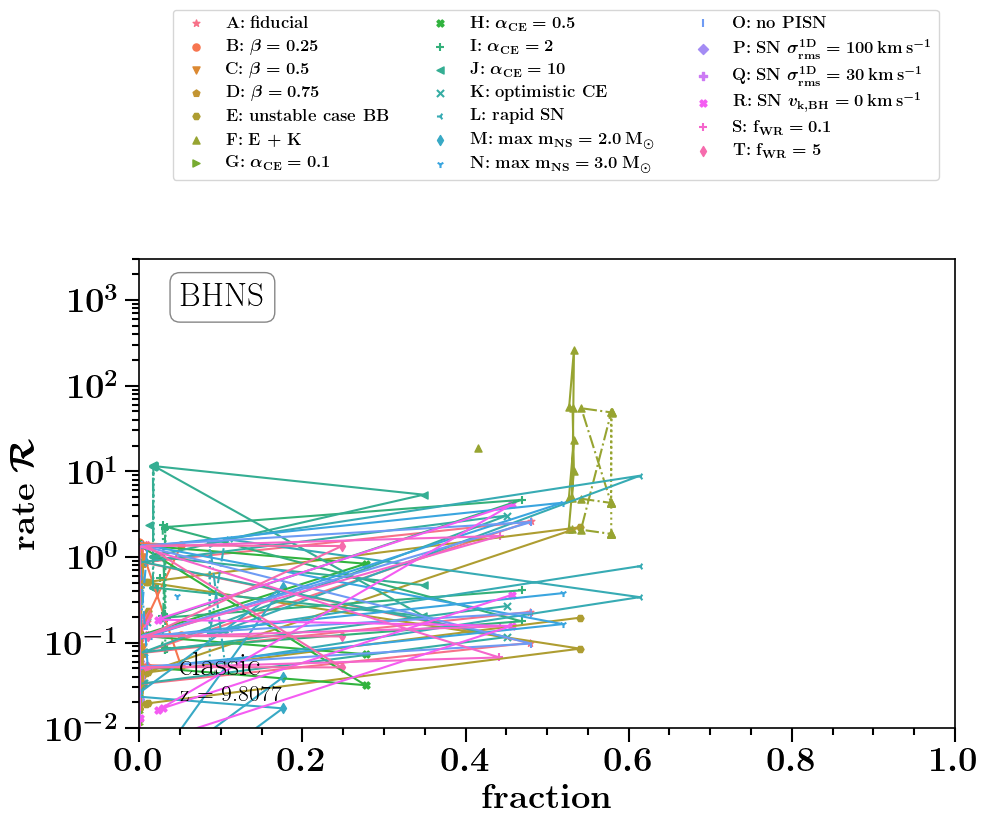


at DCOtype = BBH
running for redshift  9.8077
ind z = 25
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0.86625806 0.78290937 0.79460703 0.45072674 0.78290932 0.78290932
 0.78273008 0.78283475 0.78284606 0.7830407  0.78292865 0.79461847
 0.45136732 0.7829286  0.78292861 0.78275638 0.78285339 0.78286481
 0.78306788 0.78290091 0.79460206 0.45044176 0.78290086 0.78290087
 0.7827185  0.78282659 0.78283784 0.78302872]


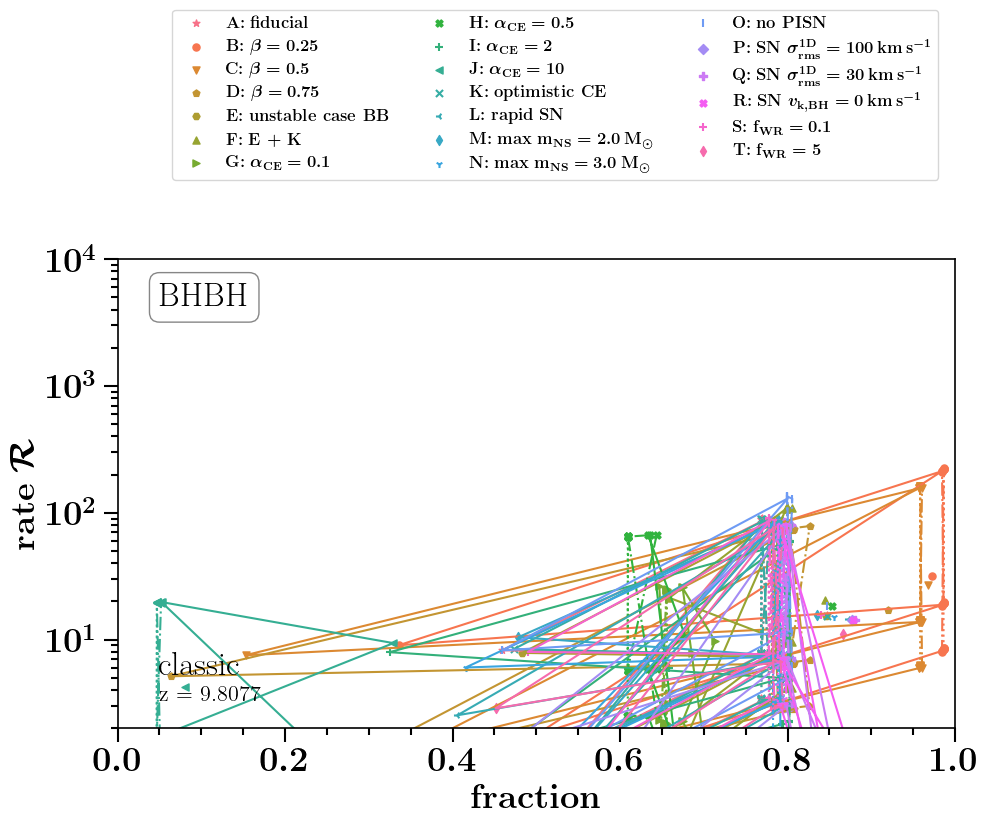


at DCOtype = BNS
running for redshift  9.8077
ind z = 25
at BPS model  A
at BPS model  B
at BPS model  C
at BPS model  D
at BPS model  E
at BPS model  F
at BPS model  G
at BPS model  H
at BPS model  I
at BPS model  J
at BPS model  K
at BPS model  L
at BPS model  M
at BPS model  N
at BPS model  O
at BPS model  P
at BPS model  Q
at BPS model  R
at BPS model  S
at BPS model  T
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]


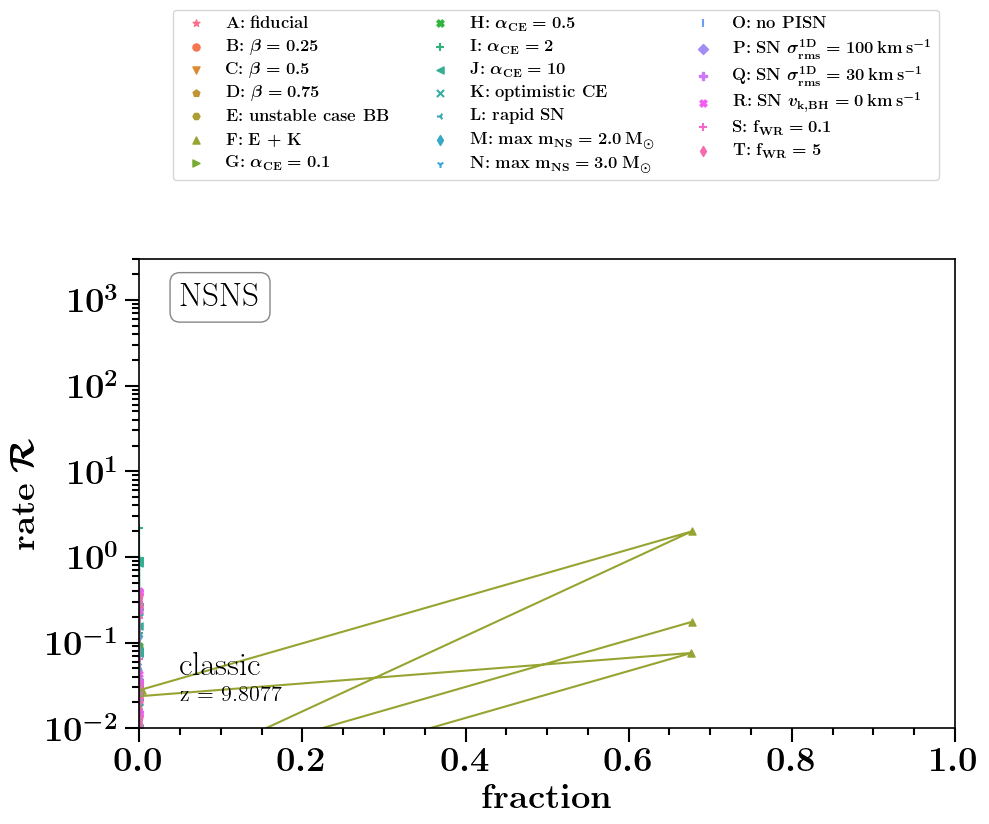

In [45]:
def plot_formation_channels_fixed_z(axe='None', DCOtype='BHNS', \
                                          BPSmodelName='A', ind_z=0,\
                                                  pathData='/Volumes/SimonsFoundation/DataDCO/',\
                                                 fc_ind_wanted=-1, mask_specific_mssfr=None):
    """
    whichplot='rate', 'ratio'
    
    """
    
    markershapes = ["*", "o", "v",  "p", "H", "^", ">", 'X', "+","<", 'x', "3","d","1", "|", "D", "P", "X", "+", "d"]
    
    adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
    DCOname = DCOname_dict[DCOtype]
    print('ind z =', ind_z)
    
#     for ind_m, BPSmodelName in  enumerate([BPSnameslist[0]]):
    for ind_m, BPSmodelName in  enumerate(BPSnameslist[:]):
        labelname=r'\textbf{%s:} '%BPSmodelName+ alphabetPhysicalNameDict[BPSmodelName]
        print('at BPS model ', BPSmodelName)
        color_m = colorDirDict[BPSmodelName]

        # path for files 
        full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'

        # read in data 
        fdata = h5.File(full_data_path,'r')

        # plot data for all MSSFR at the same time at a given redshift 
        fractions_z, totals_z = np.zeros(len(MSSFRnameslist)), np.zeros(len(MSSFRnameslist))
        fparam_key = "formationchannel_z_rates"
        for ind_mssfr, mssfr in enumerate(MSSFRnameslist[:]):
            header = "fraction_" + Channel + "_" + mssfr 
            fractions_z[ind_mssfr] = fdata[fparam_key][header][...].squeeze()[ind_z]  

            header = "rate_" + "total" + "_" + mssfr 
            totals_z[ind_mssfr] =  fdata[fparam_key][header][...].squeeze()[ind_z]  
            
        axe.scatter(fractions_z, totals_z, color=color_m, marker=markershapes[ind_m], s=26,label=labelname)
        
        # connect models with the same mssfr 
#         print('connecting datapoints with the same ', mask_specific_mssfr, ' mssfr')
        colors_mssfrind = ['none', 'blue', 'orange', 'green']
        linestyles_mssfrind = ['none', ':',  '-.', '-']
        if mask_specific_mssfr!=None:
            if mask_specific_mssfr=='x':
                for ind_mssfr_zind in [1,2,3]:
                    ind_begin, ind_end = 1+ 9*(ind_mssfr_zind-1), 10+ 9*(ind_mssfr_zind-1)
                    axe.plot(fractions_z[ind_begin:ind_end], totals_z[ind_begin:ind_end], color=colors_mssfrind[ind_mssfr_zind])
            elif mask_specific_mssfr=='z':
                for ind_mssfr_zind in [1,2,3]:
                    axe.plot(fractions_z[ind_mssfr_zind::3], totals_z[ind_mssfr_zind::3], color=color_m, ls=linestyles_mssfrind[ind_mssfr_zind])
            elif mask_specific_mssfr=='y':
                for ind_mssfr_zind in [1,2,3]:
                    fractions_zmask = np.concatenate((fractions_z[1+3*(ind_mssfr_zind-1):4+3*(ind_mssfr_zind-1)], fractions_z[10+3*(ind_mssfr_zind-1):13+3*(ind_mssfr_zind-1)]))
                    fractions_zmask = np.concatenate((fractions_zmask, fractions_z[19+3*(ind_mssfr_zind-1):22+3*(ind_mssfr_zind-1)]))
                    totals_zmask = np.concatenate((totals_z[1+3*(ind_mssfr_zind-1):4+3*(ind_mssfr_zind-1)], totals_z[10+3*(ind_mssfr_zind-1):13+3*(ind_mssfr_zind-1)]))
                    totals_zmask = np.concatenate((totals_zmask, totals_z[19+3*(ind_mssfr_zind-1):22+3*(ind_mssfr_zind-1)]))               
                    
                    axe.plot(fractions_zmask, totals_zmask, color=colors_mssfrind[ind_mssfr_zind])

    #         
        fdata.close()


    print(fractions_z)

    ylabel = r'\textbf{rate} $\mathcal{R}$'
    xlabel = r'\textbf{fraction}'
#     axe.set_ylim(0., 1)

    
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)
    axe.set_yscale('log')
    axe.set_xlim(0.,1)
    
    
    if DCOtype=='BBH':
        axe.set_ylim(2, 1E4)
    else:
        axe.set_ylim(1E-2, 3*1E3)
    
    handles, labels = axe.get_legend_handles_labels()

    # add box with label to indicate which DCO type we are plotting in the top left of each panel   
    bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.95)
    axe.annotate(r'%s'%(DCOname), xy=(0.05, .95), xycoords='axes fraction', fontsize = fs, weight = 'bold', ha='left', va="top",bbox=bbox_props)            

    

    
    
    return axe, handles, labels




adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run 
print('available redshifts:', redshifts_runs) 



# for ind_redshift in [0, 5, 10, 15, 20]:
for ind_redshift in range(len(redshifts_runs)):


    
    for DCOtype in [ 'BHNS','BBH', 'BNS']:
        print()
        print('at DCOtype =', DCOtype)
        print('running for redshift ', np.round(redshifts_runs[ind_redshift],4))
    #     for nrC, Channel in enumerate(adjustedChannelList): 
        for nrC, Channel in enumerate([adjustedChannelList[0]]): 
            fc_ind_wanted = dictFormationChannelIndex[Channel]
            c_FC = channelColorDict[Channel]

    #         redshifts_runs
            ncols, nrows= 1,1
            f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,10), 
                          gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})

            ax, handles, labels  = plot_formation_channels_fixed_z(axe=ax, DCOtype=DCOtype, BPSmodelName=BPSmodelName, ind_z=ind_redshift,\
                                                 pathData=pathData, fc_ind_wanted=fc_ind_wanted, mask_specific_mssfr='z') 


            ax.annotate(r'%s'%(Channel), xy=(0.05, .1), xycoords='axes fraction', fontsize = fs, weight = 'bold', ha='left', va="bottom")
            ax.annotate(r'z = %s'%np.round(redshifts_runs[ind_redshift],4), xy=(0.05, .05), xycoords='axes fraction', fontsize = fs-8, weight = 'bold', ha='left', va="bottom")


            lgd2=plt.legend(handles, labels , fontsize=12, ncol=3, bbox_to_anchor=(0.99, 1.55)) #,  markerscale=3., scatterpoints=1)
            ##  SAVE FIG  ###
            plt.tight_layout()
            plt.subplots_adjust(wspace=0., hspace=0)  
            plt.savefig('./redshift_rates_fc/ratesz_'  + DCOtype + '_' + Channel+ '_z' + str(np.round(redshifts_runs[ind_redshift],4)) + '.png', transparent=True, bbox_extra_artists=(lgd2,), bbox_inches='tight', dpi = 600)
            plt.savefig('./redshift_rates_fc/ratesz_'  + DCOtype + '_' + Channel+ '_z' + str(np.round(redshifts_runs[ind_redshift],4)) + '.pdf', transparent=True, bbox_extra_artists=(lgd2,), bbox_inches='tight')
            plt.show()
            plt.close()
        
        

In [46]:
# Some code for lines 

# linestyles_mssfrind = ['none', ':',  '-.', '-']
# if mask_specific_mssfr!=None:
#     if mask_specific_mssfr=='x':
#         for ind_mssfr_zind in [1,2,3]:
#             ind_begin, ind_end = 1+ 9*(ind_mssfr_zind-1), 10+ 9*(ind_mssfr_zind-1)
#             axe.plot(fractions_z[ind_begin:ind_end], totals_z[ind_begin:ind_end], color=colors_mssfrind[ind_mssfr_zind])
#     elif mask_specific_mssfr=='z':
#         for ind_mssfr_zind in [1,2,3]:
#             axe.plot(fractions_z[ind_mssfr_zind::3], totals_z[ind_mssfr_zind::3], color=color_m, ls=linestyles_mssfrind[ind_mssfr_zind])
#     elif mask_specific_mssfr=='y':
#         for ind_mssfr_zind in [1,2,3]:
#             fractions_zmask = np.concatenate((fractions_z[1+3*(ind_mssfr_zind-1):4+3*(ind_mssfr_zind-1)], fractions_z[10+3*(ind_mssfr_zind-1):13+3*(ind_mssfr_zind-1)]))
#             fractions_zmask = np.concatenate((fractions_zmask, fractions_z[19+3*(ind_mssfr_zind-1):22+3*(ind_mssfr_zind-1)]))
#             totals_zmask = np.concatenate((totals_z[1+3*(ind_mssfr_zind-1):4+3*(ind_mssfr_zind-1)], totals_z[10+3*(ind_mssfr_zind-1):13+3*(ind_mssfr_zind-1)]))
#             totals_zmask = np.concatenate((totals_zmask, totals_z[19+3*(ind_mssfr_zind-1):22+3*(ind_mssfr_zind-1)]))               

# MSSFR_x = []
# for ind_mssfr_zind in [1,2,3]:
#     ind_begin, ind_end = 1+ 9*(ind_mssfr_zind-1), 10+ 9*(ind_mssfr_zind-1)
#     MSSFR_x = MSSFRnameslist[ind_begin:ind_end]
#     print(MSSFR_x)


# MSSFR_y = []   
# for ind_mssfr_zind in [1,2,3]:
#     MSSFR_y = np.concatenate((MSSFRnameslist[1+3*(ind_mssfr_zind-1):4+3*(ind_mssfr_zind-1)], MSSFRnameslist[10+3*(ind_mssfr_zind-1):13+3*(ind_mssfr_zind-1)]))
#     MSSFR_y = np.concatenate((MSSFR_y, MSSFRnameslist[19+3*(ind_mssfr_zind-1):22+3*(ind_mssfr_zind-1)]))


# for ind_mssfr_zind in [1,2,3]:    
#     MSSFR_z = MSSFRnameslist[ind_mssfr_zind::3]    

# print()

# print(MSSFR_x)
# print(MSSFR_y)
# print(MSSFR_z)


            
    
# print()
# # print(MSSFRnameslist)

# BIG PANEL 

In [13]:

def make_up_axis(axe=None, axe_ind=0, BPSmodelNames=['A'], xlim=[1,3.], ylim=[0.1,10], nameX='xname', nameY='yname', logY=False, logX=False):
    for ind_bps, bps_name in enumerate(BPSnameslist):
        
        axe = ax[ind_bps, axe_ind]
#         if ind_bps 

                
        if logY==True:
            axe.set_yscale('log')
        if logX==True:
            axe.set_xscale('log')
        if xlim:
            axe.set_xlim(xlim[0], xlim[1])
        if ylim:
            axe.set_ylim(ylim[0], ylim[1])
        
        if bps_name != BPSmodelNames[-1]:
            
            axe.set_xticklabels( () )
            axe.set_xticks([])

            axe.set_yticks([])
            axe.set_yticklabels( () )
            
        
        
        
        
        if  (nameX==None):

            axe.set_xticklabels( () )
            axe.set_xticks([])

        elif (nameY==None):
            axe.set_yticks([])
            axe.set_yticklabels( () )   
            
            
#         if (nameX!=None) & (nameY==None):
#             layoutAxesNoYlabel()

    return 





def make_up_axis_single_ax(axe=None, bps_name='A', BPSmodelNames=['A'], xlim=[1,3.], ylim=[0.1,10], nameX='xname', nameY='yname', logY=False, logX=False):

#         if ind_bps 


    if logY==True:
        axe.set_yscale('log')
    if logX==True:
        axe.set_xscale('log')
    if xlim:
        axe.set_xlim(xlim[0], xlim[1])
    if ylim:
        axe.set_ylim(ylim[0], ylim[1])

#     if bps_name != BPSmodelNames[-1]:

#         axe.set_xticklabels( () )
#         axe.set_xticks([])

#         axe.set_yticks([])
#         axe.set_yticklabels( () )




#     else:
    if  (nameX==None):
        axe.set_xticklabels( () )
        axe.set_xticks([])

    elif (nameY==None):
        axe.set_yticks([])
        axe.set_yticklabels( () )   




    return 

def layoutAxesNoXlabel(ax, nameX='', nameY='', \
               labelSizeMajor = 10, fontsize = 25, second=False, labelpad=None, setMinor=True, rotation=0):
    """
    Tiny code to do the layout for axes in matplotlib
    """
    tickLengthMajor = 10
    tickLengthMinor = 5
    tickWidthMajor  = 1.5
    tickWidthMinor  = 1.5
    
    #rc('axes', linewidth=2)
    #label1 always refers to first axis not the twin 
    if not second:
        for tick in ax.xaxis.get_major_ticks():
            tick.label1.set_fontsize(fontsize)
            #tick.label1.set_fontweight('bold')
        for tick in ax.yaxis.get_major_ticks():
            tick.label1.set_fontsize(fontsize)
            #tick.label1.set_fontweight('bold')
    if second:
        for tick in ax.xaxis.get_major_ticks():
            tick.label2.set_fontsize(fontsize)
            #tick.label1.set_fontweight('bold')
        for tick in ax.yaxis.get_major_ticks():
            tick.label2.set_fontsize(fontsize)
            #tick.label1.set_fontweight('bold')
    for axis in ['top','bottom','left','right']:
        ax.spines[axis].set_linewidth(1.2)
    ax.tick_params(length=tickLengthMajor, width=tickWidthMajor, which='major')
    ax.tick_params(length=tickLengthMinor, width=tickWidthMinor, which='minor')
    # ax.set_xlabel(nameX, fontsize=fontsize,labelpad=labelpad)#,fontweight='bold')
    ax.set_ylabel(nameY, fontsize=fontsize,labelpad=labelpad, rotation=rotation, va="center")#, fontweight='bold')    




    if setMinor==True:
        # add minor ticks:
        ax.xaxis.set_minor_locator(AutoMinorLocator())
        ax.yaxis.set_minor_locator(AutoMinorLocator())

    return ax




def plot_formation_channels_redshift_rate_stacked(axe='None', DCOtype='BHNS', \
                                          BPSmodelName='A', pathData='path-to-data', mssfr='000'):
    """
    whichplot='rate', 'ratio'
    
    """

    
    adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other', 'vi']
    
    DCOname = DCOname_dict[DCOtype]

    # path for files 
    full_data_path  = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'

    fdata = h5.File(full_data_path,'r')
    
    redshifts = fdata['redshifts']['redshift'][...].squeeze()
    
    # always close the dataset
#     fdata.cl  /ose()
    
#     total_rates = channels_merger_rate_per_z[-1]
    intrinsicRates = np.zeros_like(redshifts)
    
    fparam_key = "formationchannel_z_rates"

    header = "rate_" + "total" + "_" + mssfr 
    total_rates = fdata[fparam_key][header][...].squeeze() 
    
    for nrC, Channel in enumerate(adjustedChannelList): 
        
        fparam_key = "formationchannel_z_rates"

        header = "fraction_" + Channel + "_" + mssfr 
        print('running mssfr ', mssfr)
        channels_merger_rate_per_z = fdata[fparam_key][header][...].squeeze() 


#         print('now at channel: ', Channel, 'ind wanted ', ind_wanted)
        c_FC = channelColorDict[Channel]
#         print((channels_merger_rate_per_z[ind_wanted])[:10])
#         print(total_rates[:10])
        channelRates = np.divide(channels_merger_rate_per_z*total_rates, \
                                 total_rates, out=np.zeros_like(total_rates), where=total_rates!=0)
    
    

        
        axe.fill_between(redshifts[:], y1=intrinsicRates, y2=intrinsicRates+channelRates, color=c_FC)
        intrinsicRates+=channelRates
        
#     if whichplot=='rate':
#         # plot total rates         
#         axe.plot(redshifts, channels_merger_rate_per_z[-1], color='k')


    axe.set_xlim(0,9.6)
    xlabel = r'\textbf{redshift} $z$'
    ylabel = r'\textbf{f}'
    axe.set_ylim(0., 1)

        
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)
    
    return axe




available redshifts: [0.19230769 0.57692308 0.96153846 1.34615385 1.73076923 2.11538462
 2.5        2.88461538 3.26923077 3.65384615 4.03846154 4.42307692
 4.80769231 5.19230769 5.57692308 5.96153846 6.34615385 6.73076923
 7.11538462 7.5        7.88461538 8.26923077 8.65384615 9.03846154
 9.42307692 9.80769231]

at DCOtype = BNS
running for redshift  0.1923
ind z = 0
at channel classic
at channel stable B no CEE
at channel vii
at channel immediate CE
at channel double-core CE
at channel other
[0.00722989 0.0143156  0.00816954 0.00765644 0.01500553 0.00980472
 0.0095253  0.01574422 0.01016738 0.00996688 0.01636791 0.00809901
 0.00755626 0.01666739 0.01054933 0.0100413  0.01753763 0.01091253
 0.01053117 0.01517769 0.00830646 0.00765906 0.01573272 0.01014784
 0.00976846 0.01654318 0.01049875 0.01021074]


NameError: name 'lgd2' is not defined

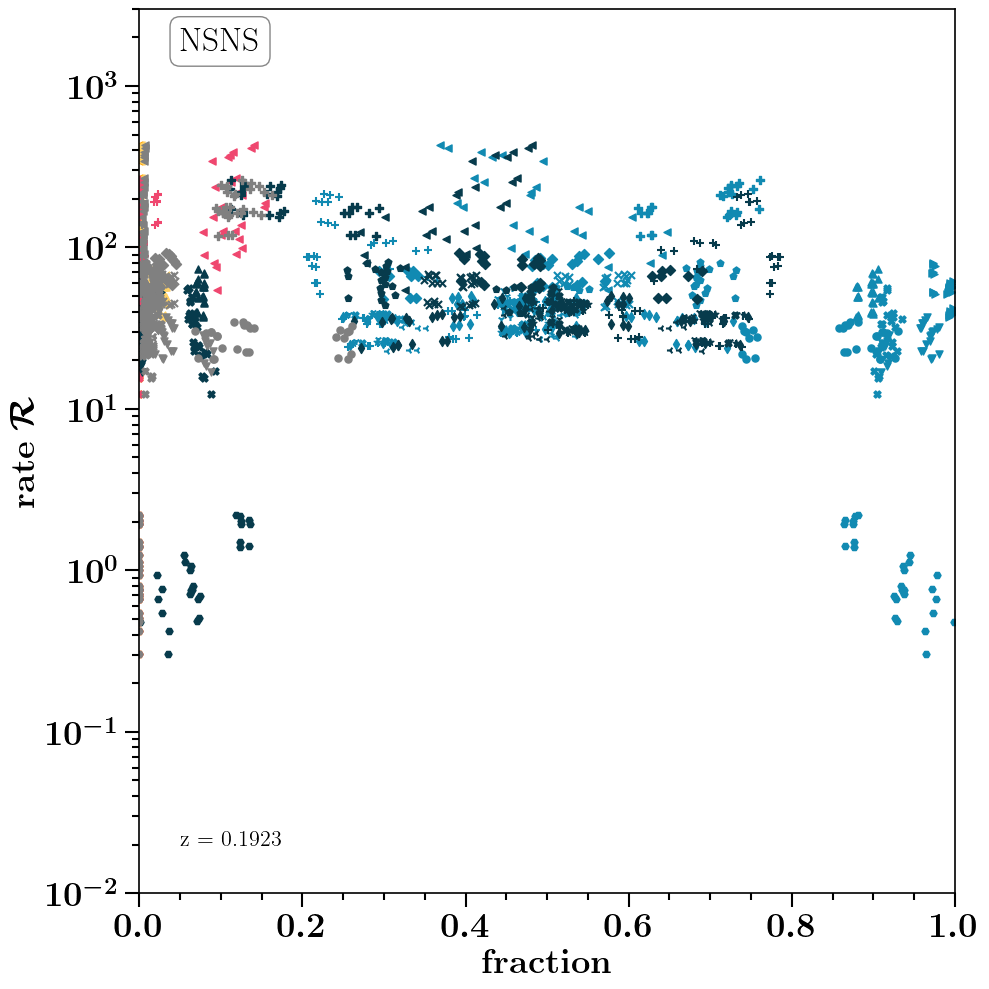

In [14]:
def plot_formation_channels_fixed_z_all_fc(axe='None', DCOtype='BHNS', \
                                          BPSmodelName='A', ind_z=0,\
                                                  pathData='/Volumes/SimonsFoundation/DataDCO/', mask_specific_mssfr=None):
    """
    whichplot='rate', 'ratio'
    
    """
    
    markershapes = ["*", "o", "v",  "p", "H", "^", ">", 'X', "+","<", 'x', "3","d","1", "|", "D", "P", "X", "+", "d"]
    
    adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
    DCOname = DCOname_dict[DCOtype]
    print('ind z =', ind_z)
    
    for nrC, Channel in enumerate(adjustedChannelList): 
        print('at channel', Channel)
#     for nrC, Channel in enumerate([adjustedChannelList[0]]): 
        fc_ind_wanted = dictFormationChannelIndex[Channel]
        c_FC = channelColorDict[Channel]
    
    #     for ind_m, BPSmodelName in  enumerate([BPSnameslist[0]]):
        for ind_m, BPSmodelName in  enumerate(BPSnameslist[:]):
            labelname=r'\textbf{%s:} '%BPSmodelName+ alphabetPhysicalNameDict[BPSmodelName]
#             print('at BPS model ', BPSmodelName)
            color_m = colorDirDict[BPSmodelName]

            # path for files 
            full_data_path = pathData + alphabetDirDict[BPSmodelName] +'/COMPASCompactOutput_'+ DCOtype +'_' + BPSmodelName + '.h5'

            # read in data 
            fdata = h5.File(full_data_path,'r')

            # plot data for all MSSFR at the same time at a given redshift 
            fractions_z, totals_z = np.zeros(len(MSSFRnameslist)), np.zeros(len(MSSFRnameslist))
            fparam_key = "formationchannel_z_rates"
            for ind_mssfr, mssfr in enumerate(MSSFRnameslist[:]):
                header = "fraction_" + Channel + "_" + mssfr 
                fractions_z[ind_mssfr] = fdata[fparam_key][header][...].squeeze()[ind_z]  

                header = "rate_" + "total" + "_" + mssfr 
                totals_z[ind_mssfr] =  fdata[fparam_key][header][...].squeeze()[ind_z]  

            axe.scatter(fractions_z, totals_z, color=c_FC, marker=markershapes[ind_m], s=26,label=labelname)

            # connect models with the same mssfr 
    #         print('connecting datapoints with the same ', mask_specific_mssfr, ' mssfr')
            colors_mssfrind = ['none', 'blue', 'orange', 'green']
            linestyles_mssfrind = ['none', ':',  '-.', '-']
            if mask_specific_mssfr!=None:
                if mask_specific_mssfr=='x':
                    for ind_mssfr_zind in [1,2,3]:
                        ind_begin, ind_end = 1+ 9*(ind_mssfr_zind-1), 10+ 9*(ind_mssfr_zind-1)
                        axe.plot(fractions_z[ind_begin:ind_end], totals_z[ind_begin:ind_end], color=colors_mssfrind[ind_mssfr_zind])
                elif mask_specific_mssfr=='z':
                    for ind_mssfr_zind in [1,2,3]:
                        axe.plot(fractions_z[ind_mssfr_zind::3], totals_z[ind_mssfr_zind::3], color=color_m, ls=linestyles_mssfrind[ind_mssfr_zind])
                elif mask_specific_mssfr=='y':
                    for ind_mssfr_zind in [1,2,3]:
                        fractions_zmask = np.concatenate((fractions_z[1+3*(ind_mssfr_zind-1):4+3*(ind_mssfr_zind-1)], fractions_z[10+3*(ind_mssfr_zind-1):13+3*(ind_mssfr_zind-1)]))
                        fractions_zmask = np.concatenate((fractions_zmask, fractions_z[19+3*(ind_mssfr_zind-1):22+3*(ind_mssfr_zind-1)]))
                        totals_zmask = np.concatenate((totals_z[1+3*(ind_mssfr_zind-1):4+3*(ind_mssfr_zind-1)], totals_z[10+3*(ind_mssfr_zind-1):13+3*(ind_mssfr_zind-1)]))
                        totals_zmask = np.concatenate((totals_zmask, totals_z[19+3*(ind_mssfr_zind-1):22+3*(ind_mssfr_zind-1)]))               

                        axe.plot(fractions_zmask, totals_zmask, color=colors_mssfrind[ind_mssfr_zind])

    #         
        fdata.close()


    print(fractions_z)

    ylabel = r'\textbf{rate} $\mathcal{R}$'
    xlabel = r'\textbf{fraction}'
#     axe.set_ylim(0., 1)

    
    axe = layoutAxes(axe, nameX=xlabel, nameY=ylabel, setMinor=True)
    axe.set_yscale('log')
    axe.set_xlim(0.,1)
    
    
    if DCOtype=='BBH':
        axe.set_ylim(2, 1E4)
    else:
        axe.set_ylim(1E-2, 3*1E3)
    
    handles, labels = axe.get_legend_handles_labels()

    # add box with label to indicate which DCO type we are plotting in the top left of each panel   
    bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.95)
    axe.annotate(r'%s'%(DCOname), xy=(0.05, .98), xycoords='axes fraction', fontsize = fs, weight = 'bold', ha='left', va="top",bbox=bbox_props)            

    

    
    
    return axe, handles, labels




adjustedChannelList = ['classic', 'stable B no CEE', 'vii', 'immediate CE',  r'double-core CE', 'other']
pathData='/Volumes/SimonsFoundation/DataDCO/' # path to datafiles 
redshifts_runs = obtain_redshiftsruns(pathData = pathData) # obtain redshifts that were run 
print('available redshifts:', redshifts_runs) 



# for ind_redshift in [0]:
# for ind_redshift in range(len(redshifts_runs)):
for ind_redshift in [0, 5, 10, 16]:

    for DCOtype in [ 'BNS']:
#     for DCOtype in [ 'BHNS','BBH', 'BNS']:
        print()
        print('at DCOtype =', DCOtype)
        print('running for redshift ', np.round(redshifts_runs[ind_redshift],4))
    #     for nrC, Channel in enumerate(adjustedChannelList): 


#         redshifts_runs
        ncols, nrows= 1,1
        f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(10,10), 
                      gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})

        ax, handles, labels  = plot_formation_channels_fixed_z_all_fc(axe=ax, DCOtype=DCOtype, BPSmodelName=BPSmodelName, ind_z=ind_redshift,\
                                             pathData=pathData, mask_specific_mssfr=None) 


#         ax.annotate(r'%s'%(Channel), xy=(0.05, .1), xycoords='axes fraction', fontsize = fs, weight = 'bold', ha='left', va="bottom")
        ax.annotate(r'z = %s'%np.round(redshifts_runs[ind_redshift],4), xy=(0.05, .05), xycoords='axes fraction', fontsize = fs-8, weight = 'bold', ha='left', va="bottom")


#         lgd2=plt.legend(handles, labels , fontsize=12, ncol=3, bbox_to_anchor=(0.99, 1.55)) #,  markerscale=3., scatterpoints=1)
        ##  SAVE FIG  ###
        plt.tight_layout()
        plt.subplots_adjust(wspace=0., hspace=0)  
        plt.savefig('./redshift_rates_fc/ratesz_'  + DCOtype + '_z' + str(np.round(redshifts_runs[ind_redshift],4)) + '_allfc.png', transparent=True, bbox_extra_artists=(lgd2,), bbox_inches='tight', dpi = 600)
        plt.savefig('./redshift_rates_fc/ratesz_'  + DCOtype + '_z' + str(np.round(redshifts_runs[ind_redshift],4)) + '_allfc.pdf', transparent=True, bbox_extra_artists=(lgd2,), bbox_inches='tight')
        plt.show()
        plt.close()
        
        


at DCOtype = BBH
A


TypeError: plot_formation_channels_redshift_rate_stacked() got an unexpected keyword argument 'pathData'

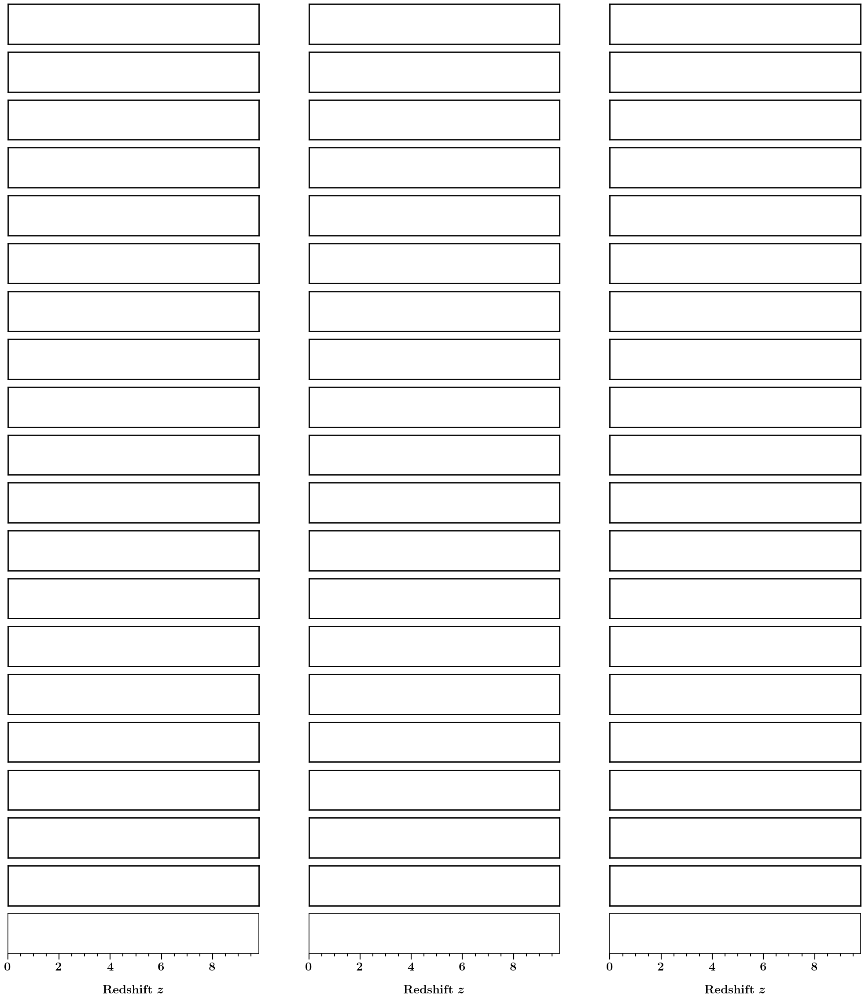

In [27]:

ncols, nrows= 3,20
f, ax= plt.subplots(ncols=ncols,nrows=nrows,figsize=(25,28), 
              gridspec_kw={"width_ratios":1.5*np.ones(ncols), "height_ratios":1*np.ones(nrows)})

fs_t = 20

mssfr ='322' # fixed MSSFR 
pathData='/Volumes/SimonsFoundation/DataDCO/'

for axe_ind in range(3):
    # FIRST COLUMN WITH CHIRP MASS ###
    xparam, axe_ind, xlabelname ='ChirpMass', axe_ind,  r' \textbf{Redshift} $z$ ' 
    xlim=[0.0,9.8]
    make_up_axis(axe=ax, axe_ind=axe_ind, BPSmodelNames=BPSnameslist, xlim=xlim, ylim=None , nameX=xlabelname, nameY=None, logY=False, logX=False)
    layoutAxesNoYlabel(ax=ax[nModels-1,axe_ind], nameX=xlabelname, nameY=None, labelpad=20, fontsize=fs_t)


    
# for ind_dco, DCOtype in enumerate([ 'BHNS','BNS']):
for ind_dco, DCOtype in enumerate(['BBH', 'BHNS','BNS']):
    print()
    print('at DCOtype =', DCOtype)

    for ind_bps, bps_name in enumerate(BPSnameslist):
        print(bps_name)

        ax[ind_bps,ind_dco] = plot_formation_channels_redshift_rate_stacked(axe=ax[ind_bps,ind_dco], DCOtype=DCOtype, BPSmodelName=bps_name,pathData=pathData, mssfr=mssfr) 

    
xlim, ylim=[0,10], [0,1]
# make_up_axis(ax, axe_ind, BPSnameslist, xlim, ylim, xlabelname, nameY=None, logY=False, logX=False)
# layoutAxesNoYlabel(ax=ax[nModels-1,axe_ind], nameX=xlabelname, nameY=None, labelpad=20, fontsize=fs_t)
# # top label 
# ax2x = ax[0,axe_ind].twiny()
# make_up_axis_single_ax(ax2x, 'A', BPSnameslist, xlim, ylim, nameY=None, logY=False, logX=False)
# layoutAxesNoYlabel(ax=ax2x, nameX=xlabelname, nameY=None, second=True, labelpad=20, fontsize=fs_t)


# add y labels on the left. 
for ind_bps, bps_name in enumerate(BPSnameslist):
    nameY = r'\textbf{%s}'%bps_name
    layoutAxesNoXlabel(ax=ax[ind_bps,0], nameX=None, nameY=nameY, labelpad=20, rotation=0)


# add y labels on the right. 
for ind_bps, bps_name in enumerate(BPSnameslist):
    nameY = alphabetPhysicalNameDictWithEnter[bps_name]
    ax2y = ax[ind_bps,2].twinx()
    
    make_up_axis_single_ax(ax2y, 'A', BPSnameslist, xlim, ylim, nameY=None, logY=False, logX=False)
    layoutAxesNoXlabel(ax=ax2y, nameX=None, nameY=nameY, labelpad=25, rotation=90, fontsize=16)


##  SAVE FIG  ###
plt.tight_layout()
plt.subplots_adjust(wspace=0.1, hspace=0)  
plt.savefig('./allModels_figure/ratesz_mssfr_'  + mssfr + '.png', transparent=False)
plt.savefig('./allModels_figure/ratesz_mssfr_'  + mssfr + '.pdf', transparent=False)
plt.show()
plt.close()
